In [3]:
# ! pip install pandas --upgrade pip

In [4]:
# ! pip install pandas==1.5.3

In [2]:
import os 
import pandas as pd 
import numpy as np 
import re
import tqdm 
import matplotlib.pyplot as plt
import pickle

import nltk
from nltk import ngrams
import seaborn as sns

In [3]:
import matplotlib as mpl
import matplotlib.font_manager as fm
from collections import Counter
import sentencepiece as spm

In [4]:
print(pd.__version__)

1.5.3


In [5]:
directory = os.getenv('HOME') + '/aiffel'

In [6]:
df_train = pd.read_csv(directory + '/train_data_0324.csv')
df_test = pd.read_csv(directory + '/test_data_0324.csv')
# df_test['weight'] = df_test['tok_cat'].apply(lambda x : 14 - x)
# df_test = df_test.loc[df_test['tok_cat'] < 6].sample(n=250, weights = 'weight' ,random_state=6) # validation 시간이 너무 오래 걸림, 250개만 사용

In [7]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 948219 entries, 0 to 948218
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   Unnamed: 0  948219 non-null  int64 
 1   reg         948219 non-null  object
 2   topic       948219 non-null  object
 3   stdn        948219 non-null  object
 4   dial        948219 non-null  object
 5   eng         948219 non-null  object
dtypes: int64(1), object(5)
memory usage: 43.4+ MB


In [8]:
df_train.head()

,Unnamed: 0,reg,topic,stdn,dial,eng
0,0,jd,역사,생각이 쪼금씩 바뀌더라고,생각이 쪼금씩 바뀌드라고,I've changed my mind a little bit.
1,1,jd,가족,어 알겠는가 외국인들이 그래도 잘 적응하고,어 알겄는가 애국인들이 그또 잘 적응하고,You know what? Foreigners still get used to it.
2,2,jd,건강,아으 갑자기 예전에 맹장 뜯은 게 생각난다.,아으 갑자기 에전에 맹장 뜯은 게 생각난디야.,"All of a sudden, I think I've ripped off my ap..."
3,3,jd,스타일,보면은 조금 품위 있게 나이 들어가야 되겠단 생각을 참 많이 해요.,보먼은 쫌 품위 있게 나이 들어가야 되겠단 싱각을 참 많이 해요잉.,I have a lot of ideas about getting older in a...
4,4,jd,먹거리,약간 조금 약간 맛이 쪼끔 거시기 하긴 한데 그래도,약간 쫌 약간 맛이 쪼끔 머시기 하긴 한디 그또,"It's a little bit of a tastey, but still."


In [9]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 125 entries, 0 to 124
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  125 non-null    int64 
 1   reg         125 non-null    object
 2   topic       125 non-null    object
 3   stdn        125 non-null    object
 4   dial        125 non-null    object
 5   eng         125 non-null    object
dtypes: int64(1), object(5)
memory usage: 6.0+ KB


In [10]:
df_test.head()

,Unnamed: 0,reg,topic,stdn,dial,eng
0,39379,jd,반려동물,그러니까 그때 친구가 고양이 키우잖애.,긍께 그때 친구가 고양이 키우잖애.,That's why my friend had a cat.
1,53200,jd,드라마,나 몰라서 한번 물어본 거야 스타트업이 뭐야,나 몰라서잉 한번 물어본 거여 스타트업이 뭐여,What's a startup?
2,74542,jd,건강,그래도 나한테 안 맞으니까 기름이잖아 그게 그러니까는 더 소화를 못시키는 거에요.,그또 난테 안 맞은께 기름이잖아 그게 긍까는 더 소화를 못시키는 거에요잉.,"But it's oil because it doesn't work for me, w..."
3,723370,jd,자격증,이렇게 공부를 조금 해볼까 싶거든.,이러게 공부를 쫌 해보까 싶거든.,I wink Ill study a little like this.
4,75397,jd,회사/학교,그래서 그냥 죄송하고 좋은 성적 받자 이런 마음으로 했는데 지금 신프도 그러네,긍께 그냥 죄송하고 좋은 성적 받자 이런 맴으로 했는디 짐 신프도 그러네이,So I just wanted to apologize and get good gra...


##### 중복값, 결측치 확인 및 제거 

In [11]:
df_train.duplicated(subset='stdn').sum()

8079

In [12]:
df_train.duplicated(subset='dial').sum()

744

In [13]:
df_train.duplicated(subset='eng').sum()

62201

In [14]:
df_train.drop_duplicates(subset="dial", inplace = True , ignore_index = True ) 

In [15]:
df_train.drop_duplicates(subset="stdn", inplace = True , ignore_index = True ) 

In [16]:
df_train.drop_duplicates(subset="eng", inplace = True , ignore_index = True ) 

In [17]:
df_train.duplicated().sum()

0

In [18]:
df_train.isnull().sum()

Unnamed: 0    0
reg           0
topic         0
stdn          0
dial          0
eng           0
dtype: int64

In [19]:
# check duplicates
print('train duplicated count :' ,df_train.duplicated(subset='dial').sum())
print('test duplicated count :' ,df_test.duplicated(subset='dial').sum())

train duplicated count : 0
test duplicated count : 0


In [20]:
# check for any overlaps in train and test
tr_dial = df_train.dial.values
ts_dial = df_test.dial.values
temp_ = np.concatenate([tr_dial, ts_dial], axis=0)
temp_ = print('overlap count : ',pd.DataFrame(temp_).duplicated().sum())

overlap count :  0


##### 지역별 데이터 분포 

In [21]:
df_train.reg.value_counts()

kw    293070
jj    192667
jd    171056
gs    112938
cc    110551
Name: reg, dtype: int64

In [22]:
df_test.reg.value_counts()

jd    25
jj    25
cc    25
gs    25
kw    25
Name: reg, dtype: int64

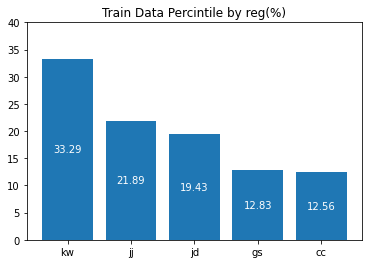

In [23]:
# train data 지역별 데이터 분포 
data = df_train.reg.value_counts(normalize=True).multiply(100).round(2)

fig, ax = plt.subplots()
p = ax.bar(data.index, data)
ax.bar_label(p, label_type='center', color='white')



    
plt.title("Train Data Percintile by reg(%)")
plt.ylim(0,40)
plt.show()

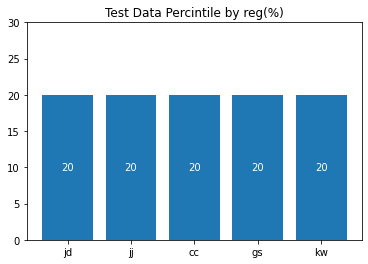

In [24]:
# test 데이터는 굳이 넣을 필요 없을듯합니다.
data = df_test.reg.value_counts(normalize=True).multiply(100).round(2)
fig, ax = plt.subplots()
p = ax.bar(data.index, data)
ax.bar_label(p, label_type='center', color='white')



plt.title("Test Data Percintile by reg(%)")
plt.ylim(0,30)
plt.show()

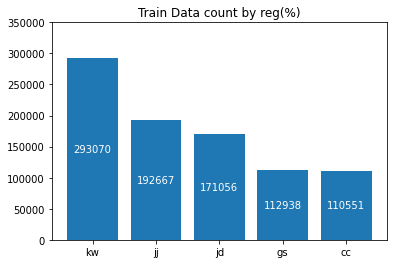

In [25]:
# train data 지역별 데이터 분포 
data = df_train.reg.value_counts()

fig, ax = plt.subplots()
p = ax.bar(data.index, data)
ax.bar_label(p, label_type='center', color='white')


plt.title("Train Data count by reg(%)")
plt.ylim(0,350000)
plt.show()

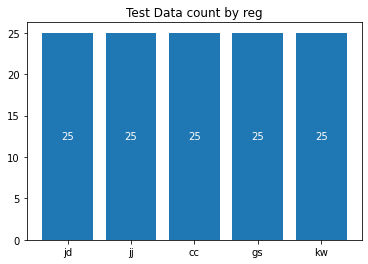

In [26]:
# test 데이터는 굳이 넣을 필요 없을듯합니다.
# data = df_test.reg.value_counts(normalize=True).multiply(100).round(2)
data = df_test.reg.value_counts()
fig, ax = plt.subplots()
p = ax.bar(data.index, data)
ax.bar_label(p, label_type='center', color='white')
plt.title("Test Data count by reg")
plt.show()

### topic별 분포

In [67]:
font_list = fm.findSystemFonts(fontpaths=None, fontext='ttf')
for i in font_list :
    fm.fontManager.addfont(i)
plt.rcParams['font.family'] = 'NanumBarunGothic'

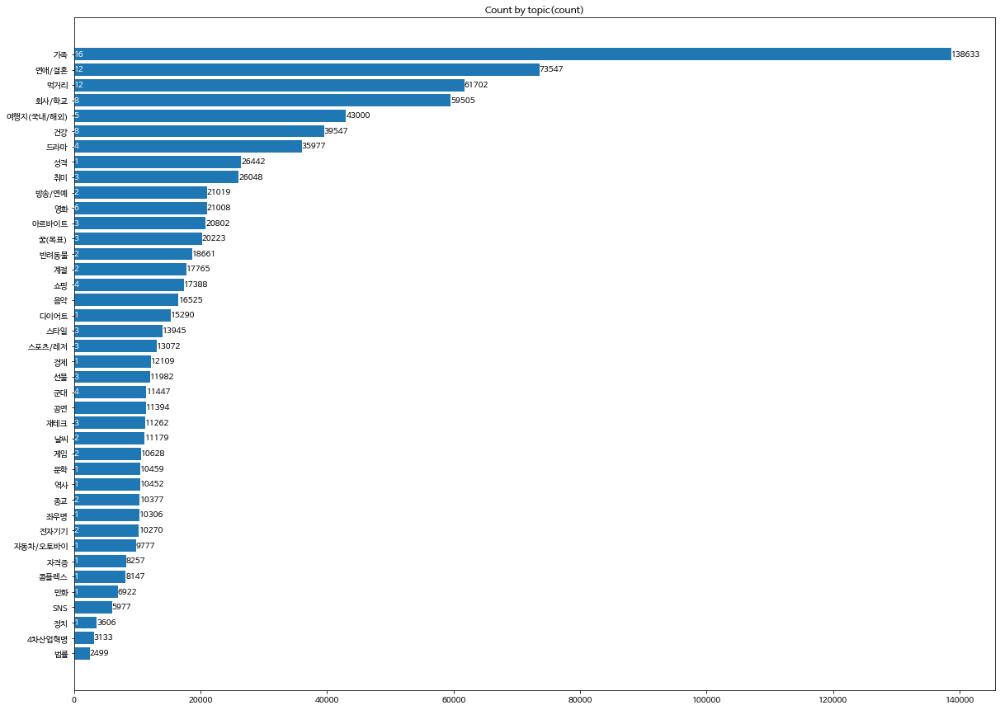

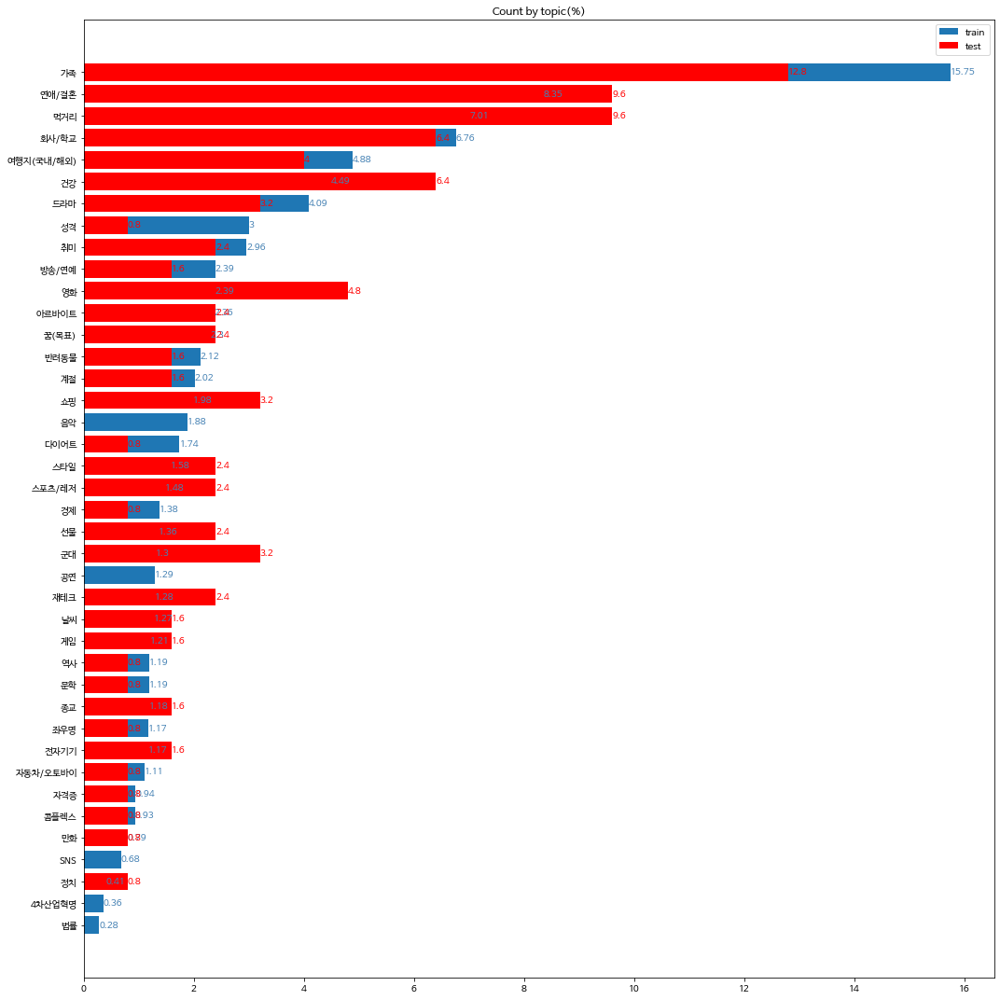

In [68]:
# check by topic
data = df_train.topic.value_counts().sort_values(ascending=True)
data_ts = df_test.topic.value_counts().sort_values(ascending=True)

fig, ax = plt.subplots(figsize=(20,15))
p = ax.barh(data.index, data, align='center')
t = ax.barh(data_ts.index, data_ts, align='center', color='red')
ax.bar_label(p, font='NanumBarunGothic')
ax.bar_label(t, color='white', font='NanumBarunGothic')
plt.title("Count by topic(count)")

data = df_train.topic.value_counts(normalize=True).multiply(100).round(2).sort_values(ascending=True)
data_ts = df_test.topic.value_counts(normalize=True).multiply(100).round(2).sort_values(ascending=True)

fig, ax = plt.subplots(figsize=(15,15))
p = ax.barh(data.index, data, align='center',label='train')
t = ax.barh(data_ts.index, data_ts, align='center', color='red', label='test')
ax.bar_label(p, color = 'steelblue',font='NanumBarunGothic')
ax.bar_label(t, color='red', font='NanumBarunGothic')
plt.legend()
plt.title("Count by topic(%)")

plt.tight_layout()
plt.show()

In [69]:
regs = df_train.reg.unique()

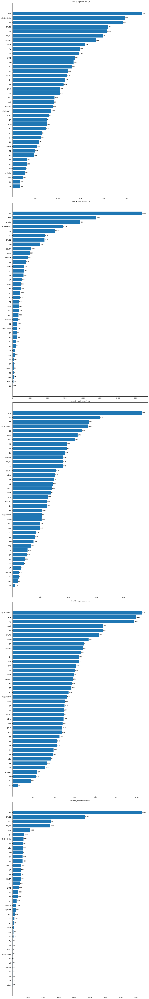

In [70]:
#by region
fig = plt.figure(figsize = (15,100))
for i,reg in enumerate(regs) :
    data = df_train.loc[df_train.reg == reg].topic.value_counts().sort_values(ascending=True)
    data_ts = df_test.loc[df_test.reg == reg].topic.value_counts().sort_values(ascending=True)
    ax = plt.subplot(5,1,i+1)
    p = ax.barh(data.index, data, align='center')
    t = ax.barh(data_ts.index, data_ts, align='center', color='red')
    ax.bar_label(p, font='NanumBarunGothic')
    ax.bar_label(t, color='white', font='NanumBarunGothic')
    plt.title(f"Count by topic(count) : {reg}")
plt.tight_layout()
plt.show()

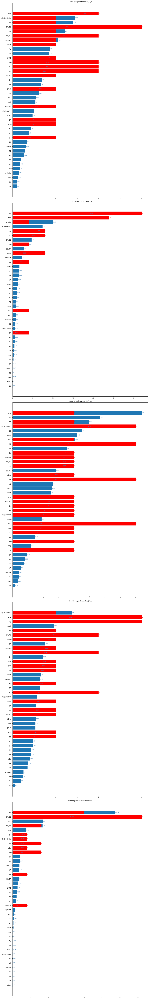

In [71]:
#by region %
fig = plt.figure(figsize = (15,100))
for i,reg in enumerate(regs) :
    data = df_train.loc[df_train.reg == reg].topic.value_counts(normalize=True).multiply(100).round(2).sort_values(ascending=True)
    data_ts = df_test.loc[df_test.reg == reg].topic.value_counts(normalize=True).multiply(100).round(2).sort_values(ascending=True)
    ax = plt.subplot(5,1,i+1)
    p = ax.barh(data.index, data, align='center')
    t = ax.barh(data_ts.index, data_ts, align='center', color='red')
    ax.bar_label(p, color='steelblue',font='NanumBarunGothic')
    ax.bar_label(t, color='red', font='NanumBarunGothic')
    plt.title(f"Count by topic(Proportion) : {reg}")
plt.tight_layout()
plt.show()

### 문장 최대 길이 

In [72]:
# check max, min, ave range in data

def sen_len(corpus, kor=False) :
    max_len = 0
    min_len = 999
    cum_len = 0
    max_content = ''
    min_content = ''
    for i in corpus :
        if kor : 
            i = i[0]
        length = len(i)
        if length >= max_len : 
            max_len = length
            max_content = i
        if length <= min_len : 
            min_len = length
            min_content = i
        cum_len += length
    
    print(f'max_len : {max_len}')
    print('max_content :', max_content)
    print(f'min_len : {min_len}')
    print('min_content :', min_content)
    print(f'average_len : {round(cum_len/len(corpus),1)}')
    
    return max_len, min_len, cum_len

def plot_dial_seq_dist(corpus,kor=False) :
    max_len, min_len , _ = sen_len(corpus,kor)
    seq_len_matrix = np.zeros((max_len+1), dtype=int)
    for i in corpus :
        if kor :
            i = i[0]
        length = len(i)
        seq_len_matrix[length] += 1
    
    fig,ax = plt.subplots()
    hist = ax.bar(range(len(seq_len_matrix)),seq_len_matrix, color='steelblue', width=2)
    plt.ylim(0, 30000)
    plt.title('dial_len_distribution')
    plt.show()

def plot_eng_seq_dist(corpus,kor=False) :
    max_len, min_len , _ = sen_len(corpus,kor)
    seq_len_matrix = np.zeros((max_len+1), dtype=int)
    for i in corpus :
        if kor :
            i = i[0]
        length = len(i)
        seq_len_matrix[length] += 1
    
    fig,ax = plt.subplots()
    hist = ax.bar(range(len(seq_len_matrix)),seq_len_matrix, color='steelblue', width=2)
    plt.ylim(0, 30000)
    plt.title('eng_len_distribution')
    plt.show()


max_len : 203
max_content : 잔채집에 따라가고 우리집으는 왜 안하라우. 우리 딸두 빨리 잔채가 열려야지. 사나 복이 있어야지. 사나 복이 없으문 자식 복두 없다던데. 사나 잘 해줘서 손두 안 움직인데. 너는 사나 젊잖아. 우리 사나은 나으가 많아. 기래두 사나 돈을 잘 벌잖아. 나는 착한 사나 최고인 것 같아. 운제 한 번 놀러와. 저 사람 좀 보와. 몸띠이가 크더라. 다리 터리기 많아. 
min_len : 2
min_content : 매 
average_len : 27.5


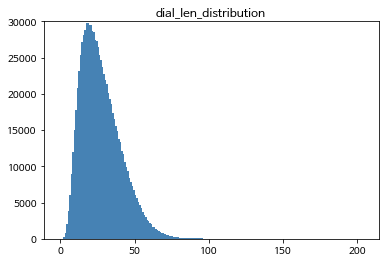

In [73]:
# train : dialect corpus by character
plot_dial_seq_dist(df_train['dial'])

max_len : 576
max_content : Now I'm going to paint you, and then I'm going to do some weaving, and then I'm going to do some painting, and then I'm going to do some weaving, and then I'm going to do some painting, and then I'm going to do some painting, and then I'm going to do some weaving, and then I'm going to do some painting, and then I'm going to do some weaving, and then I'm going to do some weaving, and then I'm going to do some digging, and then I'm going to do some painting, and then I'm going to do some painting, and then I'm going to do some weaving, and then I'm going to do something.
min_len : 1
min_content : I
average_len : 52.5


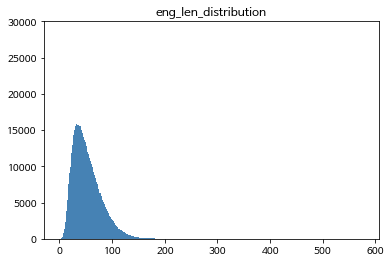

In [74]:
#english
plot_eng_seq_dist(df_train['eng'])

In [75]:
df_train['c_len'] =df_train['dial'].apply(lambda x : len(x))

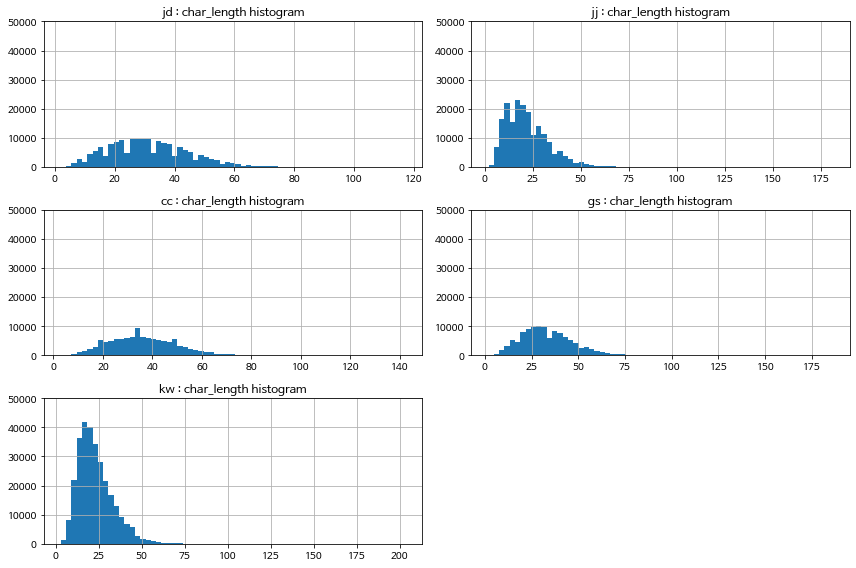

In [76]:
#by reg
plt.figure( figsize=(12,8))
for i, reg in enumerate(regs) :
    plt.subplot(3,2,i+1)
    ax = df_train.loc[df_train['reg'] == reg,'c_len'].hist(bins=65)
    plt.title(f'{reg} : char_length histogram')
    plt.ylim(0, 50000)
plt.tight_layout()
plt.show()

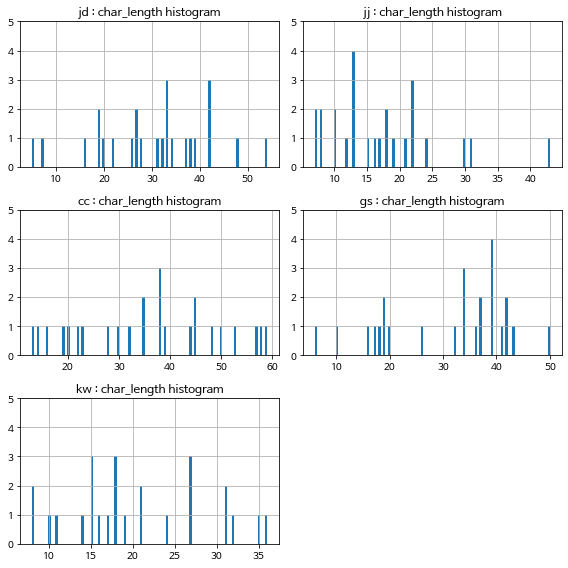

In [77]:
df_test['c_len'] =df_test['dial'].apply(lambda x : len(x))
#by reg
plt.figure( figsize=(8,8))
for i, reg in enumerate(regs) :
    plt.subplot(3,2,i+1)
    ax = df_test.loc[df_test['reg'] == reg,'c_len'].hist(bins=100)
    plt.title(f'{reg} : char_length histogram')
    plt.ylim(0, 5)
plt.tight_layout()
plt.show()

max_len : 59
max_content : 그서 해군이 있는 대장이 출동을 혀 근데 대장의 그런 전투력은 그냥 루피이 한 천 배 정도 된단 말이여. 
min_len : 5
min_content : 사야제. 
average_len : 26.9


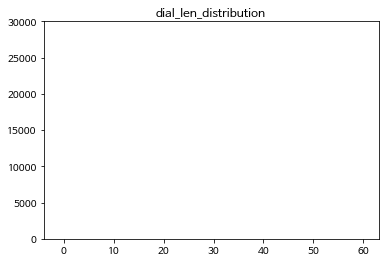

In [78]:
#test
plot_dial_seq_dist(df_test['dial'])

max_len : 130
max_content : I'm just waiting for time to come, and I don't think it's too much time to go to the movies, and I don't want to go to the movies.
min_len : 9
min_content : Oh mix it
average_len : 50.0


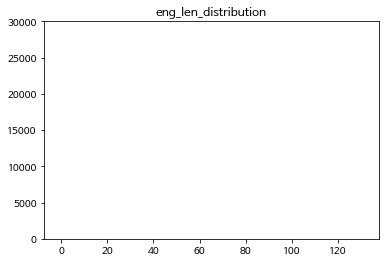

In [79]:
plot_eng_seq_dist(df_test['eng'])

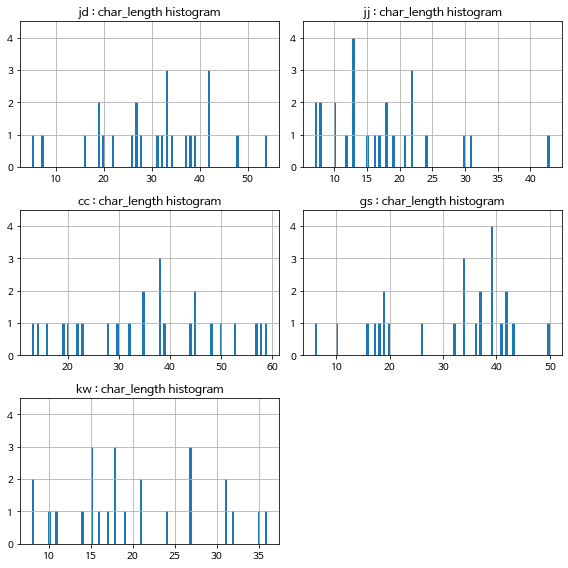

In [80]:
df_test['c_len'] =df_test['dial'].apply(lambda x : len(x))
#by reg
plt.figure( figsize=(8,8))
for i, reg in enumerate(regs) :
    plt.subplot(3,2,i+1)
    ax = df_test.loc[df_test['reg'] == reg,'c_len'].hist(bins=100)
    plt.title(f'{reg} : char_length histogram')
    plt.ylim(0,4.5)
plt.tight_layout()
plt.show()

In [27]:
from konlpy.tag import Mecab
mecab = Mecab()

In [82]:
df_train['token'] = df_train['stdn'].apply(mecab.morphs)
df_train['token_len'] = df_train['token'].apply(len)
df_train['token_dial'] = df_train['dial'].apply(mecab.morphs)
df_train['token_dial_len'] = df_train['token_dial'].apply(len)
df_train['token_eng'] = df_train['eng'].apply(mecab.morphs)
df_train['token_eng_len'] = df_train['token_eng'].apply(len)

In [83]:
df_test['token_ts'] = df_test['stdn'].apply(mecab.morphs)
df_test['token_ts_len'] = df_test['token_ts'].apply(len)
df_test['token_ts_dial'] = df_test['dial'].apply(mecab.morphs)
df_test['token_ts_dial_len'] = df_test['token_ts_dial'].apply(len)
df_test['token_ts_eng'] = df_test['eng'].apply(mecab.morphs)
df_test['token_ts_eng_len'] = df_test['token_ts_eng'].apply(len)

ValueError: shape mismatch: objects cannot be broadcast to a single shape

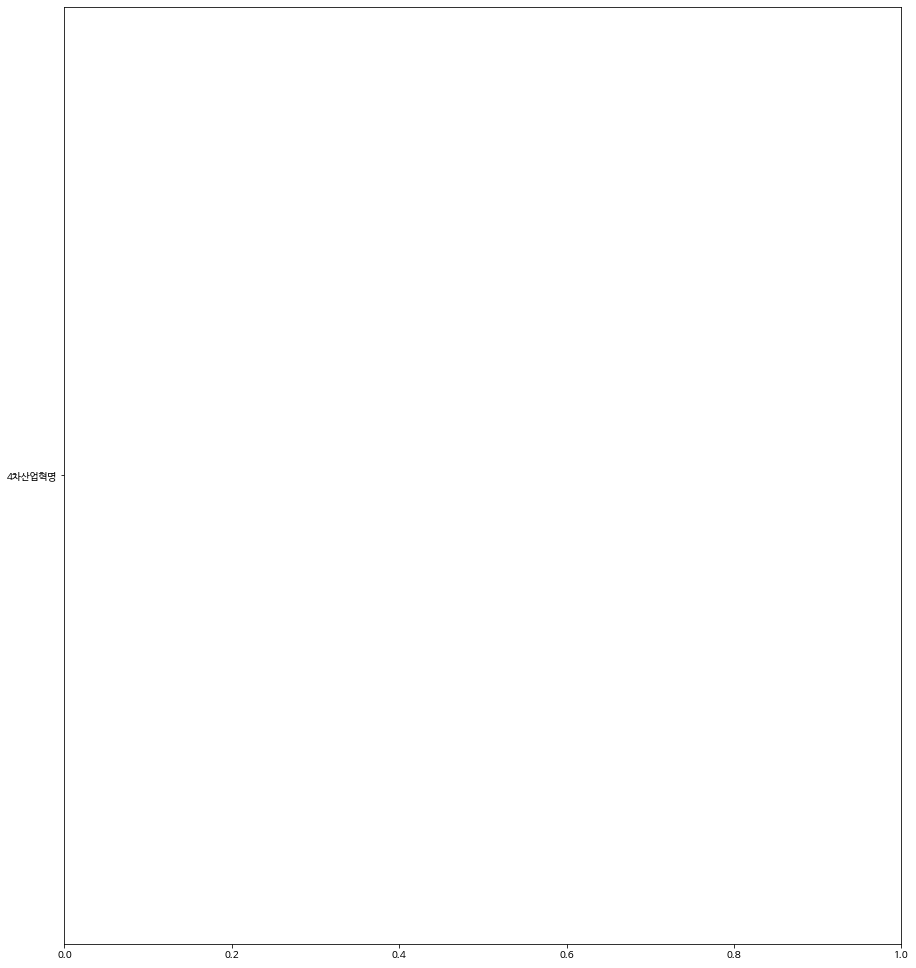

In [84]:
#by region
fig = plt.figure(figsize = (15,100))
for i,reg in enumerate(regs) :
    data = df_train.groupby(['topic','reg'])['token_len'].mean().unstack()
    ax = plt.subplot(5,1,i+1)
    p = ax.barh(data.index, data, align='center')
    ax.bar_label(p, font='NanumBarunGothic')
    plt.title(f"Count by topic(count) : {reg}")
plt.tight_layout()
plt.show()

In [ ]:
# reg, topic, tok_len 평균

import seaborn as sns
plt.figure(figsize=(12,12))
data = df_train.groupby(['topic','reg'])['token_len'].mean().unstack()
sns.heatmap(data, annot=True,  cbar=False)
plt.tight_layout()
plt.title('train : token_len by topic and reg')
plt.show()

In [ ]:
df_train.loc[df_train.reg == reg].topic.value_counts()

In [ ]:
test = df_train.groupby(['topic', 'reg'], as_index=False).mean()
test = test[test['reg'] == f'{reg}']
test = test.set_index('topic')
test.token_len.astype(int)

/tmp/ipykernel_45/2571177775.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  test = df_train.groupby(['topic', 'reg'], as_index=False).mean()
/tmp/ipykernel_45/2571177775.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  test = df_train.groupby(['topic', 'reg'], as_index=False).mean()
/tmp/ipykernel_45/2571177775.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  test = df_train.groupby(['topic', 'reg'], as_ind

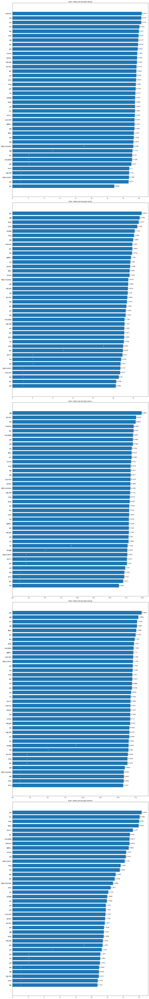

In [167]:
#by region
regs = df_train.reg.unique()
fig = plt.figure(figsize = (15,100))
for i,reg in enumerate(regs) :
    test = df_train.groupby(['topic', 'reg'], as_index=False).mean()
    test = test[test['reg'] == f'{reg}']
    test = test.set_index('topic')
    data_test = test.token_len.sort_values(ascending=True)
    
    data = data_test
    ax = plt.subplot(5,1,i+1)
    p = ax.barh(data.index, data, align='center')
    ax.bar_label(p, font='NanumBarunGothic')
    ax.bar_label(t, color='white', font='NanumBarunGothic')
    plt.title(f'train : token_len by topic and {reg}')
plt.tight_layout()
plt.show()

/tmp/ipykernel_45/2123654910.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  test = df_train.groupby(['topic', 'reg'], as_index=False).mean()
/tmp/ipykernel_45/2123654910.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  test = df_train.groupby(['topic', 'reg'], as_index=False).mean()
/tmp/ipykernel_45/2123654910.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  test = df_train.groupby(['topic', 'reg'], as_ind

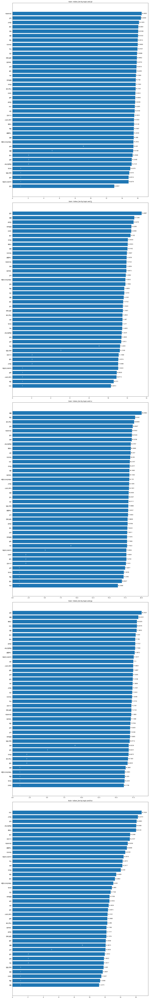

In [168]:
#by region
regs = df_train.reg.unique()
fig = plt.figure(figsize = (15,100))
for i,reg in enumerate(regs) :
    test = df_train.groupby(['topic', 'reg'], as_index=False).mean()
    test = test[test['reg'] == f'{reg}']
    test = test.set_index('topic')
    data_test = test.token_dial_len.sort_values(ascending=True)
    
    data = data_test
    ax = plt.subplot(5,1,i+1)
    p = ax.barh(data.index, data, align='center')
    ax.bar_label(p, font='NanumBarunGothic')
    ax.bar_label(t, color='white', font='NanumBarunGothic')
    plt.title(f'train : token_len by topic and {reg}')
plt.tight_layout()
plt.show()

/tmp/ipykernel_45/2860179509.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  test = df_train.groupby(['topic', 'reg'], as_index=False).mean()
/tmp/ipykernel_45/2860179509.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  test = df_train.groupby(['topic', 'reg'], as_index=False).mean()
/tmp/ipykernel_45/2860179509.py:5: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  test = df_train.groupby(['topic', 'reg'], as_ind

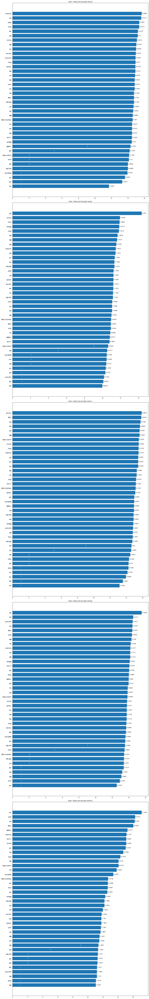

In [169]:
#by region
regs = df_train.reg.unique()
fig = plt.figure(figsize = (15,100))
for i,reg in enumerate(regs) :
    test = df_train.groupby(['topic', 'reg'], as_index=False).mean()
    test = test[test['reg'] == f'{reg}']
    test = test.set_index('topic')
    data_test = test.token_eng_len.sort_values(ascending=True)
    
    data = data_test
    ax = plt.subplot(5,1,i+1)
    p = ax.barh(data.index, data, align='center')
    ax.bar_label(p, font='NanumBarunGothic')
    ax.bar_label(t, color='white', font='NanumBarunGothic')
    plt.title(f'train : token_len by topic and {reg}')
plt.tight_layout()
plt.show()

### import Tokenizer

In [53]:
data_path = os.getenv('HOME') +'/PocLab/Preprocessing'

spm_8000 = spm.SentencePieceProcessor()
spm_8000.Load(data_path + '/vocab_8000/spm_dec_spm8009.model')

msp_8000 = spm.SentencePieceProcessor()
msp_8000.Load(data_path + '/vocab_8000/spm_dec_msp8009.model')

custom_msp_8000 =  spm.SentencePieceProcessor()
custom_msp_8000.Load(data_path + '/vocab_8000/spm_dec_cmsp8009.model')



OSError: Not found: "/aiffel/PocLab/Preprocessing/vocab_8000/spm_dec_spm8009.model": No such file or directory Error #2

In [108]:
data_path = os.getenv('HOME') +'/aiffel'

spm_16000 = spm.SentencePieceProcessor()
spm_16000.Load(data_path + '/spm_dec_spm16000.model')

msp_16000 = spm.SentencePieceProcessor()
msp_16000.Load(data_path + '/spm_dec_msp16000.model')

custom_msp_16000 =  spm.SentencePieceProcessor()
custom_msp_16000.Load(data_path + '/spm_dec_cmsp16000.model')

True

In [55]:
# 토크나이저 dict 만들기

tokenizers_8000 = {'spm' : spm_8000, 'msp' : msp_8000, 'custom_msp' : custom_msp_8000}
tokenizers_16000 = {'spm' : spm_16000, 'msp' : msp_16000, 'custom_msp' : custom_msp_16000}

NameError: name 'msp_8000' is not defined

In [ ]:
regs = ['kw','jj','cc','gs','jd']

In [ ]:
#by reg

fig = plt.figure(figsize=(15,70))

for i, reg in enumerate(regs) :
    
    frequency_pos = Counter()
    dial = df_train.loc[df_train['reg'] == reg,'dial'].values
    for k in tqdm.tqdm(dial) :
        tokenized = ''.join(spm_8000.encode_as_pieces(k)).replace('▁',' ').split()
        token_words = ngrams(tokenized,1)
        frequency_pos.update(token_words)

    df_pos = pd.DataFrame(frequency_pos.most_common(100))

    # Barplot that shows the top most common
    
    plt.subplot(5,1,i+1)
    sns.set(font_scale = 1.5, style = 'whitegrid', font ='NanumGothic')
    sns_pos_1 = sns.barplot(x = df_pos[1], y = df_pos[0], color = 'steelblue')

    # Setting axes labels
    sns_pos_1.set(xlabel = 'Occurrence', ylabel = 'Unigrams', title = f'Top 100 Unigrams : {reg}')
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)

    
plt.tight_layout()
plt.show()

## tokenizer별 분산 확인 

In [ ]:
dial = df_train.loc[df_train['reg'] == reg,'dial'].values
df_train['dial_r'] = df_train['dial'].apply(lambda x : re.sub('[?.,!]','',x))

In [ ]:
# kdeplot 그래프 

import seaborn as sns
from nltk import ngrams
colors = ['r','g','darkviolet','orange','cyan']

def uni_bi_distribution_plot(tokenizer_dic, col ,row):
    fig = plt.figure(figsize=(10,10))
    z = 0
    for i, tok in enumerate(tokenizer_dic.items()) :
        key, tokenizer = tok
        for n,reg in enumerate(regs) :
            # unigram
            dial = df_train.loc[df_train['reg'] == reg,'dial_r'].values
            tokenized = []
            for k in tqdm.tqdm(dial) :
                tok_encode = tokenizer.encode(k)
                tokenized.extend(tok_encode)

            # Barplot that shows the top most common

            sns_pos_1 = plt.subplot(col,row,z+i+1)
            sns.set(font_scale = .5, style = 'whitegrid')
            sns_pos_1 = sns.kdeplot(tokenized,color=colors[n], label=reg, fill=True)

            # Setting axes labels
            sns_pos_1.set(xlabel = 'Occurrence', ylabel = 'Vocab', title = f'{key} : Unigram Token Distribution by Region')
            plt.xticks(fontsize=10)
            plt.yticks(fontsize=10)
            plt.legend()

            
            
        # bigram
        tok_dict = {}
        idx = 0
        for n,reg in enumerate(regs) :
            dial = df_train.loc[df_train['reg'] == reg,'dial_r'].values
            tokenized = []
            for k in tqdm.tqdm(dial) :
                tok_encode = tokenizer.encode(k)
                n_grams = ngrams(tok_encode,2)
                for ng in n_grams :
                    try :
                        tokenized.append(tok_dict[ng])
                    except :
                        idx += 1
                        tok_dict[ng] = idx  
                        tokenized.append(tok_dict[ng])

            sns_pos_1 = plt.subplot(col,row,z+i+2)
            sns.set(font_scale = .5, style = 'whitegrid')
            sns_pos_1 = sns.kdeplot(tokenized,color=colors[n], label=reg, fill=True)
        
        
        # Setting axes labels
        sns_pos_1.set(xlabel = 'Occurrence', ylabel = 'Vocab', title = f'{key} : Bigram Token Distribution by Region')
        plt.xticks(fontsize=10)
        plt.yticks(fontsize=10)
        plt.legend()
        z +=1

                
        
        # Trigram
        tok_dict = {}
        idx = 0
        for n,reg in enumerate(regs) :
            dial = df_train.loc[df_train['reg'] == reg,'dial_r'].values
            tokenized = []
            for k in tqdm.tqdm(dial) :
                tok_encode = tokenizer.encode(k)
                n_grams = ngrams(tok_encode,3)
                for ng in n_grams :
                    try :
                        tokenized.append(tok_dict[ng])
                    except :
                        idx += 1
                        tok_dict[ng] = idx  
                        tokenized.append(tok_dict[ng])

            sns_pos_1 = plt.subplot(col,row,z+i+2)
            sns.set(font_scale = .5, style = 'whitegrid')
            sns_pos_1 = sns.kdeplot(tokenized,color=colors[n], label=reg, fill=True)

        # Setting axes labels
        sns_pos_1.set(xlabel = 'Occurrence', ylabel = 'Vocab', title = f'{key} : Trigram Token Distribution by Region')
        plt.xticks(fontsize=10)
        plt.yticks(fontsize=10)
        plt.legend()
        z +=1
        
        

    plt.tight_layout()
    plt.show()

In [ ]:
uni_bi_distribution_plot(tokenizers_8000, 3, 3)

## wordcloud

In [28]:
from wordcloud import WordCloud
import matplotlib.font_manager

In [47]:
df_train['token'] = df_train['dial'].apply(mecab.morphs)

In [65]:
import torch

torch.cuda.empty_cache()
torch.cuda.empty_cache()
torch.cuda.empty_cache()

In [49]:
df_train[['token']]

,token
0,"[생각, 이, 쪼금, 씩, 바뀌, 드라고]"
1,"[어, 알, 겄, 는가, 애, 국인, 들, 이, 그, 또, 잘, 적응, 하, 고]"
2,"[아으, 갑자기, 에, 전, 에, 맹장, 뜯, 은, 게, 생각난, 디, 야, .]"
3,"[보먼, 은, 쫌, 품위, 있, 게, 나이, 들어가, 야, 되, 겠, 단, 싱, 각..."
4,"[약간, 쫌, 약간, 맛, 이, 쪼끔, 머시기, 하긴, 한, 디, 그, 또]"
...,...
880277,"[뭐, ~, 맨날, 집, 이, 서, 인제, 음식, 도, 그냥, 가까운, 디, 나가,..."
880278,"[너, 느, 만약, 에, 그런, 시대, 가, 오, 머, 니, 가, 어뜨케, 활동, ..."
880279,"[하이브, 도, 있, 고, 조석, 작가, 이제, 조, 의, 영역, 이, 라는, 웹툰..."
880280,"[추석, 도, 친척, 덜, 토, 사촌, 까지, 만, 모이, 긴, 햄, 신디, 다, ..."


In [50]:
path = os.getenv("HOME") + '/aiffel/'
path

'/aiffel/aiffel/'

In [51]:
import re
from tqdm import tqdm

f = open(path + 'test_token.txt', 'w')
for i in tqdm(range(len(df_train['token']))):
    s = ','.join(df_train['token'][i])
    f.write(s + '\n')
    
f.close()

100%|██████████| 880282/880282 [00:05<00:00, 170140.89it/s]


In [52]:
with open(path + 'test_token.txt', "r") as f:
    lines = f.readlines()
with open(path + 'test_token.txt', "w") as f:
    for line in lines:
        f.write(line.replace('?', ''))

In [53]:
with open(path + 'test_token.txt', "r") as f:
    lines = f.readlines()
with open(path + 'test_token.txt', "w") as f:
    for line in lines:
        f.write(line.replace('.', ''))

In [54]:
with open(path + 'test_token.txt', "r") as f:
    lines = f.readlines()
with open(path + 'test_token.txt', "w") as f:
    for line in lines:
        f.write(line.replace(',', ' '))

In [55]:
with open(path + 'test_token.txt', "r") as f:
    lines = f.readlines()
with open(path + 'test_token.txt', "w") as f:
    for line in lines:
        f.write(line.replace('!', ''))

In [56]:
with open(path + 'test_token.txt', "r") as f:
    lines = f.readlines()
with open(path + 'test_token.txt', "w") as f:
    for line in lines:
        f.write(line.replace('~', ''))

In [60]:
with open(path + 'test_token.txt', "r") as f:
    lines = f.readlines()

lines_test = ','.join(lines)

In [63]:
lines_list = []
lines_tt = lines_test.split(',')
lines_list.append(lines_tt)

In [66]:
for i in lines_list:
    df_train['token'] = i

In [67]:
df_train[['token']]

,token
0,생각 이 쪼금 씩 바뀌 드라고\n
1,어 알 겄 는가 애 국인 들 이 그 또 잘 적응 하 고\n
2,아으 갑자기 에 전 에 맹장 뜯 은 게 생각난 디 야 \n
3,보먼 은 쫌 품위 있 게 나이 들어가 야 되 겠 단 싱 각 을 참 많이 해요 잉 \n
4,약간 쫌 약간 맛 이 쪼끔 머시기 하긴 한 디 그 또\n
...,...
880277,뭐 맨날 집 이 서 인제 음식 도 그냥 가까운 디 나가 가꼬 먹 는 게 아니 라 ...
880278,너 느 만약 에 그런 시대 가 오 머 니 가 어뜨케 활동 할 것 같 애 \n
880279,하이브 도 있 고 조석 작가 이제 조 의 영역 이 라는 웹툰 도 있 고 마음 의 소...
880280,추석 도 친척 덜 토 사촌 까지 만 모이 긴 햄 신디 다 모이 난 이 할 말 도 많...


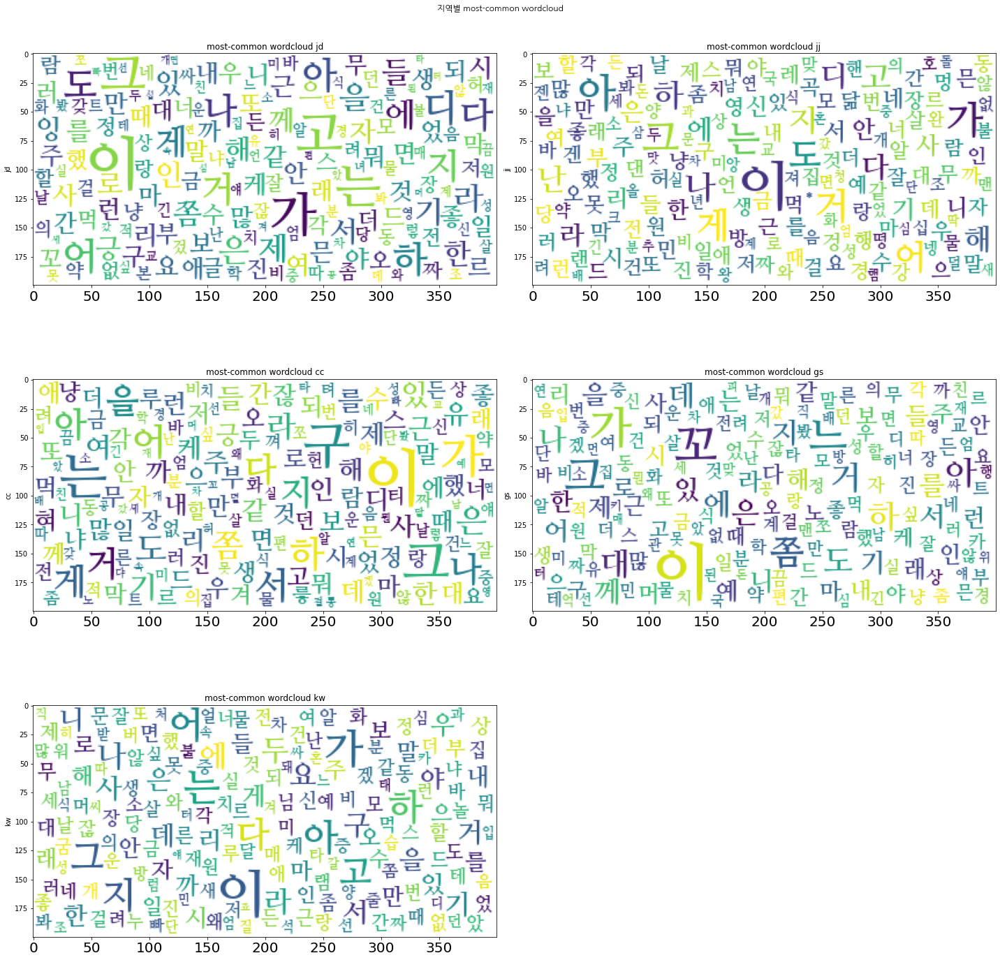

In [69]:
plt.figure(figsize= (20,20))

regs = df_train.reg.unique()

for i, reg in enumerate(regs) :
    counter = Counter()
    for k in df_train.loc[df_train['reg'] == reg].token :
        counter.update(k)
    
    regs = counter.most_common(100)

    # font path http://corazzon.github.io/matplotlib_font_setting
    font_list = [(f.name, f.fname) for f in fm.fontManager.ttflist if 'Nanum' in f.name]
    font_list[0][1]
    wc = WordCloud(font_path= font_list[0][1], background_color='white',max_font_size=100 ,prefer_horizontal = 1)
    
    
    cloud = wc.generate_from_frequencies(counter)
    
    plt.subplot(3,2,i+1)
    plt.ylabel(reg)
    plt.imshow(cloud)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=10)
    plt.title(f'most-common wordcloud {reg}')

plt.suptitle('지역별 most-common wordcloud',  font ='NanumGothic')
plt.tight_layout()
plt.show()

In [79]:
dial = df_train.loc[df_train['reg'] == reg].dial
for k in tqdm(dial) :
    token_words = ngrams(k.split(),2)
    for z in token_words:
        print(z)

  0%|          | 140/171056 [00:00<02:02, 1393.63it/s]

('생각이', '쪼금씩')
('쪼금씩', '바뀌드라고')
('어', '알겄는가')
('알겄는가', '애국인들이')
('애국인들이', '그또')
('그또', '잘')
('잘', '적응하고')
('아으', '갑자기')
('갑자기', '에전에')
('에전에', '맹장')
('맹장', '뜯은')
('뜯은', '게')
('게', '생각난디야.')
('보먼은', '쫌')
('쫌', '품위')
('품위', '있게')
('있게', '나이')
('나이', '들어가야')
('들어가야', '되겠단')
('되겠단', '싱각을')
('싱각을', '참')
('참', '많이')
('많이', '해요잉.')
('약간', '쫌')
('쫌', '약간')
('약간', '맛이')
('맛이', '쪼끔')
('쪼끔', '머시기')
('머시기', '하긴')
('하긴', '한디')
('한디', '그또')
('다른', '디')
('디', '수영')
('수영', '카페')
('카페', '같은')
('같은', '디')
('디', '가')
('가', '보믄은')
('보믄은', '일곱')
('일곱', '색깔')
('색깔', '무지개색')
('무지개색', '해')
('해', '갖고')
('갖고', '막')
('그걸', '이르케')
('이르케', '깨달으시로')
('깨달으시로', '제가')
('제가', '좋아하는')
('좋아하는', '맛집이')
('맛집이', '여기')
('여기', '주변에도')
('주변에도', '맻')
('맻', '개가')
('개가', '있어요잉.')
('근디', '쪘다가')
('쪘다가', '또')
('또', '빠졌다가')
('빠졌다가', '또')
('또', '쪘다가')
('쪘다가', '이케')
('놀이', '있냐')
('있냐', '이게')
('이게', '플레이냐')
('플레이냐', '꿈이냐')
('꿈이냐', '틀리자녀')
('틀리자녀', '긍게')
('모든', '종류의')
('종류의', '기록을')
('기록을', '깼다고')
('깼다고', '하더라고잉.')
('어~', '나는')
('나는', '홈

  0%|          | 431/171056 [00:00<01:58, 1437.19it/s]

('막', '십육')
('십육', '부')
('부', '이래가꼬')
('쾌척을', '혔다고')
('혔다고', '하더라고잉.')
('긍께', '이미지를')
('이미지를', '봤는디')
('봤는디', '너무')
('너무', '예쁜')
('예쁜', '거야')
('거야', '쫌')
('쫌', '기본적이긴')
('기본적이긴', '한디')
('누구냐', '우린')
('우린', '울')
('울', '엄마가')
('엄마가', '배추')
('배추', '심었는디')
('심었는디', '배추가')
('배추가', '그렇고')
('그렇고', '좋지')
('좋지', '않은')
('않은', '것')
('것', '같애')
('같애', '좀')
('좀', '절임')
('절임', '배추를')
('배추를', '좀')
('좀', '사야되나')
('사야되나', '어찌나')
('우리나라', '사람이라먼')
('사람이라먼', '앵간하면')
('앵간하면', '다')
('다', '알')
('알', '것이여.')
('점점', '더')
('더', '어려워지데요잉.')
('내가', '운동을')
('운동을', '쫌')
('쫌', '했긴')
('했긴', '혔었었간디')
('혔었었간디', '근육통')
('근육통', '너무')
('너무', '심한')
('심한', '거야')
('긍께', '인자')
('인자', '공부하믄서')
('공부하믄서', '놀기도')
('놀기도', '하고')
('긍게', '손바닥')
('손바닥', '쫌')
('쫌', '정')
('정', '성인의')
('성인의', '손바닥이라고')
('손바닥이라고', '해야')
('해야', '되나')
('되나', '그까')
('그까', '성인의')
('따른', '때')
('때', '같으믄')
('같으믄', '잠')
('잠', '안')
('안', '자.')
('그러고', '또')
('또', '임진주')
('임진주', '작가')
('작가', '아까')
('아까', '그')
('그', '같이')
('같이', '하겠대는')
('하겠대는', '스타')
('스타', '피디')


  0%|          | 714/171056 [00:00<02:15, 1258.23it/s]

('있으믄', '어')
('어', '너')
('너', '면접')
('면접', '볼')
('볼', '때')
('때', '입었던')
('입었던', '그')
('그', '바지네')
('바지네', '막')
('막', '그라고')
('그라고', '놀다가')
('놀다가', '그라고')
('그라고', '막')
('막', '면접볼')
('면접볼', '때')
('그~', '민간기를')
('민간기를', '몰')
('몰', '수')
('수', '있는')
('있는', '거여.')
('앞에서', '보는')
('보는', '게')
('게', '낫다시로')
('낫다시로', '여길')
('여길', '잡았는디')
('야', '그러고')
('그러고', '있냐')
('있냐', '니가')
('니가', '인제')
('인제', '뭐')
('뭐', '배우구')
('배우구', '있자녀')
('있자녀', '일을')
('일을', '시작할려고')
('지금', '가뭄')
('가뭄', '재는')
('재는', '거야')
('거야', '지금')
('지금', '비도')
('비도', '안')
('안', '오고')
('오고', '눈도')
('눈도', '안')
('안', '오고')
('오고', '허니까')
('허니까', '지금')
('그~', '유해진')
('유해진', '씨는')
('씨는', '허벌나게')
('허벌나게', '여심히')
('여심히', '돕고')
('돕고', '글고')
('글고', '그')
('그', '우리말을')
('우리말을', '다시')
('다시', '모으는')
('뭐~', '킹스맨도')
('킹스맨도', '시작은')
('시작은', '막')
('막', '다')
('다', '그런')
('그런', '거였고')
('거였고', '근디')
('근디', '그런')
('그런', '것들에')
('것들에', '대해서이')
('대해서이', '아주')
('아주', '분명히')
('분명히', '싱각을')
('싱각을', '해보긴')
('해보긴', '해봤는디')
('나는', '아')
('아', '이건')
('이건', '아이다')
('

  1%|          | 985/171056 [00:00<02:30, 1126.38it/s]

('원씩', '꽂아')
('꽂아', '놓을')
('놓을', '수')
('수', '있는')
('긍까', '생긴건')
('생긴건', '어디')
('어디', '산적같이')
('산적같이', '생겼어잉')
('생겼어잉', '근디')
('근디', '말할때는')
('말할때는', '되게')
('되게', '조용조용')
('생고기', '맛집은')
('맛집은', '안')
('안', '찾아가봤고')
('찾아가봤고', '생고기는')
('생고기는', '그냥')
('그냥', '쩌기')
('쩌기', '버들마을')
('버들마을', '기아자동차')
('기아자동차', '조석')
('조석', '버들')
('버들', '마을')
('마을', '쪽에')
('그러고', '그')
('그', '배우의')
('배우의', '좋은')
('좋은', '연기력을')
('연기력을', '보여줬다고')
('보여줬다고', '칭찬을')
('칭찬을', '많이')
('많이', '받았당께.')
('막', '하기')
('하기', '싫어브러')
('싫어브러', '막')
('글고', '인제')
('인제', '출연진들이')
('출연진들이', '진짜')
('글고', '엄마두')
('엄마두', '어매는')
('어매는', '막')
('막', '엄마가')
('엄마가', '막')
('막', '그')
('그', '팬덤으로써')
('팬덤으로써', '활동이고')
('활동이고', '이런')
('이런', '적이')
('적이', '별로')
('별로', '없는디')
('인제', '글면은')
('글면은', '우리')
('우리', '수위가')
('수위가', '이르케')
('이르케', '눈이')
('눈이', '녹아서')
('지그믄', '인제')
('인제', '다이어트가')
('다이어트가', '중요한')
('중요한', '게')
('게', '아니여')
('아니여', '건강')
('건강', '인제')
('인제', '오래')
('오래', '살아야제')
('그만', '했으믄')
('했으믄', '좋겠어.')
('긍께', '주변에도')
('주변에도', '보먼은')
('보먼은'

  1%|          | 1254/171056 [00:00<02:18, 1226.76it/s]


('싱각을', '하게')
('하게', '되드라고')
('그치', '일단')
('일단', '취업은')
('취업은', '한')
('한', '건께')
('메니에르', '혹시')
('혹시', '메니에르라고')
('메니에르라고', '안가?')
('내가', '진짜')
('진짜', '쓰잘데기')
('쓰잘데기', '없는')
('없는', '병들을')
('병들을', '달고')
('달고', '있는')
('있는', '건지')
('건지', '모르겄는디')
('수업', '들어가믄서')
('들어가믄서', '가질러')
('가질러', '가지')
('가지', '뭐')
('뭐', '했는디')
('긍께', '요요가')
('요요가', '왔다')
('왔다', '갔다')
('갔다', '해도')
('해도', '보믄')
('머시마보다', '가시나들')
('가시나들', '많다고잉')
('많다고잉', '그랬자너')
('그랬자너', '그런디')
('그런디', '이제')
('이제', '어느')
('어느', '날')
('그게', '코로나이')
('코로나이', '전이어서')
('전이어서', '한')
('한', '번도')
('번도', '이제')
('이제', '나도')
('나도', '면접')
('면접', '그냥')
('그냥', '면접')
('면접', '보면')
('보면', '바로')
('바로', '붙었거든')
('사륜구동인디', '삼천')
('삼천', '씨씨여.')
('긍게', '이게')
('이게', '일')
('일', '년에')
('년에', '한')
('한', '반복이')
('반복이', '몸무게')
('몸무게', '변화가')
('변화가', '엄청')
('엄청', '큰')
('큰', '것')
('것', '가태요잉')
('가태요잉', '근디')
('근디', '이제')
('근디', '나는')
('나는', '한')
('한', '없이')
('없이', '남겨')
('남겨', '갖고')
('갖고', '엄마를')
('엄마를', '이르케')
('이르케', '챙겨주')
('챙겨주', '챙겨')
('챙겨', '줬대.')
('고', '

  1%|          | 1531/171056 [00:01<02:15, 1253.34it/s]

('있고', '눈도')
('눈도', '야가고')
('야가고', '하신')
('하신', '분들은')
('분들은', '알러지나')
('그~', '한서')
('한서', '대학교가')
('대학교가', '있는디')
('쫌', '마지막')
('마지막', '화는')
('화는', '아마')
('아마', '안')
('안', '봤던')
('봤던', '거')
('거', '같아라')
('같아라', '삔또가')
('삔또가', '나빠서')
('철학적', '의미와')
('의미와', '감정')
('감정', '표현을')
('표현을', '했을')
('했을', '가능성이')
('가능성이', '매우')
('매우', '높당게')
('되게', '쎈')
('쎈', '척')
('척', '하')
('하', '쎈')
('쎈', '척만')
('척만', '오지게')
('오지게', '하는')
('하는', '사람인디')
('그지', '지금')
('지금', '얘들은')
('얘들은', '모르지.')
('여름에', '쫌')
('쫌', '추웠었어.')
('이것이야말로', '내가')
('내가', '한번')
('한번', '얘기')
('얘기', '해줄란게')
('해줄란게', '들어봐봐잉.')
('콜라겐은', '먹으믄')
('먹으믄', '이르케')
('이르케', '피부에')
('피부에', '좋닥')
('좋닥', '마이')
('마이', '하던디')
('어', '옷에')
('옷에', '몹시')
('몹시', '맵시도')
('맵시도', '나지잉')
('나지잉', '그라는가잉?')
('너', '말만')
('말만', '들었을')
('들었을', '때는')
('때는', '쫌')
('쫌', '소름')
('소름', '돋간디')
('돋간디', '담보로')
('담보로', '딸을')
('딸을', '키웠는디')
('키웠는디', '그게')
('그게', '왜')
('왜', '감동적이야?')
('그래가꼬', '낭중에는')
('낭중에는', '인자')
('인자', '크면')
('크면', '그게')
('그게', '약간')
('약간', '승향이')
('아', '네

  1%|          | 1796/171056 [00:01<02:11, 1288.12it/s]

('인제', '지가')
('지가', '그런')
('그런', '재미를')
('재미를', '못')
('못', '느끼잖아')
('느끼잖아', '우리한테')
('우리한테', '맨날')
('맨날', '글자나')
('쫌', '나에')
('나에', '대한')
('대한', '소중함을')
('소중함을', '모른')
('모른', '거')
('거', '같애')
('같애', '엣날에')
('엣날에', '아주')
('아주', '글구')
('글구', '난테')
('난테', '요즘')
('요즘', '살쪘다고')
('살쪘다고', '괴물이라고')
('괴물이라고', '하자녀')
('하자녀', '진짜다')
('어딜', '가든')
('가든', '아직')
('아직', '꿈은')
('꿈은', '지대로')
('지대로', '정해진')
('정해진', '게')
('게', '아닌디')
('긍께', '항상')
('항상', '내가')
('내가', '너는')
('너는', '엄마를')
('엄마를', '닮아서')
('닮아서', '운진을')
('운진을', '못')
('못', '하당께')
('하당께', '못')
('못', '할')
('할', '거')
('거', '같애')
('같애', '긍게')
('긍게', '쫌')
('양', '애기를')
('애기를', '키우면서도')
('키우면서도', '나타난')
('나타난', '것')
('것', '같애.')
('나는', '고것도')
('고것도', '너무')
('너무', '좋은')
('좋은', '거')
('거', '같애')
('같애', '어짜피')
('어짜피', '여행')
('여행', '못가는거')
('막', '싸람들이')
('싸람들이', '인제')
('인제', '인제')
('인제', '자밥')
('자밥', '많이')
('많이', '모여')
('모여', '있은께')
('있은께', '잡아주기도')
('잡아주기도', '하고')
('하고', '그랬는디')
('그러고', '또')
('또', '아까')
('아까', '아스크림')
('아스크림', '얘기했었어')
('얘기했었어', '하는')
('하

  1%|          | 1926/171056 [00:01<02:12, 1272.41it/s]

('거그도', '먹을만')
('먹을만', '하고')
('어~', '우게다가')
('우게다가', '입에다가')
('입에다가', '호스')
('호스', '같은')
('같은', '거')
('거', '박으면')
('박으면', '아무')
('아무', '말도')
('말도', '턱턱')
('턱턱', '안')
('안', '나와야')
('그럴', '때마다')
('때마다', '아따')
('아따', '이')
('이', '뱃살')
('뱃살', '어떡하제')
('어떡하제', '하믄서')
('하믄서', '누워.')
('조금', '고민이어')
('긍게', '이제')
('이제', '조제라는')
('조제라는', '말은')
('그', '사람들은잉')
('사람들은잉', '좀')
('좀', '짠하제')
('짠하제', '어뜨케')
('어뜨케', '보먼은')
('보먼은', '근디')
('근디', '어매는')
('어매는', '그게')
('그게', '쫌')
('쫌', '무섭드라고')
('백', '살까지')
('살까지', '살라믄')
('살라믄', '건강을')
('건강을', '챙겨야')
('챙겨야', '되는')
('되는', '거')
('거', '아니겄어이')
('아니겄어이', '근디')
('근디', '또')
('또', '우리')
('우리', '아빠')
('아빠', '보면')
('보면', '으이')
('약간', '외국에서')
('외국에서', '살다')
('살다', '오신')
('오신', '분이라서')
('분이라서', '근지')
('근지', '약간')
('약간', '쫌')
('쫌', '외국어를')
('외국어를', '할')
('할', '외국어를')
('외국어를', '할')
('할', '때')
('때', '약간')
('약간', '능숙한')
('능숙한', '외국어')
('외국어', '실력이랑')
('긍게', '그때')
('그때', '어떤')
('이러다', '보믄')
('보믄', '보통')
('보통', '열시야.')
('아', '또')
('또', '울엄마')
('울엄마', '얼만취')
('얼만취', '아픈다고')


  1%|▏         | 2189/171056 [00:01<02:20, 1204.21it/s]

('받아들이기', '힘들지만')
('글', '긴게')
('긴게', '아니라잉')
('아니라잉', '계산을')
('계산을', '하는')
('하는', '그')
('그', '공간이')
('공간이', '겁나')
('겁나', '넓어')
('넓어', '다')
('다', '계산해서')
('계산해서', '풀러야')
('풀러야', '된대.')
('이르케', '영화관마다')
('영화관마다', '각각의')
('각각의', '쫌')
('쫌', '특색이')
('특색이', '있더라구요잉.')
('알지', '왜')
('왜', '모르냐')
('모르냐', '근디')
('근디', '차')
('차', '그래브렀다고')
('그래브렀다고', '니')
('니', '아빠가')
('아빠가', '뭐라')
('뭐라', '할')
('할', '사람')
('사람', '아니제')
('내가', '또')
('또', '귀는')
('귀는', '막귀는')
('막귀는', '아니여.')
('그러고', '인제')
('인제', '쇼핑을')
('쇼핑을', '안')
('안', '허시는')
('허시는', '분들은')
('분들은', '쫌')
('그~', '그')
('그', '외의')
('외의', '사람들또')
('사람들또', '섬나라들이')
('섬나라들이', '많이')
('많이', '있자녀')
('있자녀', '내')
('내', '그런')
('그런', '이케')
('잘', '안')
('안', '먹으까')
('먹으까', '싶었는디')
('싶었는디', '요거는')
('요거는', '참치와')
('참치와', '치즈')
('치즈', '분말이')
('분말이', '있어')
('있어', '애가')
('애가', '정말')
('정말', '잘')
('잘', '먹드라고')
('어떤', '독거')
('독거', '노인')
('노인', '집에')
('집에', '가기로')
('가기로', '한')
('한', '거여')
('거여', '그')
('그', '노인이')
('노인이', '에전에')
('에전에', '딸이')
('딸이', '사고로')
('사고로', '죽어가지고')


  1%|▏         | 2441/171056 [00:01<02:25, 1159.13it/s]


('조금', '이케')
('이케', '재미가')
('재미가', '가미된')
('가미된', '거를')
('거를', '더')
('더', '많이')
('많이', '중점적으로')
('중점적으로', '봤던거')
('봤던거', '같고')
('뭐~', '어뜨케')
('어뜨케', '나는')
('나는', '편견이다')
('편견이다', '이런')
('이런', '걸')
('걸', '가꼬')
('가꼬', '있지는')
('있지는', '않은디')
('어', '가출도')
('가출도', '하고')
('하고', '막')
('막', '한디')
('한디', '인제')
('인제', '그렇고')
('그렇고', '하고')
('하고', '나갔는디')
('긍께', '더')
('더', '애착이')
('애착이', '갔는디')
('갔는디', '현실의')
('현실의', '무게')
('무게', '앞에서')
('앞에서', '무너져')
('무너져', '가는')
('가는', '영지에게')
('영지에게', '상민은')
('상민은', '한')
('한', '가지')
('가지', '조언을')
('조언을', '혀.')
('고칠라', '하면')
('하면', '그게')
('그게', '좀')
('좀', '삔또가')
('삔또가', '별로')
('별로', '허기도')
('허기도', '싫고')
('팡', '밀고')
('밀고', '벽에다')
('벽에다', '팡')
('팡', '쳐')
('쳐', '브렀거든')
('브렀거든', '하고')
('하고', '있잖아요잉')
('있잖아요잉', '하믄서')
('깨끄다게', '해줄려고')
('해줄려고', '허다본께')
('허다본께', '그렇고')
('그렇고', '되긴')
('되긴', '한디')
('긍께', '글대.')
('싸람들', '많이')
('많이', '서')
('서', '있으믄')
('있으믄', '가서')
('가서', '구경해')
('구경해', '보고')
('보고', '싶고')
('싶고', '막상')
('막상', '살')
('살', '것도')
('것도', '아닌디')
('이', '윤세리라는')
(

  2%|▏         | 2698/171056 [00:02<02:21, 1191.84it/s]


('차말로', '먼길')
('먼길', '이르케')
('이르케', '멀기도')
('멀기도', '한')
('한', '용어들이여.')
('이르케', '얘기하고')
('얘기하고', '싶은디')
('싶은디', '알바')
('알바', '경험')
('경험', '쫌')
('내가', '듣기에는')
('듣기에는', '쫌')
('쫌', '뭔가')
('뭔가', '쫌')
('쫌', '툴툴거리는')
('툴툴거리는', '것')
('것', '같고')
('그', '사건이')
('사건이', '마무리')
('마무리', '했으믄')
('했으믄', '집으로')
('집으로', '와야되간디')
('와야되간디', '그')
('그', '담날')
('담날', '일요일이니까')
('일요일이니까', '집에를')
('집에를', '안')
('안', '가고')
('가고', '그')
('그', '똥네에서')
('똥네에서', '인자')
('인자', '논')
('논', '뒤')
('그렇고', '매일')
('매일', '매일')
('매일', '듣다')
('듣다', '본께')
('본께', '나는')
('나는', '매일매일')
('매일매일', '살은')
('살은', '빼야')
('빼야', '되는디')
('되는디', '한디')
('한디', '몸무게를')
('몸무게를', '계속')
('계속', '늘야.')
('로제가', '안그러니깐')
('안그러니깐', '그렇고')
('그렇고', '많이')
('많이', '안')
('안', '좋아한거지')
('좋아한거지', '나근디')
('나근디', '첨에')
('글제', '햄이어도')
('햄이어도', '찍어가꼬')
('찍어가꼬', '먹을')
('먹을', '거냐')
('거냐', '햄에')
('햄에', '썰어붕께')
('썰어붕께', '먹재')
('먹재', '뭐')
('뭐', '삼겹살')
('삼겹살', '해가꼬')
('해가꼬', '먹재.')
('그런', '분들이')
('분들이', '되게')
('되게', '멋있어야')
('멋있어야', '보이더라고잉')
('보이더라고잉', '내가')
('내가', '긍께'

  2%|▏         | 2965/171056 [00:02<02:13, 1263.31it/s]

('간', '곳이')
('곳이', '있나요?')
('긍게', '한')
('한', '새끼만이')
('새끼만이', '아니라잉')
('아니라잉', '긍게')
('긍게', '그냥')
('그냥', '상대방')
('상대방', '걍')
('걍', '적팀')
('적팀', '걍')
('걍', '다')
('다', '스킬')
('스킬', '마치고')
('마치고', '때리면은')
('태풍', '올')
('올', '때도')
('때도', '진짜')
('진짜', '많이')
('많이', '불고')
('불고', '올해는')
('올해는', '태풍도')
('태풍도', '진짜')
('진짜', '많이')
('많이', '온')
('온', '거')
('거', '같애')
('날씨도', '너무')
('너무', '안')
('안', '좋응게')
('좋응게', '싸람들')
('싸람들', '기분들까지')
('기분들까지', '안')
('안', '좋아져서')
('좋아져서', '나는')
('나는', '이게')
('이게', '불쾌지수가')
('불쾌지수가', '높아질까')
('높아질까', '봐')
('봐', '걱정이여.')
('그', '제목이')
('제목이', '별로')
('별로', '기억이')
('기억이', '안')
('안', '난디')
('난디', '그')
('그', '백지')
('백지', '백지')
('백지', '백야의')
('백야의', '여인인가')
('우리', '엄마')
('엄마', '마음은')
('마음은', '그렇잖아잉.')
('시험', '볼')
('볼', '때')
('때', '아')
('아', '코')
('코', '좀')
('좀', '어트케')
('어트케', '해라')
('해라', '자지')
('자지', '좀')
('좀', '마라')
('어', '나는')
('나는', '아')
('아', '근디')
('근디', '카드에는')
('카드에는', '쫌')
('쫌', '난')
('난', '무사')
('객석', '일')
('일', '층')
('층', '이')
('이', '열')
('열', '이십일')
('이십일', '

  2%|▏         | 3255/171056 [00:02<02:04, 1349.91it/s]

('가고', '엄마한티')
('엄마한티', '쫄라')
('쫄라', '가꼬')
('가꼬', '많이')
('많이', '가고')
('가고', '그랬단')
('그랬단', '말이여.')
('약간', '좋아하는')
('좋아하는', '그런')
('그런', '사람으로잉')
('사람으로잉', '보는')
('보는', '거')
('거', '같여.')
('그냥', '손')
('손', '쫌')
('쫌', '건들거나')
('건들거나', '자기')
('자기', '심기에')
('심기에', '거슬리면')
('거슬리면', '얘가')
('얘가', '물라고')
('물라고', '혀.')
('쪄서', '먹으믄')
('먹으믄', '또')
('또', '그나모')
('그나모', '이케')
('이케', '뭐지')
('뭐지', '다이어트')
('다이어트', '식품이')
('식품이', '되자녀')
('되자녀', '이르케')
('이르케', '포만감.')
('결국', '평화를')
('평화를', '되찾은')
('되찾은', '게')
('게', '아니라잉')
('아니라잉', '고다음')
('고다음', '이제')
('이제', '영화를')
('영화를', '위한')
('위한', '불시에')
('불시에', '긍게')
('가면', '되게')
('되게', '좋드라고.')
('봤던', '드라마는')
('드라마는', '쫌')
('쫌', '망작이라고')
('망작이라고', '하는')
('하는', '걸')
('걸', '쫌')
('쫌', '은근')
('은근', '많이')
('많이', '봤어요잉')
('봤어요잉', '쫌')
('쫌', '막장')
('막장', '같은')
('같은', '망작')
('다른', '제')
('제', '삼의')
('삼의', '인물이')
('인물이', '또')
('또', '있는')
('있는', '건가는')
('건가는', '모르겄는디')
('근디', '또')
('또', '차말로')
('차말로', '재밌었으야')
('재밌었으야', '이제')
('이제', '정신')
('정신', '건강도')
('건강도', '중요항께')
('그렇

  2%|▏         | 3533/171056 [00:02<02:02, 1369.45it/s]

('그렇고', '싱각을')
('싱각을', '혀.')
('긍게', '너도')
('너도', '근강걸리')
('근강걸리', '잘해라잉.')
('살짝', '고마움을')
('고마움을', '모른')
('모른', '성격도')
('성격도', '별로')
('별로', '안')
('안', '좋아혀.')
('무튼', '그래가')
('그래가', '맨날')
('맨날', '살쪘디야')
('살쪘디야', '그래가꼬')
('그래가꼬', '내가')
('내가', '원래')
('원래', '내')
('내', '돈')
('돈', '주고')
('주고', '몸무게')
('몸무게', '체중계를')
('체중계를', '안')
('안', '사는디')
('사는디', '체중계를')
('체중계를', '샀어.')
('그런', '건')
('건', '쫌')
('쫌', '안해주셨음')
('안해주셨음', '좋겄어')
('쪽', '먹어야제')
('먹어야제', '먹지')
('먹지', '않으믄은')
('않으믄은', '쫌')
('숙면을', '취할려고')
('취할려고', '쫌')
('쫌', '자는')
('자는', '편이고')
('편이고', '그')
('그', '담에')
('담에', '이제')
('이제', '꾸준한')
('꾸준한', '운동?')
('그러고', '집이서')
('집이서', '맨날')
('맨날', '밥만')
('밥만', '먹고')
('먹고', '활동을')
('활동을', '해가지고')
('해가지고', '근가')
('또', '언어가')
('언어가', '충분히')
('충분히', '발달하지')
('발달하지', '모댔을')
('모댔을', '거')
('거', '아녀.')
('긍까', '우리가잉')
('우리가잉', '시방부터')
('음~', '그게')
('그게', '제일')
('제일', '좋은')
('좋은', '거')
('거', '같여')
('같여', '성격들')
('성격들', '중에서는')
('우리', '신랑')
('신랑', '같은')
('같은', '경우도')
('경우도', '아니')
('아니', '이사를')
('이사를', '했는디')

  2%|▏         | 3808/171056 [00:03<02:08, 1300.28it/s]

('했디야', '가꼬')
('가꼬', '첨에')
('첨에', '뭔')
('뭔', '우리가잉')
('우리가잉', '머릿속에서')
('머릿속에서', '냄시가')
('냄시가', '나자녀')
('나자녀', '되게')
('음~', '메이크업은')
('메이크업은', '내가')
('내가', '또')
('또', '나도')
('나도', '좀')
('좀', '잘')
('잘', '안')
('안', '하는')
('하는', '편이여')
('편이여', '왜냐믄')
('왜냐믄', '나는')
('나는', '쫌')
('쫌', '진한')
('진한', '화장이')
('화장이', '쪼끔')
('쪼끔', '잘')
('잘', '안')
('안', '어울리는')
('어울리는', '얼굴이야.')
('그래가꼬', '그')
('그', '날은')
('날은', '내가')
('내가', '인제')
('인제', '또')
('또', '어쩔수')
('어쩔수', '없이')
('없이', '동네')
('동네', '김장이')
('김장이', '묘지로')
('묘지로', '가야')
('가야', '된다고는')
('된다고는', '한디')
('나도', '그')
('그', '언니')
('언니', '학교')
('학교', '다닐')
('다닐', '때')
('때', '하믄')
('하믄', '또')
('또', '그런')
('그런', '거')
('거', '생각나고')
('감독이', '그런')
('그런', '것들을')
('것들을', '잘')
('잘', '일케')
('일케', '그려주셔서')
('진짜', '얘들도')
('얘들도', '진짜')
('진짜', '발전하는')
('발전하는', '모습이')
('모습이', '이게')
('이게', '책')
('책', '때매')
('때매', '더')
('더', '발전하는')
('발전하는', '거구나')
('거구나', '글고언니')
('글고언니', '말짝시롬')
('말짝시롬', '책이')
('고등학교', '땐')
('땐', '책')
('책', '징허게')
('징허게', '많이')
('많이', '읽었는디')
('읽었는디'

  2%|▏         | 4076/171056 [00:03<02:10, 1274.95it/s]

('건', '없어가지구')
('없어가지구', '아직')
('아직', '계속')
('계속', '찾아봐야')
('찾아봐야', '될')
('될', '거')
('거', '같애.')
('그걸', '먹고')
('먹고', '한')
('한', '번씩은')
('번씩은', '다')
('다', '그르하잖아')
('그르하잖아', '친구들이랑')
('친구들이랑', '술도')
('술도', '먹고')
('이거이', '고대로')
('고대로', '간게')
('간게', '몸')
('몸', '체질을')
('체질을', '바꿀')
('바꿀', '수')
('수', '없는')
('없는', '것이자녀')
('것이자녀', '나도')
('나도', '막')
('뭐~', '루시드')
('루시드', '드림')
('드림', '얘기허고')
('얘기허고', '하자녀')
('하자녀', '막')
('그런', '엣날')
('엣날', '느낌의')
('느낌의', '영화들이')
('또', '어떤')
('어떤', '공연이')
('공연이', '있을랑가')
('있을랑가', '오빠가이')
('오빠가이', '공연을')
('공연을', '많이')
('많이', '안')
('안', '봤다니까는')
('봤다니까는', '내가')
('내가', '공연에')
('공연에', '대해서이')
('대해서이', '쫌')
('쫌', '더')
('더', '얘길')
('얘길', '해볼까.')
('마동석이', '또')
('또', '나와')
('나와', '나')
('나', '마동석만')
('마동석만', '너무')
('너무', '좋아하나')
('좋아하나', '봐')
('봐', '그래가꼬')
('그래가꼬', '겁나게')
('겁나게', '마동석을')
('마동석을', '좋아혀')
('좋아혀', '분디')
('자식들하고도', '이혼도')
('이혼도', '한')
('한', '데따가')
('데따가', '자식들도')
('자식들도', '자기')
('자기', '고모')
('고모', '누나')
('누나', '보고도')
('보고도', '안')
('안', '산다매')
('내가', '털털도')

  3%|▎         | 4347/171056 [00:03<02:08, 1296.93it/s]


('나태해', '그')
('그', '쫌')
('쫌', '맘을')
('이제', '스')
('스', '시청자들')
('시청자들', '기대하는')
('기대하는', '사람들에게는')
('사람들에게는', '쫌')
('쫌', '약간의')
('약간의', '실명')
('실명', '실망감을')
('올바른', '야당')
('야당', '들여가지고')
('들여가지고', '심장')
('심장', '힘들었을')
('힘들었을', '꺼예요잉')
('꺼예요잉', '긍께는')
('십오', '년')
('년', '동안')
('동안', '감금당해서')
('감금당해서', '하루에')
('하루에', '맨날')
('맨날', '맨날')
('맨날', '군만두만')
('군만두만', '먹고')
('먹고', '살았거든?')
('아', '금')
('금', '더')
('더', '하란')
('하란', '얘기갑네')
('달구', '새끼')
('새끼', '잡아')
('잡아', '갖고')
('갖고', '먹었제')
('먹었제', '그래')
('그래', '가꼬는')
('가꼬는', '아따')
('아따', '그땐')
('그땐', '그냥')
('그냥', '통통한')
('통통한', '것이')
('것이', '그냥')
('팬이', '됐다라고')
('됐다라고', '돼야')
('돼야', '될까요잉')
('될까요잉', '쫌')
('쫌', '그라고')
('그라고', '조석')
('긍게', '암만해도')
('암만해도', '경쟁을')
('경쟁을', '할')
('할', '수')
('수', '밖에')
('밖에', '없는디')
('없는디', '좀')
('그게', '어벤져스')
('어벤져스', '시리즈')
('시리즈', '아니여')
('아니여', '마블')
('마블', '시리즈')
('시리즈', '내가')
('내가', '또')
('또', '마블')
('마블', '시리즈를')
('시리즈를', '좋아혀.')
('우리', '아들딸은')
('아들딸은', '인제')
('인제', '당근')
('당근', '어매는')
('어매는', '공부허고')
('공부허고', '있

  3%|▎         | 4481/171056 [00:03<02:12, 1254.49it/s]


('내가', '지금이라도잉')
('지금이라도잉', '혼자')
('혼자', '있으니께')
('있으니께', '키워볼까')
('키워볼까', '했간디')
('비형', '이잖아')
('이잖아', '비형이여')
('비형이여', '비형')
('요재는', '쫌가수들이')
('쫌가수들이', '좀')
('좀', '하나의')
('하나의', '문화가')
('문화가', '됐다')
('됐다', '해')
('해', '가꼬')
('내', '몸뚱아리를')
('몸뚱아리를', '보니께')
('보니께', '긍께')
('긍께', '내가')
('내가', '또')
('또', '달아봤제.')
('긍게', '홍삼액을')
('홍삼액을', '한')
('한', '스푼')
('스푼', '떠')
('떠', '묵어야')
('묵어야', '된다니까.')
('그믄', '또')
('또', '인자')
('인자', '아부지')
('아부지', '엄마')
('엄마', '형지간들')
('근디', '그')
('그', '다이어트라는')
('다이어트라는', '게')
('게', '나는')
('나는', '솔찌기')
('솔찌기', '인제')
('인제', '처음엔')
('처음엔', '참말로')
('참말로', '막')
('민트', '초코도')
('초코도', '맛있고잉')
('맛있고잉', '어')
('어', '왜')
('왜', '민트')
('민트', '초코')
('초코', '좋자너')
('쪼금', '내가')
('내가', '배움서')
('배움서', '쪼금')
('쪼금', '더')
('더', '많이')
('많이', '알아봐야')
('알아봐야', '될')
('될', '거')
('거', '같여')
('같여', '나도')
('나도', '아직')
('죽도', '밥도')
('밥도', '안')
('안', '되는')
('되는', '거여')
('집이서', '하는')
('하는', '거는')
('거는', '이제')
('이제', '집이서')
('집이서', '혼자')
('혼자', '하믄서')
('하믄서', '근력')
('근력', '운동도')
('운동도', '쫌')
('

  3%|▎         | 4751/171056 [00:03<02:08, 1294.12it/s]

('이', '막')
('여름은', '덥기도')
('덥기도', '덥고')
('덥고', '습하고')
('습하고', '그냥')
('그냥', '짜증')
('짜증', '지수')
('지수', '도')
('도', '높고')
('높고', '모기도')
('모기도', '많고')
('많고', '쫌')
('쫌', '싫어.')
('시나리오를', '봄시롱')
('봄시롱', '각자의')
('각자의', '태')
('태', '캐릭터가')
('캐릭터가', '어쩌냐')
('어쩌냐', '서로')
('서로', '으견을')
('으견을', '주고')
('주고', '받았다는디')
('재밌을', '거')
('거', '같긴')
('같긴', '혀.')
('애가', '막')
('막', '막')
('막', '지가')
('지가', '자고')
('자고', '있는디')
('그걸', '어트케')
('어트케', '찾고')
('찾고', '얼마만에')
('얼마만에', '찾는지가')
('찾는지가', '중요한')
('중요한', '거')
('거', '같어')
('같어', '지금')
('지금', '힘들다고')
('추울', '때')
('때', '따뜨단')
('따뜨단', '방에서잉')
('지금', '시누죠')
('시누죠', '긍게')
('긍게', '내')
('내', '후배하고')
('후배하고', '우리')
('우리', '신랑')
('신랑', '누나')
('뭐', '빚도')
('빚도', '많고')
('많고', '자식한테')
('자식한테', '함불로')
('함불로', '이케')
('이케', '찾아보지도')
('찾아보지도', '않고')
('않고', '막')
('막', '이런')
('이르케', '말했디야.')
('우리', '비티에스가잉')
('음~', '그런')
('그런', '연애설이나')
('연애설이나', '이런')
('이런', '게')
('게', '많을')
('많을', '건디')
('쫌', '관심')
('관심', '있는')
('있는', '짝으로')
('짝으로', '암만해도')
('암만해도', '보다')
('보다', '본께')
('막', 

  3%|▎         | 5028/171056 [00:03<02:10, 1267.44it/s]

('내가', '하고')
('하고', '싶어')
('싶어', '근디')
('이건', '쫌')
('쫌', '언제')
('언제', '했냐면')
('했냐면', '이천년도')
('이게', '머리가')
('머리가', '이르케')
('이르케', '빧는다고')
('빧는다고', '글드라고')
('글드라고', '근디')
('암튼', '화가')
('화가', '나드라.')
('언닌', '뭐')
('뭐', '어뜨케')
('어뜨케', '뭐')
('뭐', '고것도')
('고것도', '연구실은')
('연구실은', '뭐')
('뭐', '괜차녀')
('괜차녀', '교수님은.')
('화를', '애기한테')
('애기한테', '같이')
('같이', '내고')
('내고', '있는')
('있는', '거')
('거', '같애')
('같애', '그')
('그', '성겍이')
('성겍이', '어떤')
('어떤', '건지')
('그러고', '인제')
('인제', '우리')
('우리', '아들은')
('아들은', '남자니까')
('남자니까', '뭐')
('뭐', '모든지')
('모든지', '해봐야')
('해봐야', '된다.')
('최근에이', '본께')
('본께', '그')
('그', '환자라는')
('환자라는', '소설이')
('소설이', '있드만')
('막', '약간')
('약간', '이런')
('이런', '말')
('말', '하기')
('하기', '쫌')
('쫌', '그릏지만')
('그릏지만', '천국과')
('천국과', '지옥')
('지옥', '사이를')
('사이를', '막')
('막', '왔다')
('왔다', '갔다')
('갔다', '하게')
('하게', '맹글고')
('그래가꼬', '그')
('그', '뭐냐')
('뭐냐', '그')
('그', '저기')
('저기', '우리')
('우리', '점심시간에')
('점심시간에', '먹잖아.')
('자기', '스타일에')
('스타일에', '맞게')
('맞게', '해야')
('해야', '되는디')
('되는디', '이게')
('이게', '필요헌')
('필요헌',

  3%|▎         | 5290/171056 [00:04<02:21, 1168.56it/s]

('대세가', '된')
('된', '식기여.')
('장난끼가', '많으시다고')
('많으시다고', '해야')
('해야', '될까')
('될까', '긍께')
('긍께', '쫌')
('따른', '업무를')
('업무를', '보고')
('보고', '싶은')
('싶은', '게')
('게', '지금')
('지금', '생각이')
('생각이', '있지.')
('이케', '한')
('한', '스푼')
('스푼', '떠먹는')
('떠먹는', '건디')
('건디', '그거')
('그거', '하나')
('하나', '묵으면은')
('아주', '어른들이')
('어른들이', '뭐라')
('뭐라', '하며는')
('하며는', '무슨')
('무슨', '상관인디야')
('글면은', '근디')
('근디', '인제')
('인제', '맡겨놨어')
('맡겨놨어', '그')
('그', '뭐냐')
('뭐냐', '일러스트')
('일러스트', '허시는')
('허시는', '분')
('긍게', '자영업을')
('자영업을', '하던')
('하던', '뭐')
('뭐', '월급')
('월급', '받던')
('식당에', '가서')
('가서', '먹으믄')
('먹으믄', '금방')
('금방', '얼룩')
('얼룩', '내가')
('내가', '알아')
('알아', '불잖아.')
('향수라는', '책이')
('책이', '있어')
('있어', '근디')
('근디', '맨')
('맨', '나는')
('나는', '향수를')
('향수를', '냄새를')
('냄새를', '좋아')
('좋아', '하당께')
('하당께', '아')
('아', '이게')
('여그서', '아홉')
('아홉', '구')
('구', '디야')
('디야', '오십도')
('오십도', '힘든디')
('힘든디', '인자')
('인자', '이')
('이', '학년')
('학년', '선배들까지')
('선배들까지', '넘봐')
('넘봐', '일')
('일', '학년')
('학년', '후배들을.')
('아니', '사람두')
('사람두', '십')
('십', '년')
('년

  3%|▎         | 5552/171056 [00:04<02:16, 1216.83it/s]

('그', '뭐')
('뭐', '괴물쥐')
('괴물쥐', '방송본께')
('방송본께', '사미라')
('사미라', '존나')
('존나', '많이')
('많이', '하던디')
('그~', '이후로의')
('이후로의', '꿈은')
('꿈은', '내가')
('내가', '지금')
('지금', '꾸질')
('꾸질', '모댔어.')
('약간', '난')
('난', '냉면')
('냉면', '먹을')
('먹을', '때')
('때', '식초랑')
('식초랑', '겨자')
('겨자', '같은')
('같은', '걸')
('걸', '좀')
('좀', '많이')
('많이', '뿌려')
('뿌려', '먹는')
('먹는', '편이여')
('따른', '여자친구들이나')
('여자친구들이나', '여사친이나')
('여사친이나', '이제')
('이제', '많았는디')
('많았는디', '그렇고')
('그렇고', '따로')
('따로', '따로')
('따로', '해본께잉')
('해본께잉', '인제')
('예쁜', '슬리퍼를')
('슬리퍼를', '사자니')
('사자니', '막')
('막', '찍찍')
('찍찍', '끗고')
('끗고', '댕기에는')
('그런', '상처')
('상처', '때매')
('때매', '인제')
('인제', '쪼게')
('쪼게', '속이')
('속이', '인제')
('니들이', '태어나면서부터')
('샘', '해밍턴이랑')
('해밍턴이랑', '헨리가')
('헨리가', '갔던')
('갔던', '거를')
('거를', '봤었거든')
('그럴', '껀덕지가')
('껀덕지가', '없었어잉')
('없었어잉', '근디')
('근디', '마침')
('마침', '그')
('그', '도서관')
('걍', '단순히')
('단순히', '자격증')
('자격증', '하나만')
('하나만', '남았어')
('긍께', '나도')
('나도', '쫌')
('쫌', '앤만하면')
('앤만하면', '애기가')
('애기가', '원하는대로')
('원하는대로', '해줄라고')
('해줄라고', '나는디')
('그기서', 

  3%|▎         | 5812/171056 [00:04<02:13, 1242.00it/s]


('그서', '처음엔')
('처음엔', '여심히')
('여심히', '하나')
('하나', '싶었어잉')
('싶었어잉', '돈도')
('인제', '안')
('안', '만나고잉')
('만나고잉', '나도')
('나도', '만나가꼬')
('만나가꼬', '먹는디')
('먹는디', '그')
('그', '넘는')
('넘는', '적었나봐요잉')
('준비했제', '응')
('응', '준비해갖고는')
('준비해갖고는', '이')
('이', '차는')
('차는', '그냥')
('둘이', '얼굴')
('얼굴', '뭘라까')
('뭘라까', '이미지가')
('이미지가', '잘')
('잘', '안')
('안', '어울린다는')
('어울린다는', '싱각을')
('싱각을', '혔는디')
('긍게', '한번')
('한번', '속눈썹이랑')
('속눈썹이랑', '아이라이너를')
('아', '가수')
('가수', '아')
('아', '긍게')
('긍게', '외국가수들이나')
('외국가수들이나', '이런')
('이런', '애들')
('애들', '팬들')
('팬들', '보먼은')
('보먼은', '어')
('어', '팬이랑도')
('팬이랑도', '같이')
('같이', '막')
('그냥', '잔잔한디')
('잔잔한디', '뭔가')
('뭔가', '그')
('그', '안에가')
('안에가', '쫌')
('쫌', '생각도')
('생각도', '하게')
('하게', '맹글고')
('이게', '쫌')
('쫌', '크')
('크', '좋게')
('좋게', '작용할')
('작용할', '거')
('거', '같다라는')
('같다라는', '생각이')
('생각이', '들기도')
('들기도', '하더라고잉.')
('이르케', '뭐')
('뭐', '과자')
('과자', '자존심')
('자존심', '그르케')
('그르케', '주신')
('주신', '분도')
('분도', '있고')
('그러고', '내가')
('내가', '바꾼')
('바꾼', '날에는')
('날에는', '정작')
('정작', '비가')
('비가', '와부렀어잉.'

  4%|▎         | 6060/171056 [00:04<02:17, 1198.16it/s]

('하고', '배달')
('배달', '음식')
('음식', '안')
('안', '시켜서')
('시켜서', '내가')
('내가', '인제')
('인제', '만들어갖고')
('만들어갖고', '맥이고')
('맥이고', '조석')
('진짜', '너무너무')
('너무너무', '힘들었당께')
('힘들었당께', '그거')
('그거', '기억나?')
('근디', '이제')
('이제', '쫌')
('쫌', '군대고')
('군대고', '하당께')
('하당께', '무서워가지고')
('무서워가지고', '쫌')
('쫌', '이케')
('이케', '카만히')
('카만히', '있었제잉')
('있었제잉', '그')
('그', '싸람이')
('아니', '직끔도')
('직끔도', '벌써')
('벌써', '이르케')
('이르케', '추운')
('추운', '거')
('거', '보먼은')
('보먼은', '올해도')
('올해도', '추울')
('추울', '거')
('거', '같애')
('이게', '학생들두')
('학생들두', '으지가')
('으지가', '있으야')
('있으야', '되고')
('되고', '슨생님들도')
('슨생님들도', '으지가')
('으지가', '있으야')
('있으야', '되는')
('되는', '거')
('거', '같애요잉.')
('내가', '주사')
('주사', '놔')
('놔', '준')
('준', '사람이었는디')
('사람이었는디', '그')
('그', '주사')
('주사', '너')
('너', '그')
('그', '주사')
('주사', '안')
('안', '아프디?')
('잔치국수나', '막')
('막', '이런')
('이런', '것도')
('것도', '쫌')
('쫌', '자주')
('자주', '해')
('해', '드세요잉')
('드세요잉', '저는')
('저는', '요번에')
('글고', '얘가')
('얘가', '인자')
('인자', '어떤')
('어떤', '동작을')
('동작을', '하잖아.')
('옷', '같은')
('같은', '거')
('거', '유튜브도')
('유튜브

  4%|▎         | 6303/171056 [00:05<02:17, 1195.14it/s]

('거', '같고')
('같고', '정장')
('정장', '정장도')
('정장도', '이쁘긴')
('이쁘긴', '한디')
('한디', '저는')
('저는', '쫌')
('쫌', '아까운께')
('아까운께', '이왕이믄')
('이왕이믄', '그냥')
('그냥', '딱붙는')
('딱붙는', '거나')
('흑마늘', '인자')
('인자', '그')
('그', '툭툭')
('툭툭', '함께')
('함께', '고것도')
('고것도', '냉동실에')
('냉동실에', '넣어')
('넣어', '놓고')
('놓고', '하루에')
('하루에', '인자')
('나는', '그런')
('그런', '영화들보다')
('영화들보다', '엣날엣날')
('엣날엣날', '지나간')
('지나간', '영화')
('영화', '있잖아.')
('근디', '또')
('또', '우리')
('우리', '엄마가')
('엄마가', '걱정이')
('걱정이', '되는')
('되는', '것이')
('것이', '우리')
('우리', '엄마가')
('엄마가', '요즘')
('요즘', '야맹증이')
('야맹증이', '생긴')
('생긴', '거')
('거', '같여.')
('밖에', '나가서는')
('나가서는', '이제')
('이제', '햇볕')
('햇볕', '쬐고')
('쬐고', '싸람들')
('싸람들', '만나고잉')
('만나고잉', '하는')
('하는', '거이')
('거이', '운동은')
('운동은', '재미고')
('너는', '뭐')
('뭐', '동갑이라')
('동갑이라', '했응께')
('응~', '다만')
('다만', '그들은')
('그들은', '복작복작')
('복작복작', '함께')
('함께', '취하고')
('취하고', '울고')
('울고', '웃고')
('웃고', '노래하고')
('노래하고', '잠들')
('잠들', '뿐이여잉.')
('꿈이', '현실로')
('현실로', '됐을')
('됐을', '때')
('때', '이뤄지는')
('이뤄지는', '그')
('그', '과정이')
('과정이', '있을')
('있

  4%|▍         | 6575/171056 [00:05<02:09, 1273.47it/s]

('정확한', '것이여')
('것이여', '살아본')
('살아본', '사람이라.')
('음악', '학교에서는')
('학교에서는', '노래와')
('노래와', '악기를')
('악기를', '수련했다고')
('수련했다고', '해')
('해', '부네.')
('근까', '그런')
('그런', '디')
('디', '인자')
('일식은', '겁나')
('겁나', '인제')
('인제', '쫌')
('쫌', '후유증이라고')
('후유증이라고', '할까?')
('누구랑', '가느냐')
('가느냐', '누구랑')
('누구랑', '먹느냐')
('먹느냐', '이게')
('이게', '젤')
('젤', '중요하지')
('중요하지', '오디를')
('오디를', '갔느냐는')
('갔느냐는', '별로')
('별로', '중요한')
('중요한', '건')
('건', '아닌')
('아닌', '거')
('거', '같어.')
('이케', '아이섀도우를')
('아이섀도우를', '이르케')
('이르케', '한디')
('한디', '보통')
('보통', '예전')
('예전', '같으믄')
('같으믄', '우린')
('우린', '단색깔을')
('단색깔을', '하거나잉')
('하거나잉', '아니믄')
('어짜든', '그렇고')
('그렇고', '친밀함의')
('친밀함의', '차이는')
('차이는', '어쩔')
('어쩔', '수뱈에')
('수뱈에', '없다')
('없다', '이르케')
('이르케', '싱각을')
('싱각을', '하고')
('하고', '그냥')
('그냥', '그래')
('그래', '그럼')
('그럼', '어쩔')
('어쩔', '수')
('수', '없지')
('없지', '그냥')
('그냥', '편어게')
('편어게', '하자')
('하자', '이르케')
('이르케', '하며는')
('니', '미래의')
('미래의', '여자친구')
('여자친구', '남자친구가')
('남자친구가', '이랬으면')
('이랬으면', '좋겠다라는')
('좋겠다라는', '성격')
('어~', '나는')
('나는', '말이여.'

  4%|▍         | 6851/171056 [00:05<02:11, 1251.18it/s]


('경험해보고', '싶은')
('싶은', '거여')
('거여', '그런')
('그런', '걸')
('넌', '동지죽은')
('동지죽은', '묵었냐?')
('그래', '노력은')
('노력은', '해볼')
('해볼', '수')
('수', '있는')
('있는', '거자녀')
('거자녀', '긍께')
('긍께', '내가')
('내가', '곰곰이')
('곰곰이', '싱각을')
('싱각을', '해')
('해', '봤간디')
('사과도', '요즘')
('요즘', '성한')
('성한', '것도')
('것도', '없고잉')
('없고잉', '감도')
('감도', '우리')
('우리', '할머이')
('할머이', '키우는디')
('키우는디', '감')
('감', '아유')
('사천팔백', '사천육백에서')
('사천육백에서', '시자개')
('시자개', '가꼬')
('가꼬', '쫌')
('쫌', '살만하면')
('살만하면', '오천')
('오천', '삼백을')
('삼백을', '만들')
('만들', '것')
('것', '같애.')
('근디', '어')
('어', '요번엔')
('요번엔', '코로나이')
('코로나이', '땜에')
('땜에', '못')
('못', '갔고')
('갔고', '인자')
('인자', '우리')
('긍께', '저녁')
('저녁', '운진을')
('운진을', '차말로')
('차말로', '힘들어하기는')
('힘들어하기는', '허는디')
('그런', '안타까운')
('안타까운', '사연들')
('사연들', '참')
('참', '내가')
('내가', '많이')
('많이', '봤으요잉.')
('와', '진짜')
('진짜', '열라')
('열라', '튼튼해')
('튼튼해', '보인다')
('보인다', '저르케')
('저르케', '다')
('다', '때시고')
('때시고', '뿌수고')
('뿌수고', '한디도')
('한디도', '저르케')
('저르케', '튼튼하다고?')
('근디', '책에')
('책에', '나오는')
('나오는', '것들도')
('것들도', '어뜨케든')

  4%|▍         | 7110/171056 [00:05<02:09, 1265.17it/s]

('임파선염', '한')
('한', '번')
('번', '나')
('나', '본께')
('본께', '알겠서라')
('알겠서라', '임파선염이')
('임파선염이', '가랭이에')
('가랭이에', '생겨갖고잉')
('생겨갖고잉', '걸을')
('걸을', '때마다')
('때마다', '불편하고')
('불편하고', '그랬당께')
('아따', '다들')
('다들', '이뻐')
('이뻐', '죽겄어.')
('그런디', '난중에')
('난중에', '지가')
('지가', '아들을')
('아들을', '낳고')
('낳고', '가야')
('가야', '아가')
('아가', '인자')
('어~', '그')
('그', '글자는')
('글자는', '생각')
('생각', '안')
('안', '나는디')
('어무니', '아부지')
('아부지', '성제들')
('성제들', '이걸')
('이걸', '먼저')
('먼저', '더')
('더', '중요시')
('중요시', '하드라고')
('그~', '머시여')
('머시여', '비티에스와')
('비티에스와', '팬클럽')
('팬클럽', '아미')
('아미', '아미')
('터치가', '없다매')
('없다매', '글면')
('글면', '학생들끼리')
('학생들끼리', '하는')
('하는', '것이여?')
('나는', '올해')
('올해', '뭐여')
('뭐여', '사랑의')
('사랑의', '불시착')
('우리', '사우도')
('사우도', '있지.')
('그때', '캡틴이')
('캡틴이', '막')
('막', '쫌')
('쫌', '쫌')
('쫌', '절망하시로')
('그래', '가꼬')
('가꼬', '예컨디야')
('예컨디야', '겁내')
('겁내', '반가웠다고')
('반가웠다고', '글드라고')
('그래가꼬', '내가')
('내가', '칼을')
('칼을', '못')
('못', '찼단')
('찼단', '말여?')
('짠한게', '준거제')
('준거제', '내가')
('내가', '주고')
('주고', '싶어가꼬')
('싶어가꼬', '주냐')
('주냐', 

  4%|▍         | 7387/171056 [00:05<02:03, 1329.88it/s]

('싶어', '왜냐믄')
('글고', '내가')
('내가', '성인이')
('성인이', '해서도')
('해서도', '내가')
('내가', '일을')
('일을', '허면서도')
('허면서도', '건강')
('건강', '검진을')
('검진을', '꾸준히')
('꾸준히', '받고')
('받고', '건강')
('건강', '검진')
('검진', '받을')
('받을', '때')
('때', '항상')
('항상', '기본적으로')
('기본적으로', '피')
('피', '검사를')
('검사를', '하며')
('하며', '혈액형을')
('혈액형을', '다')
('다', '나오자네')
('나오자네', '근디')
('근디', '거그를')
('거그를', '내가')
('내가', '뭐')
('뭐', '보통')
('긍게', '숨쉬기')
('숨쉬기', '운동이라고')
('운동이라고', '글면')
('글면', '그냥')
('약간', '양식을')
('양식을', '약간')
('약간', '이십디야')
('이십디야', '초반까지는')
('초반까지는', '좋아했던거')
('좋아했던거', '같은디')
('같은디', '요샌')
('요샌', '쫌')
('쫌', '한식?')
('지구가', '점점')
('점점', '싸람들이')
('싸람들이', '못')
('못', '사는')
('사는', '땅으로')
('땅으로', '되어')
('되어', '가자녀.')
('어~', '지구상에서')
('지구상에서', '올해는')
('올해는', '진짜')
('진짜', '최악의')
('최악의', '해라고')
('해라고', '말하는디')
('인물을', '그렇고')
('그렇고', '따지르다고')
('감동적인', '부분이')
('부분이', '겁나')
('겁나', '많애서')
('많애서', '어른들도')
('어른들도', '팬들을')
('팬들을', '많이')
('많이', '쌓았어.')
('취미', '말항께')
('말항께', '돈')
('돈', '드는')
('드는', '이얘기가')
('이얘기가', '꼭')
('꼭', '나옹께')
('나옹께', '

  4%|▍         | 7667/171056 [00:06<02:00, 1361.46it/s]


('애기들', '뭐')
('뭐', '사료')
('사료', '값이여')
('값이여', '간식')
('간식', '값이여')
('값이여', '병원비요잉')
('병원비요잉', '뭐여')
('뭐여', '하며는')
('그믄', '뭐야')
('뭐야', '오십')
('오십', '세')
('세', '이후에')
('이후에', '육십')
('육십', '다')
('다', '돼서?')
('음~', '나는')
('나는', '원래')
('원래', '광주에서')
('광주에서', '학교를')
('학교를', '댕겼어')
('댕겼어', '광주에서')
('광주에서', '학교를')
('학교를', '다녔는디')
('얘가', '지보다')
('지보다', '더')
('더', '센')
('센', '애한테')
('애한테', '걸리면은')
('걸리면은', '깨')
('깨', '근거를')
('근거를', '기달려')
('기달려', '봐')
('봐', '내가')
('내가', '그랬셔')
('그랬셔', '그랬드니')
('그랬드니', '엄마가')
('엄마가', '암것도')
('암것도', '몰르고')
('근디', '엄청')
('엄청', '어렵디야')
('어렵디야', '그')
('그', '아예')
('아예', '그냥')
('그냥', '우리가잉')
('우리가잉', '알던')
('알던', '단어가')
('단어가', '다르다던디')
('다르다던디', '영어')
('영어', '단어')
('살', '막')
('막', '엄청')
('엄청', '친한')
('친한', '싸람이')
('싸람이', '있어')
('있어', '근디')
('근디', '어떤')
('어떤', '사람')
('사람', '글든가')
('글든가', '또')
('또', '넘들이')
('넘들이', '입고')
('입고', '댕기는')
('댕기는', '것')
('것', '보고')
('보고', '나가')
('나가', '어울린')
('어울린', '건')
('건', '아니여')
('긍께', '인제')
('인제', '그른')
('그른', '아르바이트라는')
('아르바이트라는', '것이

  5%|▍         | 7804/171056 [00:06<02:02, 1328.32it/s]

('들어간', '걸')
('걸', '얘기할게요잉.')
('체험하지', '못한')
('못한', '특이한')
('특이한', '그런')
('그런', '체험을')
('체험을', '한거였죠')
('한거였죠', '손꾸락에')
('손꾸락에', '바늘같은걸로')
('바늘같은걸로', '콕')
('콕', '찍어가꼬')
('찍어가꼬', '유리에다가')
('유리에다가', '내')
('내', '손가락은')
('손가락은', '막')
('막', '비비잖아')
('비비잖아', '그')
('그', '유리')
('유리', '판넬에다')
('판넬에다', '긍께')
('긍께', '현미경으로')
('현미경으로', '요로케')
('요로케', '보시시로')
('보시시로', '쌤이')
('쌤이', '아')
('아', '나는')
('그래가꼬', '쳤지')
('쳤지', '그래가꼬')
('그래가꼬', '밤에')
('밤에', '또')
('또', '혼자')
('혼자', '갈랑께')
('갈랑께', '또')
('또', '무서워야')
('무서워야', '그래가꼬')
('그래가꼬', '오빨')
('처녀', '때는')
('때는', '서울도')
('서울도', '한번')
('한번', '놀러')
('놀러', '가보고')
('가보고', '막')
('막', '그랬었는디')
('소강상태이긴', '한디')
('한디', '은제')
('은제', '이')
('이', '가을')
('가을', '돼부러가지고')
('돼부러가지고', '인제')
('인제', '우리가잉')
('우리가잉', '어느스')
('어느스', '단풍을')
('단풍을', '긍까')
('아', '지금')
('지금', '만난')
('만난', '애는')
('애는', '이제')
('이제', '연한디')
('자', '이거에')
('이거에', '대해서이')
('대해서이', '얘기를')
('얘기를', '쫌')
('쫌', '해볼까.')
('엄마', '이케')
('이케', '이케')
('밥맛이', '그렇고')
('그렇고', '다')
('다', '쓰레기')
('쓰레기', '같을')
('같을', '

  5%|▍         | 8068/171056 [00:06<02:07, 1273.96it/s]

('얘기했던', '꿈이라는')
('꿈이라는', '게')
('가꼬', '내가')
('내가', '비형인지')
('비형인지', '그')
('그', '때')
('때', '알았어.')
('애기들도', '스스로')
('스스로', '해낼')
('해낼', '수')
('수', '있다는')
('있다는', '메시지를')
('메시지를', '아이와')
('아이와', '함께')
('함께', '느껴볼')
('느껴볼', '수')
('수', '있는')
('있는', '겨.')
('내일', '새벡에')
('새벡에', '써야')
('써야', '된디야')
('된디야', '지금')
('지금', '새벽인디')
('새벽인디', '지금')
('지금', '쫌')
('쫌', '너무')
('너무', '갖다')
('갖다', '달래')
('달래', '그래가꼬')
('요즘', '연예인들')
('연예인들', '보먼은')
('보먼은', '뭐')
('뭐', '그')
('그', '걸그룹들')
('걸그룹들', '보먼은')
('보먼은', '아주')
('아주', '그냥')
('그냥', '그')
('그', '허리')
('허리', '쪽')
('쪽', '라인이')
('라인이', '장난')
('장난', '아니잖아.')
('일단', '재테크는')
('재테크는', '보유의')
('보유의', '자금을')
('자금을', '효율적으로')
('효율적으로', '운용하여')
('운용하여', '재산을')
('재산을', '뿔리는')
('뿔리는', '행위라고')
('행위라고', '하간디')
('긍까', '워낙')
('워낙', '좋아한께')
('좋아한께', '그렇겠지.')
('아~', '스타트업에')
('스타트업에', '나오는')
('나오는', '배우들')
('배우들', '있자녀.')
('그래가꼬', '이제')
('이제', '아')
('아', '쫌')
('쫌', '이')
('이', '싸람들이')
('싸람들이', '나를')
('나를', '따돌리는구나')
('따돌리는구나', '이걸')
('이걸', '느꼈지만')
('거서', '인제')
('인제', '그')
(

  5%|▍         | 8360/171056 [00:06<01:59, 1360.84it/s]

('쫌', '조이는')
('조이는', '옷을')
('옷을', '좀')
('좀', '읽고')
('읽고', '싶은디')
('싶은디', '입으믄')
('입으믄', '큰일')
('큰일', '나거든.')
('남자는', '누구였드라?')
('따라', '불르기')
('불르기', '쉬운')
('쉬운', '의성어와')
('의성어와', '의태어를')
('의태어를', '통해')
('통해', '아이들의')
('아이들의', '상상의')
('상상의', '나래를')
('나래를', '펼치는디')
('한', '번')
('번', '나가믄')
('나가믄', '보통')
('긍께', '한번')
('한번', '구경해보는것도')
('구경해보는것도', '재미')
('재미', '삼아')
('삼아', '좋을')
('좋을', '거')
('거', '같애.')
('다시는', '등산')
('등산', '하고')
('하고', '싶지')
('싶지', '않드라고')
('않드라고', '긍께')
('긍께', '근디')
('근디', '으외로')
('으외로', '주변에')
('주변에', '등산')
('등산', '좋아하는')
('좋아하는', '싸람이')
('싸람이', '쫌')
('쫌', '있어가주구')
('인제', '보통')
('보통', '작가들은')
('작가들은', '인제')
('인제', '톤이라고')
('톤이라고', '해서')
('쫌', '찍고')
('찍고', '있드라고요잉')
('있드라고요잉', '여즘에')
('여즘에', '여즘에')
('여즘에', '되게')
('되게', '게시물들이')
('게시물들이', '많이')
('많이', '올라오간디')
('올라오간디', '분위기랑도')
('근까', '어매는')
('어매는', '좀')
('좀', '가사가')
('가사가', '엄청')
('엄청', '좋으시로')
('좋으시로', '그')
('그', '똥')
('똥', '꿈이')
('꿈이', '돼버려갖고')
('돼버려갖고', '지금')
('지금', '난리가')
('난리가', '아니드만')
('어~', '나를')
('나를', '쫌')
('쫌'

  5%|▌         | 8627/171056 [00:06<02:11, 1233.16it/s]


('나는', '드라마를')
('드라마를', '겁나게')
('겁나게', '좋아한다이.')
('긍게', '엄마가')
('엄마가', '맨날')
('맨날', '긍께')
('긍께', '거그는')
('거그는', '학교')
('학교', '앞이라서')
('앞이라서', '아줌마가')
('전염병', '예방과')
('예방과', '환경')
('환경', '보호를')
('보호를', '위한')
('위한', '것이랴.')
('빨간색이었잖아', '계속')
('계속', '나는')
('나는', '진짜')
('진짜', '추워가꼬')
('추워가꼬', '이래나')
('이래나', '아니믄')
('아니믄', '눈이')
('눈이', '와불라고')
('와불라고', '이래나')
('나도', '당근마켓')
('당근마켓', '해')
('해', '봤어')
('봤어', '당근마켓')
('당근마켓', '해')
('해', '봤간디')
('봤간디', '그게')
('그게', '나름')
('나름', '괜찮드만.')
('그런', '쪼그만한')
('쪼그만한', '이케')
('이케', '바위나')
('바위나', '돌')
('돌', '이런')
('이런', '디')
('디', '붙어')
('붙어', '있는')
('지는', '허락받는')
('허락받는', '게')
('게', '그게')
('그게', '어느')
('어느', '순간')
('순간', '짜증')
('짜증', '나서')
('나서', '인제')
('인제', '또')
('또', '이것')
('이것', '땜에')
('땜에', '한번')
('한번', '태클')
('태클', '걸어줘갖고')
('내가', '따른')
('따른', '거')
('거', '물어봐주까?')
('그', '방송은')
('방송은', '런닝맨이여')
('런닝맨이여', '런닝맨도')
('런닝맨도', '많이')
('많이', '내가')
('내가', '보긴')
('보긴', '했었지.')
('아니', '근디')
('근디', '다른')
('다른', '웰시코기들')
('웰시코기들', '얘기')
('얘기', '들어')
('들어', '본

  5%|▌         | 8896/171056 [00:07<02:08, 1264.13it/s]

('되게', '어두운')
('어두운', '꼴목들이')
('꼴목들이', '많드라고')
('많드라고', '그런데를')
('그런데를', '돌아')
('돌아', '댕김시롱')
('긍께', '살짝')
('살짝', '고거')
('고거', '아쉽긴')
('아쉽긴', '하지.')
('배우', '연기')
('연기', '중심인지')
('중심인지', '노래')
('노래', '중심인지')
('중심인지', '나는')
('나는', '감을')
('감을', '못')
('못', '잡은')
('잡은', '겨.')
('내', '옆에')
('옆에', '동료')
('동료', '가시나')
('가시나', '다')
('다', '좋아')
('좋아', '했드라고')
('했드라고', '이')
('이', '썩을')
('썩을', '년들이')
('그러고', '여즘에')
('여즘에', '이제')
('이제', '김장')
('김장', '다가오면')
('다가오면', '김장을')
('김장을', '할')
('할', '건디')
('건디', '김장철에')
('김장철에', '김치를')
('김치를', '새김질을')
('새김질을', '담어갖고')
('담어갖고', '먹으믄')
('먹으믄', '너무')
('너무', '맛있는디')
('그', '대변해주는')
('대변해주는', '영화긴')
('영화긴', '하자녀')
('하자녀', '글고')
('고거에', '쫌')
('쫌', '빠져있')
('빠져있', '빠져있는')
('빠져있는', '거')
('거', '같애')
('같애', '그거')
('그거', '자네')
('자네', '봤었던가?')
('아~', '근디')
('근디', '저도')
('저도', '이케')
('이케', '티비로만')
('티비로만', '보기만')
('보기만', '했지')
('겁나게', '늘어나')
('늘어나', '가꼬')
('에전에는', '이르케')
('이르케', '화롯불에')
('화롯불에', '방에')
('방에', '앉거서')
('앉거서', '이르케')
('이르케', '밤도')
('밤도', '구워')
('구워', '먹고')
('

  5%|▌         | 9156/171056 [00:07<02:08, 1263.09it/s]

('잘', '안나와도')
('안나와도', '고맙더라고요잉')
('고맙더라고요잉', '지가')
('지가', '먼저')
('먼저', '긍게')
('긍게', '나도')
('나도', '긍께')
('긍께', '어매한테')
('어매한테', '가자')
('가자', '소리를')
('온라인', '쇼핑몰보다는')
('쇼핑몰보다는', '쫌')
('쫌', '직접')
('이제', '안')
('안', '좋은')
('좋은', '열악한')
('열악한', '섬에')
('섬에', '가믄은')
('가믄은', '이')
('이', '년')
('년', '차')
('차', '때')
('때', '옮길')
('옮길', '수가')
('수가', '조석')
('조석', '쫌')
('쫌', '좋은')
('좋은', '곳으로')
('쫌', '아닌')
('아닌', '거')
('거', '같고')
('같고', '그러고')
('모든지', '꿈은')
('꿈은', '꾸기는')
('꾸기는', '혀는디')
('혀는디', '이게')
('이게', '막연한')
('막연한', '꿈은')
('쫌', '친구')
('친구', '소개로')
('소개로', '중매')
('중매', '반')
('반', '연애')
('연애', '반')
('반', '긍께')
('긍께', '가셨간디')
('가셨간디', '거의')
('거의', '다')
('다', '저도')
('이케', '뭐')
('뭐', '목포에')
('목포에', '있는')
('있는', '음식점이나')
('음식점이나', '이런')
('이런', '식으로')
('식으로', '비굘')
('비굘', '할')
('할', '수가')
('수가', '없었었간디')
('하튼', '되게')
('되게', '신나는')
('신나는', '거')
('비싸', '아야앗')
('아야앗', '편의점에서')
('편의점에서', '파는')
('파는', '것')
('것', '사먹기')
('사먹기', '쫌')
('쫌', '아깝다')
('아깝다', '먼가')
('근디', '이제')
('이제', '저는')
('저는', '이제')
('이제', '일본어

  6%|▌         | 9435/171056 [00:07<02:01, 1332.40it/s]


('인자넘어가고', '근까')
('하튼', '우린')
('우린', '사계절이')
('사계절이', '너무')
('너무', '뚜려단')
('뚜려단', '나라이긴')
('나라이긴', '한디')
('한디', '나는')
('나는', '거즘')
('거즘', '봄이나')
('봄이나', '여름')
('여름', '이쪽이')
('이쪽이', '나는')
('나는', '훨씬')
('훨씬', '더')
('더', '좋은')
('좋은', '거')
('거', '같애.')
('겨울에', '대해서이')
('대해서이', '쫌')
('쫌', '많이')
('많이', '민감하게')
('민감하게', '이케')
('이케', '느껴볼려고')
('느껴볼려고', '여행')
('여행', '계획도')
('계획도', '세워놓고')
('세워놓고', '있고')
('근디', '주변에서')
('주변에서', '간')
('간', '싸람들이')
('싸람들이', '꽤')
('꽤', '있드라고')
('있드라고', '그때')
('그러고', '월이라는')
('월이라는', '영화인디')
('어', '쉰다매?')
('펀드가', '까딱허믄')
('까딱허믄', '깡통차요/')
('신랑한텐', '그짓말')
('그짓말', '치고')
('치고', '갔제.')
('구성했구나', '생가갰던')
('생가갰던', '영화인디')
('말하자믄', '응급이고')
('응급이고', '요거는')
('요거는', '꼭')
('꼭', '수술을')
('수술을', '해야')
('해야', '됭께')
('됭께', '그냥')
('그냥', '여기')
('여기', '전')
('전', '여기')
('아', '그렇고')
('그렇고', '많이')
('많이', '싸람들이')
('싸람들이', '많이')
('많이', '온')
('온', '줄')
('줄', '몰라')
('몰라', '부렸네')
('부렸네', '진짜')
('진짜', '진짜')
('진짜', '허벌나게')
('허벌나게', '싸람들이')
('싸람들이', '많이')
('많이', '와')
('와', '부렀더만')
('부렀더만', '긍께'

  6%|▌         | 9730/171056 [00:07<02:00, 1339.70it/s]

('나는', '엄마')
('엄마', '말대로잉')
('말대로잉', '살을')
('살을', '쫌')
('쫌', '뺴고')
('뺴고', '살을')
('살을', '빼고')
('빼고', '해야')
('해야', '된께')
('된께', '나도')
('나도', '지금')
('지금', '당장은')
('당장은', '할')
('할', '생각이')
('생각이', '없긴한디')
('무슨', '소용')
('소용', '있어')
('있어', '똑같은')
('똑같은', '거야.')
('거야.', '긍게')
('웃음을', '잃지')
('잃지', '않드라고')
('않드라고', '그라고')
('내가', '왜')
('왜', '가요잉')
('가요잉', '그랬셔')
('그랬셔', '와서')
('와서', '한번')
('한번', '봐보라고')
('봐보라고', '소리')
('소리', '가')
('가', '얼만취')
('얼만취', '울린가')
('울린가', '근디')
('와메', '신기하드라')
('신기하드라', '그라드만은')
('그라드만은', '홍삼을')
('홍삼을', '끊으랴.')
('미안하다고', '계속')
('계속', '난테')
('난테', '계속')
('계속', '그랬셔')
('그랬셔', '해서')
('해서', '니는')
('니는', '진짜')
('약간', '공복')
('공복', '운동하시로')
('운동하시로', '약간')
('약간', '붓기도')
('붓기도', '빼주고')
('빼주고', '완전')
('완전', '완전')
('완전', '쫌')
('이제', '야네들이')
('야네들이', '이제')
('이제', '맛탱이가')
('맛탱이가', '가기')
('가기', '시작했어요잉.')
('주택부금을', '하나')
('하나', '늘루가니까')
('늘루가니까', '펀드를')
('펀드를', '하나')
('하나', '너세요잉')
('너세요잉', '긍께')
('긍께', '펀드를')
('펀드를', '너봤간디')
('그', '시간에')
('시간에', '함께')
('함께', '못')
('못', '해주구')
('해주

  6%|▌         | 10000/171056 [00:07<02:01, 1320.45it/s]

('치겄어', '야구를')
('야구를', '헌다는')
('헌다는', '것이')
('것이', '아이고')
('아이고', '야구')
('글고', '인자')
('인자', '또')
('또', '글다가')
('글다가', '가다가')
('가다가', '만약에')
('이케', '메모')
('메모', '카드를')
('카드를', '고맙다잉')
('고맙다잉', '엇')
('엇', '뭘')
('뭘', '한')
('한', '줄')
('줄', '정도')
('정도', '이르케')
('이르케', '남기는')
('남기는', '편')
('근디', '그')
('그', '시골에서')
('시골에서', '유자차')
('유자차', '맹그는')
('맹그는', '공장에')
('공장에', '댕김시롱')
('오래', '사는')
('사는', '게')
('게', '중요한')
('중요한', '게')
('게', '아이지만')
('아이지만', '어짜든')
('어짜든', '긍께')
('그렇고', '생각허고')
('생각허고', '그렇고')
('그렇고', '해주락')
('해주락', '헜더니')
('헜더니', '그때부텀')
('그때부텀', '인자')
('인자', '해주기')
('해주기', '시작했어.')
('기분', '쫌')
('쫌', '좋았어.')
('그래', '갖고')
('갖고', '인제')
('인제', '요번에')
('요번에', '가서')
('가서', '인자')
('인자', '또')
('또', '안경')
('안경', '허고')
('허고', '왔잖아.')
('글고', '내뱉을')
('내뱉을', '때')
('때', '가슴을')
('가슴을', '조이면서.')
('그래가꼬', '이런')
('이런', '상황')
('상황', '안에서도')
('안에서도', '내가')
('내가', '원하는')
('원하는', '거를')
('거를', '이뤄가는')
('이뤄가는', '것도')
('것도', '정말')
('정말', '재밌어붕')
('재밌어붕', '과정인')
('과정인', '거')
('거', '같여요잉')
('같여요잉', '긍께')
('다음'

  6%|▌         | 10282/171056 [00:08<02:02, 1314.89it/s]

('너무', '쩍게')
('쩍게', '나옹게')
('나옹게', '그냥')
('그냥', '밴딩바지')
('밴딩바지', '사면')
('사면', '웬만한건')
('지는', '긍까')
('긍까', '이케')
('이케', '말을')
('말을', '하긴')
('하긴', '한디')
('한디', '한나도')
('한나도', '못')
('못', '알아듣겠어요잉')
('알아듣겠어요잉', '술')
('술', '취한')
('취한', '소리를')
('소리를', '해가주고')
('저', '같은')
('같은', '경우느')
('경우느', '뭐')
('뭐', '흔들리거나')
('흔들리거나', '그런')
('그런', '적은')
('적은', '한')
('한', '번도')
('번도', '없고')
('없고', '긍게')
('긍게', '최대한잉')
('최대한잉', '저는')
('저는', '분열을')
('분열을', '일으키는')
('일으키는', '것에')
('것에', '대해서는')
('대해서는', '반기를')
('반기를', '드는')
('드는', '사람인께')
('내가', '가를')
('가를', '푸디야')
('푸디야', '알지')
('알지', '애기')
('애기', '업는')
('업는', '푸디야')
('푸디야', '기제기')
('기제기', '포대기랑')
('포대기랑', '띠')
('띠', '띠')
('띠', '해가꼬')
('해가꼬', '저기')
('저기', '정죽도까지')
('정죽도까지', '업고')
('업고', '다녔어.')
('십오', '년')
('년', '돼')
('돼', '부러')
('부러', '가주구')
('나는', '그게')
('그게', '기억에')
('기억에', '남구')
('남구', '인제')
('인제', '또')
('또', '내가')
('내가', '스포가')
('스포가', '될')
('될', '수')
('수', '있는디')
('에', '저는')
('저는', '나')
('나', '혼자')
('혼자', '산다')
('산다', '엄청')
('엄청', '애청')
('애청', '팬이어가주구

  6%|▌         | 10547/171056 [00:08<02:02, 1309.98it/s]


('나오드만', '아니')
('아니', '아니')
('아니', '그')
('그', '뭐드라')
('뭐드라', '그')
('그', '아따')
('아따', '그')
('그', '뭐였드라')
('제가', '쫌')
('쫌', '폐가')
('폐가', '많이')
('많이', '약한')
('약한', '꺼예요잉')
('꺼예요잉', '긍께')
('긍께', '에전에')
('에전에', '생가개보면')
('생가개보면', '천식도')
('천식도', '있었어가지고')
('어', '쫌')
('쫌', '그')
('그', '좀')
('좀', '당면이')
('당면이', '넓었죠.')
('지도', '못')
('못', '알아먹는')
('알아먹는', '지역이')
('지역이', '있다하드만')
('그랬는디', '코로나가')
('코로나가', '터져분거야.')
('무시', '같은')
('같은', '거')
('거', '그럼')
('일하고', '벌어')
('벌어', '놓고')
('놓고', '글고')
('글고', '아이')
('아이', '낳자')
('낳자', '해서')
('그면', '언니가')
('언니가', '좋아')
('좋아', '오빠가이')
('오빠가이', '좋아?')
('결혼허기가', '중매로는')
('중매로는', '않고')
('않고', '다')
('다', '지그믄')
('그런', '걸')
('걸', '엄청')
('엄청', '많이')
('많이', '하시드라고')
('하시드라고', '그러고')
('그러고', '나이')
('나이', '들면')
('들면', '없는')
('없는', '쌍꺼풀들')
('쌍꺼풀들', '다')
('다', '생겨불고')
('생겨불고', '눈')
('눈', '처짐으루')
('영웅이', '그')
('그', '째까난')
('째까난', '사진을')
('사진을', '너가지고')
('너가지고', '팬들한테')
('팬들한테', '주는')
('일단', '서울이랑')
('서울이랑', '갔다')
('갔다', '왔당께')
('왔당께', '차말로')
('차말로', '대단하다구만')
('아~', '거기에는

  6%|▋         | 10811/171056 [00:08<02:02, 1307.14it/s]


('후회하고', '간다')
('간다', '하자녀')
('하자녀', '긍께')
('그래', '봄')
('봄', '가을에')
('가을에', '가믄')
('가믄', '제주도는')
('제주도는', '딱이고')
('딱이고', '요새는')
('요새는', '제주도에')
('제주도에', '그게')
('그게', '좋디')
('좋디', '그')
('그', '제주도에')
('제주도에', '그')
('그', '여름')
('여름', '때부터')
('한반도', '북부와')
('북부와', '중국')
('중국', '화북지역은')
('화북지역은', '기온만')
('기온만', '영하로')
('영하로', '떨어질')
('떨어질', '뿐이고')
('뿐이고', '거그는')
('거그는', '강수량이')
('강수량이', '거의')
('거의', '없다고도')
('없다고도', '허대.')
('이케', '꼭')
('꼭', '필요헌')
('필요헌', '것만')
('것만', '챙겨')
('챙겨', '먹고')
('먹고', '그려')
('그려', '된디')
('된디', '것이')
('뭐~', '일화')
('일화', '같은')
('같은', '거')
('거', '얘기하자면은')
('얘기하자면은', '저는')
('저는', '쫌')
('쫌', '그또')
('요즘', '핸드폰도')
('핸드폰도', '군디야')
('군디야', '가면')
('가면', '핸드폰도')
('핸드폰도', '다')
('다', '주잖아.')
('어~', '그또')
('그또', '또')
('또', '쓸')
('쓸', '사람은')
('사람은', '써야')
('써야', '안돼요잉')
('안돼요잉', '근디')
('그러고', '노안이')
('노안이', '있어가주구')
('있어가주구', '그')
('그', '루테인')
('루테인', '묵으라고')
('묵으라고', '했간디')
('와따', '양')
('양', '요거는')
('요거는', '내가')
('내가', '봤어야')
('봤어야', '되는디')
('되는디', '내가')
('내가', '못')
('못', '봤구마잉

  6%|▋         | 10942/171056 [00:08<02:06, 1261.45it/s]

('예를', '들어갖고')
('혹시', '집에')
('집에', '데꼬')
('데꼬', '온다거나')
('온다거나', '글면은')
('글면은', '많이')
('많이', '싫어할')
('싫어할', '거')
('거', '같여?')
('묵으러', '가믄')
('가믄', '되지.')
('둘이도', '잘')
('잘', '살드라고.')
('환불', '안해주고')
('안해주고', '그담에')
('그담에', '이제')
('이제', '그날')
('그날', '내가')
('내가', '백만원')
('백만원', '주고')
('주고', '예약을')
('예약을', '했으믄')
('했으믄', '꼭')
('꼭', '가야')
('가야', '돼요잉')
('돼요잉', '글면')
('글면', '인제')
('그믄', '그때')
('그때', '어뜨케')
('어뜨케', '해야')
('해야', '되냐')
('되냐', '다')
('다', '이케')
('이케', '멈추면은')
('멈추면은', '내가')
('내가', '돈이')
('돈이', '모자라지')
('모자라지', '안')
('안', '사야재')
('사야재', '그거이')
('그거이', '아니여.')
('집이서', '온')
('온', '난리가')
('난리가', '났죠')
('났죠', '엄마두')
('엄마두', '안')
('안', '계셔')
('계셔', '불고')
('불고', '저는')
('응', '가믄은')
('가믄은', '진짜루')
('집에', '옛날')
('옛날', '전화는')
('전화는', '집에서만')
('집에서만', '전화를')
('전화를', '해야')
('해야', '되자녀')
('되자녀', '근디')
('근디', '요즘')
('요즘', '전화는')
('응', '맞어')
('맞어', '기억나.')
('살려놓고', '계속')
('계속', '인자')
('인자', '항암치료하고')
('항암치료하고', '막')
('막', '했는디')
('했는디', '어느정도')
('어느정도', '좋아지다가')
('봐도', '뭐라고도')
('뭐라고도', '안')
('안',

  7%|▋         | 11218/171056 [00:08<02:02, 1309.46it/s]


('이제', '한')
('한', '번')
('번', '갈때마다')
('갈때마다', '병이')
('병이', '추가')
('추가', '된닥')
('된닥', '하대.')
('그', '맛에')
('맛에', '살제.')
('거를', '되게')
('되게', '많이')
('많이', '담고')
('담고', '있는')
('있는', '영화라고')
('영화라고', '생각혀.')
('제일', '많이')
('많이', '살았을까')
('살았을까', '아')
('아', '남동생이')
('남동생이', '가장')
('가장', '많이')
('많이', '살았겠구마')
('살았겠구마', '근디')
('근디', '나도')
('그렇고', '매일매일')
('매일매일', '주먼은')
('주먼은', '쫌')
('쫌', '약간')
('약간', '헤프게')
('헤프게', '쓰는')
('쓰는', '거')
('거', '같애')
('같애', '계속')
('계속', '돈이')
('돈이', '들어오니까.')
('이제', '쫌')
('쫌', '커피')
('커피', '찐하다고')
('찐하다고', '하셔서')
('하셔서', '물을')
('물을', '불고')
('불고', '이제')
('이제', '물을')
('물을', '추가해드렸지')
('내가', '겁나게')
('겁나게', '많이')
('많이', '봐가지고잉')
('봐가지고잉', '내가')
('내가', '요새는')
('요새는', '아예')
('아예', '영화보는')
('영화보는', '시간이')
('시간이', '아까워갖고')
('그것', '말고도')
('말고도', '쫌')
('쫌', '그래')
('그래', '그래')
('그래', '또')
('또', '넌')
('넌', '아직')
('아직', '미성년자고')
('미성년자고', '여드름')
('여드름', '나랑')
('나랑', '열')
('열', '살')
('살', '차이')
('차이', '나는디')
('음~', '아까')
('아까', '고깃집에서')
('고깃집에서', '인사')
('인사', '이르케')
('이르케', '크게')

  7%|▋         | 11495/171056 [00:08<01:58, 1349.69it/s]

('때', '생각')
('생각', '따로')
('따로', '넣고')
('넣고', '설탕')
('설탕', '따로')
('따로', '넣지')
('넣지', '말고')
('말고', '생강즙')
('생강즙', '좀')
('좀', '난')
('난', '부엌')
('부엌', '가꼬')
('가꼬', '갈믄')
('갈믄', '되자녀')
('근디', '또')
('또', '바끼는')
('바끼는', '거야.')
('인자', '헐')
('헐', '데가')
('데가', '없응께')
('불르는', '노래가')
('노래가', '조석')
('조석', '바로')
('돈을', '쪼끔')
('쪼끔', '벌으면')
('벌으면', '쫌')
('쫌', '고것도')
('고것도', '아닌')
('아닌', '거')
('거', '같은디')
('걔', '아니먼은')
('아니먼은', '우린')
('우린', '글구')
('글구', '다')
('다', '예매도')
('내가', '당당하고')
('당당하고', '멋진')
('멋진', '여성일')
('여성일', '때')
('때', '멋진')
('멋진', '남자를')
('남자를', '만나는')
('만나는', '거')
('거', '같여.')
('욕먹어', '감서')
('감서', '해긴')
('해긴', '해야')
('해야', '되는디')
('그러고', '긍께')
('긍께', '요샌')
('요샌', '글잖아')
('글잖아', '친구들도이')
('친구들도이', '스트레스')
('스트레스', '받은')
('받은', '그런')
('그런', '친구는')
('친구는', '안')
('안', '만나고잉')
('만나고잉', '싶다')
('니', '소심하잖애')
('말이', '말이')
('말이', '너무')
('너무', '웃긴디')
('근디', '제')
('제', '친구')
('친구', '중에')
('중에', '가장')
('가장', '쪼끔')
('쪼끔', '안')
('안', '좋은')
('좋은', '케이스가')
('아', '그또')
('그또', '그또')
('그또', '그')
('그', '왕뚜

  7%|▋         | 11785/171056 [00:09<02:00, 1322.38it/s]

('영향이', '정말')
('정말', '큰')
('큰', '거')
('거', '같여요잉')
('같여요잉', '어뜨케')
('어뜨케', '보면')
('성인', '되고')
('되고', '나서')
('나서', '느끼는')
('느끼는', '게')
('게', '좀')
('좀', '많이')
('많이', '달러')
('그걸', '반추하고')
('반추하고', '새로운')
('새로운', '것을')
('것을', '한번')
('한번', '받아들여')
('받아들여', '봐라')
('봐라', '이런')
('이런', '거기')
('거기', '때매')
('안', '되겄다')
('되겄다', '싶어가꼬')
('싶어가꼬', '가네들을')
('가네들을', '예방')
('예방', '접종을')
('접종을', '내가')
('내가', '시켰어요잉')
('시켰어요잉', '일')
('일', '차부터')
('차부터', '삼')
('삼', '차까지')
('차까지', '병원')
('병원', '델꼬')
('델꼬', '강게')
('날에', '새')
('새', '이제')
('이제', '새해')
('새해', '우리가잉')
('우리가잉', '일출')
('일출', '보자')
('보자', '해가주고')
('해가주고', '아이들을')
('아이들을', '델꼬')
('델꼬', '간')
('간', '적이')
('적이', '있었거든요잉')
('있었거든요잉', '그때도')
('그때도', '정말')
('내가', '이')
('이', '세상의')
('세상의', '행복')
('행복', '시상에')
('시상에', '어떠한')
('어떠한', '그')
('그', '쾌락')
('쾌락', '시상에')
('시상에', '복')
('복', '그러고')
('그러고', '세상에서')
('세상에서', '누리는')
('누리는', '어떤')
('어떤', '것들')
('것들', '땜에')
('땜에', '예수를')
('예수를', '믿어야')
('믿어야', '한다믄')
('한다믄', '안')
('안', '믿고')
('믿고', '싶어요잉.')
('긍게', '또')
('

  7%|▋         | 12072/171056 [00:09<01:56, 1368.46it/s]

('이케', '한')
('한', '번에')
('번에', '쭉')
('쭉', '보는')
('보는', '게')
('게', '더')
('더', '인상')
('인상', '깊고')
('완전', '꾸수운')
('꾸수운', '새우깡')
('새우깡', '냄새')
('여가', '그')
('그', '창고구나')
('창고구나', '싶어')
('싶어', '가꼬')
('가꼬', '쌤이')
('닦고', '그걸')
('그걸', '판')
('판', '루나')
('루나', '이')
('이', '분의')
('분의', '일')
('일', '일')
('일', '삼')
('삼', '분의')
('분의', '일')
('일', '를')
('를', '가꼬')
('가꼬', '지퍼팩에')
('지퍼팩에', '너서')
('남자도', '너를')
('너를', '얼만큼')
('얼만큼', '급나게')
('긍께', '아')
('아', '오빠가이')
('오빠가이', '갑자기')
('갑자기', '그라고')
('그라고', '있다')
('있다', '생각한게')
('생각한게', '모른척하고')
('모른척하고', '갈')
('갈', '거')
('거', '같애.')
('어쩌미넌', '넌')
('넌', '느그')
('느그', '엄마')
('엄마', '닮았냐고')
('닮았냐고', '나')
('나', '닮았냐고')
('닮았냐고', '그렇고')
('그렇고', '가르킬라고')
('가르킬라고', '나도')
('나도', '애썼디야')
('애썼디야', '오빠들이랑')
('이', '가장')
('가장', '어')
('어', '다른')
('다른', '데는')
('데는', '여기')
('여기', '뺐')
('뺐', '뱃살이')
('뱃살이', '제일')
('제일', '잘')
('잘', '찌고')
('찌고', '잘')
('잘', '안')
('안', '빳는')
('빳는', '부위가')
('부위가', '뱃살이라고')
('뱃살이라고', '하드라고.')
('사무실에', '그냥')
('그냥', '앉아가지고')
('앉아가지고', '컴퓨터게임을')
('컴퓨터게임을', 

  7%|▋         | 12346/171056 [00:09<02:01, 1308.81it/s]

('생각했는디', '생각보다')
('생각보다', '쫌')
('쫌', '나오드라고')
('나오드라고', '엔젤')
('엔젤', '투자자니')
('투자자니', '뭐니')
('뭐니', '해가주고')
('해가주고', '데모')
('데모', '데니')
('데니', '뭐니')
('그~', '케빈')
('케빈', '말로는')
('말로는', '인터넷에서')
('인터넷에서', '저렴하게')
('저렴하게', '판다고')
('판다고', '해서')
('해서', '샀는디')
('보이는디', '연출')
('연출', '역시')
('역시', '그럭저럭인')
('그럭저럭인', '거')
('거', '같여.')
('어~', '그건')
('그건', '별로')
('별로', '안')
('안', '좋아하시드라고')
('좋아하시드라고', '쫌')
('쫌', '내가')
('내가', '나대는')
('나대는', '거는')
('거는', '별로')
('별로', '안')
('안', '좋아하셨나벼')
('좋아하셨나벼', '근디')
('글면은', '그')
('그', '자리라도')
('자리라도', '따른')
('따른', '테이블')
('테이블', '앉거서')
('앉거서', '해라')
('해라', '미안하다잉')
('미안하다잉', '나까지')
('나까지', '여까지')
('여까지', '왔는디')
('왔는디', '나')
('나', '때매')
('동남아', '요리가')
('요리가', '쫌')
('쫌', '흥행했을')
('흥행했을', '때')
('때', '긍께')
('긍께', '쫌')
('쫌', '가게가')
('가게가', '쫌')
('쫌', '많았어어서')
('이케', '운동')
('운동', '프로그램을')
('프로그램을', '진행해본')
('진행해본', '적이')
('적이', '조석')
('가정이', '평화로운')
('평화로운', '거니께')
('거니께', '근까')
('아이', '주식하는')
('주식하는', '사람들은잉')
('사람들은잉', '그')
('그', '하는')
('하는', '사람들은잉')
('사람들은잉', '엄

  7%|▋         | 12628/171056 [00:09<02:01, 1299.02it/s]

('받겄어', '하믄서')
('하믄서', '막')
('막', '그런')
('그런', '생각만')
('생각만', '먼저')
('먼저', '앞섰는디')
('또', '이게')
('이게', '또')
('또', '지저분해')
('지저분해', '보여지는')
('보여지는', '것')
('것', '같애가지고')
('같애가지고', '약간')
('약간', '그렇고')
('그렇고', '근까')
('근까', '어뜨케')
('어뜨케', '보면')
('보면', '콤플렉스가')
('콤플렉스가', '넘들은')
('넘들은', '별로')
('별로', '신경을')
('신경을', '안')
('안', '쓰지만?')
('콩', '제품')
('제품', '들어가져')
('들어가져', '있는')
('있는', '음식들을')
('음식들을', '또')
('또', '좀')
('좀', '많이')
('많이', '먹어주믄')
('먹어주믄', '암만해도')
('암만해도', '언니한텐')
('언니한텐', '또')
('또', '좀')
('좀', '더')
('더', '좋을')
('좋을', '거여.')
('얘들은', '소고기')
('소고기', '사서')
('사서', '자주')
('자주', '멕이간디')
('또', '오후에')
('오후에', '식곤증이')
('식곤증이', '오자녀')
('오자녀', '그믄')
('그믄', '또')
('또', '홍삼이')
('홍삼이', '또')
('또', '그런')
('그런', '거에')
('거에', '또')
('또', '효과가')
('효과가', '좋다네?')
('그러고', '이런')
('이런', '거의')
('거의', '쫌')
('쫌', '장점')
('장점', '단점을')
('단점을', '쫌')
('쫌', '말해')
('말해', '주는')
('주는', '편이에요잉')
('편이에요잉', '그런디')
('눈', '화장을')
('화장을', '아예')
('아예', '안')
('안', '하고')
('하고', '걍')
('걍', '다')
('다', '버렸어.')
('성님이', '큰형님이')
('큰형님이',

  8%|▊         | 12936/171056 [00:10<02:03, 1275.36it/s]

('가면', '될')
('될', '거')
('거', '같애')
('같애', '그러고')
('그러고', '나는')
('나는', '그동안')
('그동안', '쪼끔씩')
('쪼끔씩', '음식을')
('음식을', '쪼끔씩')
('쪼끔씩', '먹음시롱')
('먹음시롱', '조절')
('조절', '조율하고')
('그는', '거의')
('거의', '죽으라는')
('죽으라는', '거랑')
('거랑', '마찬가지인')
('마찬가지인', '거여')
('거여', '우리한테는.')
('쪼끔', '이끌어')
('이끌어', '줘야')
('줘야', '된다는')
('된다는', '싱각을')
('싱각을', '또')
('또', '하믄서')
('이', '세상엔')
('세상엔', '기여운')
('기여운', '싸람이')
('싸람이', '많아')
('많아', '그래')
('그래', '가꾸')
('가꾸', '내가')
('내가', '지금')
('지금', '올해만')
('올해만', '도끼를')
('도끼를', '몇')
('몇', '번')
('번', '갈아탔니?')
('어~', '딱히')
('딱히', '잘모단')
('잘모단', '것도')
('것도', '없이')
('없이', '유경도')
('유경도', '요리사에게')
('요리사에게', '짤리게')
('짤리게', '되는디')
('내가', '운전자가')
('운전자가', '안해도')
('안해도', '운진을')
('운진을', '안해도')
('안해도', '지')
('지', '맘대로')
('맘대로', '갈')
('갈', '수')
('수', '있는')
('있는', '세상')
('근디도', '또')
('또', '타갖고')
('타갖고', '일')
('일', '년')
('년', '동안')
('동안', '긍께')
('아', '긍게')
('긍게', '쫌')
('쫌', '안쓰럽긴')
('안쓰럽긴', '하더라.')
('내', '머리')
('머리', '위로')
('위로', '실수로')
('실수로', '언능')
('언능', '말하믄')
('말하믄', '그게')
('아~', '존나')
('존

  8%|▊         | 13227/171056 [00:10<01:56, 1354.06it/s]

('것도', '인제')
('인제', '또')
('또', '쉽지가')
('쉽지가', '않는')
('않는', '것')
('것', '같애요잉.')
('또', '쫌')
('쫌', '교통이')
('교통이', '생각보다')
('생각보다', '불편해')
('불편해', '가꼬')
('가꼬', '쫌')
('쫌', '힘들었던')
('힘들었던', '거')
('거', '같긴')
('같긴', '해.')
('글지', '날씨가')
('날씨가', '이르케')
('이르케', '추우믄')
('그래', '근다매')
('근디', '이제')
('이제', '암만해도')
('암만해도', '그런')
('그런', '종류보다는')
('종류보다는', '쪼끔')
('쪼끔', '저랑')
('저랑', '이케')
('이케', '교감을')
('교감을', '하고')
('여러', '가지')
('가지', '일')
('일', '땜에')
('땜에', '부부사이까지')
('부부사이까지', '틀어지게')
('틀어지게', '되는디')
('쫌', '이제')
('이제', '얼탱이가')
('얼탱이가', '없었던')
('없었던', '게')
('낫또', '아니')
('아니', '긍게')
('긍게', '저')
('저', '된장')
('된장', '이런')
('이런', '거')
('거', '진짜')
('진짜', '좋아하거든요,')
('남자아이인디', '너무')
('너무', '좋아혀')
('좋아혀', '영화를')
('영화를', '긍게')
('긍게', '자주')
('자주', '보여줘야겄네.')
('또', '전조등도')
('전조등도', '키고')
('키고', '감속')
('감속', '운행도')
('운행도', '해야')
('해야', '되는디')
('부산행', '이어서')
('이어서', '나온')
('나온', '반도')
('반도', '알랑가')
('알랑가', '모르겠는디')
('그~', '인증할라고')
('인증할라고', '긍게')
('긍게', '어뜨케')
('어뜨케', '보면')
('보면', '그거')
('그거', '시작도')
('근디', '캐스팅이')

  8%|▊         | 13513/171056 [00:10<01:53, 1387.81it/s]

('어', '쫌')
('쫌', '나랑은')
('나랑은', '안')
('안', '맞는')
('맞는', '거')
('거', '같애.')
('죄가', '확인이')
('확인이', '되면')
('되면', '죄의')
('죄의', '혀를')
('혀를', '뽑아가지고')
('뽑아가지고', '그')
('그', '위에')
('위에', '농사를')
('농사를', '짓는다고')
('짓는다고', '혀.')
('되게', '절식해야')
('절식해야', '되고')
('되고', '쫌')
('근디', '내가')
('내가', '먼저')
('먼저', '좀')
('좀', '정보를')
('정보를', '주자면은')
('주자면은', '도굴')
('도굴', '최근에이')
('최근에이', '친구가')
('친구가', '한')
('한', '명이')
('명이', '봤다는디')
('그', '주두마')
('주두마', '아이패드')
('아이패드', '스마트폰')
('스마트폰', '고런거')
('고런거', '준게')
('준게', '손꾸락')
('손꾸락', '갖고')
('갖고', '엣날에')
('엣날에', '당근')
('당근', '보먼은')
('안', '해도')
('해도', '되고')
('되고', '그냥')
('그냥', '꼽으')
('꼽으', '꼽기만')
('꼽기만', '하면')
('하면', '되잖아.')
('사진이랑', '핏이')
('핏이', '너무')
('너무', '달라')
('달라', '가꼬')
('가꼬', '좀')
('좀', '그런')
('그런', '거')
('거', '있디')
('있디', '놀랜')
('놀랜', '거.')
('그', '범인을')
('범인을', '이르케')
('이르케', '잡는')
('잡는', '건디')
('건디', '그게')
('그게', '인제')
('인자', '국물이')
('국물이', '특히')
('특히', '마있었던')
('마있었던', '거')
('거', '같애.')
('지금', '생각하믄')
('생각하믄', '피티')
('피티', '쫌')
('쫌', '비용')
('비용', '말씀허신')
(

  8%|▊         | 13653/171056 [00:10<01:55, 1363.50it/s]


('타고', '이동할')
('이동할', '땐')
('땐', '차를')
('차를', '타야지')
('타야지', '이동할')
('이동할', '때')
('때', '걸어갈라고?')
('월출산으로', '하고')
('하고', '이제')
('이제', '이제')
('이제', '봄')
('봄', '되면')
('되면', '무동산으로')
('무동산으로', '다시')
('다시', '무동산도')
('무동산도', '괜찮해잉')
('괜찮해잉', '좋아')
('와', '나도')
('나도', '송지효')
('송지효', '봤는디')
('봤는디', '와')
('와', '진짜')
('진짜', '이쁘드라.')
('뭐', '이런')
('이런', '거')
('거', '항아리')
('항아리', '같은')
('같은', '거')
('거', '해놨더라고')
('해놨더라고', '긍게')
('긍게', '그거')
('그거', '다')
('다', '모여')
('모여', '사람을')
('사람을', '끌라고')
('끌라고', '해')
('해', '놓은')
('놓은', '거제')
('아', '맛있겄다')
('맛있겄다', '인제')
('인제', '이런')
('이런', '생각이')
('생각이', '드는디')
('라고', '생각허고')
('생각허고', '있어')
('있어', '너가')
('너가', '생가가는')
('생가가는', '그런')
('그런', '일제강점기는')
('일제강점기는', '어떤')
('어떤', '거야?')
('영조와', '정조의')
('정조의', '이야긴디')
('이야긴디', '그게')
('그게', '오늘날까지도')
('그러고', '걔가')
('걔가', '여자친구도')
('여자친구도', '꽤나')
('꽤나', '몇')
('몇', '번')
('번', '걔')
('걔', '나보다')
('나보다', '더')
('더', '많이')
('많이', '사겼거든')
('사겼거든', '긍께')
('긍께', '나는')
('근디', '인제')
('인제', '연세가')
('연세가', '많으시니까')
('많으시니까', '올해')
(

  8%|▊         | 13928/171056 [00:10<01:56, 1353.72it/s]

('만나는', '것도')
('것도', '정말')
('정말', '중요한')
('중요한', '거')
('거', '같여요잉')
('또', '그')
('그', '외에')
('외에', '콤퓨터')
('콤퓨터', '관련된')
('관련된', '자격증을')
('자격증을', '따야')
('따야', '되자녀')
('되자녀', '긍께')
('긍께', '인제')
('인제', '나는')
('나는', '학교')
('학교', '댕김시롱')
('근디', '식을')
('식을', '틈이')
('틈이', '있어')
('있어', '계속')
('계속', '불판을')
('불판을', '올려놓는데?')
('저~', '한')
('한', '소리를')
('소리를', '내야')
('내야', '그')
('그', '공연이')
('공연이', '아름다운')
('아름다운', '소리가')
('소리가', '나올건디')
('이딴', '거')
('거', '먹네')
('먹네', '약간')
('약간', '이런')
('이런', '느낌?')
('그걸', '좋아해갖고')
('좋아해갖고', '난중에')
('난중에', '커서는')
('커서는', '그')
('그', '해리')
('해리', '포터를')
('포터를', '찍었던')
('찍었던', '곳도')
('곳도', '가보고')
('가보고', '싶은')
('싶은', '거여.')
('근디', '진짜')
('진짜', '약간')
('약간', '이런')
('이런', '거')
('거', '있으믄')
('있으믄', '계속')
('계속', '막')
('막', '말할')
('말할', '때')
('때', '몸을')
('몸을', '카만히')
('카만히', '못')
('못', '납둬.')
('그또', '쫌')
('쫌', '요론')
('요론', '요잉')
('요잉', '닭살이')
('닭살이', '쫌')
('쫌', '저한테는')
('저한테는', '콤플렉스여가지고')
('콤플렉스여가지고', '많이')
('많이', '쫌')
('쫌', '개리는')
('개리는', '그런')
('그런', '거')
('거', '같애요잉.')

  8%|▊         | 14202/171056 [00:11<01:55, 1355.93it/s]

('그~', '누구나')
('누구나', '하')
('하', '쉽게')
('쉽게', '시작해볼')
('시작해볼', '수')
('수', '있는')
('있는', '긍게')
('긍게', '이지투')
('이지투', '런')
('런', '하드')
('하드', '투')
('투', '마스터')
('마스터', '이런')
('이런', '얘기하잖아.')
('응', '그')
('그', '노래')
('노래', '요즘')
('요즘', '요즘도')
('요즘도', '듣고')
('듣고', '있어')
('거기에는', '이탈리아')
('이탈리아', '성')
('성', '베드로')
('베드로', '대성전')
('대성전', '대성당이')
('대성당이', '있는디')
('어~', '글구')
('글구', '나서')
('나서', '또')
('또', '일단')
('일단', '여자는')
('여자는', '우리가잉')
('우리가잉', '어찌')
('어찌', '됐든')
('됐든', '저찌')
('저찌', '됐든')
('됐든', '아직')
('아직', '갱년기는')
('갱년기는', '왔어도')
('왔어도', '아직')
('어뜨케', '하다')
('하다', '사겼어?')
('어디', '적고')
('적고', '하고')
('하고', '있더라고')
('있더라고', '이제')
('이제', '콘서트')
('콘서트', '가면')
('가면', '나눠준다고.')
('나눠준다고.', '글시로')
('왜', '우리')
('우리', '집에')
('집에', '와갖고')
('와갖고', '계란말이를')
('계란말이를', '해')
('해', '달래는')
('달래는', '거여?')
('뭐~', '반도도')
('반도도', '있고')
('있고', '거즘')
('거즘', '우리나라')
('우리나라', '킹덤도')
('킹덤도', '있고')
('연락', '안')
('안', '하던')
('하던', '다암한테')
('다암한테', '이르케')
('이르케', '초대장')
('초대장', '보내')
('보내', '가꼬')
('가꼬', '하는')
('하는', '것

  8%|▊         | 14514/171056 [00:11<01:47, 1453.52it/s]

('할', '것도')
('것도', '없이')
('없이', '서로')
('서로', '전화해가꼬')
('가꼬', '내가')
('내가', '이')
('이', '양반들이')
('양반들이', '아주')
('인제', '응')
('응', '자녀들한테나')
('자녀들한테나', '재테크를')
('재테크를', '잘하라')
('잘하라', '해야제')
('어쯔케', '헌가')
('헌가', '가서')
('가서', '볼')
('볼', '때도')
('때도', '없고')
('아', '뭘')
('뭘', '그냥')
('그냥', '오빠')
('오빠', '필요한디')
('필요한디', '써')
('써', '그랬드니')
('그랬드니', '진짜')
('진짜', '암것도')
('암것도', '안해주고')
('안해주고', '넘어간')
('넘어간', '거야')
('거야', '너무')
('너무', '그게')
('그게', '쫌')
('수지', '말고슨')
('말고슨', '모르겄던디')
('모르겄던디', '해봤자잉')
('해봤자잉', '이병헌이나')
('그게', '또')
('또', '이제')
('이제', '반도')
('반도', '안에')
('안에', '살아있는')
('살아있는', '생존자인디')
('그', '나')
('나', '엣날에')
('엣날에', '인자')
('인자', '우리')
('우리', '회사에서')
('회사에서', '보내')
('보내', '준')
('준', '거')
('거', '그짓말')
('그짓말', '친')
('친', '한')
('한', '것멘치')
('친해지고', '쫌')
('쫌', '편항께')
('편항께', '그런')
('그런', '부탁을')
('부탁을', '했겠지만')
('야', '너두')
('그럼', '고것도')
('고것도', '약간')
('약간', '돈')
('돈', '아깝고')
('아깝고', '돈도')
('돈도', '아깝고')
('아깝고', '걍')
('걍', '귀찮에서')
('귀찮에서', '안')
('안', '하구')
('긍게', '나는')
('나는', '그냥')
('그냥', '배팅'

  9%|▊         | 14790/171056 [00:11<02:09, 1210.50it/s]

('다', '가봤제')
('가봤제', '앵간한')
('앵간한', '덴')
('덴', '다')
('다', '가봤제.')
('긍게', '재테크')
('재테크', '잘')
('잘', '해믄은')
('섬유소가', '많이')
('많이', '들어있어갖고')
('들어있어갖고', '또')
('또', '그게')
('그게', '또')
('또', '피부에')
('피부에', '영양을')
('영양을', '많이')
('많이', '준댜.')
('다', '보내')
('보내', '준')
('준', '거야')
('거야', '가꼬')
('가꼬', '잘')
('잘', '먹고')
('먹고', '있어')
('있어', '지금.')
('요즘', '국밥')
('국밥', '죽')
('죽', '다')
('다', '됐구나.')
('먼저', '시행을')
('시행을', '한다')
('한다', '글더라고')
('성격이고', '남편을')
('남편을', '외향적인디')
('외향적인디', '안')
('안', '소심하고')
('소심하고', '되게')
('되게', '단순하고')
('단순하고', '그냥')
('그냥', '완독')
('완독', '쾌할한')
('쾌할한', '이런')
('이런', '스타일이어가지고')
('혼자', '살고')
('살고', '아이도')
('아이도', '안')
('안', '났어.')
('얘네들은', '허벌나게')
('허벌나게', '이르케')
('이르케', '인사를')
('인사를', '이르케')
('이르케', '허는구나')
('허는구나', '가')
('가', '왜')
('왜', '강하게')
('강하게', '하지')
('하지', '그런디')
('그', '담에')
('담에', '영화')
('영화', '또')
('또', '좋아하는')
('좋아하는', '장르라고')
('장르라고', '말한께')
('긍게', '안그래도')
('안그래도', '이따가')
('이따가', '오후에')
('오후에', '상황을')
('상황을', '봐갖고')
('멀리', '보내드라고')
('보내드라고', '대부분')
('대부분', '강원도')


  9%|▊         | 14927/171056 [00:11<02:04, 1252.57it/s]


('휩싸여', '있는')
('있는', '편이라서')
('편이라서', '쉽게')
('쉽게', '도전을')
('도전을', '하지')
('하지', '못')
('못', '했는디')
('차말로', '좋겄다')
('좋겄다', '근께')
('근께', '아')
('아', '여행은')
('여행은', '아조')
('형', '담배')
('담배', '하나만')
('하나만', '주라')
('주라', '같이')
('같이', '담배')
('담배', '담배')
('담배', '한')
('한', '대만')
('대만', '피면')
('피면', '안')
('안', '될까?')
('그런디', '너무')
('너무', '좋아갖꼬')
('좋아갖꼬', '좋다')
('좋다', '좋다')
('좋다', '하당께')
('내', '결혼은')
('결혼은', '막상')
('막상', '니네')
('니네', '형부하고')
('형부하고', '결혼할라고')
('결혼할라고', '본께')
('본께', '그분도')
('그분도', '같은')
('같은', '나이더라고')
('막', '이런께는')
('이런께는', '아따')
('아따', '부담스럽드만.')
('긍게', '담에')
('담에', '삼겹살이')
('삼겹살이', '땡기면')
('땡기면', '쫌')
('아이폰은', '찰칵')
('찰칵', '되게')
('되게', '이케')
('이케', '자연스러움')
('자연스러움', '있지.')
('아~', '내가')
('내가', '돌아')
('돌아', '볼겄어')
('볼겄어', '안')
('안', '돌아')
('돌아', '볼겄어')
('볼겄어', '그래가꼬')
('그래가꼬', '내가')
('쫌', '쫌')
('쫌', '몇')
('몇', '번')
('번', '가봤거든?')
('뭐~', '코로나도')
('코로나도', '역시')
('역시', '어트케')
('어트케', '보믄')
('보믄', '집에')
('집에', '인제')
('인제', '갇혀')
('갇혀', '있다')
('있다', '본께')
('본께', '인제')
('어~', '나도')
('나도

  9%|▉         | 15185/171056 [00:11<02:09, 1206.87it/s]

('먹은', '거랑')
('이게', '내용')
('내용', '영화보다')
('영화보다', '책이')
('책이', '낫드라고')
('낫드라고', '근디')
('그래가꼬', '쫌')
('쫌', '아쉽죠')
('그런', '것도')
('것도', '있고')
('있고', '인제')
('인제', '출산')
('출산', '이후로')
('이후로', '몸이')
('몸이', '좀')
('좀', '망가져서')
('망가져서', '몸이')
('첨에', '쪼그만헌-그')
('쪼그만헌-그', '열')
('열', '그-')
('그-', '그')
('아이', '이노무')
('이노무', '교회')
('교회', '같은')
('같은', '그냥')
('그냥', '씨벌렁')
('씨벌렁', '것들')
('것들', '다')
('다', '뒈져버려라잉.')
('우린', '인제')
('인제', '감사허니')
('감사허니', '받긴')
('받긴', '허지만')
('허지만', '생각해본께')
('생각해본께', '큰')
('큰', '선물했네.')
('그런', '아이템')
('아이템', '같은')
('같은', '게')
('게', '좋으면은')
('좋으면은', '대기업')
('대기업', '같은')
('같은', '데서')
('데서', '그걸')
('그걸', '인수할려고')
('캐나다', '가서')
('가서', '편의점')
('편의점', '차려')
('차려', '가꼬')
('가꼬', '한국인의')
('한국인의', '갖고')
('갖고', '있는')
('있는', '고질적인')
('고질적인', '문제점')
('문제점', '막')
('막', '그런')
('그런', '찝어')
('찝어', '주는')
('근디', '인제')
('인제', '음식으로')
('음식으로', '먹는')
('먹는', '게')
('게', '좋지')
('좋지', '근디')
('근디', '영양제로만')
('영양제로만', '묵으면은')
('나도', '안')
('안', '썼드라고')
('썼드라고', '공가를.')
('인제', '그')
('그', '마무리를할')
('마무

  9%|▉         | 15465/171056 [00:12<02:03, 1264.67it/s]

('밥', '양을')
('양을', '줄일려구')
('줄일려구', '노력을')
('노력을', '하고')
('하고', '있거든.')
('그런', '것이')
('것이', '많애')
('많애', '갖고')
('갖고', '배려심도')
('배려심도', '쫌')
('쫌', '없고')
('사람', '사는')
('사는', '것이')
('것이', '다')
('다', '똑같애잉')
('똑같애잉', '안')
('안', '그래?')
('이케', '진입')
('진입', '장벽이')
('장벽이', '여러모로')
('여러모로', '있어')
('있어', '블믄')
('블믄', '그걸')
('그걸', '느껴')
('느껴', '블믄')
('긍게', '뭐')
('뭐', '뮤지컬도')
('뮤지컬도', '좋아하고잉')
('좋아하고잉', '이제')
('이제', '한')
('한', '연극')
('연극', '연극')
('저', '동서가')
('동서가', '배부른께')
('배부른께', '하지')
('하지', '마라')
('마라', '헜더니')
('헜더니', '요것을')
('요것을', '지가')
('지가', '엄청')
('엄청', '맛있다구')
('맛있다구', '허드만은')
('그래', '중국어도')
('중국어도', '재미있더만')
('재미있더만', '근디')
('근디', '중국어도')
('중국어도', '그때')
('그때', '가서')
('가서', '가이드말')
('가이드말', '들어본께')
('들어본께', '각')
('각', '지역마다')
('지역마다', '방언이')
('방언이', '있고')
('있고', '사투리가')
('사투리가', '있고')
('봄이랑', '가을이')
('가을이', '쫌')
('쫌', '시원하고')
('시원하고', '선선하고')
('선선하고', '날씨도')
('날씨도', '극단적이지가')
('극단적이지가', '않애서')
('어디', '뭐에')
('뭐에', '어떤')
('어떤', '게')
('게', '있고')
('있고', '그런')
('그런', '걸')
('걸', '쫌')
('쫌', '알

  9%|▉         | 15751/171056 [00:12<01:57, 1318.13it/s]


('쫌', '예민하게')
('그때부텀', '이제')
('이제', '먹는')
('먹는', '거에요잉')
('거에요잉', '인자')
('또', '타이어도')
('타이어도', '점검해야')
('점검해야', '허는디')
('허는디', '눈이')
('눈이', '쌓인')
('쌓인', '길을')
('길을', '운행할')
('운행할', '땐')
('땐', '앞')
('앞', '차량의')
('차량의', '타이어')
('타이어', '자국을')
('자국을', '따라')
('따라', '운전하는')
('운전하는', '것이')
('것이', '좋댜.')
('나는', '꼭')
('꼭', '찝어서')
('찝어서', '말하믄')
('말하믄', '계절중에서는')
('계절중에서는', '가을')
('세금을', '줘야제')
('줘야제', '안전히')
('안전히', '서민까지')
('서민까지', '다')
('다', '죽여')
('죽여', '베리는')
('베리는', '거')
('거', '같애.')
('그', '너무')
('너무', '쫌')
('쫌', '비하는')
('비하는', '아닌디')
('아닌디', '너무')
('너무', '좀')
('좀', '보기')
('보기', '그렇대?')
('머', '그다가')
('그다가', '그')
('그', '내')
('내', '친한')
('친한', '남사친이')
('남사친이', '내')
('내', '핸드폰을')
('쫌', '살짝')
('살짝', '만져도')
('만져도', '보고')
('응', '투기')
('투기', '사업들도')
('사업들도', '많이')
('많이', '하지')
('하지', '인자')
('이제', '야간')
('야간', '일을')
('일을', '하시요잉')
('하시요잉', '긍께')
('긍께', '야간')
('야간', '일')
('일', '끝나고')
('끝나고', '아칙에')
('아칙에', '쫌')
('쫌', '데리러오라라고')
('데리러오라라고', '하셔가지고')
('맻', '년')
('년', '칠')
('칠', '년')
('년', '사겼나')
('사

  9%|▉         | 16045/171056 [00:12<01:56, 1330.61it/s]


('설마', '그')
('그', '비싼')
('비싼', '돈')
('돈', '들여')
('들여', '사줬는디')
('그래가꼬', '고등학교')
('고등학교', '때')
('때', '할')
('할', '게')
('게', '없는')
('없는', '거여.')
('이게', '랄로')
('랄로', '같은')
('같은', '걸')
('걸', '썼는디')
('썼는디', '난로')
('난로', '있음')
('있음', '진짜')
('진짜', '따따시하다')
('따따시하다', '하드라고')
('피부', '건강에')
('건강에', '도움을')
('도움을', '쭌다는')
('쭌다는', '얘기는')
('얘기는', '얼굴에')
('얼굴에', '알로에멘치')
('알로에멘치', '쳐발쳐발')
('쳐발쳐발', '발르는')
('발르는', '건')
('건', '줄')
('줄', '알아부렀지')
('알아부렀지', '야가')
('야가', '또')
('또', '이르케')
('이르케', '스')
('어', '싼')
('싼', '옷을')
('옷을', '입으믄')
('입으믄', '안되고')
('안되고', '그또')
('그또', '쪼끔')
('쪼끔', '어느')
('어느', '정도의')
('정도의', '비싼')
('비싼', '옷을')
('옷을', '입으시로')
('음', '그치')
('그치', '막')
('막', '난')
('난', '엣날에는')
('엣날에는', '좀')
('좀', '높은')
('높은', '노래나')
('노래나', '근게')
('근게', '좋았는디')
('먼저', '차간')
('차간', '거리를')
('거리를', '확보해야')
('확보해야', '헌디야.')
('갈', '때마다')
('때마다', '쫌')
('쫌', '새로웠던')
('새로웠던', '거')
('거', '같애.')
('현미로', '튀밥을')
('튀밥을', '튀겨')
('튀겨', '가꼬')
('가꼬', '그걸')
('그걸', '간식으로')
('간식으로', '먹으라')
('먹으라', '드라고')
('드라고', '근디')
('노르스름

 10%|▉         | 16337/171056 [00:12<01:55, 1343.60it/s]

('짜국이', '그렇고')
('그렇고', '오래가진')
('오래가진', '아녔거든')
('아녔거든', '아칙에')
('아칙에', '눌러도')
('눌러도', '쫌')
('쫌', '지나믄')
('지나믄', '한두')
('한두', '시간')
('시간', '지나믄')
('지나믄', '사라지고')
('사라지고', '글잖아')
('그러던만은', '인자')
('인자', '일주일간')
('일주일간', '근까')
('근까', '병원에')
('병원에', '입원하라')
('입원하라', '했어')
('그믄', '여행지')
('여행지', '중에서는')
('중에서는', '으디가')
('최대한잉', '쉬고')
('쉬고', '쉴')
('쉴', '수')
('수', '있을')
('있을', '때')
('때', '쉬고')
('쉬고', '뒹굴거릴')
('뒹굴거릴', '수')
('수', '있을')
('있을', '때')
('때', '뒹굴르라')
('뒹굴르라', '해가주고')
('석', '잔')
('잔', '이상은')
('이상은', '마시는디')
('마시는디', '또')
('또', '석')
('석', '잔')
('잔', '이상')
('이상', '마시믄')
('마시믄', '또')
('또', '치매에')
('치매에', '도움이')
('도움이', '된닥')
('된닥', '말은')
('말은', '하긴')
('하긴', '하간디')
('지금', '뭔가')
('뭔가', '난잡하게')
('난잡하게', '빠마가')
('빠마가', '풀린')
('풀린', '것도')
('것도', '아이고')
('아이고', '뭐')
('뭐', '아예')
('아예', '된')
('된', '것도')
('것도', '아니여서')
('아빠는', '얼릉은')
('얼릉은', '쫌')
('쫌', '그또')
('그또', '좋아지셔야')
('좋아지셔야', '될텐디')
('될텐디', '엄마두')
('엄마두', '고생이네.')
('요새는', '쫌')
('쫌', '덜')
('고등학생이', '벌써')
('벌써', '그런')
('그런', '것을')
('것을', '해가

 10%|▉         | 16624/171056 [00:12<01:59, 1296.14it/s]

('나는', '네')
('네', '살이라')
('살이라', '말')
('말', '어느')
('어느', '정도')
('정도', '해')
('해', '가꼬')
('긍게', '남자')
('남자', '친구')
('친구', '있으믄은')
('있으믄은', '그런')
('그런', '게')
('게', '진짜')
('진짜', '피곤하당께')
('큰', '애를')
('애를', '좀')
('좀', '주입식으로')
('주입식으로', '어릴')
('어릴', '때부터')
('때부터', '그렇고')
('그렇고', '교육을')
('교육을', '해서')
('해서', '난중에')
('난중에', '애기가')
('애기가', '좀')
('좀', '주눅')
('주눅', '들어가꼬')
('글구', '누나의')
('누나의', '남편이랑')
('남편이랑', '같이')
('같이', '살아가게')
('살아가게', '되는디')
('이런', '건')
('건', '좋은디')
('좋은디', '이런')
('이런', '건')
('건', '안')
('안', '좋다')
('좋다', '긍께')
('어~', '이별의')
('이별의', '쫌')
('쫌', '아픔을')
('아픔을', '겪고')
('겪고', '내가')
('내가', '쫌')
('이~', '늦게')
('늦게', '깼은게')
('깼은게', '잘')
('잘', '안')
('안', '졸려갖고')
('졸려갖고', '또')
('또', '저녁까지')
('저녁까지', '핸드폰하고')
('좌우지간', '그또')
('그또', '조용히')
('조용히', '난중에는')
('난중에는', '조용히')
('조용히', '넘어가긴')
('넘어가긴', '넘어갔네.')
('그치', '그')
('그', '말두')
('말두', '맞는디')
('맞는디', '그렇고')
('그렇고', '생각해.')
('정말', '대단한')
('대단한', '거지')
('거지', '대단한')
('대단한', '거여.')
('가치가잉', '올라가는')
('올라가는', '거에')
('거에', '대해서이')
('대해서이', '세금을'

 10%|▉         | 16882/171056 [00:13<02:05, 1228.86it/s]


('빨리', '녹기')
('녹기', '때매')
('때매', '안전운행에')
('안전운행에', '도움이')
('도움이', '된댜.')
('인자', '그래')
('그래', '가꼬')
('가꼬', '인자')
('인자', '그런')
('그런', '식으로')
('식으로', '해가주고')
('아파트를', '이제')
('이제', '들어가시고')
('들어가시고', '아파트에')
('아파트에', '뭐')
('뭐', '여러')
('여러', '가지')
('가지', '인제')
('인제', '뭐')
('연애를', '섣불리')
('섣불리', '시작하기도')
('시작하기도', '쫌')
('쫌', '그러고')
('인제', '앞으로도')
('앞으로도', '쭉')
('쭉', '차고')
('차고', '다닐')
('다닐', '건께')
('건께', '쫌')
('쫌', '참말로')
('참말로', '안')
('쫌', '쉬는')
('쉬는', '시간을')
('시간을', '가꼬')
('가꼬', '조석')
('조석', '오히려')
('오히려', '저는')
('나이', '차이')
('차이', '쫌')
('쫌', '마이')
('마이', '나는')
('나는', '동생')
('네가', '따라댕기시로')
('따라댕기시로', '인자는')
('인자는', '그동안')
('그동안', '쭉')
('쭉', '봐왔잖아')
('봐왔잖아', '거의')
('거의', '한')
('너도', '그라제?')
('글면', '요만씩')
('요만씩', '짜서')
('짜서', '넣어요잉')
('넣어요잉', '그면은')
('그면은', '인자')
('예', '금융위가')
('금융위가', '가꼬')
('가꼬', '있는')
('있는', '거')
('거', '같애')
('같애', '그것들을')
('그것들을', '조금')
('조금', '내려놓으면')
('내려놓으면', '홀가분')
('홀가분', '할텐디')
('작은', '아빠가')
('아빠가', '그')
('그', '차')
('차', '이르케')
('이르케', '해')
('해', '갖고')
('갖고', '놀

 10%|█         | 17129/171056 [00:13<02:05, 1223.68it/s]

('따른', '내가')
('내가', '스포츠는')
('스포츠는', '관람해본')
('관람해본', '적이')
('적이', '없는디')
('쫌만', '더')
('더', '있으믄')
('있으믄', '이제')
('긍게', '그게')
('그게', '와')
('와', '닿지가')
('닿지가', '않아.')
('망막이', '쫌')
('쫌', '약하다')
('약하다', '그')
('그', '소리를')
('소리를', '듣고')
('듣고', '인제')
('저', '긍께')
('긍께', '간호사도')
('간호사도', '간호사이지만은')
('간호사이지만은', '간호사인디')
('간호사인디', '고쪽에')
('고쪽에', '관련된')
('관련된', '장애')
('장애', '특수')
('나', '엣날에')
('엣날에', '그')
('그', '교회')
('교회', '친구')
('친구', '한')
('한', '번')
('번', '따라가다가')
('따라가다가', '으메')
('그래', '덕질에')
('덕질에', '좋은')
('좋은', '예구만.')
('토롯', '가수인디')
('그릏게', '인기있는')
('인기있는', '고기')
('고기', '중의')
('중의', '하나자녀')
('하나자녀', '그')
('그', '이유가')
('저는', '인제')
('인제', '돌아다닌')
('돌아다닌', '거를')
('거를', '좋아혀')
('좋아혀', '가꾸')
('가꾸', '거의')
('거의', '막')
('글지', '빠지믄은')
('빠지믄은', '안')
('안', '되지마')
('되지마', '어떤')
('어떤', '단무지를')
('단무지를', '써도')
('써도', '맛은')
('맛은', '그')
('그', '비슷헌디')
('긍까', '하기')
('하기', '싫어')
('싫어', '볼지')
('볼지', '복사')
('복사', '성당')
('성당', '가기')
('가기', '싫어')
('싫어', '불고')
('유머나', '막')
('막', '공유할')
('공유할', '수')
('수', '있는')
('있

 10%|█         | 17378/171056 [00:13<02:05, 1224.37it/s]

('욕심만', '늘어가꼬')
('늘어가꼬', '그냥')
('이르케', '음')
('음', '음')
('음', '저는')
('저는', '인제')
('인제', '난중에')
('난중에', '한')
('밤에는', '별이')
('별이', '가장')
('가장', '밝게')
('밝게', '보여지는')
('보여지는', '계절이기도')
('계절이기도', '허는디')
('허는디', '공기가')
('공기가', '맑아서가')
('맑아서가', '아이고')
('근디', '눈썹에')
('눈썹에', '하며는')
('하며는', '원래')
('원래', '피어싱은')
('피어싱은', '여그서')
('여그서', '뚫면')
('뚫면', '그')
('그', '반대쪽에서')
('반대쪽에서', '이르케')
('이르케', '막아주는')
('막아주는', '거자녀')
('그~', '어느')
('어느', '날')
('날', '그')
('그', '케빈한테')
('케빈한테', '택배가')
('택배가', '한나가')
('한나가', '오는디')
('먹었는디', '이게')
('이게', '이')
('이', '리터를')
('리터를', '먹는')
('먹는', '게')
('게', '되게')
('되게', '별게')
('별게', '아닌')
('아닌', '일')
('일', '같아')
('같아', '보일')
('보일', '수도')
('수도', '있는디')
('원래', '왕이')
('왕이', '행차하는')
('행차하는', '길에는')
('길에는', '무슨')
('무슨', '일이')
('일이', '있어도잉')
('있어도잉', '안')
('안', '되는디')
('아즉도', '키')
('키', '보고')
('보고', '뭐')
('뭐', '보고')
('보고', '해봉게')
('해봉게', '지금')
('지금', '이')
('이', '나이에')
('나이에', '키')
('더', '여심히')
('여심히', '해가꼬')
('해가꼬', '두번째는')
('두번째는', '합격을')
('합격을', '해버렸당께')
('해버렸당께', '합격을')
('합격을'

 10%|█         | 17501/171056 [00:13<02:08, 1198.04it/s]

('이거를', '꼭')
('꼭', '봤어야')
('봤어야', '되는디')
('되는디', '아쉽구마잉')
('오늘', '우리가잉')
('우리가잉', '쫌')
('쫌', '맞추는')
('맞추는', '거에')
('거에', '의미를')
('의미를', '두고')
('두고', '엣날에는')
('엣날에는', '되게')
('되게', '친구들이랑')
('친구들이랑', '막')
('대학생', '아닌가이')
('아닌가이', '수능')
('수능', '보고')
('보고', '나서')
('나서', '이케')
('그냥', '맨날')
('맨날', '매직만')
('매직만', '하는')
('하는', '게')
('게', '아니라잉')
('부페', '집이서')
('집이서', '나오는')
('나오는', '그')
('그', '초밥')
('초밥', '해')
('해', '봤자')
('봤자', '그')
('그', '좋은')
('좋은', '것도')
('것도', '아닌데도')
('아닌데도', '불구하고')
('할무니한테', '짝')
('짝', '쩨일')
('담에', '전화해')
('전화해', '허')
('허', '하께요잉')
('하께요잉', '그라고')
('그라고', '말아브렀어')
('저단', '기어로')
('기어로', '출발하는')
('출발하는', '것도')
('것도', '좋댜.')
('전원주택에', '인제')
('인제', '가서')
('가서', '살고')
('살고', '싶거든요잉.')
('이제', '지도')
('지도', '살아남기')
('살아남기', '위에서')
('위에서', '자기')
('자기', '목소리를')
('목소리를', '내는')
('내는', '것')
('것', '같다라는')
('같다라는', '생각이')
('생각이', '들어')
('들어', '글고')
('글고', '너무')
('너무', '이르케')
('우리가잉', '언니')
('언니', '머릿속에')
('머릿속에', '든')
('든', '싱각을')
('싱각을', '안디')
('그~', '아마')
('아마', '샵')
('샵', '살아있다도')

 10%|█         | 17778/171056 [00:13<01:58, 1298.33it/s]

('없으면은', '누가')
('누가', '버냐')
('버냐', '인제')
('인제', '이런')
('이런', '거')
('아', '내')
('내', '말이야?')
('나도', '글고')
('글고', '언니도잉')
('언니도잉', '건강을')
('건강을', '잘')
('잘', '챙기게.')
('긍게', '그런')
('그런', '게')
('게', '있어.')
('나도', '사실')
('사실', '여기')
('여기', '첨에')
('첨에', '와가꼬')
('와가꼬', '내가')
('내가', '뭘을')
('뭘을', '안')
('안', '해놨냐면')
('그거이', '유일한')
('유일한', '학교')
('학교', '앞에서')
('앞에서', '판')
('판', '것이었당께라')
('것이었당께라', '밥칡.')
('임대가', '나을')
('나을', '거')
('거', '같긴')
('같긴', '해')
('해', '글구')
('흐뭇하게', '미소를')
('미소를', '지으시로')
('지으시로', '영화를')
('영화를', '끝나는디')
('아휴', '숨쉬기도')
('숨쉬기도', '힘든')
('힘든', '세상이네잉.')
('시험을', '보도')
('보도', '않았자너')
('않았자너', '긍까')
('잘', '이케')
('이케', '알지')
('알지', '모다는')
('모다는', '기업이었간디')
('그또', '알고')
('알고', '또')
('또', '보먼은')
('보먼은', '또')
('또', '속속히')
('속속히', '들어보면은')
('들어보면은', '찐')
('찐', '교회라고')
('교회라고', '있잖아잉')
('있잖아잉', '요즘')
('요즘', '찐이라고')
('찐이라고', '하지')
('어', '중앙')
('중앙', '장성근')
('장성근', '이럼서')
('이럼서', '아')
('아', '거진')
('거진', '진짜')
('진짜', '일')
('일', '주일')
('주일', '동안')
('그', '친구는')
('친구는', '영화를')
('영화를', '워떻게')

 11%|█         | 18042/171056 [00:14<02:07, 1199.63it/s]


('긍게', '퍼거슨')
('퍼거슨', '때는')
('때는', '또')
('또', '우리')
('우리', '그')
('그', '한국의')
('한국의', '영웅이지')
('영웅이지', '박지성')
('박지성', '선수')
('선수', '있었잖아.')
('뭐지', '남동생이고')
('남동생이고', '하당께')
('하당께', '쫌')
('쫌', '아들')
('아들', '좀')
('좀', '챙겨')
('챙겨', '주는')
('주는', '게')
('게', '있었고잉')
('있었고잉', '아래는')
('아래는', '인제')
('긍게', '이제')
('이제', '네이버로')
('네이버로', '이제')
('이제', '확인해서')
('확인해서', '엄마')
('그나모', '쫌')
('쫌', '많이')
('많이', '어려웠다')
('어려웠다', '생각이')
('생각이', '되는')
('되는', '얘들은')
('어', '걍')
('걍', '서로서로')
('서로서로', '약간')
('약간', '일허는')
('일허는', '방식에')
('방식에', '대해')
('대해', '아니꼬워하는?')
('우리', '얘들은')
('얘들은', '절을')
('절을', '잘한디')
('잘한디', '아가씨가')
('아가씨가', '안')
('안', '해')
('해', '버릇')
('버릇', '해부렀는가')
('해부렀는가', '쑥스러워')
('쑥스러워', '갖고')
('갖고', '모다더만')
('인자', '두바이')
('두바이', '프로')
('프로', '축구팀에서')
('축구팀에서', '인제')
('인제', '프로')
('프로', '될라고잉')
('근디', '내가')
('내가', '같은')
('같은', '얘기')
('얘기', '반복하게')
('반복하게', '되는')
('되는', '경향은')
('경향은', '약간')
('약간', '그래서인')
('그래서인', '것')
('것', '같아')
('같아', '좀')
('좀', '뭔가')
('뭔가', '근깐')
('요거는', '그냥')
('그냥', '마음')
('

 11%|█         | 18283/171056 [00:14<02:10, 1168.33it/s]


('이상도', '넣을라면은')
('넣을라면은', '더')
('더', '들어갈')
('들어갈', '수도')
('수도', '있겄지만은')
('키가', '너무')
('너무', '커도')
('커도', '쫌')
('쫌', '배우자')
('배우자', '고르기가')
('고르기가', '힘들드라고')
('참말로', '낙엽이')
('낙엽이', '마이')
('마이', '떨어져')
('떨어져', '은행나무가')
('은행나무가', '노란')
('노란', '것이')
('것이', '안저니')
('안저니', '떨어져갖고')
('근까', '내')
('내', '마음은')
('마음은', '나')
('나', '아즉도')
('아즉도', '엄마')
('엄마', '인제')
('인제', '학교')
('학교', '처음')
('처음', '왔을')
('왔을', '때')
('때', '스물')
('스물', '몇')
('몇', '살')
('아니', '글고')
('글고', '그는')
('그는', '이제')
('이제', '떠나서')
('그러고', '마블')
('마블', '얘기했었는디')
('얘기했었는디', '나도')
('나도', '마블')
('마블', '블랙')
('블랙', '위도우')
('즈그', '엄마')
('엄마', '거')
('거', '봐봐.')
('항까', '아니')
('아니', '싸람들이')
('싸람들이', '왜')
('왜', '정이')
('정이', '안')
('안', '가게끄름')
('가게끄름', '봐봐')
('친구는', '되게')
('되게', '한')
('한', '한')
('한', '시간인가')
('시간인가', '한다')
('한다', '혔었거든')
('혔었거든', '애기들이랑')
('애기들이랑', '같이')
('같이', '한디')
('한디', '그')
('그', '이유가')
('하나', '근께')
('근께', '그')
('그', '점쟁이가')
('점쟁이가', '그')
('그', '굿을')
('굿을', '하고')
('하고', '와서')
('와서', '날')
('날', '보고')
('그렇고', '슬프믄'

 11%|█         | 18573/171056 [00:14<02:15, 1127.87it/s]

('하당께', '내가')
('약간', '그런')
('그런', '걸')
('걸', '보먼은')
('보먼은', '이게')
('이게', '다')
('다', '내')
('내', '코로')
('코로', '들으가는')
('들으가는', '게')
('게', '얘가')
('얘가', '한번')
('한번', '걸러가주구')
('무화과', '하나')
('하나', '주러')
('주러', '왔는디')
('왔는디', '언니')
('언니', '온다')
('온다', '긍께')
('긍께', '얼굴')
('얼굴', '보고')
('보고', '갈라고')
('갈라고', '기달리고')
('기달리고', '있었어요잉')
('있었어요잉', '인제')
('인제', '그래가꼬는')
('근디', '코로나이')
('코로나이', '때매')
('때매', '핑계대간디')
('핑계대간디', '내가')
('내가', '막상')
('막상', '가도')
('또', '쩌번에')
('쩌번에', '잠깐')
('잠깐', '봉께')
('봉께', '지금')
('지금', '정규')
('정규', '순위가')
('순위가', '이등이드만.')
('오빠가이', '쫌')
('쫌', '몸이')
('몸이', '약하기도')
('약하기도', '했고')
('했고', '글고')
('글고', '오빠가이')
('오빠가이', '장남이고')
('장남이고', '아들이고')
('아들이고', '했으닝게')
('했으닝게', '좀')
('좀', '많이')
('많이', '위했었어.')
('우리도', '매니저가')
('매니저가', '쫌')
('쫌', '깔끔한')
('깔끔한', '스타일이어서')
('도복이', '글고')
('글고', '이쁘잖애')
('그~', '필리핀에')
('필리핀에', '으딘디')
('으딘디', '마닐라를')
('마닐라를', '중심으로')
('중심으로', '해')
('해', '갖고')
('갖고', '고쪽에')
('고쪽에', '팍상한이라든가')
('팍상한이라든가', '그런')
('그런', '곳인디')
('쫌', '있는')
('있는', '것도')
('것도', '싫

 11%|█         | 18818/171056 [00:14<02:09, 1171.08it/s]


('같은', '또래의')
('또래의', '사람들이랑')
('사람들이랑', '일을')
('일을', '하면')
('막', '음악')
('음악', '가져와가지고')
('가져와가지고', '그거')
('그거', '애들한테')
('애들한테', '이')
('이', '음악')
('음악', '어뜨케')
('어뜨케', '막')
('막', '찾고')
('찾고', '하고')
('하고', '그러드라고')
('네', '나도')
('나도', '이제')
('이제', '개인적으로는')
('개인적으로는', '여러')
('여러', '가지')
('가지', '사람들을')
('사람들을', '내')
('내', '여러')
('여러', '가지')
('가지', '뭐')
('뭐', '사람들은잉')
('사람들은잉', '아니었지만')
('우리', '집')
('집', '앞에')
('앞에', '우린')
('우린', '그')
('그', '가운디')
('가운디', '라인이')
('라인이', '뚫려')
('뚫려', '가꼬')
('가꼬', '멀리')
('멀리', '보이디')
('보이디', '근디')
('손꾸락이', '막')
('막', '부서갖고')
('아니', '긍께')
('긍께', '우리도')
('우리도', '그랬셔')
('그랬셔', '언니야잉')
('언니야잉', '한')
('밤쉘은', '거의')
('거의', '다')
('다', '쫌')
('쫌', '사라진')
('사라진', '느낌이고')
('그또', '요샌')
('요샌', '눈썰매장이라도')
('눈썰매장이라도', '브러갓고')
('브러갓고', '다행이어야')
('다행이어야', '안')
('안', '그냐.')
('아마', '면허')
('면허', '따는거')
('따는거', '아')
('아', '그거')
('그거', '생각해본께')
('생각해본께', '우린')
('우린', '쫌')
('쫌', '또')
('또', '빡세져가지고')
('집에', '벌리고')
('벌리고', '하겄어')
('하겄어', '어뜨케')
('어뜨케', '아오')
('아오', '진짜')
('진짜', '생각

 11%|█         | 19070/171056 [00:14<02:05, 1213.34it/s]

('감정적일', '때')
('때', '일을')
('일을', '많이')
('많이', '그르친')
('그르친', '적이')
('적이', '많아유.')
('긍께', '저희')
('저희', '서로')
('서로', '막')
('막', '맨날')
('맨날', '프사도')
('프사도', '같이')
('같이', '하고')
('하고', '해')
('해', '가꼬')
('뒤져보기', '전에')
('전에', '우리')
('우리', '남편이')
('남편이', '인제')
('인제', '어제')
('어제', '많이')
('많이', '올랐잖아')
('올랐잖아', '긍게')
('긍게', '이게')
('이게', '이')
('이', '추천혀')
('추천혀', '준')
('준', '친구가')
('친구가', '전화가')
('전화가', '온')
('온', '거야')
('거야', '어젯밤에.')
('이제', '많이')
('많이', '보여줏')
('보여줏', '보여주드만')
('보여주드만', '요즘')
('요즘', '스포츠')
('스포츠', '다큐멘터리가')
('다큐멘터리가', '또')
('또', '인기여')
('인기여', '그래')
('그래', '갖고')
('갖고', '마이클')
('마이클', '조던')
('조던', '얘기하니께')
('말이', '좀')
('좀', '많이')
('많이', '나오드라고요잉')
('나오드라고요잉', '그런디')
('그런디', '쫌')
('쫌', '탱글탱글')
('탱글탱글', '하니')
('하니', '맛있어야')
('맛있어야', '보여지는')
('보여지는', '거')
('거', '전')
('전', '한')
('한', '번')
('이게', '인기가')
('인기가', '많자녀')
('많자녀', '여러사람이')
('여러사람이', '할')
('할', '수')
('수', '있다')
('있다', '본께')
('아따', '안해븐께')
('안해븐께', '그러네이')
('그러네이', '근께')
('긍게', '가장')
('가장', '라디오를')
('라디오를', '통해갖고')
('통해갖고',

 11%|█         | 19193/171056 [00:15<02:04, 1216.94it/s]

('것은', '내가')
('내가', '복받을려고')
('복받을려고', '댕기는')
('댕기는', '안')
('안', '아니지만은')
('나', '데이트를')
('데이트를', '해도')
('해도', '이')
('이', '싸람이')
('싸람이', '차도')
('차도', '없는디')
('없는디', '맨')
('맨', '택시만')
('택시만', '타고')
('타고', '다니겠니?')
('별루', '관심이')
('관심이', '없지')
('없지', '그')
('그', '오빠야는')
('오빠야는', '난테')
('나는', '그렇고')
('그렇고', '생각혀')
('생각혀', '가족이')
('가족이', '겁나')
('겁나', '소중하지만')
('소중하지만', '나는')
('나는', '이제')
('그래가꼬', '둘이')
('둘이', '서로')
('서로', '완전')
('완전', '안')
('안', '이루어진다고')
('이루어진다고', '함지에')
('함지에', '그믄서')
('그믄서', '넷이')
('넷이', '재밌게')
('재밌게', '놀았어.')
('긍께', '막')
('막', '그런')
('그런', '거')
('거', '하라던디')
('하라던디', '김치')
('김치', '같은')
('같은', '거')
('거', '너무')
('너무', '안')
('안', '짜게')
('짜게', '먹게')
('먹게', '물에')
('물에', '씻쳐')
('씻쳐', '가꼬')
('우리', '가족')
('가족', '중에')
('중에', '우리')
('우리', '동상')
('동상', '우리')
('우리', '막내')
('막내', '가가')
('가가', '인자')
('축구만', '하는')
('하는', '것만')
('것만', '봤지')
('봤지', '다큐멘터리')
('다큐멘터리', '그')
('그', '라커룸')
('라커룸', '뒤에는')
('뒤에는', '못봤샤.')
('지금', '코로나이')
('코로나이', '시기다')
('시기다', '본께')
('본께', '전역을')
('전역을', '쫌')
(

 11%|█▏        | 19436/171056 [00:15<02:07, 1192.25it/s]

('아빠랑', '맨날')
('맨날', '똑같은')
('똑같은', '주제로')
('주제로', '멫')
('멫', '년')
('년', '동안')
('동안', '싸우니께')
('싸우니께', '지치고')
('그때', '그')
('그', '삔또가')
('삔또가', '쫌')
('쫌', '남아')
('남아', '브러갓고')
('브러갓고', '근지')
('근지', '몰라도잉')
('쩌렇게', '이제')
('이제', '꿈에')
('꿈에', '이')
('이', '자신감을')
('자신감을', '가꼬')
('가꼬', '계속')
('계속', '이제')
('이제', '이어나갈')
('이어나갈', '수')
('수', '있나')
('있나', '이런')
('이런', '생각이')
('서로', '인제')
('인제', '대화가')
('대화가', '대화가')
('대화가', '안')
('안', '된께는')
('된께는', '그렇고')
('그렇고', '오해가')
('오해가', '쌔고')
('겁나', '쫌')
('쫌', '자유롭게')
('자유롭게', '살고')
('살고', '싶었기')
('싶었기', '때매')
('때매', '그냥')
('모르겄어', '근디')
('근디', '한')
('한', '달')
('달', '정도')
('정도', '그냥')
('그냥', '쉴까도')
('쉴까도', '생각')
('생각', '해봤고잉')
('해봤고잉', '어짜피')
('어짜피', '아직')
('아직', '이번')
('이번', '달')
('달', '월급')
('월급', '이')
('이', '주')
('주', '일한')
('일한', '거')
('거', '안')
('안', '받았응게')
('근디', '뭐시여')
('뭐시여', '군산이')
('군산이', '일제')
('일제', '시디야')
('시디야', '때')
('때', '일본인들이')
('일본인들이', '호남평야로')
('엣날에는', '꿈이라고')
('꿈이라고', '생각했는디')
('나도', '어렸을')
('어렸을', '때')
('때', '보먼은')
('보먼은', '그런')
(

 12%|█▏        | 19724/171056 [00:15<02:19, 1083.24it/s]

('데면데면하거나', '오히려')
('오히려', '쫌')
('쫌', '자주')
('자주', '싸우고')
('싸우고', '근다고')
('근다고', '한디')
('한디', '글쎄')
('글쎄', '저는')
('요로고', '봐')
('봐', '가꼬는')
('가꼬는', '요잉')
('요잉', '날씨')
('날씨', '바카테')
('바카테', '봐봐')
('봐봐', '눈')
('눈', '올')
('올', '날씨가')
('날씨가', '아니여.')
('쫌', '지그믄')
('지그믄', '물을')
('물을', '무사')
('무사', '하긴')
('하긴', '허지만')
('허지만', '여름은')
('여름은', '또')
('또', '이제')
('이제', '물에서')
('물에서', '노는')
('노는', '재미가')
('재미가', '있으니까.')
('그라고', '육')
('육', '년이여')
('년이여', '육')
('육', '년')
('년', '또')
('또', '전문의')
('전문의', '따야')
('따야', '되고')
('그냥', '햇빛도')
('햇빛도', '없죠')
('없죠', '긍께')
('긍께', '이파리가')
('이파리가', '있으믄')
('있으믄', '나무')
('나무', '자체가')
('자체가', '고사에서')
('고사에서', '죽어부러.')
('이제', '지')
('지', '결혼헐')
('결혼헐', '집이')
('헬스를', '하고')
('하고', '나서도')
('나서도', '여자들이')
('여자들이', '인자')
('인자', '다른')
('다른', '싸람들이')
('이제', '엄마')
('엄마', '아빠를')
('아빠를', '많이')
('많이', '찾지는')
('찾지는', '않았')
('않았', '않았')
('않았', '않기는')
('않기는', '했제.')
('근까는', '암만해도')
('암만해도', '조금')
('걔가', '그걸')
('그걸', '통에다')
('통에다', '이케')
('이케', '끄집어')
('끄집어', '내놨어')
('내놨어', '어')
('

 12%|█▏        | 19966/171056 [00:15<02:15, 1118.10it/s]

('타기가', '힘들었응께.')
('그거', '거서')
('거서', '언니와')
('언니와', '거따가')
('거따가', '아킬레스건')
('아킬레스건', '이케')
('이케', '박아버린')
('박아버린', '거야')
('거야', '못에')
('그래가꼬', '양')
('양', '초등학교')
('초등학교', '때')
('때', '쌤이')
('쌤이', '되게')
('되게', '걱정을')
('걱정을', '많이')
('많이', '하셨어')
('하셨어', '너무')
('너무', '소극적이고')
('난중에', '인자')
('인자', '친정이')
('친정이', '없어지시로')
('없어지시로', '대학을')
('대학을', '그런디')
('그런디', '저는')
('저는', '꼭')
('꼭', '서울로')
('서울로', '가면')
('가면', '성공하리라는')
('성공하리라는', '싱각을')
('싱각을', '했었어요잉.')
('그믄', '어딨었니?')
('최근에이', '이번')
('이번', '이제')
('이제', '코로나가')
('코로나가', '이제')
('이제', '발생하기')
('발생하기', '전에')
('전에', '있자녀')
('있자녀', '친구들이랑')
('친구들이랑', '계곡')
('계곡', '운이랑')
('운이랑', '반이랑을')
('아야', '니')
('니', '맨날')
('맨날', '두고')
('두고', '쓰는')
('쓰는', '문자가')
('문자가', '니')
('니', '부자로')
('부자로', '잘')
('잘', '살믄')
('살믄', '다')
('다', '히준다고')
('히준다고', '안했냐')
('안했냐', '오빠들한테')
('근디', '나는')
('나는', '그')
('그', '성격을')
('성격을', '보고')
('보고', '거따가')
('거따가', '맞춘다는')
('맞춘다는', '게')
('게', '잘')
('잘', '모르겄어')
('그른', '동창들')
('동창들', '빼고도')
('빼고도', '이제')
('이제', '나머지')
('나머지', '

 12%|█▏        | 20082/171056 [00:15<02:23, 1053.51it/s]


('거죠', '뭐')
('뭐', '아이엘츠나')
('아이엘츠나', '그')
('이르케', '뭉탱이로')
('뭉탱이로', '담아주다')
('담아주다', '본께')
('본께', '한')
('한', '백')
('백', '마리')
('마리', '백')
('백', '마리')
('마리', '주는것')
('주는것', '같애.')
('그믄서', '몸도')
('몸도', '관리를')
('관리를', '허고')
('허고', '그려')
('그려', '되는디')
('이수근이', '하고')
('하고', '송민호')
('송민호', '뭔')
('뭔', '민호하고')
('민호하고', '요즘')
('요즘', '아이돌')
('아이돌', '그')
('그', '머시매')
('머시매', '하고')
('하고', '두리가')
('두리가', '나왔는디')
('이르케', '해')
('해', '갖고')
('갖고', '딱')
('딱', '검사')
('검사', '맞고')
('엄마들은', '쫌')
('쫌', '부럽기도')
('부럽기도', '하고')
('두', '발로')
('발로', '이르케')
('이르케', '두')
('두', '손')
('손', '모트고')
('모트고', '이르케')
('이르케', '두')
('두', '발로')
('발로', '서있드란다.')
('아부지', '내가')
('내가', '우리')
('우리', '집안')
('집안', '일으킬게')
('일으킬게', '카카오')
('카카오', '주식에다')
('주식에다', '다')
('다', '꼴아박아')
('꼴아박아', '무조껀')
('무조껀', '뛰어.')
('장', '볼')
('볼', '거도')
('거도', '물론')
('물론', '당장')
('당장', '필요하지')
('필요하지', '않애서')
('않애서', '냉동실로')
('냉동실로', '들으가는')
('들으가는', '건')
('건', '사실')
('사실', '쫌')
('쫌', '많이')
('많이', '있긴')
('있긴', '해.')
('해.', '근디')
('입양을', '머')
('머', '애기들해

 12%|█▏        | 20329/171056 [00:16<02:25, 1036.27it/s]

('경주만의', '특별한')
('특별한', '상징이기도')
('상징이기도', '한디')
('한디', '아따')
('근디', '지가')
('지가', '싫다했어.')
('나를', '찾아가꼬')
('찾아가꼬', '협의허자.')
('그렇고', '인제')
('인제', '결혼을')
('결혼을', '일찍')
('일찍', '하당께')
('하당께', '쫌')
('쫌', '이르케')
('이르케', '일찍')
('일찍', '자릴')
('자릴', '잡고')
('잡고', '그런')
('그런', '게')
('게', '있는')
('있는', '거')
('거', '같애')
('긍께', '그때')
('그때', '되게')
('되게', '많이')
('많이', '좋아졌고')
('좋아졌고', '요즘에도')
('요즘에도', '쫌')
('쫌', '아프거나')
('아프거나', '하면')
('어', '그러고')
('그러고', '또')
('또', '보는')
('보는', '사람')
('사람', '입장에서도')
('입장에서도', '저런')
('저런', '우정이')
('우정이', '쫌')
('어', '현악기')
('현악기', '아이')
('아이', '너가')
('너가', '먼저')
('먼저', '얘기해.')
('좋은', '에너지로')
('에너지로', '바뀌시로')
('바뀌시로', '그')
('그', '좋은')
('좋은', '꿈들이')
('꿈들이', '온당께라')
('온당께라', '내가')
('내가', '꿈을')
('꿈을', '따라가지')
('따라가지', '않더라도')
('않더라도', '그')
('그', '꿈이')
('꿈이', '와요잉.')
('자꾸', '외국에다')
('외국에다', '연라가고')
('연라가고', '뭐하고잉')
('뭐하고잉', '그')
('그', '일이')
('일이', '꼭')
('꼭', '이루어지리라')
('이루어지리라', '생각되고잉')
('그냥', '쫌')
('쫌', '야구에')
('야구에', '대한')
('대한', '거')
('거', '최근에이')
('최근에이', '한번')
('한번', '알

 12%|█▏        | 20573/171056 [00:16<02:13, 1126.67it/s]


('그~', '저기')
('저기', '세월을')
('세월을', '버텨냈을')
('버텨냈을', '거')
('거', '같은')
('같은', '돌담')
('돌담', '아까침에도')
('아까침에도', '말했는디')
('말했는디', '돌담')
('아따', '그또')
('그또', '마이클')
('마이클', '조던이랑')
('조던이랑', '케이비엘은')
('케이비엘은', '비교하는')
('비교하는', '건')
('건', '좀')
('좀', '아니제.')
('모르겄다', '시험은')
('시험은', '정확히')
('정확히', '그걸')
('그걸', '경로는')
('경로는', '모르겄는디')
('증말로', '그')
('그', '자기')
('자기', '몸에서')
('몸에서', '흘리는')
('흘리는', '그')
('그', '땜')
('땜', '냄')
('냄', '땀')
('땀', '냄새')
('냄새', '모든')
('모든', '겟들이')
('고것도', '스트레스여')
('스트레스여', '스트레스')
('스트레스', '받으믄')
('받으믄', '또')
('또', '그렇고')
('그렇고', '또')
('또', '땡기고')
('긍께', '놈한테')
('놈한테', '말도')
('말도', '모다고')
('모다고', '그냥')
('그', '때')
('때', '그')
('그', '때')
('때', '딱')
('딱', '끝나고')
('끝나고', '다시')
('다시', '허고')
('허고', '다시')
('다시', '허고.')
('그때', '아마')
('아마', '저스디스가')
('저스디스가', '래')
('래', '가장')
('가장', '힘들')
('힘들', '때여.')
('아니', '그깐')
('그깐', '그')
('그', '토끼책')
('토끼책', '일')
('일', '권')
('권', '다')
('다', '볼')
('볼', '텡께')
('텡께', '이')
('이', '권')
('권', '사주라고')
('사주라고', '이')
('이', '권도')
('권도', '있으니까.')
('향신료',

 12%|█▏        | 20845/171056 [00:16<02:01, 1233.59it/s]


('때', '내가')
('내가', '쫌')
('쫌', '메시지를')
('메시지를', '찾는')
('찾는', '거')
('거', '같애.')
('오고', '조석')
('조석', '도련님')
('도련님', '인제')
('인제', '운전허고')
('운전허고', '오는디')
('오는디', '갑자기')
('갑자기', '차')
('차', '한')
('한', '대가')
('또', '글씨')
('글씨', '같은')
('같은', '거')
('거', '제가')
('제가', '쫌')
('쫌', '악필인디')
('악필인디', '글씨')
('글씨', '쓰기')
('쓰기', '같은')
('같은', '것들도')
('것들도', '이제')
('이제', '유투브에')
('유투브에', '올라오더라구요잉.')
('인제는', '그냥')
('그냥', '직장')
('직장', '생활한께')
('생활한께', '가능했던')
('가능했던', '거')
('거', '같여')
('또', '어느')
('어느', '날은')
('날은', '좀')
('좀', '섹시해보이는')
('섹시해보이는', '거')
('거', '같기도')
('같기도', '하고')
('하고', '또')
('또', '어느')
('어느', '날은')
('날은', '쫌')
('쫌', '개구져보이기도')
('개구져보이기도', '하고')
('쫌', '충격적이다.')
('그래', '갖구')
('갖구', '구미호도')
('구미호도', '되게')
('되게', '막')
('막', '복잡혀')
('복잡혀', '막')
('막', '이르케')
('즈그', '친구들도이')
('친구들도이', '그러고')
('학실히', '뭔가')
('뭔가', '그')
('그', '인간관계의')
('인간관계의', '뭔가')
('뭔가', '꽃은')
('꽃은', '뭔가')
('뭔가', '좀')
('좀', '선물인')
('선물인', '것')
('것', '같애.')
('같애.', '긍게')
('긍게', '뭔가')
('뭔가', '물질적인')
('물질적인', '것')
('것', '말고도')
('좋은',

 12%|█▏        | 21115/171056 [00:16<01:58, 1268.43it/s]


('쫌', '긍정적이고')
('긍정적이고', '많이')
('많이', '내려놓고')
('이', '언니가')
('언니가', '너무')
('너무', '이케')
('이케', '헤어진잉')
('헤어진잉', '헤어져블고')
('헤어져블고', '혼자')
('혼자', '살아본')
('내가', '그냥')
('그냥', '그냥')
('그냥', '현금')
('현금', '자체를')
('자체를', '별로')
('별로', '안')
('안', '좋아하는')
('좋아하는', '거는')
('거는', '긍게')
('긍게', '약간')
('고것도', '한번')
('한번', '바꾸믄')
('바꾸믄', '돈이')
('돈이', '비면')
('비면', '또')
('또', '그마만큼')
('그마만큼', '또')
('또', '어뜨케')
('어뜨케', '채워지게그름')
('이성경', '키만')
('키만', '쫌')
('쫌', '짝으면')
('짝으면', '최고인데.')
('긍디', '인제')
('인제', '이거를')
('이거를', '이르케')
('이르케', '해야')
('해야', '되는디')
('집이서', '절디야')
('절디야', '못')
('못', '하고')
('하고', '차에')
('차에', '와')
('와', '가꼬')
('가꼬', '혼자')
('혼자', '쭈구려서')
('쭈구려서', '하고')
('하고', '있어요잉.')
('그래가꼬', '저를')
('저를', '데꼬')
('데꼬', '제가')
('제가', '한')
('한', '십')
('십', '멫')
('멫', '년')
('년', '전에')
('알츠하이머', '그러고')
('그러고', '혈관성')
('혈관성', '치매')
('치매', '그러고')
('그러고', '루이츠치매라고')
('루이츠치매라고', '혀.')
('구래', '옷에')
('옷에', '몸을')
('몸을', '맞처.')
('긍께', '엄청')
('엄청', '칭찬해줬어')
('칭찬해줬어', '어')
('어', '인자는')
('인자는', '엄마')
('엄마', '아빠')
('아빠', '말

 13%|█▎        | 21391/171056 [00:16<01:53, 1323.15it/s]


('많이', '비교가')
('비교가', '되고')
('되고', '있는디')
('어', '나는')
('나는', '이제')
('이제', '쫌')
('쫌', '막')
('막', '교훈들을')
('교훈들을', '메세지를')
('메세지를', '찾는다잖아')
('찾는다잖아', '긍께')
('내가', '인자')
('인자', '딸이')
('딸이', '일본어가')
('일본어가', '브러갓고')
('브러갓고', '일본을')
('일본을', '잘가요잉.')
('니는', '성격')
('성격', '좀만')
('좀만', '죽이면')
('죽이면', '그')
('그', '좀')
('좀', '더')
('친구랑', '둘이')
('둘이', '걸어가고')
('걸어가고', '있었는디')
('안', '맞제.')
('노른자는', '절반만')
('절반만', '짤라서')
('짤라서', '먹고')
('먹고', '흰자')
('흰자', '위주로')
('위주로', '먹고')
('먹고', '응?')
('이제', '게임')
('게임', '테스트를')
('테스트를', '모두')
('모두', '참여를')
('참여를', '했고')
('했고', '꾸준히')
('꾸준히', '플레이를')
('플레이를', '하믄서')
('하믄서', '레벨')
('레벨', '삼십삼까지')
('삼십삼까지', '달성을')
('달성을', '했간디')
('그지만', '또')
('또', '그')
('그', '꿈을')
('꿈을', '못')
('못', '불고')
('쫌', '뭐라')
('뭐라', '뭐라')
('뭐라', '그렜제')
('그렜제', '삼성이다')
('삼성이다', '이래브면')
('이래브면', '삼성')
('삼성', '걸')
('걸', '전체')
('전체', '이르케')
('이르케', '산')
('산', '게')
('게', '아니라잉')
('아니라잉', '그때')
('그때', '적에')
('적에', '신랑이')
('신랑이', '뭔')
('말도', '모다겠고')
('모다겠고', '글다가')
('글다가', '정말')
('정말', '듣기')
('듣기'

 13%|█▎        | 21657/171056 [00:17<01:55, 1296.86it/s]

('좌우명', '아이')
('아이', '좌')
('좌', '가치관이라고')
('가치관이라고', '해야')
('해야', '되나')
('되나', '쫌')
('쫌', '마음속에')
('마음속에', '가꼬')
('가꼬', '있는')
('있는', '생각인디')
('그~', '끝까지')
('끝까지', '이릏게')
('이릏게', '뭔가')
('뭔가', '이루려는')
('이루려는', '으지')
('이모도', '긍께')
('긍께', '이모도')
('이모도', '주로')
('주로', '보는')
('보는', '게')
('게', '공포')
('구운', '것두')
('것두', '똑같드라.')
('근디', '그케')
('그케', '만들다가')
('만들다가', '이제')
('긍게', '또')
('또', '누가')
('누가', '와서')
('와서', '야')
('야', '하루')
('하루', '일당이')
('일당이', '십만')
('십만', '원짜리')
('원짜리', '이십만')
('이십만', '원짜리는')
('원짜리는', '눈에')
('눈에', '보여지는')
('보여지는', '거니')
('거니', '가서')
('가서', '일하믄')
('일하믄', '나온디')
('엄마가', '이거')
('이거', '뭐다냐')
('뭐다냐', '해')
('해', '가꼬')
('가꼬', '아')
('아', '이르케')
('이르케', '하면')
('하면', '뭐')
('뭐', '있다요잉')
('있다요잉', '했간디')
('했간디', '아')
('아', '이상한디')
('이상한디', '해')
('해', '가꼬')
('가꼬', '그냥')
('그냥', '버려블어')
('버려블어', '해')
('해', '가꼬')
('가꼬', '안')
('안', '불라다가')
('불라다가', '버렸거든.')
('그냥', '가서')
('가서', '당일치기로')
('당일치기로', '밥만')
('밥만', '먹고')
('먹고', '쫌')
('쫌', '놀다가')
('놀다가', '늦게')
('늦게', '옹게')
('옹게', '딱')
('딱', '

 13%|█▎        | 21924/171056 [00:17<02:01, 1230.46it/s]

('눈치', '보게')
('보게', '살기')
('살기', '할거냐고')
('이게', '서있고')
('서있고', '하는')
('하는', '거')
('거', '보먼은')
('보먼은', '쫌')
('쫌', '힘들어야')
('힘들어야', '보인다')
('보인다', '이')
('이', '정도밖에')
('정도밖에', '몰라.')
('참지', '못한')
('못한', '데서')
('데서', '모든')
('모든', '일이')
('일이', '사건이')
('사건이', '발생이')
('발생이', '돼요잉')
('돼요잉', '그')
('그', '순간을')
('순간을', '참지')
('참지', '못한')
('못한', '데서')
('데서', '긍께')
('긍께', '꿈이라는')
('꿈이라는', '것도')
('늦으믄', '네')
('네', '시')
('시', '그래')
('그래', '딱')
('딱', '눈')
('눈', '떠.')
('여름을', '좋아하는디')
('좋아하는디', '그')
('그', '반디로')
('반디로', '그')
('그', '반대로')
('봄은', '꽃을')
('꽃을', '보믄')
('또', '고것도')
('고것도', '있드만')
('있드만', '인명구조')
('인명구조', '긍까')
('깜짝', '놀랬어')
('노후를', '즐기기')
('즐기기', '위에서')
('위에서', '내려가야지')
('내려가야지', '그치')
('그치', '그런')
('그런', '준비를')
('준비를', '다')
('다', '해야')
('해야', '돼요잉.')
('그란다고', '그걸')
('그걸', '내가')
('내가', '쪄가꼬')
('쪄가꼬', '궁글치기도')
('궁글치기도', '그라고')
('그라고', '아직은이')
('아직은이', '썩지는')
('썩지는', '않고')
('아니', '그거')
('그거', '인제')
('인제', '크게')
('크게', '하는')
('하는', '싸람들')
('싸람들', '얘기고')
('애국인', '관광객들이')
('관광객들이', '많이')
('많이', '

 13%|█▎        | 22190/171056 [00:17<01:56, 1278.14it/s]

('안', '할지')
('할지', '지금')
('지금', '싱각을')
('싱각을', '하것냐')
('하것냐', '안')
('안', '하제.')
('그러고', '둘째는')
('둘째는', '인제')
('인제', '올')
('올', '군디야')
('군디야', '막')
('막', '갔다와서')
('갔다와서', '쫌')
('쫌', '쉴라고')
('쉴라고', '그랬는디')
('그랬는디', '코로나이')
('코로나이', '때매')
('때매', '오디를')
('오디를', '가도')
('가도', '못하잖아.')
('우리', '친정에서는')
('친정에서는', '막')
('막', '우리')
('우리', '이삿날')
('이삿날', '막')
('막', '집들이하라고')
('집들이하라고', '나')
('나', '나')
('나', '집')
('집', '집들이')
('집들이', '안')
('안', '헐라고')
('헐라고', '그랬는디')
('그랬는디', '우리')
('우리', '언니가')
('아홉', '번째')
('번째', '여들뻔채')
('여들뻔채', '아홉')
('아홉', '아홉')
('아홉', '남매에서')
('남매에서', '여덟')
('여덟', '번째믄')
('번째믄', '엄청')
('엄청', '끄시지')
('끄시지', '근디')
('와갖고', '버스에서')
('버스에서', '내린게')
('내린게', '지네')
('지네', '형부가')
('형부가', '지그믄')
('지그믄', '누가')
('누가', '그런')
('그런', '거')
('거', '줘도')
('줘도', '타도')
('타도', '않을')
('않을', '것이여.')
('근까', '엊그제도')
('엊그제도', '우리')
('우리', '알바')
('알바', '했냐')
('어느', '정도')
('정도', '긍게')
('물론', '옷도')
('옷도', '약간')
('약간', '인자반팔')
('인자반팔', '입다본께')
('입다본께', '좀')
('좀', '오픈되어')
('오픈되어', '있고')
('그거다고', '이거하고')
('이

 13%|█▎        | 22456/171056 [00:17<01:56, 1273.46it/s]


('맹그는', '거에')
('거에', '더')
('더', '관심이')
('관심이', '더')
('더', '생겼어잉')
('생겼어잉', '왜냐믄')
('집이', '와서')
('긍게', '졸업하자마자')
('졸업하자마자', '히사')
('히사', '다년는디')
('다년는디', '막')
('막', '돈에다')
('돈에다', '뽀나쓰를')
('뽀나쓰를', '탄께')
('이르케', '붓기로')
('붓기로', '살이')
('살이', '된')
('된', '사람이잖아')
('사람이잖아', '그래가꼬')
('쫌', '어색하긴')
('어색하긴', '할')
('할', '거')
('거', '같은디')
('같은디', '생각혀')
('생각혀', '보먼은')
('보먼은', '그또')
('그또', '새내기인디')
('새내기인디', '한')
('한', '번쯤은')
('번쯤은', '경험해')
('경험해', '봐야')
('봐야', '된다')
('된다', '생각해.')
('아~', '알바생들')
('알바생들', '힘들잖여')
('힘들잖여', '긍께')
('긍께', '내가')
('내가', '대신')
('대신', '해')
('해', '줘야제')
('줘야제', '막')
('막', '이런')
('이런', '식으로')
('난테', '애기')
('애기', '낳려면')
('낳려면', '힘내야')
('힘내야', '된닥')
('된닥', '조기를')
('조기를', '꾸지를')
('꾸지를', '않나')
('않나', '배')
('배', '아파')
('아파', '죽겄간디')
('물', '뎁')
('뎁', '데워')
('데워', '가꼬')
('가꼬', '세수도')
('세수도', '하고')
('하고', '막')
('막', '고양이')
('고양이', '세수하고')
('세수하고', '막')
('막', '그라고')
('그라고', '살았제.')
('그~', '약간')
('약간', '쫌')
('쫌', '목도리')
('목도리', '끼고')
('끼고', '막')
('막', '이럴')
('이럴', '거')
('거', '같은')
('같

 13%|█▎        | 22585/171056 [00:17<02:01, 1226.06it/s]


('수', '없어')
('없어', '그런')
('그런', '거는.')
('이제', '헤라가')
('헤라가', '이들을')
('이들을', '적대시하는')
('적대시하는', '장면도')
('장면도', '나오긴')
('나오긴', '하간디')
('하간디', '이들은')
('강해지고', '복잡해지는디')
('복잡해지는디', '개성은')
('개성은', '발동계')
('발동계', '변형계')
('변형계', '이형계')
('이형계', '증강계')
('증강계', '무개성으로')
('무개성으로', '구분이')
('구분이', '돼.')
('했을', '때는')
('때는', '또')
('또', '달르고')
('달르고', '또')
('또', '이')
('이', '게')
('게', '양쪽에')
('양쪽에', '그')
('그', '뭐지')
('뭐지', '뒤에')
('뒤에', '뭐가')
('뭐가', '있는가')
('쫌', '아까와')
('아까와', '솔찌기')
('솔찌기', '말하믄은')
('너가', '말한')
('말한', '것멘치')
('것멘치', '치매가')
('치매가', '제일')
('제일', '무서운')
('무서운', '거')
('거', '같여')
('같여', '우린')
('학교에서이', '급식에')
('급식에', '그냥')
('그냥', '살짝')
('살짝', '디쳐하꼬')
('디쳐하꼬', '초장만')
('초장만', '찍어먹어도')
('찍어먹어도', '브로콜리')
('브로콜리', '겁나')
('겁나', '맛있고잉')
('맛있고잉', '맛있당께')
('왜', '글잖아.')
('글잖아.', '이제')
('이제', '커갈수록')
('커갈수록', '우리')
('우리', '어머님')
('어머님', '아버님')
('아버님', '세대도')
('세대도', '보면')
('긍게', '아까침에도')
('아까침에도', '말했데끼')
('말했데끼', '엄마')
('엄마', '아빠')
('아빠', '이야기한디')
('이야기한디', '안')
('안', '끊고')
('끊고', '기다렸다는게')
('기다렸다는게

 13%|█▎        | 22852/171056 [00:18<02:01, 1221.13it/s]


('재밌게', '한')
('한', '게')
('게', '있는가')
('있는가', '한')
('한', '번')
('번', '소개해줘볼텨?')
('안', '벗어날라고')
('벗어날라고', '그래')
('그래', '앤만하면')
('앤만하면', '그걸')
('그걸', '안')
('안', '벗어날라고')
('벗어날라고', '그래.')
('뭐', '휴대폰')
('휴대폰', '뭐')
('뭐', '긍께')
('긍께', '휴대폰')
('휴대폰', '같은')
('같은', '경우느')
('경우느', '소모품으로')
('소모품으로', '가꼬')
('가꼬', '다닌')
('다닌', '거')
('거', '같애')
('근디', '고기도')
('고기도', '그거더라야')
('그거더라야', '맛이드라')
('맛이드라', '맛.')
('뭐', '어뜨케')
('어뜨케', '어떤')
('어떤', '식으로')
('식으로', '나올라나')
('나올라나', '뭐')
('뭐', '약간')
('약간', '쫌')
('인간이나', '동물이나')
('동물이나', '다')
('다', '똑같어.')
('어~', '근디')
('근디', '그거이')
('그거이', '성님')
('성님', '어뜨케')
('어뜨케', '워떻게')
('워떻게', '가능할')
('가능할', '거')
('거', '같어?')
('거그도', '단풍이')
('단풍이', '이쁘시로')
('이쁘시로', '오솔길로')
('오솔길로', '드라이브')
('드라이브', '코스로')
('코스로', '이써가꼬')
('이써가꼬', '거그도')
('거그도', '조금')
('조금', '이르케')
('가꼬', '막')
('막', '전세계적으로')
('전세계적으로', '그')
('그', '아름다운')
('아름다운', '광경을')
('광경을', '보며')
('보며', '뭐')
('뭐', '어찌고저찌고')
('어찌고저찌고', '하간디')
('긍게', '어짜피')
('어짜피', '돌아봤자')
('그~', '어뜨케')
('어뜨케', '커뮤니티')
('커뮤니티', '같은')
(

 14%|█▎        | 23102/171056 [00:18<02:01, 1222.14it/s]

('사실', '쫌')
('쫌', '구찮은')
('구찮은', '게')
('게', '쫌')
('쫌', '큰')
('큰', '거')
('거', '같아라')
('같아라', '친구')
('친구', '얘기는')
('얘기는', '사실')
('사실', '약간')
('약간', '핑계')
('핑계', '같은')
('같은', '느낌도')
('느낌도', '들고')
('뭐~', '이런')
('이런', '것도')
('것도', '가벼운')
('가벼운', '영화만')
('영화만', '보는')
('보는', '게')
('게', '아니라잉')
('아니라잉', '나도')
('나도', '이런')
('이런', '것도')
('것도', '많이')
('많이', '본다')
('본다', '이거여.')
('그거', '있자녀')
('있자녀', '이나영')
('이나영', '주인공의')
('주인공의', '하울링이라는')
('하울링이라는', '영화가')
('영화가', '있었어.')
('혼자', '가면')
('가면', '우리')
('우리', '애기들한테')
('애기들한테', '니기들')
('그렇고', '많이')
('많이', '놀러')
('놀러', '좀')
('좀', '댕기자')
('댕기자', '너는')
('너는', '그')
('그', '공부하는')
('공부하는', '거')
('지짜', '마지막')
('마지막', '줄')
('뭐', '티비에서')
('티비에서', '보면')
('보면', '물론')
('물론', '싸람이')
('싸람이', '이제')
('이제', '그걸')
('그걸', '영화')
('영화', '영화에서')
('영화에서', '인자')
('인자', '연극')
('근디', '너는')
('너는', '있자녀')
('있자녀', '봄')
('봄', '가을')
('가을', '겨울')
('겨울', '중에')
('중에', '좋아하는')
('좋아하는', '음식')
('음식', '있으믄')
('있으믄', '뭐가')
('뭐가', '있어?')
('뭐를', '막')
('막', '정으로')
('정으로', '할라하는')
('할라하는', '

 14%|█▎        | 23362/171056 [00:18<02:04, 1187.40it/s]

('아야', '니')
('니', '뭣')
('뭣', '좀')
('좀', '사라')
('사라', '사모님')
('사모님', '하고')
('하고', '내가')
('내가', '뭐라')
('뭐라', '하믄')
('하믄', '그른지')
('그른지', '아냐?')
('뭔가', '될')
('될', '듯')
('듯', '될')
('될', '드다고')
('드다고', '자꾸')
('자꾸', '근까')
('그', '여자애를')
('여자애를', '난')
('난', '한')
('한', '번도')
('번도', '본')
('본', '적도')
('적도', '없는디')
('없는디', '그')
('그', '여자애가')
('여자애가', '질투대상')
('질투대상', '일')
('일', '호가')
('호가', '나였다네')
('나였다네', '나는')
('나는', '몰랐었는디')
('양극재를', '공급하는게')
('공급하는게', '엘앤에프인거야')
('엘앤에프인거야', '그')
('그', '긍까')
('긍까', '엔씨엠에이')
('엔씨엠에이', '배터리를')
('긍게', '애기아빠가')
('애기아빠가', '인자는')
('아~', '아주')
('아주', '힘드')
('힘드', '아주')
('아주', '두')
('두', '한')
('한', '두')
('두', '시')
('시', '한')
('한', '시간')
('시간', '반')
('반', '두')
('두', '시간')
('시간', '동안')
('동안', '아주')
('아주', '힘들었당게.')
('어', '나는')
('나는', '안해.')
('안해.', '그냥')
('그냥', '뭐지')
('뭐지', '노트북도')
('노트북도', '그냥')
('그냥', '이어폰')
('이어폰', '없이')
('없이', '그냥')
('그냥', '할')
('할', '수')
('수', '있잖')
('있잖', '처음엔')
('처음엔', '이케')
('그는', '뭔')
('뭔', '보조교사멘치')
('보조교사멘치', '네')
('네', '시간')
('시간', '알바')
('알

 14%|█▍        | 23615/171056 [00:18<02:00, 1228.24it/s]

('밥', '먹고')
('먹고', '내려올')
('내려올', '때')
('에서', '이제')
('이제', '만약에')
('만약에', '내가')
('내가', '이제')
('이제', '가정을')
('가정을', '이루면은')
('이루면은', '어트게')
('어트게', '생활을')
('생활을', '하고')
('하고', '싶고')
('싶고', '어뜨케')
('어뜨케', '이제')
('그믄', '냅두잖아')
('냅두잖아', '바가지')
('바가지', '쓰고')
('쓰고', '와')
('와', '안해도')
('안해도', '될')
('될', '것을')
('것을', '덥석덥석')
('근디', '걔를')
('걔를', '사고')
('사고', '내디')
('내디', '사고내서')
('사고내서', '그걸')
('그걸', '바깥에로')
('바깥에로', '보낸다')
('보낸다', '봐')
('봐', '글면')
('글면', '누가')
('누가', '사실')
('사실', '감싸줄')
('감싸줄', '사람두')
('사람두', '없잖아잉.')
('응', '꼭')
('꼭', '연락해')
('연락해', '라고')
('라고', '글대.')
('글대.', '긍께')
('그냥', '그런')
('그런', '식으로')
('식으로', '온')
('온', '거')
('거', '같애')
('같애', '근디')
('근디', '실지로')
('실지로', '니가')
('니가', '막')
('막', '그때')
('그때', '막')
('막', '카드')
('카드', '맹글고')
('맹글고', '막')
('막', '그런')
('그런', '거랑')
('그때', '쫌')
('쫌', '역사적으로')
('역사적으로', '쫌')
('쫌', '많이')
('많이', '기억을')
('긍께', '화장을')
('화장을', '쪼끔')
('쪼끔', '나는')
('나는', '얇게')
('얇게', '하는')
('하는', '편인')
('편인', '거')
('거', '같애.')
('공주놀이', '하는')
('하는', '게')
('게', '쫌')
('쫌

 14%|█▍        | 23872/171056 [00:18<02:00, 1222.32it/s]

('오십', '디야')
('디야', '초중반')
('초중반', '되까')
('진짜', '둘이만')
('둘이만', '있으믄')
('있으믄', '말')
('말', '한')
('한', '마디')
('마디', '안')
('안', '하고')
('하고', '쌩쌩')
('쌩쌩', '걍')
('걍', '뭐')
('뭐', '그냥')
('그냥', '뭐')
('뭐', '물어볼')
('물어볼', '때만')
('때만', '매니저님')
('매니저님', '이라고')
('이라고', '그냥')
('그냥', '한마디도')
('한마디도', '안')
('안', '해.')
('미스트롯이', '또')
('또', '생깃으면')
('생깃으면', '미스터트롯은')
('미스터트롯은', '또')
('근디', '약간')
('약간', '쫌')
('쫌', '응')
('응', '그래')
('할', '일도')
('일도', '없응게')
('없응게', '테레비만')
('테레비만', '요리')
('요리', '틀고')
('틀고', '저리')
('저리', '틀고')
('그렇고', '하당께')
('하당께', '운')
('운', '때가')
('때가', '잘')
('잘', '맞아기꼬')
('맞아기꼬', '내가')
('내가', '인자')
('인자', '구백오십오')
('구백오십오', '점을')
('점을', '받았어야이')
('받았어야이', '토익')
('토익', '점수를')
('나는', '같이')
('같이', '살고')
('살고', '있는디')
('있는디', '연락')
('연락', '전화')
('전화', '안받고')
('안받고', '이르케')
('이르케', '해가꼬')
('어', '재밌게')
('재밌게', '즐겁게')
('즐겁게', '여행을')
('여행을', '하다')
('하다', '왔었는디')
('왔었는디', '저가')
('저가', '이제')
('이제', '쫌')
('쫌', '돌어오고')
('돌어오고', '나서')
('나서', '며칠')
('며칠', '이따가')
('이따가', '그')
('퓨전으로', '이르케')
('이르케', '

 14%|█▍        | 24139/171056 [00:19<01:55, 1275.71it/s]


('걸', '이용했잖아')
('이용했잖아', '근까')
('근까', '이')
('이', '쇼핑이')
('쇼핑이', '점점')
('점점', '저렴해지는')
('저렴해지는', '거야')
('그게', '얼만취')
('얼만취', '가족들한테도')
('가족들한테도', '고통스럽고')
('고통스럽고', '할머니도이')
('할머니도이', '고통스러운')
('고통스러운', '일이여.')
('건물', '자체가')
('자체가', '삐까번쩍')
('삐까번쩍', '해')
('해', '부러')
('부러', '징허게')
('징허게', '멋있어.')
('근디', '라벤더')
('라벤더', '같은')
('같은', '경우느')
('경우느', '나는')
('나는', '샤넬')
('샤넬', '넘버')
('넘버', '파이브')
('파이브', '같애')
('같애', '가꼬')
('가꼬', '너무')
('너무', '찐해')
('찐해', '가꼬')
('무조껀', '근로자면은')
('근로자면은', '다')
('다', '너야')
('너야', '되는거니까잉')
('사생아인', '헤론인디')
('헤론인디', '이제')
('이제', '헤론')
('헤론', '그러고')
('그러고', '헤론에')
('헤론에', '어머니인')
('어머니인', '엘렉트라가')
('엘렉트라가', '나오는디')
('그믄', '정말')
('정말', '시민들은')
('시민들은', '아빠트')
('아빠트', '한')
('한', '채를')
('채를', '못')
('못', '가꼬')
('가꼬', '산다는')
('산다는', '거야')
('그런', '헐랭')
('헐랭', '이런')
('이런', '널널함이')
('널널함이', '아이고')
('아이고', '쫌')
('쫌', '폭닥거리는')
('며느리가', '착하고')
('착하고', '얌전하고')
('얌전하고', '우리')
('우리', '아들이')
('아들이', '조탁')
('조탁', '하고')
('하고', '특별하게잉')
('특별하게잉', '하자가')
('하자가', '없으믄은')
('쫌', '강박관념

 14%|█▍        | 24392/171056 [00:19<01:58, 1236.12it/s]


('살머는', '할')
('할', '일이')
('일이', '없는')
('없는', '거여')
('니가', '막')
('뭐', '그전부터')
('그전부터', '학')
('학', '중학교에서')
('중학교에서', '그랬지만')
('그랬지만', '고등학교')
('고등학교', '와서는')
('와서는', '따른')
('따른', '중학교')
('중학교', '얘들도')
('얘들도', '있다')
('있다', '본께는')
('다른', '애랑')
('애랑', '인자')
('인자', '뭐지')
('뭐지', '그')
('언니', '글고')
('글고', '어')
('어', '또')
('또', '생각난다')
('생각난다', '그때')
('그때', '장마철에')
('현암이', '있길래')
('있길래', '그런디')
('그런디', '나는')
('나는', '요즘')
('요즘', '들어갖고')
('들어갖고', '되게')
('되게', '편어게')
('편어게', '했는디')
('했는디', '채우도록')
('채우도록', '추리')
('어~', '사람에서')
('사람에서', '쫌')
('쫌', '큰')
('큰', '목표')
('목표', '아닌')
('아닌', '목표였던')
('목표였던', '점도')
('점도', '있고')
('근디', '걔')
('걔', '살짝')
('살짝', '그기서도')
('그기서도', '이제')
('이제', '쫌')
('쫌', '힘쓰는')
('힘쓰는', '캐릭터라고')
('캐릭터라고', '하드라고.')
('긍께', '뭐')
('뭐', '맻')
('맻', '개월이')
('개월이', '걸려도')
('걸려도', '그')
('그', '싸람이')
('싸람이', '날')
('날', '좋아하게')
('좋아하게', '만들었을')
('만들었을', '때는')
('때는', '이미')
('이미', '나는')
('나는', '이제')
('항구', '저')
('저', '운동화는')
('운동화는', '닳아져가지고')
('닳아져가지고', '신발')
('신발', '같은')
('같은', '경우느')
('경우느'

 14%|█▍        | 24658/171056 [00:19<01:53, 1286.28it/s]


('끝내', '브러')
('브러', '갖고')
('갖고', '아예')
('아예', '고등학교')
('고등학교', '때')
('때', '그걸')
('그걸', '싹')
('싹', '준비시켜')
('준비시켜', '븐다더만.')
('긍께', '글구')
('글구', '내가')
('내가', '가고')
('가고', '싶은')
('싶은', '곳')
('곳', '어쩔')
('어쩔', '때는')
('때는', '우리')
('우리', '제')
('제', '일')
('일', '삼차')
('삼차', '둘레길')
('일으킨', '일으킨')
('일으킨', '궁남지')
('궁남지', '그런')
('그런', '데도')
('데도', '가야')
('가야', '되고')
('되고', '아유')
('아유', '또')
('또', '그렇네이.')
('그', '쫌')
('쫌', '귀찮잖아')
('귀찮잖아', '솔찌기')
('솔찌기', '꼬막')
('꼬막', '사가꼬')
('사가꼬', '쌂아서')
('쌂아서', '그걸')
('그걸', '또')
('또', '까가주고')
('까가주고', '양념장을')
('양념장을', '얹어서')
('근디', '인자')
('인자', '미스트롯도')
('미스트롯도', '좋은디')
('일부로', '학교에서이')
('학교에서이', '서로')
('서로', '이케')
('이케', '쉬는')
('쉬는', '날을')
('날을', '안')
('안', '맞췄어요잉')
('맞췄어요잉', '긍게')
('긍게', '서로')
('서로', '못')
('못', '만나게')
('만나게', '날짜')
('날짜', '조정을')
('조정을', '할')
('할', '정도로잉')
('소녀', '감성들을')
('감성들을', '자극가는')
('자극가는', '그런')
('그런', '퍼포먼스재')
('퍼포먼스재', '근디')
('이', '원랜')
('원랜', '모바일')
('모바일', '게임에서느')
('게임에서느', '자동')
('자동', '전투가')
('전투가', '없으믄은')
('없으믄은', '인기가')
('인기가'

 15%|█▍        | 24917/171056 [00:19<01:57, 1238.72it/s]


('많이', '앞으로')
('앞으로', '먹어봐야겠구만')
('먹어봐야겠구만', '카레')
('카레', '좋아하는겨?')
('긍께', '빨리')
('빨리', '마블')
('마블', '영화가')
('영화가', '다')
('다', '한나씩')
('한나씩', '한나씩')
('한나씩', '나와야')
('나와야', '이제')
('이제', '마동석도')
('마동석도', '우리가잉')
('우리가잉', '이제')
('이제', '마블에서')
('마블에서', '볼')
('볼', '수')
('수', '있는')
('있는', '건디')
('뭐~', '필요하다')
('필요하다', '하실')
('하실', '때')
('때', '그럴')
('그럴', '때마다')
('때마다', '해가주고')
('해가주고', '알아봐가지고')
('알아봐가지고', '또')
('또', '저')
('저', '말고')
('말고', '동생들도')
('동생들도', '있은께')
('있은께', '한')
('한', '명만')
('명만', '계속')
('계속', '사면')
('사면', '쫌')
('쫌', '부담스럽긴')
('부담스럽긴', '하당께')
('제사도', '인제')
('인제', '일')
('일', '년에')
('년에', '멫')
('멫', '번씩')
('번씩', '있는디도')
('있는디도', '고것도')
('고것도', '다')
('다', '지내셨던')
('지내셨던', '그런')
('그런', '기억이')
('기억이', '브러갓고')
('왜냐믄', '일단은')
('일단은', '너가')
('너가', '이제')
('이제', '살을')
('살을', '빼기')
('빼기', '전이니까잉')
('전이니까잉', '지금')
('지금', '맞을라면은')
('맞을라면은', '그')
('그', '브랜드가')
('브랜드가', '저기')
('저기', '최고잖아.')
('먹고', '싶은')
('싶은', '거')
('거', '그때그때')
('그때그때', '말하자녀')
('말하자녀', '어제도')
('어제도', '삼겹살')
('삼겹살', '먹고')

 15%|█▍        | 25042/171056 [00:19<02:01, 1197.31it/s]


('겁나', '좋아한단')
('좋아한단', '말이여')
('말이여', '긍께')
('거서', '병원에서')
('병원에서', '기다리다가')
('기다리다가', '기다리다가')
('기다리다가', '이제')
('이제', '나도')
('나도', '승질나')
('승질나', '죽겄는디')
('저', '사람')
('사람', '괜잖다')
('괜잖다', '좋아한다라는')
('좋아한다라는', '감정은')
('감정은', '지짜로')
('지짜로', '안')
('안', '느낀지')
('느낀지', '쫌')
('쫌', '된')
('된', '거')
('거', '같애요잉.')
('이게', '쫌')
('쫌', '덜해야')
('덜해야', '되겄지만')
('되겄지만', '전체')
('전체', '세계를')
('세계를', '봤을')
('봤을', '때는')
('때는', '이게')
('진짜', '요것도')
('요것도', '쫌')
('쫌', '이해가')
('이해가', '안')
('안', '되고')
('되고', '그러고')
('그러고', '그')
('그', '약간')
('약간', '쫌')
('쫌', '머시마들')
('머시마들', '이르케')
('이르케', '카만히')
('카만히', '앉거서')
('앉거서', '이르케')
('이르케', '막')
('근디', '이게')
('이게', '밀가리를')
('밀가리를', '끊은다고')
('끊은다고', '맘을')
('맘을', '먹응께로')
('먹응께로', '그까')
('그까', '한')
('한', '끼')
('끼', '한')
('한', '끼')
('끼', '먹을')
('먹을', '때마다')
('어~', '이케')
('이케', '쫌')
('쫌', '종교에')
('종교에', '대해서이')
('대해서이', '무슨')
('무슨', '에피소드가')
('에피소드가', '있을랑가')
('있을랑가', '싱각을')
('싱각을', '해보다가')
('지금', '내년까지도')
('내년까지도', '이게')
('이게', '잠잠해질지')
('잠잠해질지', '안')
('안', '잠잠해질지')
('

 15%|█▍        | 25313/171056 [00:20<01:54, 1271.69it/s]

('그러고', '손연재도')
('손연재도', '요즘')
('요즘', '봉께')
('봉께', '티비에')
('티비에', '튀어나왔었가지고')
('튀어나왔었가지고', '요즘')
('사실', '레알마드리드에서')
('레알마드리드에서', '뛰기도')
('뛰기도', '했지만은')
('했지만은', '가는')
('슨생님이', '테스트를')
('테스트를', '한')
('한', '결과')
('유독', '그')
('그', '인자')
('인자', '나랑')
('나랑', '입술')
('입술', '닿은')
('관계가', '쫌')
('쫌', '복잡하던디')
('이런', '아이바')
('아이바', '아')
('아', '이런')
('이런', '아')
('아', '진짜')
('진짜', '이런')
('이런', '알바')
('알바', '쫌')
('쫌', '꿀인디')
('긍께', '뭔가')
('뭔가', '다른')
('다른', '운동을')
('운동을', '이케')
('이케', '시도를')
('시도를', '해봤으나')
('해봤으나', '뭔가')
('그냥', '다이아')
('다이아', '반지로')
('반지로', '해주락')
('해주락', '했소.')
('글고', '내가')
('내가', '다리가')
('다리가', '오다리거든')
('오다리거든', '살짝.')
('그리', '요즘')
('요즘', '또')
('또', '코비')
('코비', '신발이')
('신발이', '쫌')
('쫌', '옛날')
('옛날', '신발이')
('신발이', '다시')
('다시', '제작되고')
('제작되고', '있는디')
('그런디', '보먼은')
('보먼은', '암튼')
('암튼', '그런')
('그런', '게')
('게', '쫌')
('쫌', '나는')
('나는', '끌리더라고')
('끌리더라고', '요새는')
('요새는', '보면')
('보면', '긍께.')
('이런', '경우가')
('경우가', '많은디')
('많은디', '여튼')
('여튼', '건강헐')
('건강헐', '때')
('때', '약을')
('우리', '얘들은

 15%|█▍        | 25581/171056 [00:20<01:52, 1297.79it/s]

('안', '했지만은')
('했지만은', '제작하고')
('제작하고', '있을')
('있을', '거')
('거', '아니여')
('아니여', '근디')
('근디', '코로나이')
('코로나이', '때매')
('때매', '이게')
('이게', '제작되고')
('제작되고', '있는가')
('있는가', '몰라도잉')
('될대로', '됐음')
('됐음', '좋겄다.')
('그치', '키울')
('키울', '때')
('때', '일했지?')
('긍께', '별로')
('별로', '안')
('안', '막히디야')
('체중', '관리를')
('관리를', '해야')
('해야', '되는디')
('되는디', '이게')
('이게', '맘멘치')
('맘멘치', '쉽지가')
('쉽지가', '안혀.')
('사돈네', '한티')
('한티', '히쓰니까')
('히쓰니까', '거그서')
('거그서', '이르케')
('이르케', '저르케')
('저르케', '해')
('해', '가꼬')
('가꼬', '내가')
('내가', '본께')
('본께', '울')
('울', '오빠가이')
('글고', '아이유는')
('아이유는', '되게')
('되게', '째깐')
('째깐', '하고')
('하고', '외')
('외', '왜소하고')
('왜소하고', '막')
('막', '쫌')
('쫌', '어둡잖아')
('어둡잖아', '보면')
('보면', '근디')
('나는', '아칙에')
('아칙에', '빨리')
('빨리', '인나는')
('인나는', '것도')
('것도', '잘하고잉')
('잘하고잉', '긍께')
('긍께', '힘들지는')
('힘들지는', '않았어야')
('않았어야', '쫌')
('쫌', '귀찮긴')
('귀찮긴', '해도')
('해도', '힘들진')
('힘들진', '않아.')
('한', '번')
('번', '갔다')
('갔다', '오면')
('오면', '좋을')
('좋을', '거')
('거', '같여.')
('직끔도', '자신감을')
('자신감을', '갖고')
('갖고', '하긴')
('하긴', '한디'

 15%|█▌        | 25868/171056 [00:20<01:46, 1369.26it/s]


('게', '아니여')
('아니여', '산책로야.')
('돈이', '얼마가')
('얼마가', '들고')
('들고', '글지는')
('쫌', '기분')
('기분', '낮게')
('낮게', '하며는')
('하며는', '좀')
('좀', '스스로')
('스스로', '이르케')
('이르케', '화를')
('화를', '낼')
('낼', '줄도')
('줄도', '알아야잉')
('알아야잉', '되고')
('신민아가', '다이빙')
('다이빙', '선순디')
('선순디', '막')
('그', '뭐')
('뭐', '며느리가')
('며느리가', '글드라고')
('글드라고', '우리')
('우리', '어매는')
('어매는', '기역자도')
('기역자도', '모르는디')
('모르는디', '교회를')
('교회를', '다닌')
('다닌', '뒤로는')
('뒤로는', '저')
('저', '성경을')
('성경을', '읽어')
('읽어', '분다고')
('분다고', '그렇고')
('그렇고', '또')
('또', '존경스럽디')
('존경스럽디', '그')
('그', '양반이')
('양반이', '그랬다잉')
('그랬다잉', '그랬잖아.')
('그~', '뭔가')
('뭔가', '이르케')
('이르케', '미지의')
('미지의', '신비를')
('신비를', '이르케')
('이르케', '탐')
('탐', '신비를')
('신비를', '찾아가꼬')
('찾아가꼬', '이르케')
('이르케', '탐험하는')
('탐험하는', '그런')
('예를', '들어갖고')
('들어갖고', '이')
('이', '두')
('두', '형제나')
('형제나', '삼')
('삼', '형제냐')
('형제냐', '그면')
('그면', '삼')
('삼', '형제나')
('아따', '고것이')
('고것이', '뭔')
('뭔', '꿈이당가.')
('일본', '사람들은잉')
('사람들은잉', '그냥')
('그냥', '그냥')
('그냥', '뭐')
('뭐', '쪼그만한')
('쪼그만한', '거')
('거', '뭐')
('뭐', '봐싰는'

 15%|█▌        | 26142/171056 [00:20<01:46, 1354.70it/s]

('재미로잉', '본')
('본', '적')
('적', '없고')
('없고', '해리포터는')
('해리포터는', '학교에서이')
('학교에서이', '몇')
('몇', '번')
('번', '봤는디')
('봤는디', '내가')
('내가', '본')
('본', '시리즈가')
('시리즈가', '쫌')
('쫌', '재미없는')
('재미없는', '시리즈')
('긍게', '내일모레면')
('내일모레면', '결혼하는')
('결혼하는', '애도')
('애도', '있고')
('그러고', '에이비형')
('에이비형', '별로')
('별로', '읎다')
('읎다', '누구')
('누구', '있지')
('있지', '또?')
('쏘세지', '그냥')
('그냥', '뭐')
('뭐', '뭐')
('뭐', '그냥')
('그냥', '주면')
('주면', '먹어')
('먹어', '먹는디')
('명분을', '쥐어준')
('쥐어준', '셈이라서')
('셈이라서', '이런')
('이런', '정치적인')
('정치적인', '요소가')
('요소가', '브러갓고')
('브러갓고', '더')
('더', '재밌게')
('재밌게', '할')
('할', '수')
('수', '있는')
('있는', '거')
('거', '가텨.')
('나는', '쩌기')
('쩌기', '콜롬비아')
('땅바닥에서', '살더랑게')
('살더랑게', '땅바닥에서')
('땅바닥에서', '막')
('막', '발길질하고')
('발길질하고', '울고불고')
('울고불고', '해가주고')
('샀는디', '고거')
('고거', '고대로')
('고대로', '이따가')
('이따가', '유통기간')
('유통기간', '지나서')
('지나서', '버렸어.')
('앤마난', '사람은')
('사람은', '못')
('못', '보내야')
('한', '성격만')
('성격만', '있는')
('있는', '건')
('건', '아닌')
('아닌', '것')
('것', '같애')
('같애', '내가')
('내가', '어렸을')
('어렸을', '때')
('어떤', '딱')
('

 15%|█▌        | 26416/171056 [00:20<01:46, 1359.27it/s]

('걔가', '여기')
('여기', '연합고사를')
('연합고사를', '떨어져갖고')
('떨어져갖고', '거리')
('거리', '왔어.')
('그런', '편이신')
('편이신', '거')
('거', '같애요잉')
('같애요잉', '무속신앙도')
('무속신앙도', '이케')
('이케', '하시기도')
('하시기도', '하고')
('그래가꼬', '그런')
('그런', '거')
('거', '봄시롱')
('봄시롱', '아')
('아', '쩌런')
('쩌런', '게')
('게', '쫌')
('그~', '맻')
('맻', '년')
('년', '전에')
('전에', '이')
('이', '년')
('년', '전에')
('전에', '이사를')
('이사를', '왔었는디')
('이르케', '샬라샬라')
('샬라샬라', '해줘서')
('해줘서', '쫌')
('쫌', '는디')
('는디', '그래가꼬')
('그래가꼬', '고거는')
('고거는', '또')
('머시기가', '맞을')
('맞을', '것이다.')
('인제', '보긴')
('보긴', '보는디')
('보는디', '딱히')
('딱히', '볼')
('볼', '건')
('건', '별로')
('별로', '없어.')
('귀찮긴', '하드라')
('어~', '내는')
('내는', '요번에')
('요번에', '안정적인')
('안정적인', '직장을')
('직장을', '잡는다면은')
('잡는다면은', '부모님한테')
('발을', '이르케')
('이르케', '벌릴려고')
('벌릴려고', '연습을')
('연습을', '한디야')
('한디야', '첨에')
('첨에', '앉아서.')
('뼝아리를', '샀는디')
('샀는디', '이제')
('이제', '병아리가')
('병아리가', '밖에서')
('밖에서', '키우먼')
('키우먼', '무조껀')
('무조껀', '무조껀')
('무조껀', '죽드만.')
('원래', '그런')
('그런', '것이여')
('것이여', '언니.')
('걔', '아예')
('아예', '무능하고')
('무능하고', '막')
('막

 16%|█▌        | 26693/171056 [00:21<01:45, 1372.03it/s]


('비즈', '구슬로')
('근디', '인스타에')
('인스타에', '있는')
('있는', '양반들은')
('양반들은', '다')
('다', '예쁘드라')
('예쁘드라', '잉?')
('잉?', '한나같이')
('한나같이', '못난')
('못난', '양반을')
('양반을', '내가')
('내가', '본')
('본', '적이')
('적이', '없어라')
('없어라', '잉?')
('쫌', '국가적인')
('국가적인', '관점에서의')
('관점에서의', '그런')
('그런', '약간')
('약간', '개략적인')
('개략적인', '내용만')
('내용만', '이르케')
('이르케', '쫌')
('쫌', '처')
('지네들끼리', '엄마가')
('엄마가', '이르케')
('이르케', '해서')
('해서', '많이')
('많이', '해줘갖고')
('해줘갖고', '우리')
('우리', '먹었제')
('먹었제', '응')
('응', '그믄서')
('긍께', '약간')
('약간', '그걸')
('그걸', '돈을')
('돈을', '주고')
('주고', '사는')
('사는', '게임인디')
('후반에', '갈수록')
('갈수록', '쫌')
('쫌', '재미가')
('재미가', '없어진디')
('나는', '쩌기')
('쩌기', '주')
('주', '학교')
('학교', '다닐')
('다닐', '때')
('애가', '공부만')
('공부만', '잘하믄')
('잘하믄', '뭣')
('뭣', '하냐')
('하냐', '저르케')
('저르케', '성겍이')
('성겍이', '개차반인디')
('그러제', '기억')
('기억', '나.')
('강아지가', '기라도')
('기라도', '죽어갈')
('죽어갈', '것인디')
('것인디', '그러도')
('그러도', '않고')
('않고', '오매')
('그거', '쬐끔만')
('쬐끔만', '긁었다')
('긁었다', '하면')
('하면', '멫')
('멫', '백이')
('백이', '나와버려.')
('긍게', '약간')
('약간', '쫌')
('쫌',

 16%|█▌        | 26969/171056 [00:21<01:50, 1308.19it/s]

('거야', '한')
('한', '번')
('번', '먹어')
('먹어', '버릇')
('버릇', '하믄')
('하믄', '자꾸')
('자꾸', '그')
('그', '시간')
('시간', '되면')
('되면', '이르케')
('이르케', '먼가를')
('먼가를', '먹게')
('먹게', '되드라고')
('우린', '인제')
('인제', '그')
('그', '사물놀이')
('사물놀이', '형태로')
('형태로', '해서')
('아', '긍께')
('긍께', '나')
('나', '지금')
('지금', '김장을')
('김장을', '쬐까')
('쬐까', '했간디')
('내가', '카톡을')
('카톡을', '해봤는디')
('해봤는디', '모낭충이라고')
('모낭충이라고', '병명')
('병명', '뭐래')
('뭐래', '뭐래요잉')
('인자는', '진짜')
('진짜', '요리도')
('요리도', '달걀')
('달걀', '안')
('안', '할라고')
('할라고', '그래')
('그래', '긍께')
('긍께', '진짜')
('진짜', '이게')
('내가', '또')
('또', '군산이')
('군산이', '또')
('또', '바닷가다')
('바닷가다', '봉게')
('봉게', '내가')
('내가', '새만금')
('새만금', '쪽')
('쪽', '가가꼬')
('편하고', '시간도')
('시간도', '금방')
('금방', '가고')
('가고', '막')
('막', '잡')
('잡', '생각이')
('생각이', '안든께')
('안든께', '좋던')
('좋던', '좋던데.')
('우린', '못')
('못', '하면')
('하면', '쫌')
('쫌', '글지')
('글지', '않냐?')
('아', '긍게')
('긍게', '인자')
('인자', '뭔')
('쇼핑을', '안')
('안', '한')
('한', '지')
('지', '쫌')
('쫌', '오래됬는디')
('오래됬는디', '엣날에는')
('그걸', '쫌')
('쫌', '잘')
('잘', '이끌어')
('이끌어', '갔으믄은'

 16%|█▌        | 27250/171056 [00:21<01:49, 1310.20it/s]


('없고', '우짜지')
('그려', '나도')
('나도', '부부의')
('부부의', '세계')
('세계', '아주')
('아주', '소문')
('소문', '듣고')
('듣고', '봤간디')
('근디', '그럴')
('그럴', '정도로잉')
('정도로잉', '마라탕은')
('마라탕은', '긍께')
('긍께', '한')
('한', '번')
('번', '빠지믄')
('빠지믄', '마니아층이')
('마니아층이', '있어')
('있어', '가꼬')
('카드값', '막아주고')
('막아주고', '그러리라고')
('그러리라고', '속')
('속', '꽤나')
('꽤나', '썩어긁었다매')
('사랑이', '들어가갖고')
('들어가갖고', '근다고')
('근다고', '정성이')
('정성이', '들어가갖고')
('들어가갖고', '근다고')
('옆에를', '누워')
('누워', '자는')
('자는', '것도')
('것도', '마찬가지인디')
('글고', '아')
('아', '그런디')
('그런디', '나는')
('나는', '그')
('그', '홈')
('홈', '트레이닝')
('트레이닝', '같은')
('같은', '것도')
('것도', '여즘에')
('여즘에', '인기가')
('인기가', '많잖아요잉.')
('어~', '이세돌과의')
('이세돌과의', '바둑')
('바둑', '어트게')
('어트게', '보면')
('보면', '인공지능이')
('거', '우리')
('우리', '집사람이')
('집사람이', '맨')
('맨', '오곡밥이라던가')
('뭐~', '쫌')
('쫌', '자기')
('자기', '생각엔')
('생각엔', '나도')
('그렇고', '잘')
('잘', '살지는')
('살지는', '모다지만')
('피부', '되게')
('되게', '요새는')
('요새는', '인제')
('인제', '마스크를')
('마스크를', '쓴께')
('어뜨케', '보면')
('보면', '그')
('그', '고양이들도')
('고양이들도', '잘')
('잘', '지내고')
('지내고', '있나'

 16%|█▌        | 27540/171056 [00:21<01:44, 1370.09it/s]

('두', '가지로')
('가지로', '갈리는')
('갈리는', '것')
('것', '같드라고요잉')
('같드라고요잉', '좀')
('좀', '어렸을')
('어렸을', '때')
('때', '최대한잉')
('최대한잉', '빨리')
('빨리', '애')
('애', '다')
('다', '낳고')
('쪼금', '근까')
('근까', '하다못해잉')
('하다못해잉', '간식이라도')
('그래가꼬', '떨어진')
('떨어진', '것이')
('것이', '언닌')
('언닌', '어디')
('어디', '춘천')
('춘천', '어디드로')
('어디드로', '떠져')
('떠져', '떨어졌겄지만')
('떨어졌겄지만', '나는')
('어~', '내는')
('내는', '아까')
('아까', '말했다시피')
('말했다시피', '어학연수나')
('어학연수나', '워킹')
('워킹', '홀리데이로')
('집에', '와서')
('와서', '인자')
('인자', '막')
('막', '먹는')
('먹는', '게')
('게', '조금')
('조금', '줄긴')
('줄긴', '했지마는')
('했지마는', '그또')
('그또', '직끔도')
('직끔도', '내가')
('내가', '많이')
('많이', '해놔.')
('긍게', '내')
('내', '친구들')
('친구들', '중에서도')
('중에서도', '남자친구가')
('남자친구가', '차')
('차', '타고')
('타고', '어디')
('어디', '안간다고')
('안간다고', '헤어졌고')
('헤어졌고', '삐지고')
('삐지고', '이런')
('이런', '애들')
('애들', '엄청')
('엄청', '많드라고')
('아', '아픙께')
('아픙께', '막')
('막', '만지지')
('만지지', '마라고')
('마라고', '더')
('더', '그랬을까?')
('인자', '외모')
('외모', '보먼은')
('보먼은', '언능')
('언능', '기억이')
('기억이', '떠올를')
('떠올를', '것')
('것', '아니여')
('아니여', '그믄

 16%|█▋        | 27872/171056 [00:21<01:50, 1301.56it/s]

('육전을', '했는디')
('했는디', '너무')
('너무', '맛있데는')
('맛있데는', '거야')
('거야', '월')
('월', '대부분')
('대부분', '육전을')
('육전을', '소고기로')
('소고기로', '하자녀')
('하자녀', '우리가잉')
('어', '만화')
('만화', '읽는')
('읽는', '게')
('게', '쫌')
('쫌', '질릴')
('질릴', '때쯤에')
('때쯤에', '보드게임')
('보드게임', '하면')
('하면', '되는디')
('되는디', '보드게임도')
('보드게임도', '진짜')
('진짜', '재밌거든')
('재밌거든', '보드게임도')
('보드게임도', '막')
('막', '막')
('나도', '본게')
('그또', '해야지라')
('관원이', '한')
('한', '명이')
('명이', '있어')
('있어', '가꼬')
('가꼬', '이제')
('이제', '그')
('그', '구경을')
('구경을', '허고')
('허고', '나서')
('나서', '관장님이')
('관장님이', '시범을')
('시범을', '보이고이')
('그러고', '글구')
('글구', '니가')
('니가', '아까')
('아까', '말한')
('말한', '것멘치')
('인제', '쫌')
('쫌', '체조나')
('체조나', '뭐')
('뭐', '이런')
('이런', '것을')
('것을', '쫌')
('쫌', '해')
('해', '볼까')
('볼까', '한디')
('할', '것이')
('것이', '없어')
('없어', '그럼')
('그럼', '뭣')
('뭣', '헌지')
('헌지', '아요잉')
('아요잉', '미치겄어.')
('근디', '암만해도')
('암만해도', '근디')
('근디', '캐릭터')
('캐릭터', '사업이')
('사업이', '젤')
('젤', '중요하자녀')
('중요하자녀', '우리나라')
('우리나라', '뽀로')
('뽀로', '연간')
('연간', '몇')
('몇', '억씩')
('억씩', '벌고')
('벌고', '있고

 16%|█▋        | 28006/171056 [00:22<01:55, 1237.38it/s]

('십칠', '년')
('년', '말에')
('성숙한', '모습을')
('모습을', '보여지는')
('보여지는', '싸람들이')
('싸람들이', '좋드라고요잉.')
('그렇고', '어린애들하고')
('어린애들하고', '이제')
('이제', '엄마들이')
('엄마들이', '뭐')
('뭐', '그렇고')
('그렇고', '해줄려구')
('해줄려구', '했나')
('했나', '봐')
('봐', '그래가지구')
('그래가지구', '이제')
('이제', '그게')
('그게', '안')
('안', '됐지')
('근디', '요새')
('요새', '말아는')
('말아는', '라떼가')
('라떼가', '인자')
('인자', '나오네')
('나오네', '라떼는')
('라떼는', '진짜')
('모자', '쓰고')
('쓰고', '지팡이')
('지팡이', '들고')
('들고', '댕기는')
('댕기는', '걔가')
('걔가', '있는디')
('있는디', '이제')
('이제', '걔가')
('걔가', '솔찌기')
('쫌', '땡기고')
('땡기고', '밀고')
('밀고', '하는')
('하는', '힘만')
('힘만', '있으믄은')
('있으믄은', '충분히')
('충분히', '쉽게')
('쉽게', '쓸')
('쓸', '수')
('수', '있은께')
('나는', '노력을')
('노력을', '혔다고')
('혔다고', '했간디')
('했간디', '막상')
('막상', '나와갖고')
('나와갖고', '봉게')
('봉게', '내가')
('내가', '한')
('한', '거는')
('거는', '노력이')
('노력이', '아')
('아', '노력도')
('노력도', '아니드라고')
('반', '애들끼리')
('애들끼리', '무디야')
('무디야', '스고')
('스고', '막')
('막', '축제도')
('축제도', '나가고잉')
('나가고잉', '또')
('또', '그랬어.')
('뭐', '맨투맨')
('맨투맨', '이')
('이', '정도')
('정도', '쫌')
('쫌', '사야될')
('사야될

 17%|█▋        | 28274/171056 [00:22<02:03, 1151.97it/s]

('수', '있고')
('걔', '아프다잉')
('아프다잉', '해')
('해', '가주고')
('지는', '일할')
('일할', '때')
('때', '너는')
('너는', '친구들')
('친구들', '만난다')
('근디', '생각혀')
('생각혀', '본께')
('본께', '그')
('진짜', '운전')
('운전', '하고')
('하고', '싶더라고')
('쫌', '지나시')
('지나시', '지나다')
('지나다', '본께')
('본께', '음악을')
('음악을', '되게')
('되게', '좋아하드만')
('좋아하드만', '긍께')
('긍께', '막')
('막', '집에')
('집에', '로래방')
('로래방', '기계')
('기계', '같은')
('같은', '것도')
('것도', '갖다')
('갖다', '놓고')
('한국에서는', '인맥으로')
('인맥으로', '성공한다')
('성공한다', '허고')
('맞아', '근디')
('근디', '그때')
('그때', '처음')
('처음', '했을때는')
('했을때는', '한')
('한', '것')
('것', '같은디')
('같은디', '지금')
('지금', '보먼은')
('보먼은', '그렇고')
('그렇고', '막')
('막', '뚜렷하니')
('뚜렷하니', '막')
('막', '아이라인이')
('아이라인이', '있다')
('있다', '이런건')
('이런건', '맞아')
('맞아', '크게')
('크게', '못')
('못', '느끼겠어.')
('가서', '바닥에따')
('바닥에따', '솜방울이랑')
('솜방울이랑', '막')
('막', '이런')
('이런', '거')
('거', '주서')
('주서', '갖고')
('갖고', '느면')
('느면', '솔')
('솔', '냄시도')
('냄시도', '살짝')
('살짝', '나시로')
('아~', '사야')
('사야', '되나')
('되나', '쫌')
('쫌', '약간')
('약간', '적절한')
('적절한', '매수')
('매수', '타이밍을')
('타이밍을', '보고'

 17%|█▋        | 28553/171056 [00:22<01:51, 1276.66it/s]

('일', '수가')
('수가', '브러갓고')
('브러갓고', '침디야')
('침디야', '침실에서')
('침실에서', '허기도')
('허기도', '그렇고.')
('그래', '가꼬')
('가꼬', '그놈')
('그놈', '벌점')
('벌점', '또')
('또', '한나절')
('한나절', '가서')
('가서', '쩌')
('월마', '내면')
('내면', '무제한으로')
('무제한으로', '계속')
('계속', '탈')
('탈', '수')
('수', '있어가지구')
('있어가지구', '그')
('그', '대학생들')
('대학생들', '여행')
('여행', '많이')
('많이', '댕기는')
('댕기는', '거')
('거', '있자녀')
('자제하지', '모다고')
('모다고', '늘')
('늘', '먹다본께')
('약간', '이거에')
('이거에', '대해서이')
('대해서이', '쪼끔')
('쪼끔', '얘기를')
('얘기를', '해보고')
('해보고', '해볼려고')
('해볼려고', '혀.')
('쫌', '그랬던')
('그랬던', '거')
('거', '같애')
('같애', '더')
('더', '살도')
('살도', '더')
('그냥', '그는')
('그는', '솔찌기')
('솔찌기', '쫌')
('쫌', '나는')
('나는', '이제')
('이제', '비추해')
('비추해', '그거')
('그거', '비싸기도')
('비싸기도', '하고')
('이르케', '한디')
('한디', '키가')
('키가', '짝으면')
('짝으면', '오십')
('오십', '키로')
('키로', '넘으믄')
('넘으믄', '쫌')
('쫌', '통통하다고')
('통통하다고', '싱각을')
('싱각을', '하지')
('딱', '이')
('이', '시간')
('시간', '긍게')
('긍게', '아홉')
('아홉', '시')
('시', '반부터')
('왕권의', '그런')
('그런', '내용들이여.')
('이거를', '참')
('참', '어뜨케')
('어뜨케', '해야')
('해야', '

 17%|█▋        | 28836/171056 [00:22<01:46, 1340.65it/s]

('근까', '발로')
('발로', '쫌')
('쫌', '차주')
('차주', '마슈.')
('그런', '생각이')
('생각이', '있는디')
('있는디', '너도')
('너도', '그러냐?')
('내가', '오전')
('오전', '시간을')
('시간을', '자유롭게')
('자유롭게', '쓸')
('쓸', '수')
('수', '있은께')
('있은께', '내가')
('내가', '쪼끔')
('쪼끔', '더')
('더', '아이한테')
('같이', '댕기시로')
('댕기시로', '그렇고')
('그렇고', '봉사한께')
('봉사한께', '나도')
('나도', '좋더라고')
('인제', '중간중간')
('중간중간', '일')
('일', '층에')
('층에', '사르고')
('사르고', '난')
('난', '칠')
('칠', '층')
('층', '사는')
('사는', '게')
('게', '둘')
('둘', '다')
('다', '봐')
('봐', '봐')
('봐', '모가지를')
('모가지를', '이르케')
('이르케', '쭈욱')
('쭈욱', '캐고')
('캐고', '문')
('문', '열어')
('열어', '놓면')
('놓면', '환기시킨다고')
('맑게', '끓이고')
('끓이고', '연하게')
('연하게', '끓일')
('끓일', '때도')
('때도', '있고')
('있고', '또')
('또', '약간')
('약간', '좀')
('좀', '찐하게')
('찐하게', '묻고')
('묻고', '잡다')
('잡다', '할')
('할', '때는')
('한', '개')
('개', '있는')
('있는', '갑다')
('긍께', '난')
('난', '좀')
('좀', '간도')
('간도', '이르케')
('이르케', '세게')
('세게', '안')
('안', '했어')
('했어', '우리')
('우리', '아이들에게')
('아이들에게', '쎈')
('쎈', '간을')
('간을', '싫어해가지고')
('그러라고', '하드라고.')
('하드라고.', '긍께')
('갈매기', '눈썹은

 17%|█▋        | 29115/171056 [00:22<01:49, 1297.89it/s]

('참여', '의지도')
('의지도', '없데는')
('없데는', '게')
('근디', '그걸')
('그걸', '가')
('가', '갖고')
('갖고', '펼쳐')
('펼쳐', '븠는디')
('여름에', '인자')
('인자', '비가')
('비가', '많이')
('많이', '오고')
('오고', '나믄은')
('나믄은', '뭐가')
('뭐가', '있었냐믄')
('있었냐믄', '가을에는')
('가을에는', '감이')
('감이', '떨어져')
('그러고', '인자')
('인자', '밥을')
('밥을', '먹은대요잉')
('먹은대요잉', '긍께')
('긍께', '지난번에')
('지난번에', '그')
('그', '추운디')
('추운디', '축구')
('축구', '허다가')
('허다가', '여름에')
('여름에', '이마')
('이마', '찢어졌잖아')
('연봉이', '사천이면은')
('사천이면은', '육천이')
('육천이', '되는')
('되는', '거여.')
('직끔도', '보먼은')
('보먼은', '갈매기')
('갈매기', '눈썹인디')
('눈썹인디', '요새는')
('요새는', '근디')
('근디', '일자')
('일자', '눈썹이')
('눈썹이', '유행이잖아')
('너무', '또')
('또', '한')
('한', '곳에')
('곳에', '갇혀')
('갇혀', '있으믄은')
('있으믄은', '또')
('또', '약간')
('약간', '쫌')
('쫌', '그래')
('그래', '그래가지구')
('왜', '이르케')
('이르케', '뼉따구를')
('뼉따구를', '뿔러갖고')
('뿔러갖고', '오녜')
('오녜', '긍께')
('맞아', '근디')
('근디', '또')
('또', '연애를')
('연애를', '하믄서')
('하믄서', '느낀')
('느낀', '게')
('게', '우리가잉')
('우리가잉', '학생이니까')
('학생이니까', '돈이')
('돈이', '진짜')
('다', '버려버릴')
('버려버릴', '거야')
('거야', '바닥에따')
('바닥에따', 

 17%|█▋        | 29386/171056 [00:23<01:47, 1311.77it/s]

('있죠', '있는디')
('나는', '밥도')
('밥도', '인제')
('인제', '쬐끔씩')
('쬐끔씩', '먹은디')
('이런께', '긍께')
('긍께', '군대도')
('군대도', '쫌')
('쫌', '즐겁게')
('즐겁게', '보냈던')
('보냈던', '것')
('것', '같고')
('이런', '거')
('거', '싱')
('싱', '스트리트는')
('스트리트는', '쫌')
('쫌', '생쇼')
('생쇼', '하자녀.')
('그래', '보통')
('보통', '이제')
('이제', '군생활하다')
('군생활하다', '보먼은')
('보먼은', '간부는')
('간부는', '적이다')
('적이다', '라는')
('라는', '말을')
('말을', '많이')
('많이', '이르케')
('이르케', '하는')
('하는', '싸람이')
('싸람이', '있는디')
('영어', '영어를')
('영어를', '한번')
('한번', '배워보고잉')
('배워보고잉', '싶은디')
('긍까', '종교라는게')
('다', '써브러')
('써브러', '한')
('한', '번에')
('음메', '긍게')
('긍게', '따갖고')
('따갖고', '나')
('나', '커피')
('커피', '한번')
('한번', '해준다고')
('해준다고', '허더니')
('허더니', '그때')
('그때', '딱')
('딱', '한번')
('쫌', '환하고')
('환하고', '밝은')
('밝은', '옷을')
('옷을', '좋아했는디')
('긍게', '조용조용한')
('조용조용한', '애들이었어.')
('글면', '설')
('설', '전까지는')
('전까지는', '일이')
('일이', '있겄다')
('보드게임도', '하고')
('하고', '애기')
('애기', '한국사')
('한국사', '문')
('문', '고것도')
('고것도', '책도')
('책도', '한번')
('한번', '읽어보라')
('읽어보라', '하고')
('하고', '이래브면')
('이래브면', '진짜')
('진짜', '좋을')
('좋을',

 17%|█▋        | 29673/171056 [00:23<01:45, 1345.23it/s]

('내는', '생활관에')
('생활관에', '어떤')
('어떤', '애기들이')
('애기들이', '있었냐면은')
('아~', '이걸')
('이걸', '내가')
('내가', '너무')
('너무', '재밌게')
('재밌게', '보고')
('보고', '있는디')
('있는디', '설명을')
('설명을', '잘')
('잘', '못')
('못', '해가꼬')
('굳이', '왜')
('왜', '까탈시러워져야')
('까탈시러워져야', '된가')
('멱가래로', '몇')
('몇', '번')
('번', '밀어주면')
('밀어주면', '끝나는')
('끝나는', '것이었는디')
('것이었는디', '아이')
('아이', '눈이')
('눈이', '겁나게')
('겁나게', '많이')
('많이', '내려버렸구마잉.')
('뭐', '반찬')
('반찬', '뭐')
('뭐', '그런')
('그런', '거')
('거', '맨들어')
('맨들어', '먹을')
('먹을', '시간도')
('시간도', '없고')
('없고', '힘도')
('힘도', '들고')
('들고', '언닌')
('언닌', '그러지.')
('째깐한', '애기멘치')
('애기멘치', '보이는디')
('보이는디', '나이가')
('나이가', '들어')
('들어', '보여지는')
('보여지는', '게')
('게', '쫌')
('쫌', '속상하드라고')
('근까', '한')
('한', '번')
('번', '이르케')
('이르케', '사가꼬')
('사가꼬', '딱')
('딱', '올리고잉')
('올리고잉', '뭐')
('뭐', '환불하고')
('환불하고', '이런')
('이런', '얘들도')
('얘들도', '있을')
('있을', '거고')
('하고', '같이')
('같이', '이르케')
('이르케', '기숙사')
('기숙사', '델다')
('델다', '주고')
('주고', '막')
('일단은', '집에서는')
('집에서는', '해야')
('해야', '된디')
('된디', '또')
('또', '집이서')
('집이서', '하는')
('하는', 

 17%|█▋        | 29809/171056 [00:23<01:55, 1222.66it/s]

('잘', '하든')
('하든', '잘')
('잘', '못했든')
('중요한', '거는')
('거는', '야간에는')
('야간에는', '시급이')
('시급이', '더')
('더', '쎄서')
('이제', '쫌')
('쫌', '고급진')
('고급진', '취미를')
('취미를', '한나씩')
('한나씩', '갖고')
('갖고', '싶기는')
('싶기는', '해요잉.')
('근디', '저도')
('저도', '청춘')
('청춘', '기록을')
('기록을', '봄시롱')
('봄시롱', '쫌')
('쫌', '요즘')
('생각은', '하고')
('하고', '있는디')
('있는디', '잘')
('잘', '안되드라고')
('그', '사람두')
('사람두', '내가')
('내가', '많이')
('많이', '달를꺼')
('달를꺼', '달르다는')
('달르다는', '생각도')
('생각도', '못했겠지만')
('못했겠지만', '달라')
('달라', '보이겠지')
('보이겠지', '허지만')
('허지만', '나도')
('나도', '내가')
('그런', '께임들')
('내가', '우선은')
('우선은', '이')
('이', '말을')
('말을', '어른한테')
('어른한테', '써도')
('써도', '되는건지')
('되는건지', '이런것만')
('이런것만', '쫌')
('쫌', '생각에서')
('생각에서', '말아는')
('말아는', '편인')
('편인', '거')
('거', '같애.')
('넘들은', '밤에')
('밤에', '머')
('머', '머')
('머', '치킨')
('치킨', '시켜먹고')
('시켜먹고', '뭐')
('뭐', '떡볶이도')
('떡볶이도', '시켜')
('시켜', '먹고')
('먹고', '막')
('막', '그런다는디')
('음식물을', '가열하면')
('가열하면', '산소는')
('산소는', '곧')
('곧', '없어지고')
('없어지고', '효소는')
('효소는', '섭씨')
('섭씨', '오십오')
('오십오', '도')
('도', '정도에서')
('정도에

 18%|█▊        | 30076/171056 [00:23<01:52, 1251.62it/s]


('편', '보면')
('보면', '딱')
('딱', '어떤')
('어떤', '느낌인지')
('느낌인지', '알제.')
('선풍기가', '그')
('그', '바람하고')
('바람하고', '같것습디여.')
('딱', '요것도')
('요것도', '또')
('또', '예쁜디')
('예쁜디', '막')
('막', '글시로')
('글시로', '그러는거여')
('그러는거여', '한반씩')
('한반씩', '보라')
('보라', '그랬는디')
('그~', '백종원')
('백종원', '그맛남의')
('그맛남의', '광장에서')
('광장에서', '그')
('그', '근디')
('근디', '해')
('해', '먹고')
('먹고', '잡다')
('잡다', '글고')
('그렁께', '아들')
('아들', '그')
('그', '아들도')
('아들도', '그')
('그', '상황을')
('상황을', '인제')
('인제', '인식을')
('인식을', '한')
('한', '가지')
('가지', '그랬다가')
('현금으로', '현그')
('현그', '현금을')
('현금을', '받았는디')
('근디', '보통')
('보통', '해외')
('해외', '드라마가')
('드라마가', '좀')
('좀', '화가')
('화가', '쫌')
('쫌', '쩍잖아')
('쩍잖아', '회차가')
('약간', '이르케')
('이르케', '데크로')
('데크로', '돼')
('돼', '있구')
('있구', '막')
('막', '어')
('어', '거기')
('거기', '꽃무릇이')
('꽃무릇이', '많다고잉')
('쫌', '놀러')
('놀러', '온')
('온', '사람두')
('사람두', '많았어요잉.')
('그서', '온')
('온', '때')
('때', '본께')
('본께', '몸이')
('몸이', '좋아졌쇼')
('좋아졌쇼', '학실히')
('쫌', '본진')
('본진', '쫌')
('쫌', '됐지마는')
('됐지마는', '암튼')
('암튼', '그런')
('그런', '글면')
('글면', '혹시')
('

 18%|█▊        | 30352/171056 [00:23<01:47, 1312.11it/s]

('부엌이니', '머라고')
('머라고', '하간디')
('하간디', '정제.')
('한세기의', '모습이')
('모습이', '바뀔')
('바뀔', '때마다')
('때마다', '할아부지')
('할아부지', '할머이')
('할머이', '아이까지')
('아이까지', '다양하니')
('다양하니', '변하는디')
('그래가지구', '쩌번에')
('쩌번에', '갔었거든?')
('나도', '보면')
('보면', '쫌')
('쫌', '안타까워잉')
('안타까워잉', '세상')
('세상', '짠해브러.')
('저번', '작년에')
('작년에', '갈라고')
('갈라고', '했는디')
('암시롱', '않나')
('않나', '벼')
('벼', '곰이')
('곰이', '얘기하는디')
('얘기하는디', '그런')
('그런', '여기')
('여기', '친구')
('친구', '중에')
('노하우가', '많이')
('많이', '쌓였으믄')
('쌓였으믄', '좋것는디')
('니', '차')
('차', '타고')
('타고', '다시')
('다시', '갔다가')
('갔다가', '나도')
('나도', '어짜피')
('어짜피', '지하철')
('지하철', '타고')
('타고', '니랑')
('니랑', '같이')
('같이', '이제')
('이제', '와서')
('이제', '이로')
('이로', '바껴가지고')
('바껴가지고', '나옹게')
('나옹게', '고등학교')
('고등학교', '친구가')
('나이키', '스포츠웨어')
('스포츠웨어', '쫌')
('쫌', '관심')
('관심', '있구요잉.')
('애초에', '진짜')
('진짜', '빙과를')
('빙과를', '진짜')
('진짜', '좋아했었')
('좋아했었', '그게')
('그게', '애초에')
('애초에', '뭐지')
('뭐지', '책으로')
('책으로', '나왔었나')
('나왔었나', '소설로')
('소설로', '나왔었던')
('나왔었던', '게')
('게', '먼저')
('먼저', '원작인디')
('다', '같은')
('같은', '감독

 18%|█▊        | 30655/171056 [00:24<01:48, 1296.55it/s]

('인자', '그런')
('그런', '재료가')
('재료가', '있음으로')
('있음으로', '해')
('해', '가꼬')
('가꼬', '그런')
('그런', '묵이')
('그런', '말')
('말', '하고')
('하고', '긍게')
('긍게', '먹기')
('먹기', '싫은께')
('싫은께', '먹기')
('먹기', '싫은께')
('싼', '가격에')
('가격에', '많이')
('많이', '많이')
('많이', '갖고')
('갖고', '올')
('올', '수')
('수', '있는')
('있는', '게')
('게', '얼만취')
('얼만취', '많은제')
('많은제', '몰라')
('몰라', '거서')
('거서', '장')
('장', '보는')
('보는', '재미가')
('재미가', '솔찬히')
('솔찬히', '있다니까?')
('긍까', '다방면으로')
('다방면으로', '봤을')
('봤을', '때는')
('그래가꼬', '해')
('해', '보고')
('보고', '싶은디')
('싶은디', '못')
('못', '하는')
('하는', '겟들이')
('겟들이', '쫌')
('쫌', '되게')
('되게', '많았어요잉')
('많았어요잉', '운동')
('운동', '같은')
('같은', '경우엔')
('이', '유아에')
('유아에', '정서에')
('정서에', '대해서이')
('대해서이', '이해하고잉')
('이해하고잉', '있고')
('있고', '유아교육에')
('유아교육에', '대해서이')
('대해서이', '전문성하고')
('전문성하고', '경험을')
('경험을', '겸비해야된단')
('겸비해야된단', '말이여?')
('근디', '우린')
('우린', '평형을')
('평형을', '유지하기')
('유지하기', '위해서는')
('위해서는', '살아있는')
('살아있는', '유기체의')
('유기체의', '식품으로')
('각각', '얘들도')
('얘들도', '지그들도')
('지그들도', '영양제')
('영양제', '챙겨')
('챙겨', '묶겠다고')
('묶겠다고', '

 18%|█▊        | 30920/171056 [00:24<01:53, 1235.19it/s]


('이르케', '이르케')
('이르케', '한디')
('한디', '못하겠는가')
('못하겠는가', '하고')
('하고', '몸이')
('몸이', '으슬으슬하고')
('으슬으슬하고', '감기가')
('감기가', '올라오거든요잉')
('이', '신발')
('신발', '한짝이')
('한짝이', '누구')
('누구', '꺼까')
('꺼까', '그랬댜')
('그랬댜', '그랬드니')
('그랬드니', '왜')
('왜', '그냐고')
('그냐고', '헜더니')
('헜더니', '내가')
('내가', '한짝은')
('한짝은', '운동화')
('운동화', '신었고')
('신었고', '한짝은')
('한짝은', '기브스했잖아.')
('그~', '처음엔')
('처음엔', '재미없고')
('재미없고', '쫌')
('쉬어블라면', '그렇고')
('그렇고', '쉬어브러야지.')
('연기가', '안되븐거야.')
('그~', '칠공칠')
('칠공칠', '특공대에서')
('특공대에서', '긍게')
('긍게', '운동도')
('운동도', '한나도')
('한나도', '모다고')
('저는', '화를')
('화를', '잘')
('잘', '못')
('못', '내는')
('내는', '스타일인')
('스타일인', '거')
('거', '같아라')
('같아라', '긍게')
('긍게', '화를')
('화를', '내고')
('내고', '잡허도')
('잡허도', '잘')
('잘', '못')
('못', '내는')
('내는', '거죠.')
('근디', '어매는')
('어매는', '명품')
('명품', '가방')
('가방', '이런')
('이런', '거는')
('거는', '관심이')
('관심이', '없어잉.')
('저', '아까')
('아까', '욱에서')
('욱에서', '말했던')
('말했던', '그런')
('그런', '사이클')
('사이클', '같은')
('같은', '것이')
('것이', '구성되는')
('구성되는', '거시여.')
('맹물', '주지')
('주지', '말고라.')
('근디', '그')
('그', 

 18%|█▊        | 31067/171056 [00:24<01:47, 1298.11it/s]

('돈', '나가는')
('나가는', '거')
('거', '저')
('저', '같은')
('같은', '혼자')
('혼자', '산께')
('산께', '월세는')
('월세는', '뭐')
('뭐', '이케')
('이쁜', '그륵')
('그륵', '있으믄')
('있으믄', '사고')
('사고', '싶고')
('아', '사이바로')
('사이바로', '헌거')
('헌거', '싸이버')
('아싸리', '쫌')
('쫌', '애')
('애', '그거')
('그거', '쪼끔')
('쪼끔', '그냥')
('그냥', '그')
('그', '샤프하게')
('샤프하게', '아싸리')
('아싸리', '나오므는')
('나오므는', '오히려')
('오히려', '나을')
('나을', '것')
('것', '같은디')
('우린', '밖에서')
('밖에서', '생활이')
('생활이', '자유로우니까')
('자유로우니까', '그런데서')
('그런데서', '인자')
('인자', '소개팅도')
('소개팅도', '많이')
('많이', '해보기도')
('해보기도', '하고')
('하고', '했죠')
('조예가', '쪼금')
('쪼금', '있자녀')
('있자녀', '듣는')
('듣는', '듣는')
('듣는', '쪽이')
('쪽이', '약간')
('약간', '그런')
('그런', '건께')
('건께', '뭐')
('생각해본게', '인')
('인', '내')
('내', '또')
('또', '네')
('네', '멋대로')
('멋대로', '한국')
('한국', '드라마')
('드라마', '네')
('네', '멋대로')
('멋대로', '해라가')
('해라가', '내가')
('내가', '한국에서')
('한국에서', '재밌게')
('재밌게', '봤담서')
('못', '해서')
('해서', '쫌')
('쫌', '저는')
('저는', '그게')
('그게', '좀')
('좀', '부럽게')
('부럽게', '느껴져요잉')
('느껴져요잉', '저도')
('저도', '근디')
('이', '위가')
('위가', '지금')
('지금',

 18%|█▊        | 31325/171056 [00:24<01:53, 1232.17it/s]


('입히기', '입히겠다고')
('입히겠다고', '내가')
('내가', '사지.')
('음이랑', '조화')
('조화', '부조화가')
('부조화가', '이르케')
('이르케', '일어난다는디')
('나도', '당신')
('당신', '쪼꼼이라도')
('쪼꼼이라도', '따라갈라믄')
('긍께', '어쩔')
('어쩔', '수가')
('수가', '없는디')
('없는디', '먼치킨류의')
('먼치킨류의', '만화는')
('따르', '따른')
('따른', '거는')
('거는', '가끔은')
('가끔은', '락도')
('락도', '듣고')
('듣고', '그랬던')
('그랬던', '거')
('거', '같애')
('같애', '너는')
('너는', '어떤')
('어떤', '음악을')
('음악을', '들어?')
('응~', '그래')
('그래', '갖고')
('갖고', '따른')
('따른', '거')
('거', '책')
('책', '먼저')
('먼저', '인제')
('인제', '읽고')
('읽고', '그랬는디')
('어~', '있냐')
('있냐', '어쩌다가')
('어쩌다가', '반도체')
('반도체', '학과')
('학과', '들어가게')
('들어가게', '됐랑가')
('암만해도', '인자')
('인자', '나이')
('나이', '먹으믄')
('먹으믄', '치료기')
('치료기', '고것도')
('고것도', '있으믄')
('있으믄', '좋을')
('좋을', '것')
('것', '같고')
('같고', '긍께')
('시간날', '때')
('때', '알바')
('알바', '그')
('그', '알바를')
('알바를', '두')
('두', '명이')
('명이', '똔똔이')
('똔똔이', '했던')
('했던', '거')
('거', '같애.')
('해외로', '나갈려고')
('나갈려고', '했간디')
('굳세어라', '금순아')
('금순아', '그런')
('그런', '토롯')
('토롯', '명곡들이')
('명곡들이', '등장하시로')
('등장하시로', '크게')
('크게', '유행을'

 18%|█▊        | 31594/171056 [00:24<01:48, 1287.85it/s]

('더', '나슨거')
('나슨거', '같애요잉.')
('아', '글긴')
('글긴', '하지')
('하지', '좋네.')
('이런거갖고', '뭐라')
('뭐라', '안')
('안', '하겄제.')
('간', '심')
('심', '비')
('비', '폐')
('폐', '신')
('신', '등')
('등', '그')
('그', '오장')
('오장', '있자녀')
('있자녀', '그게')
('그게', '음이')
('음이', '되고')
('그래가꼬', '그')
('그', '뭐여')
('뭐여', '점수가')
('점수가', '반영될')
('반영될', '수')
('수', '있어가주구')
('있어가주구', '준비를')
('준비를', '하면')
('하면', '좋을')
('좋을', '거')
('거', '같여.')
('나가가꼬', '운동이랑은')
('운동이랑은', '생각도')
('생각도', '못하제.')
('애기', '아빠가')
('아빠가', '또')
('또', '한약재에')
('한약재에', '대해서이')
('대해서이', '쫌')
('쫌', '관심이')
('반말', '한가')
('한가', '글시로')
('글시로', '글면')
('글면', '나')
('나', '반말')
('반말', '안했간디')
('안했간디', '글면')
('그게', '진짜')
('진짜', '돈이')
('돈이', '엄청')
('엄청', '많이')
('많이', '받았디야')
('받았디야', '왜냐믄')
('왜냐믄', '약간')
('다른', '말로')
('말로', '하며는')
('하며는', '효소는')
('효소는', '하나의')
('하나의', '촉매라고')
('촉매라고', '하는')
('하는', '것인디')
('야', '니한테')
('니한테', '내가')
('내가', '한수')
('한수', '배워야겄다야.')
('긍게', '어쩌라는거여')
('어쩜', '애기가')
('애기가', '손재주가')
('손재주가', '좋은께')
('좋은께', '저런')
('저런', '싱각을')
('싱각을', '할까잉.')
('글제잉', '긍

 19%|█▊        | 31881/171056 [00:25<01:47, 1294.62it/s]

('인제', '한')
('한', '그릇')
('그릇', '멕여갖고')
('멕여갖고', '딱')
('딱', '해서')
('해서', '준게')
('준게', '이제')
('이제', '진짜')
('반납', '허라고')
('허라고', '그런')
('그런', '거야')
('거야', '칠십')
('칠십', '세가')
('세가', '넘으믄.')
('무주로는', '갔어')
('갔어', '무주는')
('무주는', '되게')
('되게', '쫌')
('못', '믿는달까.')
('믿는달까.', '쫌')
('쫌', '적극적인')
('적극적인', '친구들이')
('친구들이', '많아가꼬')
('많아가꼬', '제가')
('제가', '생가가는')
('생가가는', '그')
('그', '단점인')
('글구', '지금')
('지금', '당장')
('당장', '결혼할려고')
('결혼할려고', '생각하믄')
('생각하믄', '너무')
('너무', '빠른거')
('빠른거', '같고')
('근디', '안')
('안', '타.')
('눈', '코')
('코', '입은')
('입은', '째깐하잖아.')
('니가', '운동을')
('운동을', '하믄서')
('하믄서', '글면은')
('글면은', '쫌')
('쫌', '좋은')
('좋은', '부분은')
('부분은', '먼거')
('먼거', '같애?')
('긍까', '되게')
('되게', '쪼그만한')
('쪼그만한', '이런')
('이런', '거')
('거', '할')
('할', '수')
('수', '있는')
('있는', '부대가')
('부대가', '있고')
('추리닝', '입고')
('입고', '와야')
('와야', '쓰것는가')
('쓰것는가', '오빠가이')
('오빠가이', '돼갖고')
('우리도', '인제')
('인제', '의정부까지')
('의정부까지', '멀리')
('멀리', '가야')
('가야', '하당께')
('하당께', '인제')
('인제', '렌트를')
('렌트를', '해서')
('해서', '가게')
('가게', '되는디')
('거기에서도', '거

 19%|█▉        | 32173/171056 [00:25<01:41, 1373.83it/s]

('여즘에', '느꼈던')
('느꼈던', '연예계')
('연예계', '이슈')
('이슈', '중에서')
('중에서', '쫌')
('쫌', '인상')
('인상', '깊었던')
('깊었던', '일이')
('일이', '있었나요?')
('진짜', '연애혁명')
('연애혁명', '은')
('은', '노래')
('노래', '한')
('한', '번씩')
('번씩', '나오므는')
('나오므는', '그')
('그', '노래도')
('노래도', '엄청')
('엄청', '뜨고')
('뜨고', '난')
('난', '최근에이')
('최근에이', '연애혁명에')
('연애혁명에', '나왔던')
('나왔던', '노래도')
('노래도', '진짜')
('진짜', '많이')
('많이', '들었었는디.')
('긍께', '난테')
('난테', '글드라구.')
('군디야', '군사공항이')
('군사공항이', '인제')
('인제', '민간공항도')
('민간공항도', '같이')
('같이', '겸해서')
('겸해서', '사용을')
('사용을', '혔었었간디')
('학실히', '좋은')
('좋은', '거를')
('거를', '사야')
('사야', '오래')
('오래', '입은께')
('입은께', '좋은걸')
('좋은걸', '사야되나')
('사야되나', '아니믄')
('아니믄', '그냥')
('그냥', '한철')
('인제', '내가')
('내가', '학교를')
('학교를', '이제')
('이제', '전주에서')
('전주에서', '이제')
('이제', '고등학교를')
('고등학교를', '이제')
('이제', '전여고를')
('전여고를', '나왔는디')
('오늘날', '물의')
('물의', '다양한')
('다양한', '효과에')
('효과에', '대해서이')
('대해서이', '연구가')
('연구가', '임상응용')
('임상응용', '머시기')
('머시기', '머시기')
('머시기', '그런')
('그런', '게')
('게', '솔찬히')
('솔찬히', '많이')
('많이', '밝혀져서')
('아~', '칠십')


 19%|█▉        | 32465/171056 [00:25<01:38, 1409.71it/s]


('생각도', '않는디')
('그라고', '생겼어잉')
('생겼어잉', '그러드만')
('옷가게나', '까페나')
('까페나', '이런')
('이런', '데서')
('데서', '되게')
('되게', '많이')
('많이', '사용하고')
('사용하고', '심지어')
('심지어', '쫌')
('그러니께', '그렇고')
('그렇고', '되는')
('되는', '것')
('것', '같애')
('우리', '아들은')
('아들은', '종교')
('종교', '행사를')
('행사를', '인제')
('인제', '원불교로')
('원불교로', '갔는디')
('갔는디', '다행으로')
('다행으로', '그')
('그', '원불교에')
('원불교에', '애기들이')
('애기들이', '많이')
('많이', '안')
('안', '가가꼬')
('아니', '그런디')
('그런디', '쩌기')
('쩌기', '생삼겹')
('생삼겹', '생갈빗집에')
('생갈빗집에', '껍떽')
('껍떽', '파는디')
('파는디', '형부가')
('형부가', '거의')
('거의', '껍떽')
('껍떽', '엄청')
('엄청', '맛있대.')
('아~', '누군지')
('누군지', '알겄다.')
('알겄다.', '약간')
('그냥', '엄마')
('엄마', '꺼')
('꺼', '무슨')
('무슨', '얇은')
('얇은', '아웃도어룩')
('아웃도어룩', '그거')
('그거', '옷')
('옷', '하나')
('하나', '갖고')
('갖고', '가')
('가', '가꼬')
('가꼬', '등산을')
('등산을', '갔는디')
('걸로', '인제')
('인제', '저는')
('저는', '이걸로')
('이걸로', '지금')
('지금', '먹고')
('먹고', '살고')
('살고', '있잖아요잉')
('있잖아요잉', '긍까')
('이럴', '때나')
('때나', '쫌')
('쫌', '특이하게')
('특이하게', '해')
('해', '보고')
('보고', '토요일에나')
('토요일에나', '그나모')
('그나모', '내

 19%|█▉        | 32746/171056 [00:25<01:42, 1343.37it/s]

('찾기', '위해가지고')
('위해가지고', '구동매라는')
('구동매라는', '사람을')
('사람을', '인제')
('인제', '고용을')
('고용을', '한')
('한', '거여.')
('그', '기록으로')
('기록으로', '체계화된')
('체계화된', '것은')
('것은', '중국의')
('중국의', '춘추전국시디야')
('춘추전국시디야', '알지')
('알지', '그')
('그', '알제')
('알제', '거런')
('거런', '시대부터여.')
('애들', '애들이랑')
('애들이랑', '쫌')
('쫌', '다른')
('다른', '다른')
('다른', '걸')
('걸', '듣는다')
('듣는다', '이런')
('이런', '생각도')
('생각도', '많이')
('많이', '했던')
('했던', '거')
('거', '같애.')
('긍께', '급하게')
('급하게', '전화를')
('전화를', '받았는디')
('받았는디', '깜짝')
('깜짝', '자망을')
('자망을', '하고')
('하고', '놀래키는')
('놀래키는', '거야')
('거야', '이')
('이', '사돈이')
('봄', '여름')
('여름', '가을')
('가을', '겨울이')
('겨울이', '브러갓고')
('브러갓고', '겁나게')
('겁나게', '좋제라이')
('좋제라이', '봄은')
('봄은', '봄대로')
('약간', '저한테')
('저한테', '잠옷은')
('잠옷은', '약간')
('약간', '근무복이랑')
('근무복이랑', '똑같거든요잉')
('똑같거든요잉', '긍께')
('긍께', '쫌')
('쫌', '잠옷을')
('잠옷을', '많이')
('많이', '가꼬')
('가꼬', '있고')
('저', '추미는')
('추미는', '겁나게')
('겁나게', '다양해요잉.')
('넘들보다', '쬐께')
('쬐께', '일찍')
('일찍', '가')
('가', '가가꼬')
('가가꼬', '한')
('한', '두어')
('두어', '바퀴')
('바퀴', '더')
('더', '돌려')
('돌

 19%|█▉        | 33027/171056 [00:25<01:40, 1368.26it/s]


('왕들', '왕')
('왕', '왕')
('왕', '긍께')
('긍께', '자슥들이')
('자슥들이', '다')
('다', '물려')
('물려', '받으먼서')
('반조리', '된')
('된', '거')
('거', '스파게티랑')
('스파게티랑', '그거')
('그거', '한')
('한', '번')
('번', '사다가')
('사다가', '먹었는디')
('잉', '기본')
('기본', '트레이드')
('트레이드', '마큰디')
('마큰디', '김장은')
('김장은', '허셨오?')
('그또', '쫌')
('쫌', '수월하게')
('긍게', '그')
('그', '그걸')
('그걸', '한번')
('한번', '관계를')
('관계를', '맺어볼라고')
('거리를', '돌')
('돌', '갈')
('갈', '때마다')
('때마다', '운전허고')
('운전허고', '가거나잉')
('가거나잉', '돌아댕길')
('돌아댕길', '때')
('때', '보먼은')
('보먼은', '이케')
('이케', '사방')
('사방', '군데를')
('그냥', '꼴딱꼴딱')
('꼴딱꼴딱', '생켜서')
('생켜서', '우리가잉')
('우리가잉', '건강한가')
('건강한가', '어찐가')
('그', '통에')
('통에', '딱')
('딱', '늫고')
('늫고', '기계에')
('기계에', '느면')
('느면', '혼자')
('혼자', '이르케')
('이르케', '막')
('막', '믹싱해가지고')
('나는', '솔찌기')
('솔찌기', '내가')
('내가', '본')
('본', '딸랑이는')
('딸랑이는', '장난')
('장난', '아니여')
('아니여', '절디야')
('그걸', '굳이')
('굳이', '쫌')
('쫌', '중요하게')
('중요하게', '생각은')
('생각은', '안')
('안', '해요잉.')
('진실도', '몰르고')
('몰르고', '암것도')
('암것도', '모르는디')
('모르는디', '유튜브가')
('유튜브가', '유튜버가')
('유튜버가', '선동을')
('

 19%|█▉        | 33302/171056 [00:26<01:43, 1333.28it/s]

('저도', '신발은')
('신발은', '항상')
('항상', '쫌')
('쫌', '저도')
('저도', '브랜드')
('브랜드', '있는')
('있는', '거를')
('거를', '선호했던')
('선호했던', '거')
('거', '같애요잉.')
('아빠', '난중에')
('난중에', '부탁할')
('부탁할', '때')
('때', '꼭')
('꼭', '한번')
('한번', '들어')
('들어', '줘')
('줘', '글면')
('글면', '되지')
('되지', '않애?')
('올해는', '진짜')
('진짜', '뭔가')
('뭔가', '생크림케익')
('생크림케익', '욕심이')
('욕심이', '좀')
('좀', '있드라고요잉')
('있드라고요잉', '그래가주구')
('그래가주구', '쫌')
('어찌', '사람')
('사람', '몸은')
('몸은', '하난디')
('하난디', '건강약은')
('건강약은', '다')
('다', '그라고')
('그라고', '유행따라')
('유행따라', '간다요?')
('그걸', '미리')
('미리', '예약하고')
('예약하고', '갔드네')
('갔드네', '그')
('그', '넙덕한')
('넙덕한', '거')
('거', '있잖아요잉')
('그또', '니')
('니', '강아지는')
('강아지는', '엄청')
('엄청', '착하드만')
('착하드만', '말도')
('말도', '잘')
('잘', '듣고')
('어', '근디')
('근디', '오빠가이')
('오빠가이', '첨에')
('첨에', '인제')
('인제', '서울')
('서울', '강릉에서')
('강릉에서', '서울로')
('서울로', '와')
('와', '갖고')
('갖고', '있는디')
('원래', '피곤한디')
('피곤한디', '안')
('안', '올려고')
('올려고', '했어')
('했어', '여기')
('여기', '청계에')
('청계에', '쩌기')
('쩌기', '남악에서')
('남악에서', '근디')
('근디', '여심히')
('여심히', '하면')
('하면', '

 20%|█▉        | 33591/171056 [00:26<01:40, 1365.46it/s]

('싱각을', '했간디')
('인제', '손주')
('손주', '나는')
('나는', '이제')
('이제', '손주하고')
('손주하고', '손녀하고')
('손녀하고', '같이')
('같이', '산께')
('저도', '그는')
('그는', '인자')
('인자', '모른')
('모른', '바는')
('바는', '아이지만')
('다른', '형제들한테는')
('형제들한테는', '안')
('안', '쓰시고')
('쓰시고', '나한테만')
('나한테만', '쓰시는')
('쓰시는', '게')
('게', '당연한')
('당연한', '당연한')
('당연한', '건')
('건', '줄')
('줄', '알았는디')
('젊은애들긴', '한디')
('한디', '잘')
('잘', '이끌어')
('이끌어', '나가디야')
('나가디야', '거그도.')
('엄청', '힘들드라고')
('힘들드라고', '근디')
('근디', '인제')
('그런', '짝으로')
('짝으로', '오히려')
('오히려', '쇼핑을')
('쇼핑을', '쫌')
('쫌', '더')
('더', '더')
('더', '했던')
('했던', '거')
('거', '같아라')
('같아라', '대부분')
('이게', '밥줄이')
('밥줄이', '돼')
('돼', '브니까')
('브니까', '긍게')
('긍게', '그는')
('에전에는', '맨날')
('맨날', '그')
('그', '장바구니')
('장바구니', '갖고')
('갖고', '나가는')
('나가는', '것을')
('것을', '깜빡해불고')
('깜빡해불고', '그')
('그', '마트에서')
('마트에서', '물건')
('물건', '사')
('사', '갖고')
('갖고', '들어오고')
('손꼽아', '기다리시는')
('기다리시는', '양반인디')
('우리', '엣날에')
('엣날에', '또')
('또', '이')
('이', '층에')
('층에', '사는')
('사는', '아재가')
('아재가', '원장님이여')
('원장님이여', '긍께')
('긍께', '내가')
('새로

 20%|█▉        | 33863/171056 [00:26<01:42, 1336.65it/s]

('그', '향이여.')
('그게', '쫌')
('쫌', '걱정이')
('걱정이', '많이')
('많이', '되긴하더라고요잉')
('되긴하더라고요잉', '쫌')
('쫌', '더')
('더', '어릴때')
('어릴때', '나야')
('물어본', '적도')
('적도', '있을')
('있을', '만큼')
('만큼', '아')
('아', '관리를')
('관리를', '잘')
('잘', '하시던디')
('하시던디', '니가')
('니가', '그또')
('그또', '딸인께')
('애초에', '시즌')
('시즌', '포까지')
('포까지', '있는디')
('있는디', '시즌')
('시즌', '원부터')
('원부터', '시즌')
('시즌', '포까지')
('포까지', '보먼은')
('보먼은', '진짜')
('빼앗고는', '한참을')
('한참을', '쳐다본께')
('쳐다본께', '중간에')
('중간에', '새벡에')
('새벡에', '깼는디')
('긍께', '예민하기')
('예민하기', '때매')
('때매', '섬세할')
('섬세할', '수')
('수', '있고')
('있고', '긍께')
('긍께', '쫌')
('그또', '필요헌')
('필요헌', '건께')
('건께', '사야재')
('사야재', '필여한잖에')
('필여한잖에', '우리가잉')
('우리가잉', '삼시롱')
('어디', '보내놔도')
('보내놔도', '불안')
('불안', '내가')
('내가', '데꼬')
('데꼬', '있어도잉')
('있어도잉', '불안')
('내가', '먼저')
('먼저', '쓸')
('쓸', '돈을')
('돈을', '냄겨놓고')
('내', '생각에는')
('생각에는', '무공해로')
('무공해로', '해')
('해', '가꼬는')
('가꼬는', '뭣이')
('뭣이', '통')
('통', '농사가')
('농사가', '안')
('안', '지어진')
('지어진', '것')
('것', '같듭디다')
('같듭디다', '근디.')
('사', '백')
('백', '명')
('명', '채울려면')
('그렇고

 20%|█▉        | 34135/171056 [00:26<01:42, 1341.49it/s]

('팔', '개월')
('개월', '후엔가')
('후엔가', '거의')
('거의', '교수')
('교수', '된다')
('된다', '하드라고')
('하드라고', '근디')
('어바웃', '타임')
('타임', '뭐야')
('뭐야', '시간')
('시간', '역행하는')
('역행하는', '그런')
('그런', '드라마')
('드라마', '있자너.')
('금호월드를', '맨날')
('맨날', '가재')
('가재', '금호월드')
('금호월드', '가')
('가', '가꼬는')
('가꼬는', '보믄은')
('보믄은', '좋은')
('좋은', '가')
('가', '봐.')
('아~', '단순히')
('단순히', '허리')
('허리', '통증이라고만')
('통증이라고만', '생가가는')
('생가가는', '분들이')
('분들이', '많이')
('많이', '계신다고')
('계신다고', '혀.')
('모르겄어', '내가')
('내가', '시도를')
('시도를', '안')
('안', '해')
('해', '갖고')
('갖고', '내가')
('내가', '막')
('막', '이릏게')
('사실', '중학교도')
('중학교도', '예중을')
('예중을', '끄나')
('끄나', '사실')
('사실', '생각')
('생각', '중이었는디')
('글고', '뭐')
('뭐', '이런')
('이런', '곤충들도')
('곤충들도', '많이')
('많이', '보고')
('아따', '내가')
('내가', '에피소드')
('에피소드', '말한께')
('말한께', '뭔가')
('뭔가', '많이')
('많이', '기억이')
('기억이', '나는디')
('나', '엣날에는')
('엣날에는', '옷')
('옷', '같은')
('같은', '거')
('거', '보면')
('보면', '약간')
('약간', '쫌')
('쫌', '사랄라')
('사랄라', '약간')
('약간', '소년')
('소년', '같은')
('같은', '스타일')
('스타일', '좋아했단')
('좋아했단', '말이여')
('참말로', '근께

 20%|██        | 34440/171056 [00:26<01:36, 1417.29it/s]

('수건', '잘')
('잘', '정리하고')
('가가꼬', '그런디')
('그런디', '여름이')
('여름이', '제일')
('제일', '빨기')
('빨기', '좋제')
('좋제', '여름에')
('여름에', '인자')
('인자', '냇가에')
('냇가에', '가믄은')
('가믄은', '따땃하고')
('맞어', '싸람이')
('싸람이', '다')
('다', '똑같애잉.')
('난', '아이폰')
('아이폰', '못쓰겄어.')
('털어', '불어야')
('불어야', '쓰것네.')
('긍께', '먹는')
('먹는', '거를')
('거를', '기냥')
('기냥', '함불로')
('함불로', '먹을')
('먹을', '수가')
('수가', '없고')
('없고', '생각에서')
('생각에서', '묵어야')
('묵어야', '되고')
('되고', '또')
('또', '요리법도')
('그', '선인도')
('선인도', '없는')
('없는', '입체적인')
('입체적인', '등장인물들이')
('등장인물들이', '나오는')
('나오는', '걸로')
('걸로', '생각되는디')
('인자', '몰라')
('몰라', '자넨')
('자넨', '인제')
('인제', '메느리를')
('메느리를', '얻었으니까')
('얻었으니까', '어쩔랑가')
('어쩔랑가', '모른디')
('만족하고', '나온')
('나온', '적이')
('적이', '몇')
('몇', '번')
('번', '없는거')
('없는거', '같애')
('같애', '언니도잉')
('언니도잉', '글지')
('글지', '않은가?')
('어렸을', '때')
('때', '내')
('내', '육')
('육', '학년이었나')
('학년이었나', '그랬을')
('그랬을', '겨')
('겨', '그때')
('누가', '노래')
('노래', '부르라고')
('부르라고', '하믄')
('하믄', '도망가기가')
('도망가기가', '바쁜디')
('이게', '베어')
('베어', '곰이')
('곰이', '이제')
('이제', '셋이')
('셋이', 

 20%|██        | 34722/171056 [00:27<01:44, 1307.16it/s]

('이제', '알아보는')
('알아보는', '거란')
('거란', '말이여.')
('그깐', '굳이')
('굳이', '잘혀야')
('잘혀야', '도')
('도', '되는')
('되는', '게')
('게', '아니라잉')
('아니라잉', '그냥')
('이~', '알고')
('알고', '싶지')
('싶지', '않았는디')
('않았는디', '나도')
('나도', '아는디')
('아는디', '굳이')
('굳이', '남의')
('남의', '입에서')
('입에서', '듣고')
('듣고', '싶지')
('싶지', '않았는디')
('또', '어디')
('어디', '가세')
('가세', '그믄')
('그믄', '또')
('또', '웃고')
('웃고', '그냥')
('그냥', '으디')
('으디', '또')
('또', '때래댕기고')
('때래댕기고', '다르')
('어~', '뜨개질이나')
('뜨개질이나', '이런')
('이런', '거를')
('거를', '또')
('또', '이케')
('이케', '추천을')
('추천을', '하고')
('하고', '싶은디')
('나는', '찬')
('찬', '머리다본께')
('머리다본께', '빠마도')
('빠마도', '한')
('한', '번')
('번', '하며는')
('하며는', '안')
('안', '나와쌌고')
('나와쌌고', '거의')
('거의', '두번')
('두번', '하는')
('하는', '경우도')
('경우도', '많고')
('지지배야', '그거')
('그거', '중독이야')
('중독이야', '이년아.')
('권할', '정도의')
('정도의', '효과는')
('효과는', '되는')
('되는', '거')
('거', '같애')
('같애', '나도')
('나도', '이케')
('이케', '내가')
('내가', '사')
('사', '먹은')
('먹은', '게')
('게', '아니라잉')
('아니라잉', '부모님이')
('갖고', '인제')
('인제', '피아노가')
('피아노가', '습해지면은')
('습해지면은', '좀')
('좀', '썩을

 20%|██        | 35000/171056 [00:27<01:41, 1345.59it/s]

('시간에', '전화를')
('전화를', '받니라고')
('받니라고', '안')
('안', '받을')
('받을', '수도')
('수도', '없고')
('긍께', '한국사는')
('그러고', '디스크에')
('디스크에', '미세한')
('미세한', '염증이')
('염증이', '생겨가꼬')
('생겨가꼬', '인제')
('인제', '허리')
('허리', '디스크가')
('디스크가', '유발될')
('유발될', '수')
('수', '있다')
('있다', '하간디')
('이런', '공공')
('공공', '부문이')
('부문이', '이제')
('이제', '행하는')
('행하는', '경제')
('경제', '활동을')
('활동을', '경제학의')
('경제학의', '측면에서')
('측면에서', '분석하는')
('분석하는', '학문이')
('학문이', '이제')
('이제', '공공경제학이라는')
('공공경제학이라는', '것인디')
('이~약한', '미드진을')
('미드진을', '쪼꼼')
('쪼꼼', '구축했으면')
('구축했으면', '좋을')
('좋을', '거')
('거', '같애.')
('그래', '경제학이라는')
('경제학이라는', '것이')
('것이', '솔찬히')
('솔찬히', '어려운')
('어려운', '거여.')
('오히려', '만화')
('만화', '보담도')
('보담도', '애니가')
('애니가', '훨씬')
('훨씬', '더')
('더', '잘')
('잘', '만들었드만.')
('지금', '면역')
('면역', '체계가')
('체계가', '무너지믄')
('무너지믄', '진짜')
('진짜', '이도')
('이도', '저도')
('저도', '안')
('안', '된께')
('된께', '근까')
('그', '원래')
('원래', '십만')
('십만', '원인디')
('원인디', '십이만')
('십이만', '원이었다는')
('원이었다는', '거는')
('거는', '이만')
('이만', '원을')
('원을', '팁으로')
('팁으로', '받았단')
('받았단', '소리여?

 21%|██        | 35283/171056 [00:27<01:40, 1357.07it/s]

('입고', '댕기고')
('댕기고', '있다요잉')
('있다요잉', '근디')
('근디', '교회를')
('교회를', '갔어')
('갔어', '아무튼간')
('아무튼간', '교회를')
('교회를', '갔는디')
('갔는디', '날')
('날', '긍께')
('거서', '옷')
('옷', '찾을라면은')
('찾을라면은', '서울서')
('서울서', '김서방')
('김서방', '찾기')
('찾기', '꼴이여')
('꼴이여', '드릅게')
('드릅게', '힘들어.')
('일단', '가장')
('가장', '둘이')
('둘이', '가는')
('가는', '게')
('게', '가장')
('가장', '좋고')
('좋고', '그냥')
('그냥', '난중에')
('난중에', '너')
('너', '만나믄')
('만나믄', '또')
('또', '더블')
('더블', '데이트')
('데이트', '한')
('한', '번')
('번', '사부작')
('사부작', '제주로')
('제주로', '가')
('가', '불자')
('이런', '소재도')
('소재도', '겁나')
('겁나', '많고')
('많고', '근디')
('근디', '쫌')
('쫌', '대만')
('대만', '드라마는')
('드라마는', '약간')
('약간', '가벼운')
('가벼운', '느낌의')
('느낌의', '소재들이')
('근다고', '생가가는')
('생가가는', '싸람들이')
('싸람들이', '경상도에서는')
('경상도에서는', '많디야')
('많디야', '의외로.')
('엘시케이도', '그라고')
('뭐라뭐라고', '막')
('막', '잔소리를')
('잔소리를', '들어도')
('들어도', '잘')
('잘', '웃어가주구')
('웃어가주구', '쌤이')
('이케', '주고')
('주고', '다른')
('다른', '싸람들')
('싸람들', '주는')
('주는', '사람들한티')
('사람들한티', '피드백이')
('피드백이', '인제')
('인제', '오는')
('오는', '거죠.')
('쫌', '노나줬어요잉.')
(

 21%|██        | 35431/171056 [00:27<01:39, 1359.34it/s]


('읽는', '것')
('것', '같아라')
('옛날', '때')
('때', '인대도')
('인대도', '한')
('한', '번')
('번', '나가불었어')
('나가불었어', '긍게')
('긍게', '인디야')
('인디야', '나강게')
('나강게', '겁나')
('겁나', '고생하드라고')
('해가주고', '나도')
('나도', '그')
('그', '지금')
('지금', '그')
('그', '다이어트를')
('다이어트를', '해볼려고')
('해볼려고', '지금')
('지금', '노력하거든.')
('혹시', '코코')
('코코', '좋아혀')
('좋아혀', '그러고')
('그러고', '또')
('근디', '이제')
('이제', '그거')
('그거', '이제')
('이제', '도쿄')
('도쿄', '내에서')
('쨰가', '암무리')
('암무리', '그런더라도')
('그런더라도', '남에게')
('남에게', '피해')
('피해', '주는')
('주는', '건')
('건', '아니니까잉')
('아니니까잉', '그렇고')
('그렇고', '지냈었는디')
('으찌', '닮았냐')
('닮았냐', '했을')
('했을', '때')
('때', '먼')
('먼', '소리여')
('소리여', '난')
('난', '쩌렇게')
('쩌렇게', '안')
('안', '하는데?')
('뜨', '시즌')
('시즌', '투')
('투', '안')
('안', '하고')
('하고', '그냥')
('그냥', '약간')
('약간', '쫌')
('쫌', '확장')
('확장', '모드만')
('모드만', '하고')
('하고', '그라고')
('그라고', '끝났어요잉')
('끝났어요잉', '근디')
('근디', '막상')
('막상', '확장')
('확장', '모드')
('모드', '되니까는')
('이', '고해신이')
('고해신이', '늦은')
('늦은', '밤에')
('밤에', '유진초이를')
('유진초이를', '찾아가가지고')
('찾아가가지고', '위로해주고')
('위로해주고', '조석')
('조석

 21%|██        | 35694/171056 [00:27<01:49, 1239.25it/s]


('내가', '엣날엔')
('엣날엔', '자연')
('자연', '미인이었간디')
('미인이었간디', '지그믄')
('지그믄', '그냥')
('그냥', '자연인이')
('자연인이', '되버렸어.')
('엊그저께', '우리')
('우리', '그')
('그', '이르케')
('이르케', '그')
('그', '짐을')
('짐을', '정리했간디')
('정리했간디', '옷이')
('옷이', '버리는게')
('버리는게', '한')
('한', '세박스가')
('세박스가', '나오드라고')
('그', '짝은')
('짝은', '개들이')
('개들이', '그')
('그', '날카로운')
('날카로운', '그')
('그', '있자녀')
('이제', '전여간')
('전여간', '지')
('지', '얼마')
('얼마', '안')
('안', '됐는디')
('됐는디', '쫌')
('쫌', '멀리서')
('멀리서', '지냈어요잉')
('지냈어요잉', '저는')
('저는', '군산')
('군산', '산디')
('거', '사백이면')
('사백이면', '사요잉')
('사요잉', '긍께')
('이케', '혼자')
('혼자', '멀찍이')
('멀찍이', '앉아가지고')
('이십', '디야')
('디야', '초반에')
('초반에', '해')
('해', '가꼬')
('가꼬', '거즘')
('거즘', '한')
('한', '팔')
('팔', '년')
('년', '구')
('구', '년')
('년', '됐을')
('됐을', '거야')
('거야', '진짜')
('진짜', '오래')
('오래', '일했지')
('일했지', '편의점에서만')
('이게', '어트게')
('어트게', '보면')
('보면', '전라도')
('전라도', '방언과')
('방언과', '관련된')
('관련된', '내용으로')
('내용으로', '일단')
('일단', '이런')
('이런', '데이터들을')
('데이터들을', '쌓아')
('쌓아', '가는')
('가는', '내용이긴')
('내용이긴', '한디')
('와가꼬', '막')
('진짜',

 21%|██        | 35958/171056 [00:28<01:46, 1274.07it/s]

('눈썹만', '보이디')
('보이디', '긍게')
('긍게', '아')
('아', '나도')
('나도', '쫌')
('쫌', '눈썹')
('눈썹', '쫌')
('쫌', '해보까')
('해보까', '생각했는디')
('그때', '했으믄')
('했으믄', '이제')
('이제', '쫌')
('쫌', '직끔도')
('직끔도', '계속')
('계속', '학교')
('학교', '성적은')
('성적은', '기반을')
('기반을', '못')
('못', '다지고')
('다지고', '있었으')
('있었으', '수도')
('수도', '있지')
('있지', '않으까')
('잡아', '가꼬')
('가꼬', '이케')
('이케', '꺼내')
('꺼내', '가꼬')
('가꼬', '어항이서')
('어항이서', '꺼내')
('꺼내', '가꼬')
('가꼬', '달리기도')
('달리기도', '시키고')
('시키고', '막')
('막', '난테')
('난테', '오라')
('그래', '긍께')
('긍께', '재테크가')
('재테크가', '나는')
('나는', '어렵다')
('어렵다', '생가게')
('생가게', '그')
('그', '말')
('말', '자체가')
('자체가', '단어도')
('지금', '인제')
('인제', '거의')
('거의', '얘기를')
('얘기를', '여것저것')
('여것저것', '많이')
('많이', '하다')
('하다', '본께')
('본께', '또')
('음~', '에스엔에스를')
('에스엔에스를', '쫌')
('쫌', '잘')
('잘', '안')
('안', '하신다고')
('하신다고', '했는디')
('했는디', '혹시')
('혹시', '보는')
('보는', '시간디야')
('시간디야', '이런')
('이런', '게')
('게', '있을까요잉')
('있을까요잉', '에스엔에스도?')
('긍께', '그게')
('그게', '쫌')
('쫌', '아쉬운')
('아쉬운', '것')
('것', '같애.')
('우리', '엄마허고')
('엄마허고', '우리')
('우리', '오

 21%|██        | 36236/171056 [00:28<01:41, 1334.22it/s]

('그거', '그냥')
('그냥', '열만')
('열만', '재')
('재', '주고')
('주고', '뭐')
('뭐', '별로')
('별로', '하는')
('하는', '것도')
('것도', '없는디')
('없는디', '시급이')
('시급이', '겁나게')
('겁나게', '쎄드만.')
('병충해', '등')
('등', '방제')
('방제', '작업')
('작업', '및')
('및', '산림')
('산림', '보호에')
('보호에', '관한')
('관한', '사항을')
('사항을', '조사')
('조사', '연구하기도')
('연구하기도', '해.')
('옷을', '입거나')
('입거나', '이르케')
('이르케', '했을')
('했을', '때도')
('때도', '그냥')
('그냥', '되게')
('되게', '좋았던')
('좋았던', '거')
('거', '같애.')
('지금', '먹고')
('먹고', '싶은')
('싶은', '거')
('거', '말하믄')
('말하믄', '됭가')
('뒤에서', '인제')
('인제', '그렇고')
('그렇고', '막')
('막', '주기도')
('주기도', '한디')
('사람들은잉', '대부분')
('대부분', '비거니즘')
('비거니즘', '하며는')
('하며는', '채식주의자라고')
('채식주의자라고', '알고')
('알고', '있는디')
('근께', '집에를')
('집에를', '들어오믄')
('들어오믄', '그렇고')
('그렇고', '인자')
('걍', '짧게')
('짧게', '바다')
('바다', '보고')
('보고', '오는')
('오는', '그런')
('그런', '정도로잉')
('정도로잉', '놀러')
('놀러', '가거나잉')
('가거나잉', '아니먼은')
('아니먼은', '쫌')
('쫌', '길게')
('길게', '잡으면은')
('나도', '인자')
('인자', '돈이')
('돈이', '나는')
('나는', '은행')
('은행', '거래')
('거래', '자체를')
('자체를', '안한게')
('너무', '이케')
(

 21%|██▏       | 36503/171056 [00:28<01:48, 1238.88it/s]

('네', '시간')
('시간', '추가된')
('추가된', '건디')
('건디', '은근')
('은근', '이게')
('이게', '쫌')
('쫌', '스트레스?')
('근디', '어째')
('어째', '당신은')
('당신은', '그놈을')
('그놈을', '못')
('못', '느끼요?')
('그~', '나는')
('나는', '요즘')
('요즘', '그러고')
('그러고', '모바일')
('모바일', '게임이')
('게임이', '나와갖고')
('나와갖고', '말하는디')
('삼십일', '사')
('사', '훈련장이')
('훈련장이', '욱에서')
('욱에서', '보믄')
('보믄', '다')
('다', '보였잖아')
('보였잖아', '훈련')
('훈련', '받는게')
('그~', '유투브')
('유투브', '프리미엄하라고')
('프리미엄하라고', '광고가')
('광고가', '그르게')
('그르게', '나와.')
('병이', '있는겨')
('있는겨', '모르겄어')
('모르겄어', '요새는.')
('놀기가', '되게')
('되게', '쫌')
('쫌', '괜찮한')
('괜찮한', '거')
('거', '같애서')
('같애서', '싸람들')
('싸람들', '많은')
('많은', '데는')
('데는', '쫌')
('쫌', '피해지고')
('피해지고', '해서')
('이제', '건')
('건', '좀')
('좀', '불법이긴')
('불법이긴', '한디')
('한디', '사람들끼리')
('사람들끼리', '유저')
('유저', '간의')
('가꼬', '아')
('아', '난')
('난', '이제')
('이제', '토사구팽')
('토사구팽', '하대끼')
('하대끼', '이제')
('이제', '필요잉')
('필요잉', '없응께')
('없응께', '이제')
('이제', '버리는구나')
('버리는구나', '미련없다')
('미련없다', '가야쓰것다')
('근디', '강호동은')
('강호동은', '우리가잉')
('우리가잉', '낯바닥을')
('낯바닥을', '생각했을')
('생각했을',

 21%|██▏       | 36771/171056 [00:28<01:50, 1217.34it/s]

('거지', '싫은')
('싫은', '음식이라')
('음식이라', '말하니께')
('요새', '우리')
('우리', '정치인')
('쫌', '더')
('더', '어렸을때')
('어렸을때', '쫌')
('쫌', '더')
('더', '젊었을')
('젊었을', '때')
('때', '그런')
('그런', '자격증')
('자격증', '같은')
('같은', '경우')
('그렇고', '가져야겠다고')
('가져야겠다고', '저를')
('저를', '약간')
('약간', '결속한')
('결속한', '거')
('거', '같아라')
('같아라', '긍까')
('어', '경북')
('경북', '위쪽으로')
('위쪽으로', '왔다')
('왔다', '갔다')
('갔다', '하믄서')
('하믄서', '보먼은')
('그런디', '건')
('건', '쫌')
('쌤을', '학교로')
('학교로', '막')
('막', '사물')
('사물', '그')
('그', '슨생님들')
('슨생님들', '막')
('막', '늘려고')
('늘려고', '할')
('할', '때')
('때', '일')
('하이튼', '옷을')
('옷을', '입으면은')
('입으면은', '산책하러')
('산책하러', '나가거나')
('나가거나', '인제')
('인제', '옷을')
('옷을', '입으믄')
('입으믄', '보호자가')
('보호자가', '좋아하는')
('좋아하는', '거를')
('성적을', '공부할')
('공부할', '때')
('때', '약간')
('약간', '어떤')
('어떤', '식으로')
('식으로', '공부했랑가')
('공부했랑가', '쫌')
('쫌', '알')
('알', '수')
('수', '있을까?')
('이르케', '벌믄')
('벌믄', '괜찮다라고')
('괜찮다라고', '자기')
('자기', '말로')
('말로', '글드라')
('그서', '방에')
('방에', '걸어놨던')
('걸어놨던', '것을')
('것을', '반틈을')
('반틈을', '거울에다가')
('거울에다가', '붙여')
('붙여', '가꼬'

 22%|██▏       | 37037/171056 [00:29<01:46, 1263.96it/s]

('아예', '동떨어져')
('동떨어져', '있는')
('있는', '게')
('게', '아니라면')
('아니라면', '점점')
('점점', '쫌')
('쫌', '무서워지긴')
('무서워지긴', '한다.')
('신기했어요잉', '왜')
('왜', '그래')
('그래', '가꼬')
('가꼬', '이제')
('이제', '이제')
('이제', '막')
('막', '집에따가')
('집에따가', '막')
('막', '이야기항께')
('이야기항께', '너는')
('너는', '그냥')
('코스피', '이백은')
('이백은', '코스피')
('코스피', '중에')
('중에', '우려한')
('우려한', '거')
('거', '이백개를')
('이백개를', '모아가꼬')
('오십', '올랐어')
('올랐어', '오십')
('오십', '근디')
('아니', '근디')
('근디', '진짜')
('진짜', '일케')
('일케', '좋아할')
('좋아할', '줄')
('줄', '몰랐제')
('몰랐제', '언니가')
('고것도', '좀')
('좀', '싫고')
('싫고', '솔찌기')
('솔찌기', '꼬막도')
('꼬막도', '먹긴')
('먹긴', '먹는디')
('먹는디', '째깐해')
('째깐해', '갖고')
('갖고', '먹지')
('먹지', '꼬막')
('꼬막', '먹으믄')
('먹으믄', '막')
('막', '안에가')
('안에가', '터지잖아.')
('쫌', '주눅들')
('주눅들', '거')
('거', '같긴')
('같긴', '한디')
('한디', '근디')
('근디', '그게')
('아~', '걔가')
('걔가', '무거운')
('무거운', '거를')
('거를', '우리가잉')
('우리가잉', '어트게')
('어트게', '이르케')
('이르케', '소리도')
('소리도', '안')
('안', '내고')
('내고', '들어버리냐.')
('큰아들은', '못')
('못', '여으니까')
('여으니까', '우리')
('우리', '모임에서도')
('그', '상디야')
('상디야', '인

 22%|██▏       | 37298/171056 [00:29<01:44, 1283.53it/s]

('수', '있는')
('있는', '거')
('거', '같애')
('같애', '긍게')
('긍게', '들어주시로')
('들어주시로', '위로가')
('위로가', '되는?')
('근디', '주택은')
('주택은', '또')
('또', '요것도')
('요것도', '있대요잉')
('있대요잉', '주택은')
('주택은', '살')
('살', '때는')
('때는', '존디')
('누구나', '다')
('다', '개집')
('개집', '뭐케')
('뭐케', '까페에서든')
('까페에서든', '뭐든')
('뭐든', '쫌')
('쫌', '근거')
('근거', '잘하렁')
('잘하렁', '거')
('거', '같애요잉.')
('빼야제', '하며는')
('하며는', '뺐는디')
('뺐는디', '요새는')
('요새는', '쫌')
('쫌', '어려워요잉.')
('근디', '호이안은')
('호이안은', '약간')
('약간', '올드')
('올드', '시티야')
('시티야', '뭐라')
('뭐라', '해야')
('해야', '되냐')
('인자', '아따')
('아따', '전화와')
('전화와', '갖고')
('갖고', '암것도')
('암것도', '해가꼬')
('해가꼬', '오지')
('오지', '말고')
('말고', '반찬이라도')
('반찬이라도', '가져가라')
('가져가라', '잉')
('잉', '담궜다고')
('긍께', '그런')
('그런', '거')
('거', '보고')
('보고', '첨에')
('첨에', '솔찌기')
('솔찌기', '저런')
('저런', '짓을')
('짓을', '와')
('와', '하나')
('하나', '싶기도')
('싶기도', '했거든?')
('어찌갔랑가', '인제')
('인제', '지')
('지', '지현이')
('지현이', '아빠가')
('아빠가', '취직만')
('취직만', '되면')
('되면', '괜잖을')
('괜잖을', '것')
('것', '같은디')
('같은디', '취직이')
('취직이', '안')
('안', '된께')
('옴마', '니')
('니',

 22%|██▏       | 37562/171056 [00:29<01:42, 1298.71it/s]

('더', '킁께')
('킁께', '괜찮아.')
('그', '아들을')
('아들을', '죽일라고')
('죽일라고', '해')
('해', '가꼬')
('한방', '인자')
('인자', '또')
('또', '인자')
('인자', '얼만취')
('얼만취', '지기')
('지기', '자기')
('자기', '짜낸')
('짜낸', '짠에는')
('짠에는', '수소문을')
('수소문을', '해')
('해', '가꼬')
('가꼬', '한방')
('한방', '병원을')
('병원을', '가가')
('가가', '지고했간디')
('모였간디', '그')
('그', '암튼')
('암튼', '그')
('그', '박대감집은')
('박대감집은', '뭐냐')
('그런', '복지가')
('복지가', '생긴')
('생긴', '만큼')
('만큼', '쫌')
('쫌', '중요한')
('중요한', '쫌')
('쫌', '중요한')
('중요한', '요쇼')
('요쇼', '라고')
('라고', '해야대나')
('해야대나', '그런')
('그런', '매체가')
('매체가', '된')
('된', '것')
('것', '같드라고')
('같드라고', '긍께')
('뭘', '이르케')
('이르케', '지가')
('지가', '쫌')
('쫌', '이르케')
('이르케', '심리적으로')
('이게', '어뜨게')
('어뜨게', '보믄은')
('보믄은', '그냥')
('그냥', '모를')
('모를', '때는')
('때는', '막')
('막', '웃고')
('웃고', '댕기면')
('댕기면', '저')
('저', '집은')
('집은', '뭐가')
('뭐가', '저르케')
('저르케', '행복해서')
('행복해서', '웃으까')
('웃으까', '한디')
('어~', '그먼')
('그먼', '언제')
('언제', '같이')
('같이', '한')
('한', '잔')
('잔', '합시다')
('합시다', '긍게는')
('긍게는', '좋아라')
('좋아라', '하더만요잉')
('근디', '제발')
('제발', '가꼬')
('가꼬', 

 22%|██▏       | 37834/171056 [00:29<01:40, 1330.89it/s]


('타입이긴', '하거든요잉')
('하거든요잉', '근디')
('근디', '막')
('어', '근디')
('근디', '이')
('이', '난중에는')
('난중에는', '응')
('응', '그게')
('그게', '이제')
('이제', '애정표현')
('애정표현', '그렇고')
('그렇고', '생각혀')
('생각혀', '주는')
('주는', '거')
('거', '같드라고.')
('그', '노후나')
('노후나', '인자')
('인자', '그런')
('그런', '얘기를')
('얘기를', '잘')
('잘', '안')
('안', '하게')
('하게', '되자녀')
('되자녀', '그런디')
('그런디', '인제')
('인제', '밖에')
('밖에', '같이')
('같이', '나가가꼬')
('나가가꼬', '캠핑하시로')
('캠핑하시로', '같이')
('같이', '둘이')
('둘이', '인자')
('인자', '걷다')
('걷다', '본께')
('어', '근디')
('근디', '최근에이')
('최근에이', '쫌')
('공격하고', '요것도')
('요것도', '어찌')
('어찌', '보먼은')
('보먼은', '서든어택이랑')
('서든어택이랑', '비슷허지')
('비슷허지', '그또')
('그또', '피는')
('피는', '안')
('안', '나옹게')
('나옹게', '쫌')
('쫌', '할')
('할', '만혀.')
('몸에', '있는')
('있는', '노폐물도')
('노폐물도', '많이')
('많이', '빼지고')
('빼지고', '다이어트에')
('다이어트에', '도움')
('도움', '되는')
('되는', '거')
('거', '같드라구.')
('약간', '뭐냐')
('뭐냐', '발로')
('발로', '차면')
('차면', '끝에서')
('끝에서', '끝까지')
('끝까지', '날라간다')
('날라간다', '힘이')
('힘이', '엄청')
('엄청', '쎄다.')
('그~', '해병디야')
('해병디야', '면접')
('면접', '때')
('때', '인제')
('인제', 

 22%|██▏       | 37970/171056 [00:29<01:39, 1337.28it/s]


('내용이', '쫌')
('쫌', '자극적이기는')
('자극적이기는', '하더라구요잉.')
('지그믄', '어뜨케')
('어뜨케', '보먼은')
('보먼은', '뭐')
('뭐', '네')
('네', '명')
('명', '세')
('세', '명')
('명', '이걸로')
('이걸로', '영화')
('영화', '맨들어')
('맨들어', '블고')
('야네들이', '바로')
('바로', '자빠지구')
('자빠지구', '넘어져갖고')
('넘어져갖고', '우리')
('우리', '애들')
('애들', '어')
('어', '막')
('막', '놀다')
('놀다', '보면')
('보면', '넘어지잖아')
('넘어지잖아', '야네들이')
('야네들이', '막')
('막', '뭐')
('뭐', '이케')
('이케', '슬라이드')
('슬라이드', '하고')
('하고', '놀잖아')
('놀잖아', '근까')
('근까', '학교에서도')
('학교에서도', '남자애들')
('남자애들', '같은')
('같은', '경우에는')
('경우에는', '봐')
('봐', '봐')
('봐', '무릎이')
('무릎이', '벌써')
('벌써', '막')
('도서관을', '되게')
('되게', '카페멘치')
('카페멘치', '미술관멘치')
('미술관멘치', '이케')
('이케', '꾸며')
('꾸며', '놓고')
('나도', '밥을')
('밥을', '뭣을')
('뭣을', '많이')
('많이', '많이')
('많이', '묵고')
('묵고', '나믄')
('나믄', '이거')
('이거', '보대끼더라고.')
('어', '맞어')
('맞어', '신청했었간디')
('신청했었간디', '안')
('안', '된것')
('된것', '같애')
('같애', '그거')
('그거', '정말')
('정말', '하고')
('하고', '싶었는데.')
('그럼', '등')
('등', '돌아슬')
('돌아슬', '돌고')
('돌고', '먹으라')
('먹으라', '한디')
('한디', '막')
('육', '개월이면')
('개월이면'

 22%|██▏       | 38237/171056 [00:29<01:44, 1271.06it/s]

('나왔던', '괴물')
('괴물', '그때')
('그때', '어릴')
('어릴', '때')
('때', '이케')
('이케', '봤던')
('봤던', '괴물인디')
('어', '이런')
('이런', '것도')
('것도', '얘기도')
('얘기도', '들어주고')
('들어주고', '같이')
('같이', '어')
('어', '알게')
('알게', '되는고만')
('되는고만', '긍께')
('그', '사람을')
('사람을', '느는디')
('느는디', '이')
('이', '데미')
('데미', '무어가')
('무어가', '그까')
('맘을', '쫌')
('쫌', '이르케')
('이르케', '찡하게')
('찡하게', '맹그는')
('맹그는', '쫌')
('쫌', '그런')
('그런', '느낌이')
('느낌이', '있어요잉.')
('근디', '인제')
('인제', '삼')
('삼', '사질때엔')
('사질때엔', '사실')
('사실', '뭐')
('뭐', '애')
('애', '키고')
('키고', '막')
('막', '하느라')
('하느라', '정신없을')
('정신없을', '때')
('은색', '막')
('막', '이런')
('이런', '식이야')
('식이야', '긍게')
('긍게', '검정')
('검정', '구두도')
('구두도', '단')
('단', '한나도')
('한나도', '없어')
('없어', '구두는')
('이거', '보러')
('보러', '왔냐')
('왔냐', '뭐이')
('뭐이', '먹잘')
('먹잘', '거')
('거', '한나도')
('한나도', '없다')
('없다', '사진은')
('사진은', '뭤헌다고')
('뭤헌다고', '그렇고')
('그렇고', '찍어샀냐')
('쫌', '억울한')
('억울한', '일')
('일', '있으믄은')
('있으믄은', '말을')
('말을', '막')
('막', '논리적으로')
('논리적으로', '해야')
('해야', '되는디')
('유리다리는', '거기')
('거기', '아녀')
('아녀', '니')
('니', '딴'

 23%|██▎       | 38550/171056 [00:30<01:51, 1190.14it/s]

('애들이랑', '그렸었어')
('그렸었어', '막')
('막', '중학교')
('중학교', '때인디')
('때인디', '학교를')
('학교를', '막')
('막', '가')
('가', '그면은')
('그면은', '애기들이')
('쩌기', '김대중')
('김대중', '공원')
('공원', '거기')
('거기', '있는')
('있는', '데까지')
('데까지', '검')
('검', '한')
('한', '시간이믄')
('시간이믄', '따')
('따', '운동하기에')
('운동하기에', '딱')
('딱', '좋은')
('좋은', '시간인디')
('여심히', '했던')
('했던', '것을')
('것을', '접었거든')
('접었거든', '그랬는디')
('그랬는디', '지금에')
('지금에', '와')
('와', '가꾸는')
('가꾸는', '너무')
('너무', '많이')
('많이', '후회하는')
('후회하는', '것')
('것', '같아')
('같아', '언니야잉')
('하튼', '교회에서')
('교회에서', '만났는가')
('만났는가', '하튼')
('하튼', '요번에')
('요번에', '갔어')
('갔어', '거거는')
('긍께', '비싸다냐')
('비싸다냐', '나이키가')
('나이키가', '예전엔')
('예전엔', '오육만')
('오육만', '원')
('원', '했던')
('했던', '거')
('거', '같은데?')
('요가', '긍게')
('긍게', '지금이야')
('지금이야', '인제')
('인제', '그')
('긍게', '쩌번에도')
('쩌번에도', '살')
('살', '내가')
('내가', '니들')
('니들', '만나고도')
('만나고도', '살을')
('살을', '두번')
('두번', '뺐잖아')
('응', '틀려')
('틀려', '인자.')
('긍게', '맨날')
('맨날', '싸우지')
('싸우지', '이불')
('이불', '덮어라')
('덮어라', '아')
('아', '아')
('아', '더워라')
('더워라', '이불차고')
('이불차고', 

 23%|██▎       | 38796/171056 [00:30<01:52, 1176.93it/s]

('우리', '어머님은')
('어머님은', '살짝')
('엄마를', '어뜨케')
('어뜨케', '이르케')
('이르케', '사랑혀')
('사랑혀', '주랑가')
('그라고', '또')
('또', '남미')
('남미', '쪽도')
('시상에', '건강')
('건강', '검진을')
('검진을', '나는')
('나는', '살다')
('살다', '살다')
('살다', '나는')
('나는', '당신같이')
('당신같이', '그런')
('그런', '사람은')
('사람은', '나는')
('나는', '처음')
('처음', '들어보요잉.')
('안해지고', '쫌')
('긍께', '약간')
('약간', '옆구리도')
('옆구리도', '쫌')
('쫌', '시린')
('시린', '계절이')
('계절이', '가을인')
('가을인', '것')
('것', '같아.')
('그걸', '한번')
('한번', '배워볼려고')
('배워볼려고', '제가')
('제가', '이제')
('이제', '코바늘하고')
('코바늘하고', '실은')
('살이', '많이')
('많이', '안')
('안', '붙었드라잉?')
('지금', '옷장')
('옷장', '봄시롱')
('봄시롱', '긍게')
('긍게', '한꺼번에')
('한꺼번에', '다')
('다', '할라믄')
('할라믄', '정말')
('하루에', '그')
('그', '천들을')
('천들을', '다')
('다', '짜르고')
('짜르고', '막')
('막', '꼬매고')
('꼬매고', '사실')
('사실', '내가')
('내가', '재봉틀은')
('재봉틀은', '못')
('못', '혀.')
('걍', '상상도')
('상상도', '안했어.')
('그런것', '같드라구')
('같드라구', '긍께')
('긍께', '그냥')
('그냥', '뭐')
('뭐', '그렇고')
('그렇고', '하고')
('하고', '있고')
('있고', '현재는')
('현재는', '지금')
('지금', '그냥')
('그냥', '산책')
('산책', '정도')
('정도', '하고')
(

 23%|██▎       | 38931/171056 [00:30<01:47, 1224.40it/s]

('집값이', '미친')
('미친', '데끼')
('데끼', '올라온')
('올라온', '상황에서')
('상황에서', '애들')
('애들', '지')
('지', '앞가림도')
('앞가림도', '허기도')
('저도', '이제')
('이제', '패션')
('패션', '유튜버')
('유튜버', '보다')
('보다', '쫌')
('쫌', '예쁜')
('예쁜', '옷')
('옷', '산')
('산', '거')
('거', '같고')
('카스텔라를', '맨들어')
('맨들어', '가꼬')
('가꼬', '티라미수')
('티라미수', '맨들으라구')
('그르면은', '허')
('허', '어')
('어', '더운디')
('더운디', '저르케')
('저르케', '훈련받고')
('가기', '전에')
('전에', '컨디션이')
('컨디션이', '좋아야겄더만.')
('어~', '술값은')
('술값은', '지가')
('지가', '낼랑께')
('낼랑께', '언제')
('언제', '한번')
('한번', '자리')
('자리', '한번')
('근디', '그동안')
('그동안', '인제')
('인제', '갈')
('갈', '위로')
('위로', '못')
('못', '올라간게')
('우리', '쫌')
('쫌', '나이가')
('나이가', '서럽긴')
('서럽긴', '서러워.')
('전', '지상파')
('지상파', '쪽을')
('쪽을', '쫌')
('쫌', '더')
('더', '많이')
('많이', '보는')
('보는', '편인')
('편인', '거')
('거', '같애요잉.')
('옷을', '사줬다')
('사줬다', '그면')
('그면', '둘째')
('둘째', '셋째도')
('셋째도', '똔똔이')
('똔똔이', '옷을')
('옷을', '사')
('사', '줘야')
('줘야', '되고')
('어', '테슬라')
('테슬라', '그걸')
('그걸', '많이')
('많이', '사드마')
('사드마', '그래')
('그래', '가꾸는')
('아', '니기들이')
('니기들이', '박으니까')
('박

 23%|██▎       | 39189/171056 [00:30<01:49, 1207.74it/s]


('인제', '시험도')
('시험도', '통과해서')
('통과해서', '간호사잖아')
('당신', '저그')
('저그', '저')
('근디', '인제')
('인제', '싸람이')
('싸람이', '인제')
('인제', '어')
('어', '이런')
('이런', '고혈압이나')
('고혈압이나', '그런')
('그런', '것도')
('것도', '다')
('다', '혈관')
('혈관', '문제잖아')
('할머니도이', '그랬는디')
('그랬는디', '딱')
('딱', '할머이')
('할머이', '말투를')
('말투를', '지금')
('지금', '느그')
('느그', '아부지가')
('아부지가', '해')
('해', '근디')
('내가', '아빠가')
('아빠가', '무슨')
('무슨', '말을')
('말을', '허면')
('허면', '엄마가')
('엄마가', '대답을')
('대답을', '잘')
('잘', '안하는')
('안하는', '이유가')
('주변에', '빡빡이도')
('빡빡이도', '많이')
('많이', '보잉게')
('긍께', '오빠')
('오빠', '얘기')
('얘기', '듣고')
('듣고', '지도')
('지도', '인제')
('처음엔', '완전')
('완전', '빡쎄게')
('빡쎄게', '지대로')
('지대로', '받았고요잉')
('받았고요잉', '유격을')
('미필이었을', '때라')
('때라', '그때')
('그때', '이제')
('이제', '한창')
('한창', '어리버리')
('어리버리', '깠었지')
('이전에', '쫌')
('쫌', '작년')
('작년', '재작년이라')
('재작년이라', '해야')
('해야', '되나')
('되나', '너')
('너', '말대로잉')
('말대로잉', '그때까지는')
('본께', '너는')
('너는', '약간')
('약간', '쫌')
('쫌', '부들부들')
('소개를', '해서')
('해서', '니가')
('니가', '나')
('나', '방서방하고')
('방서방하고', '가고')
('가고', '그담에')
('

 23%|██▎       | 39464/171056 [00:30<01:42, 1287.16it/s]

('모아가꼬', '조합을')
('조합을', '만드는디')
('만드는디', '이')
('이', '조합')
('조합', '맹그는')
('맹그는', '법이')
('법이', '여러')
('여러', '가지가')
('가지가', '있고')
('아들들만', '스이잖아')
('스이잖아', '거기따')
('사작전', '할')
('할', '때')
('때', '미군에게')
('미군에게', '그걸')
('그걸', '줘야')
('줘야', '되냐?')
('왜냐믄', '그걸')
('그걸', '기념하고')
('기념하고', '어')
('어', '그')
('그', '쓸데없다는')
('쓸데없다는', '걸')
('걸', '알긴')
('알긴', '한디')
('한디', '그또')
('그또', '뭔가')
('뭔가', '추억?')
('며느리한테는', '찍소리도')
('찍소리도', '못하시로')
('못하시로', '왜')
('왜', '조카')
('조카', '며느리한테')
('며느리한테', '와갖고')
('와갖고', '이래라')
('이래라', '저래라')
('저래라', '하는')
('하는', '거야')
('거야', '지가')
('지가', '뭔디')
('긍게', '나는')
('나는', '뭘')
('뭘', '맹글고')
('맹글고', '결과물이')
('결과물이', '나오는')
('나오는', '겟들이')
('겟들이', '좋은')
('좋은', '것')
('것', '같애')
('엉', '쫌')
('쫌', '여성')
('여성', '아니')
('아니', '지금')
('지금', '발랄하고')
('발랄하고', '청바지')
('청바지', '입고')
('입고', '티')
('티', '입고')
('당신은', '카만')
('카만', '내가')
('내가', '싱각을')
('싱각을', '해')
('해', '본께')
('본께', '당신은')
('볼링', '생각보다')
('생각보다', '괜차내')
('괜차내', '첨에')
('첨에', '초기비용이')
('초기비용이', '마이볼로')
('마이볼로', '쳐야')
('쳐야', '된께')
('된께'

 23%|██▎       | 39732/171056 [00:31<01:42, 1278.37it/s]

('신경', '쓰고')
('쓰고', '싶지')
('싶지', '않애서')
('않애서', '쫌')
('쫌', '관리를')
('관리를', '많이')
('많이', '안')
('안', '하는')
('하는', '스타일로')
('스타일로', '주로')
('주로', '하게')
('하게', '되는')
('되는', '거')
('거', '같아라')
('같아라', '점점')
('그걸', '지금')
('지금', '하루')
('하루', '종일')
('종일', '돌려보고')
('돌려보고', '있당게')
('있당게', '근디')
('근디', '이게')
('낳고', '잡허도')
('잡허도', '인자')
('인자', '그랬는디?')
('긍께', '지금')
('지금', '이러까')
('이러까', '저러까')
('그래가꼬', '이제')
('이제', '내려가꼬')
('내려가꼬', '막')
('막', '첨에')
('첨에', '뭔')
('뭔', '설명을')
('설명을', '해주구')
('해주구', '난중에')
('난중에', '부모님')
('부모님', '하고')
('하고', '마지막')
('마지막', '인사를')
('인사를', '혀라.')
('너무', '피곤한께')
('피곤한께', '하루는')
('하루는', '우리가잉')
('우리가잉', '셨나')
('셨나', '하루')
('하루', '쉬고')
('그~', '갤럭시')
('갤럭시', '안드로이드')
('안드로이드', '계열보다')
('계열보다', '이제')
('이제', '되게')
('되게', '쫌')
('아', '하기')
('하기', '싫다고를')
('싫다고를', '못하겄는거야')
('못하겄는거야', '아')
('아', '뭐라는겨.')
('단기', '알바나')
('알바나', '가끔씩')
('가끔씩', '해볼라고.')
('아', '나')
('나', '아따')
('아따', '아는')
('아는', '언니')
('언니', '만났는디')
('긍께', '그')
('그', '친구가')
('친구가', '받고')
('받고', '되게')
('되게', '좋아했는디')
('

 23%|██▎       | 40007/171056 [00:31<01:39, 1320.67it/s]


('차가', '큰께')
('큰께', '주차도')
('첨에', '한')
('한', '거는')
('거는', '쉬운')
('쉬운', '거')
('거', '그')
('그', '첨에')
('첨에', '한')
('한', '거를')
('거를', '우리가잉')
('우리가잉', '못했고')
('못했고', '우리가잉')
('우리가잉', '끝났고')
('끝났고', '끝나고')
('끝나고', '인제')
('인제', '알게')
('알게', '돼가꼬')
('돼가꼬', '참')
('세상에는', '두')
('두', '종류의')
('종류의', '친구가')
('친구가', '있당게')
('긍게', '진짜')
('진짜', '맛있어야')
('맛있어야', '그게')
('그게', '딱')
('딱', '우리')
('우리', '양이랑')
('양이랑', '맞아가지구')
('맞아가지구', '그거랑')
('그거랑', '후랑크')
('근디', '계속')
('계속', '그라는')
('그라는', '거야')
('거야', '가꼬')
('가꼬', '인자')
('인자', '지도')
('지도', '걱정이')
('걱정이', '됐는가')
('네', '저는')
('저는', '네')
('네', '전')
('전', '남자')
('남자', '친구를')
('친구를', '이케')
('이케', '사겼을')
('사겼을', '때')
('때', '물론')
('잡아먹은', '거여.')
('쫌', '그렇고')
('그렇고', '흔한')
('흔한', '경험은')
('경험은', '아니잖아.')
('아니잖아.', '항상')
('항상', '자기')
('자기', '목소리는')
('목소리는', '남이')
('남이', '들어주고')
('진짜', '막상')
('막상', '가본게')
('가본게', '참말로')
('참말로', '시키드라고')
('뒤에서', '트럭이')
('트럭이', '이제')
('이제', '딴짓')
('딴짓', '하고')
('하고', '이따가')
('이따가', '글지')
('글지', '않았는가')
('않았는가', '싶은디')
('인제', '그')
(

 24%|██▎       | 40278/171056 [00:31<01:38, 1327.64it/s]

('음', '잘')
('잘', '지내보고')
('지내보고', '잡다')
('잡다', '했던')
('했던', '기억이')
('기억이', '쫌')
('쫌', '남고')
('남고', '그러고')
('빼지는', '체질이라서')
('체질이라서', '나는')
('나는', '다이어트')
('다이어트', '할')
('할', '거')
('거', '같은디?')
('거서', '엄마가')
('엄마가', '상찌는')
('상찌는', '한약을')
('한약을', '매겼다?')
('맞어', '그')
('그', '화장품도')
('화장품도', '우리')
('우리', '언니가')
('언니가', '하도')
('하도', '느그')
('느그', '이모')
('긍까', '다른')
('다른', '사람')
('사람', '뭐')
('진짜', '왜')
('왜', '관심')
('관심', '병산지도')
('병산지도', '나는')
('나는', '잘')
('잘', '모르겠는디')
('대출을', '이제')
('이제', '신청')
('신청', '할라믄')
('할라믄', '할')
('할', '수')
('수', '있겄제')
('인제', '우린')
('우린', '허리를')
('허리를', '머')
('머', '어뜨')
('어뜨', '세우니')
('세우니', '어쩌니')
('어쩌니', '그믄서')
('운동도', '그래가꼬')
('그래가꼬', '처음엔')
('처음엔', '좀')
('좀', '슬슬')
('슬슬', '허다가')
('허다가', '난중에')
('난중에', '가면')
('가면', '쫌')
('쫌', '힘든')
('힘든', '운동?')
('긍게', '진짜')
('진짜', '공무원')
('공무원', '되믄은')
('되믄은', '일도')
('일도', '하고')
('하고', '돈도')
('돈도', '벌고')
('왜', '이르케')
('이르케', '똑같은')
('똑같은', '제품이')
('제품이', '틀려보이랑가')
('틀려보이랑가', '참')
('참', '그게')
('그게', '심리적인것')
('심리적인것', '같어.')
('그'

 24%|██▎       | 40548/171056 [00:31<01:40, 1301.13it/s]

('그런', '거를')
('거를', '보기')
('보기', '때매')
('때매', '저기')
('저기', '뭐야')
('뭐야', '가슴')
('가슴', '아프겄어')
('아프겄어', '그')
('그', '사람들이여')
('저', '두')
('두', '분이서')
('분이서', '놀으라고')
('놀으라고', '어디')
('어디', '보내')
('보내', '블고')
('근디', '당신이')
('고것도', '봤어')
('봤어', '이종석이')
('이종석이', '으사로')
('으사로', '나오는')
('나오는', '거?')
('그려야겠다간디', '허')
('허', '안')
('안', '그린지')
('그린지', '너무')
('너무', '오래되어갔고')
('오래되어갔고', '팬도')
('팬도', '없어')
('없어', '가꼬')
('숙이고', '들으가는')
('들으가는', '꺼까지')
('꺼까지', '리얼하게')
('리얼하게', '재연한거야')
('재연한거야', '다호')
('다호', '그')
('그', '작은')
('작은', '집')
('집', '안에')
('안에', '지가')
('지가', '있다는')
('있다는', '거를')
('거를', '상상')
('상상', '만으로')
('만으로', '역활을')
('역활을', '소화한다.')
('그', '저랑')
('저랑', '쫌')
('쫌', '나이대가')
('나이대가', '비슷하신')
('비슷하신', '거')
('거', '같애요잉.')
('니', '하도')
('하도', '많이')
('많이', '가가')
('가가', '지고?')
('광주가', '글지')
('글지', '광주에서')
('광주에서', '오래')
('오래', '살았은게')
('살았은게', '고향은')
('고향은', '여기지.')
('런닝', '타임은')
('타임은', '으외로')
('으외로', '한')
('한', '백팔')
('백팔', '분')
('분', '정도로잉')
('정도로잉', '하간디')
('그건', '닫')
('닫', '따른')
('따른', '가수들이')
('

 24%|██▍       | 40811/171056 [00:31<01:39, 1303.20it/s]

('다하면', '죽는')
('죽는', '거는')
('내가', '알기로')
('알기로', '동반입디야')
('동반입디야', '한')
('한', '명')
('명', '긍게')
('긍게', '최디야')
('최디야', '긍게')
('긍게', '내가')
('내가', '나')
('나', '포함해서')
('우리', '학교')
('학교', '같은')
('같은', '데는')
('데는', '긍께')
('긍께', '행사도')
('행사도', '많이')
('많이', '하당께')
('그러고', '내용도')
('내용도', '걍')
('걍', '딱')
('딱', '깔끔하고?')
('재미웃게', '봤어요잉')
('봤어요잉', '글고')
('해가주고', '간')
('간', '거를')
('거를', '하루이틀')
('하루이틀', '지난것도')
('지난것도', '아이고')
('아이고', '그건')
('그건', '계획한거')
('계획한거', '아니여')
('아니여', '한시간')
('한시간', '만에.')
('아', '드라마가')
('드라마가', '다')
('다', '끝나믄')
('끝나믄', '아홉')
('아홉', '신디')
('돈을', '나를')
('나를', '안')
('안', '줘도')
('줘도', '그냥')
('그냥', '그런갑다하고')
('그런갑다하고', '돈')
('돈', '주란')
('주란', '소리도')
('소리도', '안')
('안', '하고')
('하고', '그냥')
('누군가는', '그')
('그', '사람들의')
('사람들의', '말을')
('말을', '들어줘야지만은')
('들어줘야지만은', '글고')
('글고', '내가')
('페이도', '너무')
('너무', '적었고')
('적었고', '긍께')
('긍께', '쪼꼼')
('쪼꼼', '회의감도')
('회의감도', '드는디')
('드는디', '거기')
('거기', '원장님')
('원장님', '이제')
('이제', '난테')
('난테', '바라는')
('바라는', '거지.')
('음~', '뭐')
('뭐', '이르케')
('이르케'

 24%|██▍       | 41082/171056 [00:32<01:38, 1323.92it/s]


('맛이', '변하기')
('변하기', '전까진')
('전까진', '맛있었는')
('당신', '쓸')
('쓸', '돈')
('돈', '쪼까')
('쪼까', '애껴가꼬')
('애껴가꼬', '아이')
('아이', '왜')
('왜', '못해줘?')
('쫌', '얘기를')
('얘기를', '할')
('할', '때')
('때', '서로')
('서로', '이제')
('이제', '배려하거나')
('배려하거나', '손')
('어', '긍게')
('긍게', '현실적인')
('현실적인', '다')
('다', '목표네요잉')
('목표네요잉', '네')
('네', '저는')
('내가', '그')
('그', '애')
('애', '옆에')
('옆에', '계속')
('계속', '붙어')
('붙어', '있었는디')
('있었는디', '이게')
('이게', '화장실도')
('화장실도', '따라가야')
('따라가야', '되고')
('그', '이후에')
('이후에', '내가')
('내가', '뭐')
('뭐', '하고')
('하고', '나서')
('나서', '이')
('이', '앞에')
('앞에', '넣던')
('넣던', '거까지')
('거까지', '더해져')
('더해져', '가꼬')
('가꼬', '보장을')
('보장을', '받는디')
('너희', '키우니라고')
('키우니라고', '못')
('못', '했다')
('했다', '엄마')
('엄마', '하고')
('하고', '싶은')
('싶은', '것')
('것', '못')
('못', '했다')
('했다', '글면')
('긍게', '창문이')
('창문이', '열려')
('열려', '있었는디')
('있었는디', '열')
('열', '걔가')
('걔가', '열고')
('열고', '나가가꼬')
('나가가꼬', '나와블고')
('그', '같은')
('같은', '뭐')
('뭐', '이르케')
('이르케', '해서')
('해서', '너무너무')
('너무너무', '해가꼬')
('해가꼬', '왔는디')
('왔는디', '내가')
('내가', '보고')
('보고', '

 24%|██▍       | 41349/171056 [00:32<01:39, 1301.68it/s]


('쪼끔', '쫌')
('쫌', '귀엽긴')
('귀엽긴', '하지.')
('인제', '방송으로')
('방송으로', '이제')
('이제', '피피티')
('피피티', '같은')
('같은', '거')
('거', '나도')
('나도', '이케')
('이케', '넘기는')
('넘기는', '그렇고')
('그렇고', '했었는디')
('니로는', '재고')
('재고', '차량')
('차량', '혜택밖에')
('혜택밖에', '못')
('못', '받는디')
('받는디', '흰색밖에')
('흰색밖에', '없더라야.')
('여것저것', '되게')
('되게', '다')
('다', '쫌')
('쫌', '해보고')
('해보고', '싶은')
('싶은', '편이라')
('편이라', '해보고')
('해보고', '싶고')
('그', '요새는')
('요새는', '인제')
('인제', '겨울철')
('겨울철', '다가온')
('다가온', '김장철')
('김장철', '다가오면은')
('다가오면은', '배추랑')
('배추랑', '무가')
('무가', '맛있냐')
('맛있냐', '긍께')
('긍께', '물을')
('물을', '뽑아')
('뽑아', '왔드라고.')
('그때', '쫌')
('쫌', '알아본께')
('알아본께', '돈도')
('돈도', '좀')
('좀', '많이')
('많이', '들구')
('들구', '변호사')
('변호사', '카')
('카', '루스쿨')
('루스쿨', '이런')
('이런', '거')
('거', '다닐라')
('다닐라', '본께')
('본께', '돈도')
('돈도', '많이')
('많이', '들고')
('들고', '빽도')
('빽도', '있으야')
('있으야', '되고')
('이런', '거')
('거', '땜에')
('땜에', '싸우고')
('싸우고', '막')
('막', '그런')
('그런', '거는')
('거는', '많이')
('많이', '안')
('안', '좋아하는')
('좋아하는', '편이긴')
('편이긴', '한디')
('한디', '그')
('그', '안에가'

 24%|██▍       | 41621/171056 [00:32<01:37, 1332.67it/s]


('얘들도', '있다매')
('있다매', '엄마한티')
('엄마한티', '이케')
('이케', '손')
('손', '안')
('안', '벌리고')
('챙겨보고', '있는')
('있는', '상황이어서')
('상황이어서', '쫌')
('그냥', '너도')
('너도', '뭐')
('뭐', '인제')
('인제', '고')
('고', '삼이라고')
('삼이라고', '선')
('선', '받잖아')
('받잖아', '근디')
('근디', '니가')
('니가', '난중에')
('난중에', '또')
('또', '후배들한테도')
('후배들한테도', '내')
('내', '해주구')
('해주구', '하자너?')
('그래가꼬', '목욕탕에')
('목욕탕에', '가믄은')
('가믄은', '이제')
('이제', '그')
('그', '전에')
('전에', '그')
('그', '전에')
('전에', '인자')
('인자', '막')
('막', '아빠')
('아빠', '친구분들도')
('친구분들도', '그래.')
('그깐', '또')
('또', '그')
('그', '당시')
('당시', '또')
('또', '다른')
('다른', '쌤들이')
('쌤들이', '차를')
('차를', '보면')
('보면', '뽑아')
('뽑아', '예를')
('예를', '들어갖고')
('들어갖고', '물리학과')
('물리학과', '조교')
('조교', '쌤이')
('까마득하게', '잊고')
('잊고', '있었는')
('있었는', '그')
('그', '왜곡된')
('왜곡된', '기억들이')
('기억들이', '솔찬히')
('솔찬히', '있었고잉')
('있었고잉', '또')
('또', '이를')
('이를', '제자리로')
('제자리로', '돌릴')
('돌릴', '수')
('수', '있었어이.')
('약간', '심장')
('심장', '머')
('머', '나쁘지는')
('나쁘지는', '않는디')
('않는디', '가서')
('가서', '심장을')
('심장을', '한번')
('한번', '체크')
('체크', '한번')
('한번'

 24%|██▍       | 41891/171056 [00:32<01:37, 1319.77it/s]


('띠고서', '기냥')
('기냥', '해악을')
('해악을', '할까')
('할까', '그렇게두')
('그렇게두', '생각했는디')
('긍게', '그런')
('그런', '식으로')
('식으로', '생각했기')
('생각했기', '때매')
('때매', '나도')
('나도', '여것저것')
('여것저것', '해서')
('해서', '다')
('다', '했던')
('했던', '건디')
('건디', '마침')
('마침', '간호학과')
('간호학과', '얘기해야')
('얘기해야', '본께')
('어~', '선임들도')
('선임들도', '많이')
('많이', '무서울')
('무서울', '꺼라구')
('꺼라구', '싱각을')
('싱각을', '했간디')
('했간디', '생각보다')
('생각보다', '많이')
('많이', '챙겨')
('챙겨', '주고')
('주고', '여것저것')
('여것저것', '많이')
('많이', '도와줘갖고')
('초등학교', '때는')
('때는', '보자기에')
('보자기에', '싸갖고')
('싸갖고', '댕기고')
('아', '쇼핑도')
('쇼핑도', '그')
('그', '내')
('내', '생각에는')
('생각에는', '그냥')
('그냥', '쫌')
('쫌', '참말로')
('참말로', '이르케')
('이르케', '효율적으로')
('효율적으로', '내가')
('내가', '싱각을')
('싱각을', '해서')
('해서', '했으믄')
('했으믄', '좋겄고')
('뭐~', '술')
('술', '마시고')
('마시고', '이제')
('이제', '따른')
('따른', '방')
('방', '가가꼬')
('가가꼬', '인제')
('인제', '놀고')
('놀고', '그랬는디')
('그랬는디', '제일')
('제일', '기억에')
('기억에', '남는')
('남는', '거는')
('또', '내')
('내', '생애')
('생애', '최초')
('최초', '주택으로')
('주택으로', '빌리면은')
('빌리면은', '싸다해서잉')
('그', '반전이')
('반

 25%|██▍       | 42218/171056 [00:33<01:29, 1445.61it/s]

('안', '찍히게')
('긍게', '아칙에')
('아칙에', '바빠.')
('긍께', '절때로')
('절때로', '먹는')
('먹는', '것을')
('것을', '우리가잉')
('우리가잉', '조심해야')
('조심해야', '돼.')
('체코를', '통채로')
('통채로', '그냥')
('그냥', '가지가')
('가지가', '찌클으고')
('찌클으고', '가지가')
('가지가', '불고')
('불고', '그믄서')
('그믄서', '이제')
('너무', '진짜')
('진짜', '그런디')
('그런디', '어항')
('어항', '갈아주는')
('갈아주는', '게')
('게', '그게')
('그게', '쪼끔')
('큰형', '차를')
('차를', '타고')
('타고', '그')
('그', '큰형이')
('큰형이', '인제')
('인제', '애')
('애', '아빠로')
('아빠로', '백운동의')
('그럼', '내가')
('내가', '아')
('아', '너')
('너', '짐')
('짐', '어디여')
('어디여', '이르케')
('이르케', '말하믄은')
('말하믄은', '따른')
('따른', '외부')
('외부', '싸람이')
('싸람이', '들고')
('들고', '아냐')
('아냐', '그럼')
('그럼', '안')
('안', '되고')
('긍께잉', '핸드폰을')
('핸드폰을', '주면')
('주면', '우리가잉')
('우리가잉', '가끔씩')
('가끔씩', '연락한께')
('연락한께', '좋기는')
('좋기는', '한디')
('마이크를', '들이대는디')
('들이대는디', '그는')
('그는', '이르케')
('이르케', '얘기')
('얘기', '이야기한당께?')
('냉이', '같은')
('같은', '것은')
('것은', '대개')
('대개', '어뜩해')
('어뜩해', '해서')
('해서', '드세요?')
('거이가', '우리')
('우리', '또')
('또', '훈련을')
('훈련을', '갔는디')
('갔는디', '우리가잉')
('우리가잉', '부상')


 25%|██▍       | 42363/171056 [00:33<01:41, 1266.69it/s]

('탈속에서', '얼만취')
('얼만취', '목이')
('목이', '마랐')
('마랐', '말랐것어.')
('내가', '원하는')
('원하는', '스타일이')
('스타일이', '뭔가')
('뭔가', '쫌')
('쫌', '싱각을')
('싱각을', '해봤어요잉')
('해봤어요잉', '이르케')
('이르케', '살다가는')
('살다가는', '진짜')
('뭐', '중학생')
('중학생', '고등학생')
('고등학생', '애기들이')
('애기들이', '그')
('그', '싸이버거를')
('싸이버거를', '겁나')
('겁나', '좋아혀')
('좋아혀', '그래가꼬')
('난중에', '어트게')
('어트게', '한번')
('#아따', '은제는')
('은제는', '대그빡')
('대그빡', '금색')
('금색', '안')
('안', '어울린다고')
('어울린다고', '하지')
('하지', '말라매')
('그', '마트에서')
('마트에서', '사다가')
('사다가', '먹으믄')
('먹으믄', '삼천')
('삼천', '원')
('원', '사천')
('사천', '원')
('원', '하드마')
('그런', '거')
('거', '막')
('막', '괜히')
('괜히', '인스타그램에')
('인스타그램에', '쪼끔')
('쪼끔', '있어')
('있어', '보일라고')
('위쪽', '지방에서')
('지방에서', '살라고')
('살라고', '하당께')
('하당께', '실력')
('실력', '있는')
('있는', '으사들이')
('으사들이', '요잉')
('요잉', '지방까지')
('지방까지', '내려오겠냐고')
('근디', '이게')
('이게', '혜택이')
('혜택이', '중요하니께잉.')
('언니도잉', '쫌')
('쫌', '사실')
('사실', '쫌')
('쫌', '글긴')
('글긴', '한디')
('한디', '쫌')
('쫌', '좀')
('좀', '그찮여')
('절때로', '아주')
('아주', '-안')
('-안', '난-')
('난-', '안')
('안', '낫어.')
('상

 25%|██▍       | 42649/171056 [00:33<01:35, 1347.16it/s]

('가야', '될')
('될', '것')
('것', '같애요잉')
('같애요잉', '라고')
('라고', '말을')
('말을', '하면')
('하면', '이제')
('같은', '충청도에')
('충청도에', '있는')
('있는', '충청북도')
('충청북도', '보은으로')
('보은으로', '내가')
('내가', '자대를')
('자대를', '갔는디')
('잘', '가서')
('가서', '좋은')
('좋은', '사람')
('사람', '만나가꼬')
('만나가꼬', '이르케')
('이르케', '행복허게')
('행복허게', '살았고')
('살았고', '시키들')
('시키들', '낳고')
('낳고', '살믄')
('어뜨케', '하다')
('하다', '본께')
('본께', '다')
('다', '각자')
('각자', '다른')
('다른', '사람들이랑')
('사람들이랑', '같이')
('같이', '술을')
('술을', '먹은')
('먹은', '거야.')
('그라는', '것')
('것', '같애서')
('같애서', '집에')
('집에', '뭐')
('뭐', '이케')
('이케', '밖에')
('밖에', '나와갖고')
('나와갖고', '듣는')
('듣는', '노래')
('노래', '길거리에서')
('길거리에서', '늘')
('늘', '듣는')
('듣는', '노래도')
('노래도', '좋구만은')
('자고', '있는디')
('있는디', '인나가꼬')
('인나가꼬', '세무사에')
('세무사에', '같이')
('같이', '가야')
('가야', '된닥')
('된닥', '긍게')
('긍게', '왜')
('왜', '가야댕게라')
('가야댕게라', '긍께')
('머리', '깜을')
('깜을', '때도')
('거쪽으로', '사진도')
('사진도', '한번')
('한번', '찍어볼')
('찍어볼', '수도')
('수도', '있었으')
('있었으', '텐디')
('딱', '손안에')
('손안에', '하나')
('하나', '들어와')
('들어와', '가꼬')
('가꼬', '이르케')
('이르케'

 25%|██▌       | 42934/171056 [00:33<01:36, 1323.35it/s]

('내가', '딱')
('딱', '보듬고')
('보듬고', '호두야')
('호두야', '괜차녀')
('괜차녀', '좋아지시는')
('좋아지시는', '너네')
('너네', '집')
('집', '일하러')
('일하러', '오셨으니까')
('그~', '사월에')
('사월에', '가기')
('가기', '전까지')
('전까지', '어뜨케든')
('어뜨케든', '의경을')
('의경을', '해가꼬')
('해가꼬', '의경을')
('의경을', '가불라고')
('뭐~', '그런')
('그런', '명대사도')
('명대사도', '막')
('막', '줄줄이')
('줄줄이', '있고잉')
('우리', '엄마두')
('엄마두', '구십')
('구십', '네')
('네', '살도')
('살도', '넘겄쇼')
('넘겄쇼', '내가')
('내가', '긍께')
('긍께', '어매는')
('어매는', '백')
('백', '캥이는')
('캥이는', '걱정')
('걱정', '없으시겄쇼')
('없으시겄쇼', '글면')
('글면', '겁나')
('겁나', '좋아하셔.')
('글제', '긍까')
('긍까', '우리도')
('우리도', '이제')
('이제', '엘리베이터')
('엘리베이터', '말고')
('말고', '계단으로')
('계단으로', '걸어')
('걸어', '가자.')
('그게', '이상허게')
('이상허게', '실상')
('실상', '잘')
('잘', '연결이')
('연결이', '안되드라구')
('어떤', '그까')
('그까', '이게')
('이게', '아저씨들마다')
('아저씨들마다', '진짜')
('진짜', '다르거든?')
('주고', '이제')
('이제', '또')
('또', '먹고')
('먹고', '근까')
('근까', '위병조장이')
('위병조장이', '어트게')
('어트게', '보먼은')
('그러고', '거기에는')
('거기에는', '서포터라는')
('서포터라는', '직업이')
('직업이', '있은께')
('있은께', '니한테')
('니한테', '잘')
('잘', '맞을')
('맞

 25%|██▌       | 43192/171056 [00:33<01:45, 1208.86it/s]

('그', '나는')
('나는', '돈으로잉')
('돈으로잉', '주고')
('그게', '아니라잉')
('아니라잉', '그냥')
('그냥', '지가')
('지가', '생각했을')
('생각했을', '때')
('때', '쫌')
('쫌', '아닌')
('아닌', '거')
('거', '같다라는')
('같다라는', '생각이')
('생각이', '들면은')
('요즘도', '엊그저께도')
('엊그저께도', '무슨')
('무슨', '이케')
('이케', '제가')
('제가', '좋아하는')
('좋아하는', '장르의')
('장르의', '그림들이')
('그림들이', '있어')
('있어', '유화')
('나는', '요새')
('요새', '뭐')
('뭐', '추미애랑')
('추미애랑', '윤석열')
('윤석열', '뭐')
('뭐', '누가')
('누가', '좋다')
('좋다', '못써')
('못써', '말할')
('말할', '수는')
('수는', '없어')
('없어', '근디')
('그거인디', '천구백')
('천구백', '그')
('그', '구십칠')
('구십칠', '년')
('년', '팔월')
('팔월', '삼십')
('삼십', '일')
('일', '날')
('날', '만삭')
('만삭', '임산부')
('그래', '갖고')
('갖고', '내가')
('내가', '너')
('너', '눈썹')
('눈썹', '눈썹')
('눈썹', '문신')
('문신', '해줄게라')
('해줄게라', '반영구')
('반영구', '그거')
('그거', '해줄게라')
('해줄게라', '여기')
('여기', '쫌')
('쫌', '오라')
('오라', '그렜제')
('자고', '인난께')
('인난께', '군디야')
('군디야', '가라')
('가라', '글드라고')
('글드라고', '일주일만에')
('일주일만에', '갔제')
('갔제', '바로.')
('이다영인', '거')
('거', '같은디')
('같은디', '글면')
('일', '요즘엔')
('요즘엔', '코로나땜에')
('코로나땜에', '일거리도')
(

 25%|██▌       | 43464/171056 [00:34<01:39, 1287.29it/s]

('그', '렌트비도')
('렌트비도', '육만')
('육만', '원대면은')
('원대면은', '삼')
('삼', '박')
('박', '사')
('사', '일을')
('일을', '고대로')
('고대로', '다')
('다', '있겠드라구')
('그깐', '속된')
('속된', '말로')
('말로', '뭐')
('뭐', '뒤에서')
('뒤에서', '뭐가')
('뭐가', '막')
('막', '빛난다잖아')
('빛난다잖아', '근디')
('근디', '얼굴이')
('얼굴이', '하얘')
('하얘', '가꼬')
('근까', '자네')
('자네', '힘없이')
('힘없이', '나와불제')
('나와불제', '내가')
('내가', '막')
('막', '그랬셔')
('그랬셔', '그래가꼬')
('그래가꼬', '웃고')
('웃고', '막')
('막', '그랬당께')
('좋제', '근디')
('근디', '난')
('난', '솔찌기')
('그', '안에가')
('안에가', '수면')
('수면', '내시경을')
('내시경을', '하고')
('하고', '있었단')
('있었단', '말이여')
('말이여', '근디')
('저는', '암만해도')
('암만해도', '스릴러')
('스릴러', '위주라서')
('위주라서', '한국')
('한국', '영화로는')
('영화로는', '숨박꼭질이')
('숨박꼭질이', '쫌')
('쫌', '재밌었어요잉.')
('집에', '있는')
('있는', '그')
('그', '된장')
('된장', '된장이나')
('된장이나', '쌈장이나')
('쌈장이나', '그런')
('그런', '거')
('거', '있자녀.')
('그러고', '니가')
('니가', '말해')
('말해', '줬잖어잉')
('줬잖어잉', '비')
('비', '오는')
('오는', '날')
('날', '봤는디')
('똑같은', '케익을')
('케익을', '계속')
('계속', '맹그는')
('맹그는', '게')
('게', '쫌')
('쫌', '별로')
('별로', '일')
('일', '것')
('것', '

 26%|██▌       | 43738/171056 [00:34<01:37, 1308.16it/s]


('긍게', '진짜')
('진짜', '막')
('막', '악의적으로')
('악의적으로', '한')
('한', '말씀은')
('말씀은', '아니시고')
('근께', '전라도')
('전라도', '얘들은')
('얘들은', '없고')
('없고', '거의')
('거의', '순')
('순', '경기도')
('경기도', '아니믄')
('아니믄', '부산')
('인제', '근까')
('근까', '인제')
('인제', '너네')
('너네', '우승')
('우승', '한')
('한', '번')
('번', '해봐라잉')
('해봐라잉', '하고')
('하고', '인제')
('인제', '심정적으로')
('심정적으로', '응원한')
('응원한', '거지')
('거지', '또')
('긍게', '비밀리에서')
('비밀리에서', '진행하려면')
('진행하려면', '병원에서')
('병원에서', '먼')
('먼', '어디')
('어디', '지하실이나')
('지하실이나', '폐')
('폐', '건물')
('건물', '같은')
('같은', '데서')
('데서', '진행해야')
('진행해야', '되는디')
('준비했', '준비했는디')
('준비했는디', '이삼')
('이삼', '개월')
('개월', '미만으로')
('미만으로', '어리다면')
('또', '그런')
('그런', '것은')
('것은', '겁나')
('겁나', '따지자네.')
('긍까는', '그')
('그', '시가')
('시가', '시기에')
('시기에', '묵으면은')
('암만', '해도')
('해도', '다른')
('다른', '싸람이')
('싸람이', '나보단')
('나보단', '더')
('더', '잘')
('잘', '하당께')
('하당께', '그걸')
('그걸', '내가')
('내가', '듣고')
('듣고', '그게')
('그게', '맞으믄')
('맞으믄', '그냥')
('그냥', '허고')
('허고', '안')
('안', '맞으믄')
('더불어', '사는')
('사는', '세상인디')
('세상인디', '어뜨케')
('어뜨케',

 26%|██▌       | 43992/171056 [00:34<01:47, 1184.48it/s]


('나도', '그거')
('그거', '봤간디')
('되게', '난중에')
('난중에', '쫌')
('쫌', '아쉽고')
('그래', '긍께')
('긍께', '랩')
('랩', '항께')
('항께', '미국')
('미국', '스타일로')
('스타일로', '해가꼬')
('해가꼬', '지가')
('지가', '그르케')
('그르케', '늫고')
('늫고', '해버렸는디')
('어~', '내가')
('내가', '갖고')
('갖고', '싶었는디')
('싶었는디', '못')
('못', '가졌던')
('가졌던', '거')
('거', '쪼끔')
('쪼끔', '돈은')
('돈은', '쫌')
('쫌', '더')
('더', '보태준다거나')
('근디', '쫌')
('쫌', '수험생들의')
('수험생들의', '그')
('그', '그나')
('그나', '확산을')
('확산을', '위에서')
('위에서', '설치하는')
('설치하는', '게')
('게', '맞지만')
('이케', '회사를')
('회사를', '가거나잉')
('가거나잉', '했을')
('했을', '때')
('나', '때는')
('때는', '말이여')
('말이여', '하믄서')
('하믄서', '꼰디야')
('꼰디야', '같은')
('같은', '말을')
('말을', '하게')
('하게', '되는')
('되는', '것도')
('것도', '예전과')
('예전과', '지금의')
('지금의', '세대는')
('세대는', '많이')
('많이', '세디야')
('세디야', '차이')
('차이', '나는')
('나는', '거')
('거', '같여.')
('긍게', '시부모님하고')
('시부모님하고', '이르케')
('이르케', '해외도')
('해외도', '가보고')
('가보고', '친정엄마하고도')
('친정엄마하고도', '이르케')
('이르케', '해외를')
('해외를', '가봤는디')
('긍께', '근디')
('근디', '개봉하고')
('개봉하고', '나서')
('나서', '여기저기서')
('여기저기서', '인제')
('인제', '후기

 26%|██▌       | 44113/171056 [00:34<01:48, 1165.07it/s]


('구기종목을', '내가')
('내가', '쫌')
('쫌', '좋아하는')
('좋아하는', '거')
('거', '같애.')
('쫌', '성겍이')
('성겍이', '외향적으로')
('외향적으로', '변했고')
('변했고', '최근에도')
('최근에도', '친구가')
('친구가', '이제')
('이제', '성격')
('성격', '검사하는')
('검사하는', '거를')
('거를', '보내줘가지구')
('그서', '이제')
('이제', '금요일')
('금요일', '토요일날')
('토요일날', '일요일날')
('일요일날', '네')
('네', '시간씩')
('시간씩', '공부허고')
('공부허고', '코')
('코', '아니')
('아니', '네')
('네', '시간씩')
('시간씩', '알바하고')
('그러고', '광견병멘치')
('광견병멘치', '광묘병이라는')
('광묘병이라는', '것이')
('것이', '있는디')
('있는디', '이제')
('이제', '앞에서')
('앞에서', '언급한')
('언급한', '것과')
('것과', '똔똔이')
('만약', '내가')
('내가', '그때')
('그때', '배고팠다면야')
('배고팠다면야', '먹고')
('먹고', '싶었다면야')
('싶었다면야', '집에')
('집에', '있고')
('있고', '재료가')
('재료가', '있다면야')
('있다면야', '만드는디')
('어', '글구마')
('글구마', '그또')
('그또', '그')
('그', '상디야')
('상디야', '입장이')
('입장이', '막')
('막', '바라고만')
('바라고만', '하는')
('하는', '건')
('건', '아니기')
('아니기', '때매')
('때매', '우리가잉')
('우리가잉', '막')
('막', '단정')
('단정', '지어')
('지어', '생가갈')
('생가갈', '건')
('건', '아니자너?')
('그런', '거')
('거', '하면')
('하면', '되제.')
('그런', '것들에')
('것들에', '대해서이')
('대해

 26%|██▌       | 44367/171056 [00:34<01:44, 1217.92it/s]

('긍게', '제발')
('제발', '맨날')
('맨날', '왜')
('왜', '살')
('살', '빠지랑가')
('빠지랑가', '모르겄다고')
('모르겄다고', '말을')
('말을', '한디')
('결국', '자기')
('자기', '만족이긴')
('만족이긴', '허지만')
('허지만', '주변')
('주변', '싸람들이')
('싸람들이', '막')
('막', '그렇고')
('그렇고', '하는')
('하는', '게')
('게', '징한')
('징한', '거')
('거', '같애.')
('긍게', '잉')
('잉', '또')
('또', '뭐')
('이제', '앞')
('앞', '첨에')
('첨에', '앉아')
('앉아', '있었는디')
('있었는디', '갑자기')
('잘하기', '시작하고')
('시작하고', '약간')
('약간', '점수도')
('점수도', '쫌')
('쫌', '나오기')
('나오기', '시작했던')
('시작했던', '거')
('거', '같애요잉.')
('별그대가', '다')
('다', '요즘')
('요즘', '다시')
('다시', '보고')
('보고', '있어')
('수업시간에', '완전')
('완전', '딱')
('딱', '조용히')
('조용히', '해')
('해', '브러')
('브러', '갖고')
('갖고', '암')
('암', '말도')
('말도', '안')
('안', '해')
('해', '갖고')
('갖고', '반응도')
('반응도', '안')
('안', '해')
('해', '브러.')
('근디', '요새는')
('요새는', '쫌')
('쫌', '여심히')
('여심히', '쫌')
('쫌', '하는')
('하는', '게')
('게', '있는')
('있는', '거')
('거', '같애요잉')
('지그믄', '인자')
('인자', '다')
('다', '먹거든')
('먹거든', '다')
('다', '먹어')
('먹어', '밀까리')
('밀까리', '음식')
('음식', '근거')
('근거', '빵')
('빵', '같은')
('같은', '것만'

 26%|██▌       | 44625/171056 [00:34<01:40, 1255.93it/s]

('그랬드니', '아니')
('아니', '아직')
('아직', '소문')
('소문', '안')
('안', '낫드라')
('낫드라', '글드라구')
('머라도', '어뜨케')
('어뜨케', '해')
('해', '주는')
('주는', '편이여')
('편이여', '아니믄')
('아니믄', '그냥')
('그냥', '넘어가는')
('넘어가는', '편이여')
('편이여', '어뜨케')
('어뜨케', '대처하는지가')
('대처하는지가', '궁금허네.')
('우리도', '겨울')
('겨울', '옷')
('옷', '별로')
('별로', '없어가꼬')
('없어가꼬', '긍까')
('긍까', '약간')
('약간', '나는')
('나는', '그거')
('그거', '있다')
('근디', '그')
('그', '벤츠를')
('벤츠를', '끈다고')
('끈다고', '행복할까')
('행복할까', '이거제')
('이거제', '내말은')
('느가', '있은께')
('있은께', '가')
('가', '겄지.')
('아', '스트레스')
('스트레스', '받제')
('받제', '근디')
('그', '기억이')
('기억이', '남아')
('남아', '가꼬')
('가꼬', '쫌')
('쫌', '무서움증이')
('무서움증이', '있드라')
('있드라', '원래')
('원래', '난')
('난', '또')
('또', '고소공포증도')
('고소공포증도', '조석')
('나도', '에전에')
('에전에', '인자')
('인자', '애기들')
('애기들', '쪼끔')
('쪼끔', '그또')
('그또', '어릴')
('어릴', '때다.')
('그럼', '이제')
('이제', '전세계')
('전세계', '판도가')
('판도가', '또')
('또', '어뜨케')
('어뜨케', '변할')
('변할', '기후가')
('기후가', '어뜨케')
('어뜨케', '바뀔지')
('바뀔지', '모르겠다잉')
('뭐~', '머리')
('머리', '짧으면은')
('짧으면은', '모범생이라고')
('모범생이라고', '그라고')
('그라

 26%|██▌       | 44884/171056 [00:35<01:39, 1263.54it/s]

('많이', '따랐고')
('가까이', '붙으믄')
('붙으믄', '이케')
('이케', '한')
('한', '뼘')
('나뿐만', '아니라잉')
('아니라잉', '쫌')
('쫌', '있자녀')
('있자녀', '학교에')
('학교에', '운동하는')
('운동하는', '애들.')
('줬는디', '인자는')
('인자는', '오래')
('오래', '뭐가')
('뭐가', '또')
('또', '먹기가')
('어~', '그')
('그', '일탈적인')
('일탈적인', '어띃게')
('어띃게', '보면')
('보면', '행위지')
('그지', '우리')
('우리', '때보다')
('때보다', '훨씬')
('훨씬', '많지.')
('될', '수')
('수', '있으믄')
('있으믄', '부모님이')
('부모님이', '인제')
('인제', '에')
('에', '아직')
('아직', '경제활동도')
('경제활동도', '하고')
('사는것도잉.', '고것도')
('십삼만원짜리는', '아주')
('아주', '그냥')
('그냥', '인자')
('인자', '기본만')
('기본만', '나와블고')
('그러고', '인자')
('인자', '이')
('이', '생선도')
('생선도', '회도')
('회도', '별로')
('별로', '안')
('안', '좋아하고잉')
('뭔', '이름이')
('이름이', '뭔디')
('뭔디', '그')
('그', '새우가')
('새우가', '생전')
('생전', '안')
('안', '잡힌디')
('그', '적에')
('적에', '아빠가')
('아빠가', '뽑아온')
('뽑아온', '게')
('게', '또')
('또', '쫌')
('쫌', '된')
('된', '버전이었잖아')
('버전이었잖아', '최신')
('최신', '버전')
('버전', '아이고')
('아이고', '고것도')
('고것도', '보급')
('보급', '버전이었단')
('버전이었단', '말이여')
('어', '확실해')
('확실해', '쫌')
('쫌', '내가')
('내가', '봐도')
('봐도'

 26%|██▋       | 45164/171056 [00:35<01:34, 1325.24it/s]

('이', '일')
('일', '저녁')
('저녁', '마무리')
('마무리', '다')
('다', '하고')
('하고', '설거지까지')
('나는', '좀')
('좀', '글드라고')
('글드라고', '옷')
('옷', '살')
('살', '때')
('때', '혼자')
('혼자', '가는')
('가는', '게')
('게', '편하고')
('편하고', '혼자')
('혼자', '가야')
('가야', '맘껏')
('맘껏', '쇼핑을')
('쇼핑을', '하간디')
('그거이', '좀')
('좀', '무섭긴')
('무섭긴', '한디')
('한디', '암튼')
('암튼', '올')
('올', '겨울')
('겨울', '많이')
('많이', '추울끄나.')
('아니', '우리')
('우리', '사귀자해서')
('사귀자해서', '사귀었간디')
('홍삼을', '또')
('또', '외삼춘이')
('외삼춘이', '갖다')
('갖다', '줘서')
('줘서', '고놈')
('고놈', '또')
('또', '아빠')
('아빠', '드시라고')
('드시라고', '우린')
('우린', '나는')
('나는', '열이')
('열이', '많잖아.')
('그', '나훈아')
('나훈아', '씨가')
('씨가', '테스트')
('테스트', '형')
('형', '불른')
('불른', '거')
('거', '티비로')
('티비로', '해준')
('해준', '공연은')
('니', '생각은')
('생각은', '어쩐가')
('어쩐가', '고거에')
('고거에', '대해서이')
('대해서이', '좀')
('좀', '궁금혀')
('궁금혀', '선물을')
('선물을', '다시')
('다시', '돈')
('돈', '주고')
('주고', '파는')
('파는', '것에')
('것에', '대하여')
('엄마가', '어느')
('어느', '순간에')
('순간에', '이제')
('이제', '돌아가시고')
('돌아가시고', '그럴')
('그럴', '때도')
('때도', '긍게')
('저는', '막')
('막', '수영을')
(

 27%|██▋       | 45435/171056 [00:35<01:35, 1317.41it/s]

('해', '본')
('본', '게')
('미안한', '거야')
('거야', '지는')
('지는', '또')
('또', '미안해서인지')
('미안해서인지', '그러고')
('그러고', '어')
('어', '근디')
('근디', '쩐에는')
('쩐에는', '인자는')
('인자는', '일주일에')
('일주일에', '한반씩')
('한반씩', '여행을')
('여행을', '갔잖아.')
('미나리를', '쫌')
('쫌', '많이')
('많이', '넣었어.')
('아', '꼭')
('꼭', '이게')
('이게', '나쁜')
('나쁜', '건가')
('건가', '아니')
('아니', '인제')
('인제', '꼬매진')
('꼬매진', '않는디')
('않는디', '한반씩')
('그런', '애기들')
('애기들', '보먼은')
('보먼은', '내가')
('내가', '정말')
('정말', '마음')
('마음', '한')
('한', '구녕이')
('첫음', '애기를')
('애기를', '출산을')
('출산을', '하고')
('하고', '매끼고')
('매끼고', '간')
('간', '여행이라')
('여행이라', '이게')
('이게', '이게')
('이게', '재밌는건지')
('재밌는건지', '재미없는건지')
('재미없는건지', '좀')
('좀', '그러드라구요잉.')
('빨래도', '한')
('한', '빨래도')
('빨래도', '해야')
('해야', '되는디')
('되는디', '이제')
('이제', '싶기도')
('싶기도', '하고')
('하고', '그')
('그', '친구랑')
('친구랑', '연락을')
('연락을', '안')
('안', '한')
('한', '지가')
('지가', '꽤')
('꽤', '오래')
('오래', '됐는디')
('됐는디', '지금')
('지금', '말한')
('말한', '생각난')
('생각난', '김에')
('김에', '한번')
('한번', '해야겄어.')
('긍게', '올해도')
('올해도', '별로')
('별로', '안')
('안', '추울')
('추울',

 27%|██▋       | 45725/171056 [00:35<01:31, 1366.91it/s]

('갔던', '곳')
('곳', '사진도')
('사진도', '막')
('막', '몇')
('몇', '쫌')
('쫌', '비교도')
('비교도', '한번')
('한번', '해')
('해', '보고')
('보고', '애들')
('애들', '보여주고')
('이르케', '뜯다가')
('뜯다가', '그냥')
('그냥', '요것만')
('요것만', '뜯어')
('뜯어', '블지')
('블지', '요것은.')
('그런', '것들은')
('것들은', '사실')
('사실', '쫌')
('쫌', '한정적이었어')
('한정적이었어', '왜냐믄은')
('왜냐믄은', '쫌')
('쫌', '내가')
('내가', '이르케')
('아니', '근디')
('근디', '조두순은')
('조두순은', '그거')
('그거', '했다던디')
('이', '싸람이')
('싸람이', '계약을')
('계약을', '한')
('한', '거')
('거', '만약에')
('만약에', '계약하게')
('계약하게', '맞디야')
('맞디야', '그라믄')
('신천지', '세뇌를')
('세뇌를', '못')
('못', '시킬')
('시킬', '거')
('거', '같은')
('같은', '거야')
('거야', '긍게')
('긍게', '좀')
('좀', '더')
('더', '높은')
('높은', '짬밥으로')
('짬밥으로', '나를')
('나를', '바꿀라고')
('긍게', '요새는')
('요새는', '무슨')
('긍까는', '그걸')
('그걸', '생각해가')
('생각해가', '짝아야')
('짝아야', '된께')
('된께', '오히려')
('오히려', '더')
('더', '괜잖을')
('괜잖을', '수도')
('수도', '있다')
('있다', '해보락')
('해보락', '그래가꼬')
('그래가꼬', '내가')
('용돈을', '드려블믄')
('드려블믄', '이게')
('이게', '용돈을')
('용돈을', '드리잖아?')
('드리잖아?', '글면은')
('글면은', '용')
('일병', '상병')
('상병', '이러게')
('이

 27%|██▋       | 46005/171056 [00:35<01:30, 1379.81it/s]

('해', '보라')
('보라', '그랬는디')
('아이', '그')
('그', '줄')
('줄', '세우는')
('세우는', '거')
('거', '얼마')
('얼마', '못')
('못', '받았을')
('받았을', '거야')
('긍께', '배를')
('배를', '쉽게')
('쉽게', '탈')
('탈', '꺼예요잉')
('꺼예요잉', '멀미를')
('멀미를', '쫌')
('쫌', '한')
('한', '얘들은')
('얘들은', '배를')
('배를', '그닥')
('그닥', '좋아하제')
('좋아하제', '않더라구')
('그~', '탁구')
('탁구', '치는')
('치는', '그')
('그', '모습이')
('모습이', '되게')
('되게', '멋있잖아요이')
('멋있잖아요이', '이케')
('이케', '왔다')
('왔다', '갔다')
('갔다', '이르케')
('이르케', '주고')
('주고', '받는')
('받는', '모습이')
('가가', '지고')
('지고', '공부하믄서')
('공부하믄서', '알킬라고')
('알킬라고', '애를')
('애를', '글다')
('글다', '본께')
('본께', '뽀록')
('뽀록', '나브렀지')
('나브렀지', '뽀록')
('난', '약간')
('약간', '엄마')
('엄마', '아빠의')
('아빠의', '긍게')
('긍게', '외모를')
('외모를', '닮은')
('닮은', '게')
('게', '아니라잉')
('나도', '인자')
('인자', '니멘치')
('니멘치', '온라인으로')
('온라인으로', '살')
('살', '때')
('때', '해외')
('해외', '사이트에서')
('사이트에서', '구매하는')
('구매하는', '경우가')
('그', '잃어버린')
('잃어버린', '딸')
('딸', '그케')
('그케', '찾는')
('근디', '사회')
('사회', '복지사는')
('복지사는', '딸')
('딸', '자격도')
('자격도', '안')
('안', '되드라구요잉.')
('난리', '피고')
('피고', '

 27%|██▋       | 46278/171056 [00:36<01:41, 1226.72it/s]


('언니도잉', '노화에서')
('노화에서', '막')
('그또', '자네라도')
('자네라도', '된께')
('된께', '나를')
('나를', '위로해')
('위로해', '주고')
('주고', '놈들이')
('놈들이', '이런')
('이런', '말을')
('말을', '들었으면')
('들었으면', '쫌')
('쫌', '정신')
('정신', '나가고잉')
('나가고잉', '진짜')
('진짜', '요상한')
('요상한', '놈이라고')
('놈이라고', '했을')
('했을', '것이네')
('그게', '그나모')
('그나모', '좀')
('좀', '통')
('통', '큰')
('큰', '바지를')
('바지를', '입을')
('입을', '때')
('때', '베이직으로')
('베이직으로', '쫌')
('쫌', '있는')
('있는', '거')
('거', '같긴')
('같긴', '해')
('해', '근디')
('생각허리', '허면서도')
('허면서도', '안')
('안', '돼.')
('이게', '코로나이')
('코로나이', '돼서')
('돼서', '가장')
('가장', '커진')
('커진', '건')
('건', '긍게')
('긍게', '내가')
('내가', '아예')
('아예', '그')
('그', '쩐에는')
('쩐에는', '전자책')
('전자책', '따위')
('이어폰보다는', '쫌')
('쫌', '나을걸?')
('그~', '꼭')
('꼭', '맨날')
('맨날', '그런')
('그런', '노래를')
('노래를', '듣는')
('듣는', '것은')
('것은', '아이고')
('막', '글드라')
('글드라', '그래가꼬')
('긍께', '재미')
('재미', '있어')
('있어', '보이더라고.')
('그런', '것부터서')
('것부터서', '골르는')
('골르는', '시작해가지고잉')
('시작해가지고잉', '나는')
('나는', '시장')
('시장', '가믄')
('가믄', '앵간한')
('외국께', '난')
('난', '미국께')
('미국께', '좋드라')
('

 27%|██▋       | 46540/171056 [00:36<01:40, 1234.38it/s]


('은근', '웃겨')
('엄마', '계단')
('계단', '몇')
('몇', '개')
('개', '올르면')
('올르면', '헉헉거리지')
('헉헉거리지', '나는')
('나는', '이제')
('이제', '그랬던')
('그랬던', '내가')
('내가', '지가')
('지가', '운동을')
('운동을', '시자간')
('시자간', '게')
('게', '그')
('그', '사택이')
('사택이', '엣날에')
('엣날에', '지은')
('지은', '아파트여')
('아파트여', '가꼬')
('가꼬', '저이가')
('저이가', '없어.')
('빨리', '안')
('안', '한')
('한', '것도')
('것도', '잘못이긴')
('잘못이긴', '한디')
('한디', '또')
('또', '내가')
('내가', '내')
('내', '일이')
('일이', '있자너.')
('그냥', '깔끔해')
('깔끔해', '보여지는')
('보여지는', '스타일')
('스타일', '예')
('예', '너무')
('너무', '단정한')
('단정한', '건')
('건', '또')
('또', '그거')
('그거', '그')
('그', '나름때로')
('나름때로', '또')
('또', '막')
('막', '싫고')
('싫고', '긍까')
('근디', '나는')
('나는', '인제')
('인제', '이르케')
('이르케', '수업')
('수업', '나가거나')
('나가거나', '글면')
('글면', '사실')
('사실', '정장이')
('정장이', '쫌')
('쫌', '있긴')
('있긴', '있어.')
('아까', '그때')
('그때', '니가')
('니가', '들기름')
('들기름', '한')
('한', '병')
('병', '준')
('준', '놈')
('놈', '다')
('다', '썼어')
('썼어', '인자')
('인자', '근디')
('쫌', '더')
('더', '큰')
('큰', '차')
('차', '승용차만')
('승용차만', '계속')
('계속', '타왔간디')
('훌륭한', '

 27%|██▋       | 46826/171056 [00:36<01:32, 1336.60it/s]

('그또', '배워서')
('배워서', '쫌')
('쫌', '나중을')
('나중을', '위에서')
('위에서', '잘')
('잘', '쳤으면')
('쳤으면', '하는')
('하는', '생각이')
('생각이', '들어.')
('근디', '긍께')
('긍께', '옷을')
('옷을', '입다')
('입다', '보면')
('구설수에', '쫌')
('쫌', '올라도')
('올라도', '연기력으로')
('연기력으로', '다')
('다', '커버해버려.')
('쫌', '피씨게임은')
('피씨게임은', '계속')
('계속', '앉거서')
('앉거서', '해야')
('해야', '되잖아.')
('언닌', '쫌')
('쫌', '두껍잖아.')
('두껍잖아.', '근디')
('그래', '가꼬')
('가꼬', '사실')
('사실', '가격적인')
('가격적인', '메리트')
('메리트', '같은')
('같은', '거는')
('거는', '쫌')
('쫌', '없어진')
('없어진', '거지.')
('애기도', '못')
('못', '날')
('날', '뻔')
('뻔', '했간디')
('했간디', '애기를')
('애기를', '또')
('또', '서이나')
('서이나', '낳아주니까')
('낳아주니까', '또')
('또', '다')
('다', '이뻐.')
('하고', '싶고')
('싶고', '근디')
('근디', '내가')
('내가', '건강하지를')
('건강하지를', '않으믄')
('않으믄', '허기도')
('허기도', '싫어.')
('그', '인자')
('인자', '그')
('그', '정육점')
('정육점', '한데가')
('한데가', '있어')
('있어', '한')
('한', '집이')
('집이', '있어')
('긍까', '하루만')
('하루만', '스토리')
('안', '맞는')
('맞는', '사람인')
('사람인', '갚지')
('갚지', '뭐')
('긍게', '뛰는')
('뛰는', '운동도')
('운동도', '잘')
('잘', '못')
('못', '해서')
('여보가', '먼저')


 28%|██▊       | 47139/171056 [00:36<01:28, 1400.97it/s]


('지역', '맛집')
('맛집', '이런')
('이런', '식으로')
('식으로', '해서')
('아니믄', '명화')
('명화', '이런')
('이런', '거')
('거', '있지')
('있지', '세계')
('세계', '명화라든지')
('명화라든지', '쫌')
('한', '선수가')
('선수가', '꽁을')
('꽁을', '잡고')
('이르케', '하믄서')
('하믄서', '그')
('그', '사람은')
('사람은', '너무')
('너무', '내향적이어라')
('내향적이어라', '글고')
('재미있고잉', '그래')
('그래', '긍게')
('그놈을', '인자')
('인자', '난중에')
('난중에', '너무')
('너무', '늦게')
('늦게', '알았더라고')
('알았더라고', '근디')
('근디', '그')
('그', '당시는')
('당시는', '몰랐제')
('어', '글다')
('글다', '보니까잉')
('보니까잉', '겨울에')
('겨울에', '가끔')
('가끔', '답답하다고')
('답답하다고', '느낄때도')
('느낄때도', '있고')
('하체가', '길어가지구')
('길어가지구', '응댕이가')
('응댕이가', '뽈롱한')
('뽈롱한', '거')
('거', '있자녀')
('있자녀', '진짜')
('좋쇼', '그래가꼬')
('그래가꼬', '살이')
('살이', '쪘어')
('쪘어', '지그들')
('지그들', '찍고')
('찍고', '나주지구')
('나주지구', '그래가꼬')
('그래가꼬', '이제')
('이제', '토요일날')
('토요일날', '날')
('날', '안')
('안', '믿고')
('믿고', '나는')
('나는', '인제')
('인제', '토요일날')
('토요일날', '그냥')
('그냥', '갈라고')
('갈라고', '한다.')
('쫌', '내가')
('내가', '턱라인')
('턱라인', '그')
('그', '하관')
('하관', '쪽이')
('쪽이', '쫌')
('쫌', '안')
('안', '예쁜')
('예쁜', '편이라')


 28%|██▊       | 47282/171056 [00:37<01:39, 1246.37it/s]


('그게', '진짜')
('진짜', '공감이')
('공감이', '많이')
('많이', '되더라고')
('되더라고', '그러고')
('그러고', '어')
('아~', '저는')
('저는', '이르케')
('와갖고', '민호가')
('민호가', '아는')
('아는', '체')
('체', '해')
('해', '줬대매.')
('하는', '으문이')
('으문이', '한번')
('한번', '들었던')
('들었던', '적')
('적', '있고')
('이', '층이었는디')
('층이었는디', '다행으로')
('다행으로', '개가')
('개가', '살기는')
('살기는', '살았어라')
('살았어라', '그런디')
('그런디', '인제')
('인제', '결국에는')
('결국에는', '그')
('그', '개를')
('개를', '다른')
('다른', '곳으로')
('곳으로', '입양을')
('입양을', '보내기는')
('보내기는', '했는디')
('일단', '만약에')
('만약에', '글쎄')
('글쎄', '나는')
('나는', '약간')
('약간', '좀')
('좀', '뭐라')
('뭐라', '해야댈까')
('없응께', '인제')
('인제', '참기름')
('참기름', '넣고')
('넣고', '이제')
('이제', '하그덩')
('쫌', '신뢰성을')
('신뢰성을', '줘야')
('줘야', '되나')
('되나', '봐')
('근디', '인제')
('인제', '우리가잉')
('우리가잉', '저기')
('저기', '나이')
('나이', '먹으믄')
('먹으믄', '소화가')
('소화가', '잘')
('잘', '안')
('안', '된께')
('장인어른도', '같이')
('같이', '가시면')
('가시면', '되제.')
('어', '그러고')
('그러고', '못')
('못', '갔어')
('갔어', '엄마가')
('엄마가', '아퍼')
('아퍼', '불었거든')
('꿈이', '없는')
('없는', '사람은')
('사람은', '아닌')
('아닌', '니가')
('니가', '내')
('

 28%|██▊       | 47537/171056 [00:37<01:43, 1188.00it/s]


('긍께', '아싸리')
('아싸리', '이럴')
('이럴', '때는')
('잘해', '불었네.')
('좀', '더')
('더', '노는것도')
('노는것도', '물론')
('물론', '뛰어들고')
('뛰어들고', '하는')
('하는', '것도')
('것도', '좋구만은')
('좋구만은', '그또')
('그또', '지금멘치')
('지금멘치', '블루망고를')
('블루망고를', '한다던가잉')
('한다던가잉', '쪼꼼')
('첫번째가', '인자')
('인자', '좋은')
('좋은', '식재료라')
('식재료라', '허지만')
('허지만', '정성인')
('정성인', '거')
('거', '같애.')
('따른', '싸람이')
('싸람이', '하는')
('하는', '걸')
('걸', '내가')
('내가', '본')
('본', '적이')
('적이', '없어.')
('인제', '여행은')
('여행은', '이제')
('이제', '재미웃게')
('재미웃게', '그또')
('그또', '재밌드라고')
('재밌드라고', '긍께')
('긍께', '하고')
('하고', '돌아왔는디')
('추워가꼬', '추운')
('추운', '거는')
('거는', '정말')
('정말', '환장하겄어')
('환장하겄어', '막')
('막', '지금')
('지금', '전기')
('전기', '장판')
('장판', '틀고')
('근디', '그')
('그', '뒤로는')
('뒤로는', '나는')
('나는', '봐싰는')
('봐싰는', '걸')
('그러믄', '한나만')
('한나만', '뽑아오지')
('뽑아오지', '말고')
('말고', '옆에')
('옆에', '집이')
('집이', '언니도잉')
('언니도잉', '좀')
('좀', '주게')
('주게', '두')
('두', '개')
('개', '뽑아')
('뽑아', '오시오')
('사방에', '이거')
('이거', '저멘치')
('저멘치', '하는')
('하는', '분들')
('분들', '많이')
('많이', '있잖아요잉')
('있잖아요잉', '긍게')
('

 28%|██▊       | 47797/171056 [00:37<01:39, 1244.10it/s]

('먹던', '양이')
('양이', '있다')
('있다', '봉게')
('봉게', '위')
('위', '산')
('산', '막')
('막', '그게')
('그게', '올라오시로')
('그~', '잘')
('잘', '태워야지')
('태워야지', '안')
('안', '글면')
('글면', '참말로')
('참말로', '쏙')
('쏙', '고것만')
('고것만', '그거')
('그거', '대부러.')
('앞으로는', '잠옷을')
('잠옷을', '많이')
('많이', '입고')
('입고', '잘라고')
('잘라고', '하간디')
('나는', '나름')
('나름', '우리')
('우리', '아들은')
('아들은', '긍정적인')
('긍정적인', '아이로')
('아이로', '키울라고')
('키울라고', '한디')
('나랑', '쫌')
('쫌', '잘')
('잘', '아는')
('아는', '어매는')
('그러게잉', '진짜')
('진짜', '우리')
('우리', '클')
('클', '때도')
('때도', '마찬가지')
('마찬가지', '아주')
('아~', '당근')
('당근', '빠따제.')
('수업을', '또')
('또', '들어야')
('들어야', '되는')
('되는', '상황이여')
('상황이여', '그서')
('그서', '그때도')
('있을랑가', '모르겠네.')
('그믄서', '글고')
('글고', '아르바이트하고')
('뭐든', '나름대로')
('나름대로', '이제')
('이제', '시간이')
('시간이', '지나시로')
('지나시로', '쫌')
('쫌', '지적인')
('지적인', '이런')
('이런', '것')
('것', '쫌')
('쫌', '쌓을려고')
('암튼', '누룽지가')
('누룽지가', '좋아')
('좋아', '부록도')
('부록도', '좋고')
('그마만큼', '그랜져')
('그랜져', '탈려면')
('탈려면', '공부')
('공부', '여심히')
('여심히', '해라는')
('해라는', '글면')
('글면', '의미구나')
('그서', '그냥'

 28%|██▊       | 48070/171056 [00:37<01:35, 1288.01it/s]


('낫는다', '그러니껜')
('그러니껜', '약을')
('약을', '발라도')
('발라도', '안')
('안', '낫는다니깐')
('낫는다니깐', '왜')
('왜', '안')
('안', '낫는다냐')
('낫는다냐', '그랬드만')
('근디', '맞어야')
('맞어야', '되나')
('되나', '맞어')
('어~', '차말로')
('차말로', '좋더랑께.')
('제', '사이즈가까지밖에')
('사이즈가까지밖에', '신발이')
('신발이', '안')
('안', '나오드라구요잉')
('나오드라구요잉', '그')
('그', '이상은')
('이상은', '나오덜')
('나오덜', '않애')
('않애', '긍께')
('핸드폰', '아니믄')
('아니믄', '콤퓨터')
('콤퓨터', '아니먼은')
('스타벅스', '째깐한')
('째깐한', '거')
('거', '톨')
('톨', '사이즈를')
('사이즈를', '사')
('사', '가꼬')
('가꼬', '그걸')
('그걸', '내가')
('내가', '삼')
('삼', '일')
('일', '동안')
('동안', '먹었어.')
('글면', '실비보험을')
('실비보험을', '넣은')
('넣은', '으미가')
('으미가', '없고잉')
('나는', '그런')
('그런', '상상도')
('상상도', '모다는')
('모다는', '일인디')
('일인디', '아')
('아', '긍께')
('긍께', '애기들이')
('애기들이', '이런')
('이런', '경험이')
('긍게', '그')
('그', '다섯군디')
('다섯군디', '중에')
('중에', '좋았던데?')
('구', '그')
('그', '정도로잉')
('정도로잉', '심각하지는')
('심각하지는', '않지마잉')
('않지마잉', '냄새')
('냄새', '쪼끔')
('쪼끔', '민감해')
('가도', '요샌')
('요샌', '그냥')
('그냥', '머리가')
('머리가', '커서')
('커서', '근가')
('근가', '꿈')
('꿈', '얘기할른')
('얘기할른', '거')
(

 28%|██▊       | 48329/171056 [00:37<01:36, 1265.69it/s]

('쫌', '낮은')
('낮은', '사양으로')
('사양으로', '살까')
('살까', '최신')
('최신', '꺼')
('꺼', '말고')
('말고', '쫌')
('쫌', '쪼끔')
('비오는', '날이랑')
('날이랑', '어울리는')
('어울리는', '이유가')
('이유가', '있는가')
('있는가', '글구')
('이케', '팔십칠')
('팔십칠', '년에')
('년에', '민주화')
('민주화', '항쟁을')
('항쟁을', '통해갖고')
('통해갖고', '이르케')
('그때가', '한')
('한', '천')
('천', '얼마')
('얼마', '주믄')
('주믄', '샀어.')
('아직까진', '우리')
('우리', '아들도')
('아들도', '아직까진')
('아직까진', '프로')
('프로', '게이머')
('게이머', '된다는')
('된다는', '말은')
('말은', '안')
('안', '한디')
('어~', '미래에')
('미래에', '쫌')
('긍게', '인제')
('인제', '사단장이')
('사단장이', '계속')
('계속', '물어보잖아요잉')
('물어보잖아요잉', '인제')
('인제', '군대에')
('군대에', '대해서이')
('대해서이', '생각이')
('생각이', '어뜨케')
('어뜨케', '전환이')
('전환이', '되었냐')
('혹시', '기억에')
('기억에', '남는')
('남는', '선물')
('선물', '있')
('있', '인')
('인', '있당까?')
('발정난', '것멘치')
('것멘치', '그렇고')
('그렇고', '좋아하는')
('좋아하는', '쫌')
('쫌', '긍게')
('긍게', '드럽게')
('드럽게', '생각이')
('생각이', '들었단')
('들었단', '말이야.')
('숫돌에다', '갈았잖아요잉')
('갈았잖아요잉', '뭐')
('뭐', '지그믄')
('지그믄', '인자')
('인자', '뭐')
('뭐', '전기료')
('전기료', '뚜르르')
('뚜르르', '해가꼬')
('해가꼬', '갈아븐')
('갈

 28%|██▊       | 48623/171056 [00:38<01:35, 1283.88it/s]

('보조제도', '허버')
('허버', '많이')
('많이', '먹고')
('먹고', '양약도')
('양약도', '먹고')
('근디', '또')
('또', '엄마')
('엄마', '엄마')
('엄마', '말딱지나')
('말딱지나', '진짜')
('사', '봤는디')
('봤는디', '그는')
('그는', '쫌')
('쫌', '쫌')
('쫌', '상태가')
('상태가', '많이')
('많이', '안')
('안', '좋드만')
('약간', '쫌')
('쫌', '머리에도')
('머리에도', '손상이')
('손상이', '많이')
('많이', '간게')
('간게', '저도')
('저도', '개인적으로는')
('개인적으로는', '염색은')
('염색은', '조금')
('그지', '경기~')
('경기~', '있어')
('있어', '가꼬')
('사실', '쫌')
('쫌', '생각이')
('생각이', '많은')
('많은', '거')
('거', '같아라')
('같아라', '그런')
('이때', '만난')
('만난', '여자')
('여자', '중에')
('중에', '제일')
('제일', '기억에')
('기억에', '남는')
('남는', '여자가')
('여자가', '있어?')
('가믄', '애들')
('애들', '담배')
('담배', '다')
('다', '피고')
('피고', '진짜')
('원피스는', '맞긴')
('맞긴', '해.')
('긍께', '저한테는')
('저한테는', '긍게')
('긍게', '인제')
('인제', '우리')
('너는', '그면')
('그면', '관광지')
('관광지', '갈꺼야')
('갈꺼야', '휴양지')
('휴양지', '갈거야?')
('기여운', '사람')
('사람', '거론할')
('거론할', '필요는')
('필요는', '없는디')
('그런', '거는')
('거는', '시급이')
('시급이', '쎄니까')
('쎄니까', '그또')
('그또', '우리가잉')
('우리가잉', '하는')
('하는', '알바보다')
('알바보다', '훨씬')
('훨씬', '하

 29%|██▊       | 48920/171056 [00:38<01:27, 1391.65it/s]


('위에서', '폼')
('폼', '난다고')
('난다고', '그라고')
('그라고', '댕기고.')
('근디', '그때')
('그때', '그냥')
('그냥', '이르케')
('이르케', '맘껏')
('맘껏', '얘기')
('얘기', '하지')
('하지', '모다게')
('모다게', '하고')
('하고', '막')
('막', '옹알이도')
('옹알이도', '하고')
('하고', '막')
('막', '이르케')
('이르케', '막')
('근디', '그')
('그', '큰')
('큰', '양초는')
('내가', '그런')
('그런', '사람')
('사람', '사는')
('사는', '세상을')
('세상을', '떠나')
('떠나', '요즘')
('요즘', '저')
('저', '저이가')
('저이가', '우리')
('우리', '논인디')
('논인디', '거서')
('거서', '이제')
('이제', '저기')
('그믄서', '바깥')
('바깥', '구경도')
('구경도', '하믄서')
('하믄서', '가을또')
('가을또', '쫌')
('쫌', '쪼끔')
('쪼끔', '느껴본')
('느껴본', '것')
('것', '같고')
('이제', '쪼끔')
('쪼끔', '변질돼서')
('변질돼서', '이제')
('이제', '가족')
('가족', '관계라는')
('관계라는', '그런')
('그런', '개념을')
('어~', '이르케')
('이르케', '뭐')
('뭐', '스킨십도')
('스킨십도', '자주')
('자주', '해주구')
('해주구', '애교도')
('애교도', '많고')
('많고', '이러거든요잉')
('이러거든요잉', '남자가?')
('튜브', '타고')
('타고', '쩌기')
('쩌기', '오른쪽에서')
('오른쪽에서', '쭉')
('쭉', '가고')
('가고', '조석')
('조석', '또')
('또', '여자')
('여자', '세')
('세', '명이')
('명이', '우리')
('우리', '또래로')
('또래로', '보여지는')
('보여지는', '세명이')


 29%|██▊       | 49060/171056 [00:38<01:31, 1326.46it/s]

('해서', '늫는')
('늫는', '건께')
('그렇고', '방송에서')
('방송에서', '비춰지구')
('비춰지구', '쫌')
('쫌', '되게')
('되게', '흥미로운')
('흥미로운', '주제라서')
('주제라서', '되게')
('되게', '재밌게')
('재밌게', '봤던')
('봤던', '그런')
('그런', '기억이')
('기억이', '있었어요잉.')
('안', '글면')
('글면', '내가')
('내가', '보냈것냐?')
('그~', '용')
('용', '승용')
('승용', '예')
('예', '승합차를')
('승합차를', '사면')
('사면', '훨씬')
('훨씬', '더')
('더', '좋닥')
('좋닥', '우리')
('우리', '딸을')
('딸을', '이르케')
('이르케', '쫌')
('쫌', '이르케')
('이르케', '꼬드긴')
('꼬드긴', '거예요잉.')
('아~', '진짜')
('진짜', '얘들은')
('얘들은', '점점')
('점점', '크고잉.')
('그치', '안')
('안', '돼')
('돼', '우린')
('우린', '안')
('안', '돼요잉.')
('근디', '이제')
('이제', '지는')
('지는', '더')
('더', '찔리니까')
('찔리니까', '일부로')
('일부로', '애들한테')
('애들한테', '더')
('더', '화내고')
('화내고', '막')
('막', '그런디.')
('지크는', '현암이')
('현암이', '그')
('그', '기술을')
('기술을', '배워')
('배워', '봤고')
('봤고', '우리')
('우리', '시하게도')
('시하게도', '암것도')
('암것도', '몰랐는디')
('쫌', '좀')
('좀', '불량한')
('불량한', '싸람들이')
('긍께', '근디')
('근디', '쫌')
('쫌', '많이')
('많이', '깨달았던')
('깨달았던', '거')
('거', '같아')
('같아', '참')
('참', '나는')
('나는', '난테')
('난테', '이런')
('이

 29%|██▉       | 49321/171056 [00:38<01:37, 1250.15it/s]


('민들레씨', '줘')
('줘', '가꼬')
('가꼬', '숭궈')
('숭궈', '갖고')
('어~', '이거')
('이거', '땜시')
('땜시', '이들의')
('이들의', '서양')
('서양', '문화')
('문화', '수용은')
('수용은', '새로운')
('새로운', '문화에')
('문화에', '대한')
('대한', '적응으로')
('적응으로', '이루어지고?')
('그때', '저는')
('저는', '정말')
('정말', '쫌')
('쫌', '충격을')
('충격을', '많이')
('많이', '받았었거든요잉.')
('키가', '적드마')
('뭔', '되도')
('되도', '않는')
('않는', '대학')
('대학', '가가')
('가가', '지고')
('지고', '그런')
('그런', '말')
('말', '하면')
('하면', '서로')
('서로', '그냥')
('그냥', '사이가')
('사이가', '아니라잉')
('아니라잉', '서로')
('서로', '보면')
('보면', '약간')
('약간', '이르케')
('이르케', '쳐다보고')
('금방', '말했던')
('말했던', '거')
('거', '같이')
('같이', '약간')
('약간', '공포스럽고')
('공포스럽고', '쫌')
('쫌', '잔인하고')
('쩌번에', '나주')
('나주', '담양')
('긍께', '거서')
('거서', '막')
('막', '꽃을')
('꽃을', '막')
('막', '이쁘게')
('이쁘게', '막')
('막', '만들어가꼬')
('만들어가꼬', '집에')
('집에', '와서')
('와서', '꽂아두는디')
('그거', '뭐')
('뭐', '이케')
('이케', '산')
('산', '게')
('게', '아이고')
('그양', '그런')
('그런', '게')
('게', '기억에')
('기억에', '나는')
('나는', '거')
('거', '같아라')
('같아라', '일탈을')
('일탈을', '한')
('한', '게')
('게', '제일')
('제일', '크죠')
('

 29%|██▉       | 49566/171056 [00:38<01:47, 1133.66it/s]


('긍게', '야구')
('야구', '할')
('할', '때도')
('때도', '나는')
('나는', '야구')
('야구', '못해')
('못해', '난')
('난', '안')
('안', '할래')
('할래', '보고만')
('보고만', '있어')
('있어', '보고만')
('보고만', '있을')
('있을', '게')
('게', '아니라잉')
('한', '천')
('천', '일')
('일', '이상')
('이상', '사겼으니')
('사겼으니', '천')
('천', '일')
('일', '이상')
('이상', '사겼으니께')
('근까', '큰')
('큰', '칼치를')
('칼치를', '나는')
('나는', '싫어혀')
('너', '그짓말')
('그짓말', '치지')
('치지', '마라')
('마라', '내가')
('내가', '니네')
('니네', '엄마')
('엄마', '안')
('안', '아픈')
('아픈', '거')
('거', '다')
('다', '안다')
('안다', '내가')
('내가', '마지막으로')
('마지막으로', '너')
('너', '친구로서')
('친구로서', '말해주는')
('말해주는', '거다.')
('긍께', '뭔가')
('뭔가', '쫌')
('쫌', '귀찮으므로')
('귀찮으므로', '인해서')
('인해서', '스타일링이')
('스타일링이', '조금')
('조금', '달라지기도')
('달라지기도', '하는')
('하는', '것')
('것', '같아요잉.')
('갑자기', '이르케')
('이르케', '쪘던')
('쪘던', '살이')
('살이', '빠져블면은')
('빠져블면은', '얼마')
('얼마', '이케')
('이케', '탄력이')
('탄력이', '있으야')
('있으야', '되는디')
('되는디', '그')
('그', '탄력이')
('탄력이', '없잖아.')
('그래가꼬', '또')
('또', '인제')
('인제', '애기들이')
('애기들이', '먹을')
('먹을', '게')
('게', '뭐')
('뭐', '하당께')
('하당께', 

 29%|██▉       | 49795/171056 [00:39<01:53, 1072.75it/s]

('너무', '맛있어야')
('맛있어야', '그게')
('긍게', '나도')
('나도', '영재라고')
('영재라고', '말아는')
('말아는', '것')
('것', '자체가')
('자체가', '솔찌기')
('솔찌기', '부담스럽잖아.')
('마지막에', '처음엔')
('처음엔', '아빠가')
('아빠가', '내가')
('내가', '짤라서')
('짤라서', '갖다')
('갖다', '줘야만')
('줘야만', '드셨어.')
('약간', '범죄')
('범죄', '영화에서')
('영화에서', '황정민이나')
('황정민이나', '막')
('막', '이르케')
('이르케', '쫌')
('긍게', '요것도')
('요것도', '다')
('다', '뭐')
('뭐', '아무')
('아무', '그게')
('그게', '결국은')
('결국은', '애')
('애', '시키고')
('시키고', '안')
('안', '시키고의')
('시키고의', '문제가')
('문제가', '아니라잉')
('지가', '잘못됐음에도')
('잘못됐음에도', '불구하고')
('불구하고', '지')
('지', '방에')
('방에', '들어가고')
('들어가고', '이제')
('이제', '엄마')
('엄마', '눈치를')
('눈치를', '보면서도')
('보면서도', '들어가갖고')
('긍게', '그게')
('그게', '있드라고요잉')
('있드라고요잉', '긍께')
('당구장에', '있으믄')
('있으믄', '진짜')
('진짜', '좋아혀')
('좋아혀', '어디')
('어디', '가서')
('가서', '룸쌀롱')
('룸쌀롱', '안')
('안', '가고')
('가고', '술집')
('술집', '안')
('안', '가면')
('가면', '당구')
('당구', '당구')
('당구', '치고')
('치고', '있으믄')
('글고', '나')
('나', '내가')
('내가', '여즘에')
('쩌기', '다른')
('다른', '지역에서')
('지역에서', '넘어오시는')
('넘어오시는', '사장님들이')
('사장님들이', '

 29%|██▉       | 50063/171056 [00:39<01:41, 1197.19it/s]


('많이', '챙겨준다네요잉')
('챙겨준다네요잉', '인제')
('쫌', '이르케')
('이르케', '약간')
('약간', '꺼매케')
('꺼매케', '보여요잉.')
('애터미', '인제')
('인제', '다시는')
('다시는', '내가')
('내가', '안')
('안', '써야제')
('써야제', '하고')
('하고', '내가')
('내가', '설화수')
('설화수', '자음수')
('자음수', '하고')
('긍께', '인제')
('인제', '나는')
('나는', '엣날에는')
('엣날에는', '막')
('막', '유투브에')
('유투브에', '그')
('그', '인자')
('인자', '막')
('막', '저기')
('저기', '나온')
('나온', '거')
('거', '막')
('막', '그런')
('그런', '것도')
('것도', '좀')
('좀', '보고')
('보고', '그랬는디')
('에이그', '글면')
('글면', '이제')
('이제', '고개를')
('고개를', '설레설레')
('설레설레', '흔들고')
('흔들고', '여즘에')
('여즘에', '인제')
('인제', '그거')
('그거', '보는')
('보는', '재미로잉')
('재미로잉', '산에')
('좋지', '않아')
('않아', '딱')
('딱', '와서')
('와서', '참말로')
('참말로', '놀려')
('놀려', '놀고먹는')
('놀고먹는', '쌤도')
('쌤도', '있고')
('있고', '그러고')
('그러고', '그런')
('그런', '소문이')
('소문이', '많아')
('운동도', '하도')
('하도', '않고')
('않고', '우리가잉')
('우리가잉', '둘')
('둘', '다')
('다', '우리')
('우리', '둘')
('둘', '다')
('다', '어깨가')
('어깨가', '안')
('안', '좋응께')
('자동차도', '본께')
('본께', '우리')
('점점', '들으가는')
('들으가는', '돈은')
('돈은', '단위가')
('단위가', '커지고잉.

 29%|██▉       | 50221/171056 [00:39<01:34, 1273.84it/s]


('기달리고', '막')
('막', '그럽디다.')
('만지는', '소리나')
('소리나', '약간')
('약간', '쫌')
('쫌', '이르케')
('근다고', '좋다구')
('나의', '꿈은')
('꿈은', '뭘까라고')
('뭘까라고', '싱각을')
('싱각을', '해보는디')
('해보는디', '모긋어')
('모긋어', '내')
('내', '꿈이')
('꿈이', '내')
('내', '시키들')
('시키들', '잘')
('잘', '돼서')
('그', '담날')
('담날', '일어날')
('일어날', '수가')
('수가', '없드만')
('없드만', '몸이')
('몸이', '힘들어가지고')
('그', '지역마다')
('지역마다', '맛집이')
('맛집이', '다')
('다', '조석')
('조석', '다')
('다', '틀리드머')
('글잖아.', '긍께')
('다양한', '연령층을')
('연령층을', '할라고')
('할라고', '했던')
('했던', '거')
('거', '같은디')
('같은디', '요즘')
('요즘', '애니메이션들은')
('애니메이션들은', '참말로')
('참말로', '다')
('다', '애들')
('애들', '보는')
('보는', '거')
('거', '밖에')
('어', '긍까')
('긍까', '나는')
('나는', '이번')
('이번', '이')
('이', '올해는')
('올해는', '좀')
('좀', '더')
('더', '받을려고')
('받을려고', '좀')
('좀', '더')
('더', '맻만')
('맻만', '원')
('원', '더')
('더', '맞을라고')
('맞을라고', '했는디')
('실내에서', '하는')
('하는', '운동을')
('운동을', '인자')
('인자', '실외에서')
('우리', '신랑이')
('신랑이', '물어갖고')
('물어갖고', '온')
('온', '겟들이')
('겟들이', '더')
('더', '마네.')
('사업장들도', '뭐')
('뭐', '몇')
('몇', '시')
('시', '이후로')
('이

KeyboardInterrupt: 

In [80]:
df_train[['dial']]

,dial
0,생각이 쪼금씩 바뀌드라고
1,어 알겄는가 애국인들이 그또 잘 적응하고
2,아으 갑자기 에전에 맹장 뜯은 게 생각난디야.
3,보먼은 쫌 품위 있게 나이 들어가야 되겠단 싱각을 참 많이 해요잉.
4,약간 쫌 약간 맛이 쪼끔 머시기 하긴 한디 그또
...,...
880277,뭐~ 맨날 집이서 인제 음식도 그냥 가까운 디 나가가꼬 먹는 게 아니라잉 되게 시켜...
880278,너느 만약에 그런 시대가 오머 니가 어뜨케 활동할 것 같애?
880279,하이브도 있고 조석 작가 이제 조의 영역이라는 웹툰도 있고 마음의 소리도 있는디
880280,추석도 친척덜토 사촌까지만 모이긴 햄신디 다 모이난이 할 말도 많고


In [96]:
import torch

torch.cuda.empty_cache()
torch.cuda.empty_cache()
torch.cuda.empty_cache()

In [87]:
import re
from tqdm import tqdm

f = open(path + 'test_dial.txt', 'w')
for i in tqdm(df_train['dial']):
    f.write(i + '\n')
    
f.close()

100%|██████████| 880282/880282 [00:00<00:00, 1330936.29it/s]


In [91]:
with open(path + 'test_dial.txt', "r") as f:
    lines = f.readlines()
with open(path + 'test_dial.txt', "w") as f:
    for line in lines:
        f.write(line.replace('?', ''))

In [92]:
with open(path + 'test_dial.txt', "r") as f:
    lines = f.readlines()
with open(path + 'test_dial.txt', "w") as f:
    for line in lines:
        f.write(line.replace('.', ''))

In [93]:
with open(path + 'test_dial.txt', "r") as f:
    lines = f.readlines()
with open(path + 'test_dial.txt', "w") as f:
    for line in lines:
        f.write(line.replace(',', ' '))

In [94]:
with open(path + 'test_dial.txt', "r") as f:
    lines = f.readlines()
with open(path + 'test_dial.txt', "w") as f:
    for line in lines:
        f.write(line.replace('!', ''))

In [95]:
with open(path + 'test_dial.txt', "r") as f:
    lines = f.readlines()
with open(path + 'test_dial.txt', "w") as f:
    for line in lines:
        f.write(line.replace('~', ''))

In [97]:
with open(path + 'test_dial.txt', "r") as f:
    lines = f.readlines()

lines_test = ','.join(lines)

In [98]:
lines_list = []
lines_tt = lines_test.split(',')
lines_list.append(lines_tt)

In [99]:
for i in tqdm(lines_list):
    df_train['dial'] = i

100%|██████████| 1/1 [00:00<00:00,  9.13it/s]


In [100]:
df_train[['dial']]

,dial
0,생각이 쪼금씩 바뀌드라고 \n
1,어 알겄는가 애국인들이 그또 잘 적응하고 \n
2,아으 갑자기 에전에 맹장 뜯은 게 생각난디야 \n
3,보먼은 쫌 품위 있게 나이 들어가야 되겠단 싱각을 참 많이 해요잉 \n
4,약간 쫌 약간 맛이 쪼끔 머시기 하긴 한디 그또 \n
...,...
880277,뭐 맨날 집이서 인제 음식도 그냥 가까운 디 나가가꼬 먹는 게 아니라잉 되게 시켜먹...
880278,너느 만약에 그런 시대가 오머 니가 어뜨케 활동할 것 같애 \n
880279,하이브도 있고 조석 작가 이제 조의 영역이라는 웹툰도 있고 마음의 소리도 있는디 \n
880280,추석도 친척덜토 사촌까지만 모이긴 햄신디 다 모이난이 할 말도 많고 \n


In [101]:
import torch

torch.cuda.empty_cache()
torch.cuda.empty_cache()
torch.cuda.empty_cache()

100%|██████████| 293070/293070 [00:02<00:00, 122918.78it/s]


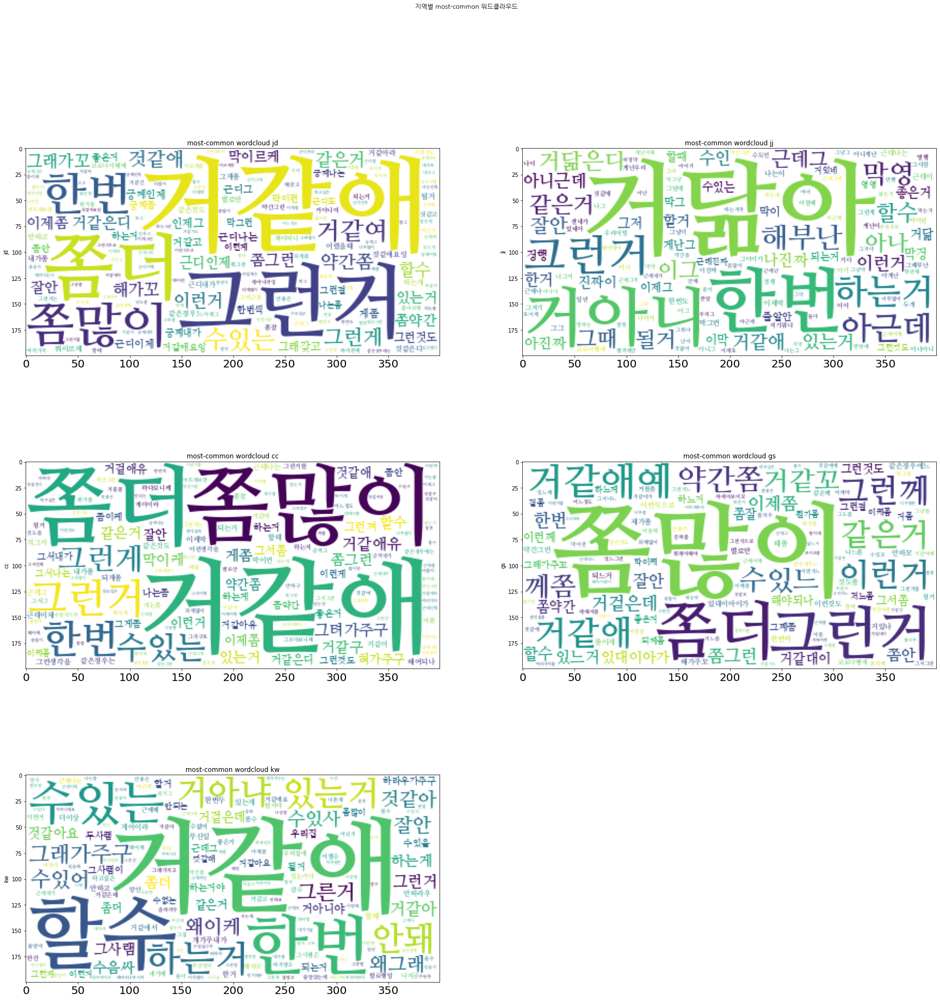

In [103]:
plt.figure(figsize= (30,30))

regs = df_train.reg.unique()

for i, reg in enumerate(regs) :
    frequency_pos = Counter()
    dial = df_train.loc[df_train['reg'] == reg].dial
    for k in tqdm(dial) :
        token_words = ngrams(k.split(),2)
        for z in token_words: # 수정
            frequency_pos.update([''.join(z)]) #수정
    
    ccs = frequency_pos.most_common(100) # 수정
        

    # font path http://corazzon.github.io/matplotlib_font_setting
    font_list = [(f.name, f.fname) for f in fm.fontManager.ttflist if 'Nanum' in f.name]
    font_list[0][1]
    wc = WordCloud(font_path= font_list[0][1], background_color='white',max_font_size=100 ,prefer_horizontal = 1)
    
    
    cloud = wc.generate_from_frequencies(frequency_pos) # 수정

    
    plt.subplot(3,2,i+1)
    plt.ylabel(reg)
    plt.imshow(cloud)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=10)
    plt.title(f'most-common wordcloud {reg}')

plt.suptitle('지역별 most-common 워드클라우드',  font ='NanumGothic')
# plt.tight_layout()
plt.show()

100%|██████████| 293070/293070 [00:02<00:00, 138917.84it/s]


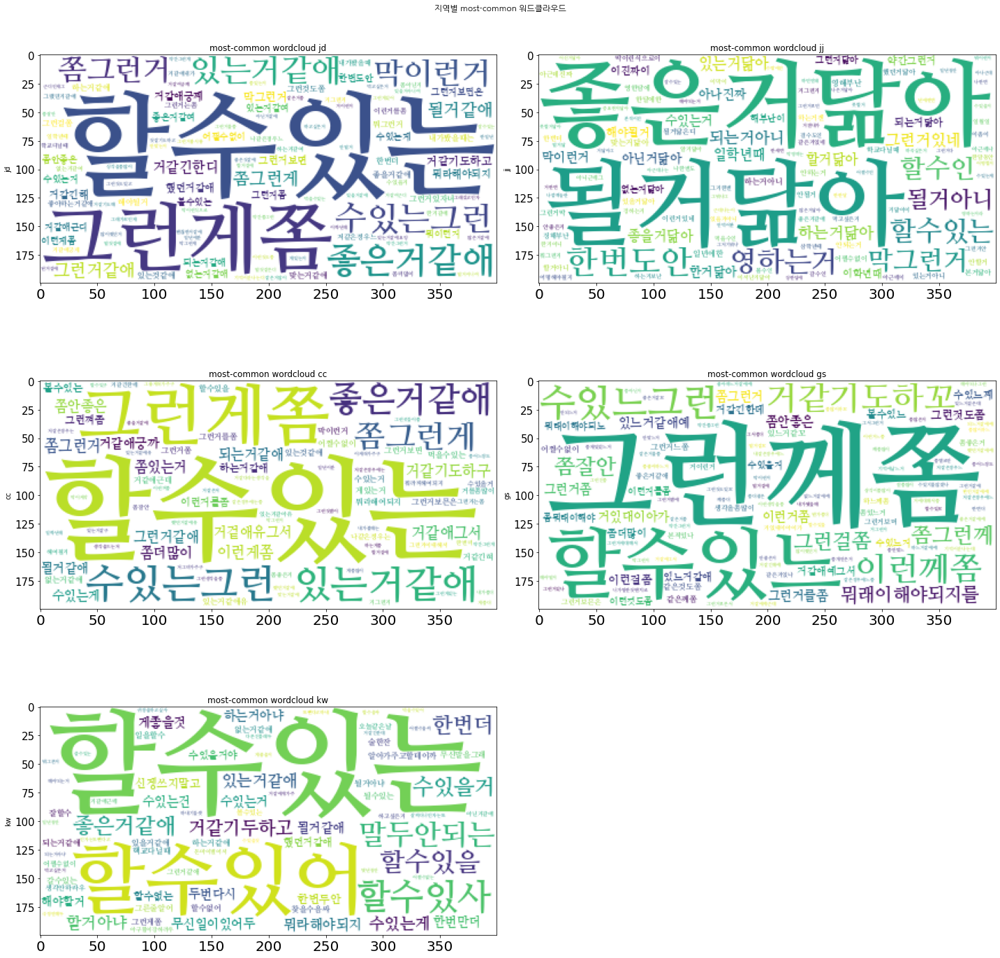

In [104]:
plt.figure(figsize= (20,20))

regs = df_train.reg.unique()

for i, reg in enumerate(regs) :
    frequency_pos = Counter()
    dial = df_train.loc[df_train['reg'] == reg].dial
    for k in tqdm(dial) :
        token_words = ngrams(k.split(),3)
        for z in token_words: # 수정
            frequency_pos.update([''.join(z)]) #수정
    
    ccs = frequency_pos.most_common(100) # 수정
        

    # font path http://corazzon.github.io/matplotlib_font_setting
    font_list = [(f.name, f.fname) for f in fm.fontManager.ttflist if 'Nanum' in f.name]
    font_list[0][1]
    wc = WordCloud(font_path= font_list[0][1], background_color='white',max_font_size=100 ,prefer_horizontal = 1)
    
    
    cloud = wc.generate_from_frequencies(frequency_pos) # 수정

    
    plt.subplot(3,2,i+1)
    plt.ylabel(reg)
    plt.imshow(cloud)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=15)
    plt.title(f'most-common wordcloud {reg}')

plt.suptitle('지역별 most-common 워드클라우드',  font ='NanumGothic')
plt.tight_layout()
plt.show()

## 16000

100%|██████████| 293070/293070 [00:04<00:00, 63087.85it/s]
/opt/conda/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Glyph 51916 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/opt/conda/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Glyph 44536 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/opt/conda/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Glyph 44144 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/opt/conda/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Glyph 44540 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/opt/conda/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Glyph 46356 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/opt/conda/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: Runtime

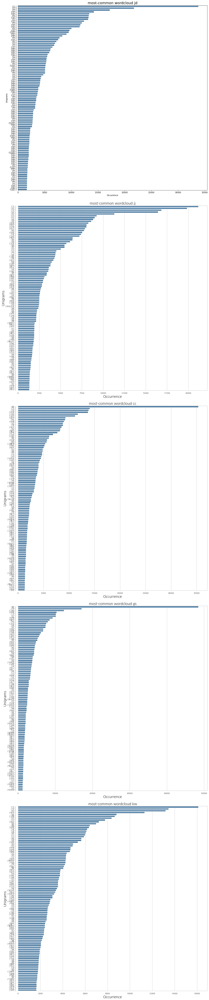

In [109]:
#spm_16000
#by reg

fig = plt.figure(figsize=(15,70))

for i, reg in enumerate(regs) :
    
    frequency_pos = Counter()
    dial = df_train.loc[df_train['reg'] == reg,'dial'].values
    for k in tqdm(dial) :
        tokenized = ''.join(spm_16000.encode_as_pieces(k)).replace('▁',' ').split()
        token_words = ngrams(tokenized,1)
        frequency_pos.update(token_words)

    df_pos = pd.DataFrame(frequency_pos.most_common(100))

    # Barplot that shows the top most common
    
    plt.subplot(5,1,i+1)
    sns.set(font_scale = 1.5, style = 'whitegrid', font ='NanumGothic')
    sns_pos_1 = sns.barplot(x = df_pos[1], y = df_pos[0], color = 'steelblue')

    # Setting axes labels
    sns_pos_1.set(xlabel = 'Occurrence', ylabel = 'Unigrams', title = f'Top 100 Unigrams : {reg}')
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.title(f'most-common wordcloud {reg}')

    
plt.tight_layout()
plt.show()

In [ ]:
#by reg

fig = plt.figure(figsize=(15,70))

for i, reg in enumerate(regs) :
    
    frequency_pos = Counter()
    dial = df_train.loc[df_train['reg'] == reg,'dial'].values
    for k in tqdm.tqdm(dial) :
        tokenized = ''.join(spm_16000.encode_as_pieces(k)).replace('▁',' ').split()
        token_words = ngrams(tokenized,2)
        frequency_pos.update(token_words)

    df_pos = pd.DataFrame(frequency_pos.most_common(100))

    # Barplot that shows the top most common
    
    plt.subplot(5,1,i+1)
    sns.set(font_scale = 1.5, style = 'whitegrid', font ='NanumGothic')
    sns_pos_1 = sns.barplot(x = df_pos[1], y = df_pos[0], color = 'steelblue')

    # Setting axes labels
    sns_pos_1.set(xlabel = 'Occurrence', ylabel = 'Unigrams', title = f'Top 100 Unigrams : {reg}')
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.title(f'most-common wordcloud {reg}')

    
plt.tight_layout()
plt.show()

In [ ]:
#by reg

fig = plt.figure(figsize=(15,70))

for i, reg in enumerate(regs) :
    
    frequency_pos = Counter()
    dial = df_train.loc[df_train['reg'] == reg,'dial'].values
    for k in tqdm.tqdm(dial) :
        tokenized = ''.join(spm_16000.encode_as_pieces(k)).replace('▁',' ').split()
        token_words = ngrams(tokenized,3)
        frequency_pos.update(token_words)

    df_pos = pd.DataFrame(frequency_pos.most_common(100))

    # Barplot that shows the top most common
    
    plt.subplot(5,1,i+1)
    sns.set(font_scale = 1.5, style = 'whitegrid', font ='NanumGothic')
    sns_pos_1 = sns.barplot(x = df_pos[1], y = df_pos[0], color = 'steelblue')

    # Setting axes labels
    sns_pos_1.set(xlabel = 'Occurrence', ylabel = 'Bigrams', title = f'Top 100 Unigrams : {reg}')
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.title(f'most-common wordcloud {reg}')

    
plt.tight_layout()
plt.show()

## 문제점 
- 강원데이터만 한글이 깨져서 나온다. 왜일까? > 수정완료
- wordcloud 잘 나오다가 갑자기 안나오네 ㅎㅎ 이런 > 수정완료 
- 139번코드 y축에 topic이 다 안나온다 > 수정 완료 